# Aprendizado Dinâmico

## Programa

1. **Séries temporais**: Conceitos básicos. Sazonalidade, tendência. Suavização e Alisamento exponencial.
2. **Séries estacionárias**.
3. Função de **autocovariância e autocorrelação**.
4. **Modelos: ARMA, ARIMA, SARIMA**: Identificação, Estimação, Previsão, Diagnósticos.
5. **Modelos estruturais**: espaço de estado e previsão Bayesiana.
6. **Previsão de séries temporais**: Método theta, Método theta expandido.
7. **Redes Dinâmicas**: Representação, manipulação e visualização, Caracterização de redes dinâmicas, Modelagem de redes dinâmicas.
8. **Análise de Sobrevivência**: Peculiaridades dos dados, Estimação não paramétrica, Funções de sobrevivências usuais, Ajuste de modelos, Modelos de longa duração, Regressão em análise de sobrevivência

**Referências:**

1. **Morettin, P.A.; Toloi, C.M.C. Análise de Séries Temporais - Modelos lineares univariados. Blucher, 2018.**
2. Eric D. Kolaczyk, Gábor Csárdi. Statistical Analysis of Network Data with R, Springer. 2014.
3. Paul S.P. Cowpertwait, Andrew V. Metcalfe. Introductory Time Series with R, Springer. 2009.
4. Louzada-Neto, F. ; Mazucheli, J. ; Achcar, J.A. . Análise de Sobrevivência e Confiabilidade. Lima, Peru: Instituto de Matematicas y Ciencias Afines, IMCA, 2002.
5. Colosimo, E. A. ; Giolo, S. R. Análise de Sobrevivência Aplicada. Blucher, 2006.
6. Hyndman, R. ; Athanasopoulos, G. Forecasting: Principles and Practice. OTexts, 2018.
7. Ehlers, R.S. Análise de Séries Temporais. ICMC USP. 2009.


... e outras referências que serão citadas ao longo do curso.

# Índice

- [Aula 1](#section1)
- [Aula 1: Exercícios](#section2)
- [Aula 2: Suavização](#section3)
- [Aula 2: Séries estacionárias](#section4)
- [Aula 2: Exercícios](#section5)
- [Aula 3: Autocovariância e autocorrelação](#section6)
- [Aula 4: AR, MA, ARIMA, SARIMA](#section7)
- [Aula 3: Exercícios](#section8)
- [Aula 4 (continuação): ARIMA, SARIMA, Diagnóstico](#section9)
- [Aula 4: Exercícios](#section10)
- [Aula 5: Modelos de espaço de estado](#section11)
- [Aula 5: Exercícios](#section12)
- [Aula 6: Método Theta e expansões](#section13)
- [Aula 6: Exercícios](#section14)
- [Aula 7: Redes dinâmicas](#section15)
- [Aula 7: Exercícios](#section16)
- [Aula 8: Análise de sobrevivência](#section17)
- [Aula 8: Exercícios](#section18)
- [Prática adicional (2 de setembro)](#section19)
- [Notebook dados covid](#section20)

<a id="section1"></a>
Aula 1: séries temporais


# Aula 1.    Séries temporais



## Programa

a. Conceitos básicos.

b. Visualização de séries temporais.

c. Sazonalidade, tendência.

d. Suavização e Alisamento exponencial.

### O que é uma série temporal?

**<span style="color:darkred">Uma série temporal é qualquer conjunto de observações ordenadas no tempo.</span>**

**Exemplos**

- valores diários de poluição na cidade de São Paulo

- número de óbitos diários registrados por COVID-19 no Brasil

- índices diários da Bovespa

- registro de marés no porto de Santos


**Objetivos**

São objetivos gerais dos estudos de séries temporais:

- Identificar padrões como tendência, sazonalidade, observações discrepantes (outliers);

- Usar a variação passada de uma série para predizer valores futuros. Embora não seja possível prever exatamente os valores futuros, podemos predizer um comportamento aproximado das próximas observações;

- Entender a variação conjunta de duas séries, e utilizar uma série para explicar a variação em outra série.

#### Para uma série temporal, observações vizinhas estão correlacionadas. Se em modelos de regressão a ordem das observações não importa, em modelos de séries temporais a ordem dos dados é crucial (Ehlers, 2009).

Algumas características são particulares a esse tipo de dados, por exemplo:


- Observações correlacionadas são mais difíceis de analisar e requerem técnicas específicas.

- Precisamos levar em conta a ordem temporal das observações.

- Fatores complicadores como presenca de tendências e variação sazonal ou cíclica podem ser difíceis de estimar ou remover.

- A seleção de modelos pode ser bastante complicada, e as ferramentas podem ser de difícil interpretação.

- É mais difıcil de lidar com observações perdidas e dados discrepantes devido à natureza sequencial.


## Motivação - Séries Temporais

### Exemplo: Dados de COVID-19 no estado de SP

Fonte dos dados originais: Brasil.IO: boletins epidemiológicos da COVID-19 por município por dia, disponível em: [https://brasil.io/datasets/](https://brasil.io/datasets/) (acesso em 08/03/2021,
utilizados dados até 31/12/2020). A partir dos dados originais, diversas bases de dados com registros de casos e óbitos por cidades brasileiras foram obtidas e serão disponibilizadas para estudo.

In [1]:
# Carrega as bibliotecas

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline


In [2]:
# Leitura dos dados

url = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv'

covidSP = pd.read_csv(url, parse_dates=True, index_col=0)
covidSP.head()

,confirmed,deaths
date,,
2020-02-26,0,0
2020-02-27,0,0
2020-02-28,1,0
2020-02-29,0,0
2020-03-01,0,0


In [3]:
covidSP.tail()

,confirmed,deaths
date,,
2020-12-26,1253,13
2020-12-27,2836,55
2020-12-28,1576,39
2020-12-29,12477,293
2020-12-30,11849,282


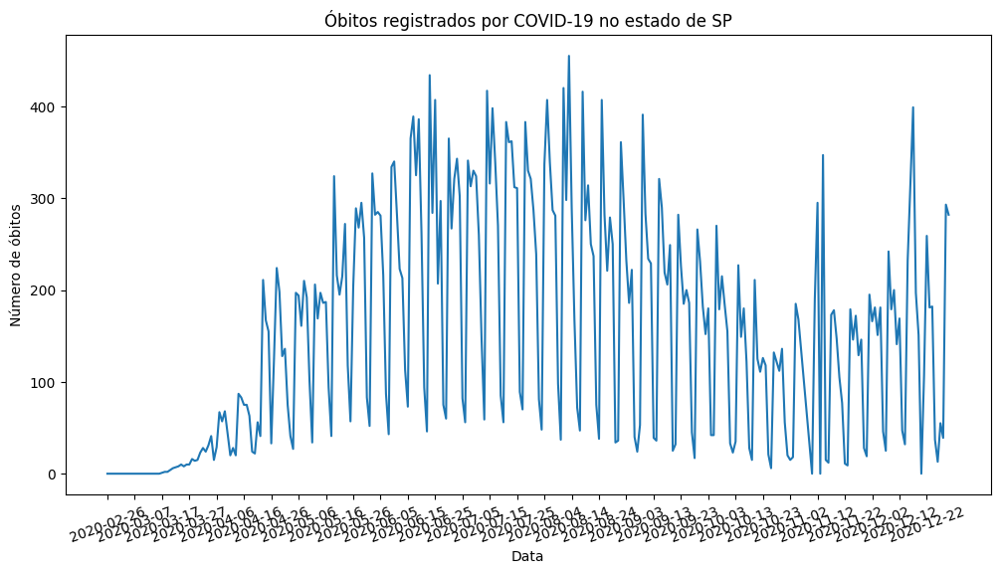

In [4]:
# COVID - Considere agora os dados de mortes diárias

y = covidSP['deaths']
x = covidSP.index

plt.rcParams['figure.figsize'] = [12,6]

plt.rc('font', size=10) # Altera o tamanho da fonte
plt.plot(x,y,label="Real data") # Plota os dados

plt.xticks(np.arange(x.min(),x.max(),10, dtype='datetime64[D]'),rotation=20)
plt.title("Óbitos registrados por COVID-19 no estado de %s" % 'SP')
plt.xlabel("Data")
plt.ylabel("Número de óbitos")
plt.ylim()
plt.show()


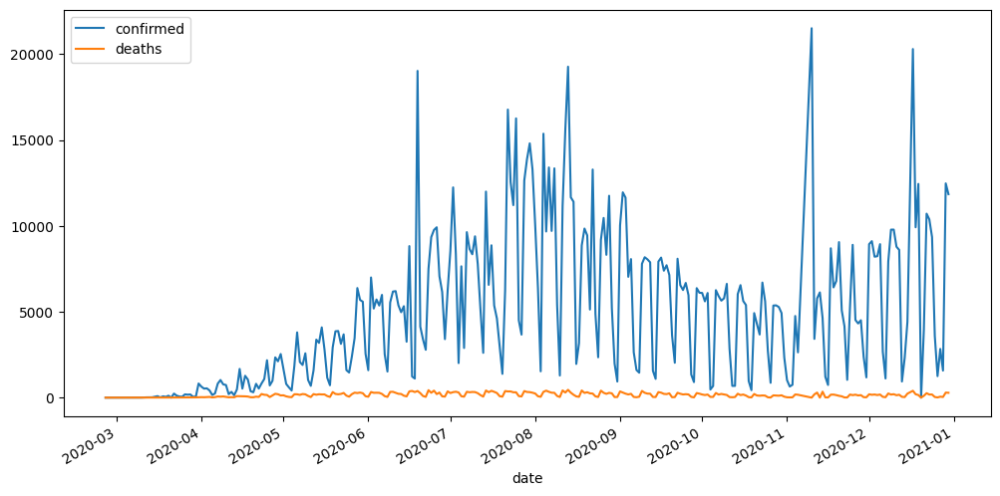

In [5]:
covidSP.plot();


**Exercícios**

1. Mesmo antes das definições formais, o que você entende por **tendência** e **sazonalidade** dos dados nesse caso?

2. Por que elas ocorrem?

3. Faça a leitura e gráfico de mortes diárias por COVID-19 para o estado do RJ (disponível em https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidRJ.csv).


### Motivação - Tendência e Sazonalidade

Considere o problema de decompor a série de mortes em **tendência, sazonalidade e resíduos (ruído)**. São conceitos que veremos adiante, mas usamos este problema para motivar o estudo de séries temporais.

In [6]:
# Instale o pacote statsmodels se necessário
#!pip show statsmodels

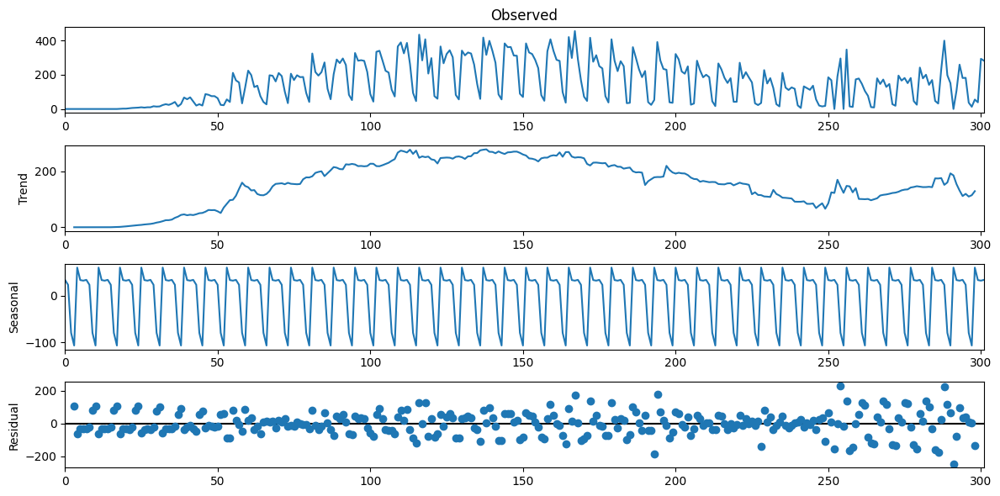

In [7]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot

# y aqui são as mortes em SP

mortes = np.array(y)

result = seasonal_decompose(mortes, model='additive', period=7)
result.plot()

pyplot.show()

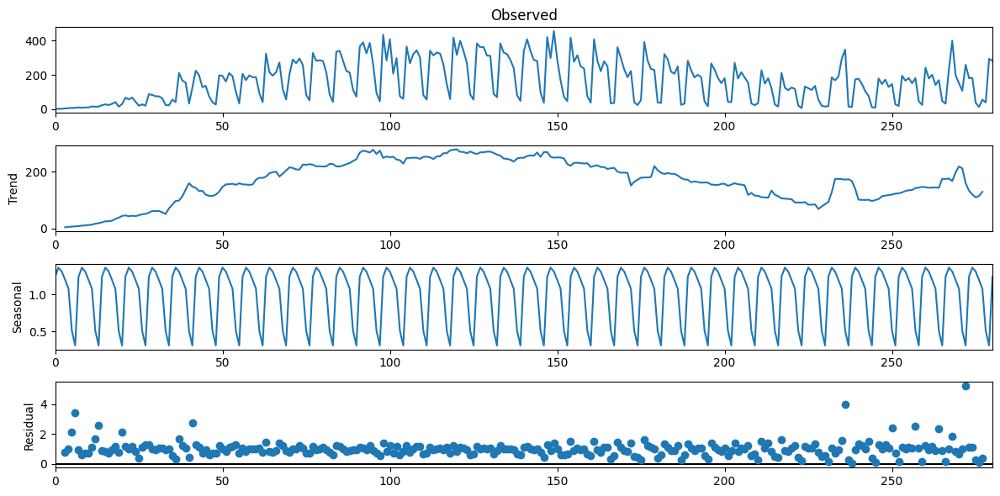

In [8]:
mortes = np.array(y)
mortes_pos = mortes[mortes>0]

result = seasonal_decompose(mortes_pos, model='multiplicative', period=7)
result.plot()

pyplot.show()

## Lidando com datas

In [9]:
covidSP.index

DatetimeIndex(['2020-02-26', '2020-02-27', '2020-02-28', '2020-02-29',
               '2020-03-01', '2020-03-02', '2020-03-03', '2020-03-04',
               '2020-03-05', '2020-03-06',
               ...
               '2020-12-21', '2020-12-22', '2020-12-23', '2020-12-24',
               '2020-12-25', '2020-12-26', '2020-12-27', '2020-12-28',
               '2020-12-29', '2020-12-30'],
              dtype='datetime64[ns]', name='date', length=302, freq=None)

**Caso o índice não seja do tipo DatetimeIndex, algumas alternativas podem ser utilizadas:**


In [10]:
idx = pd.date_range('25/2/2020', periods=7, freq='D')
idx

<ipython-input-10-02f30e41e6e4>:1: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  idx = pd.date_range('25/2/2020', periods=7, freq='D')


DatetimeIndex(['2020-02-25', '2020-02-26', '2020-02-27', '2020-02-28',
               '2020-02-29', '2020-03-01', '2020-03-02'],
              dtype='datetime64[ns]', freq='D')

In [11]:
idx = pd.date_range('25/02/2020', periods=7, freq='M')
idx

<ipython-input-11-c2aca7393406>:1: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  idx = pd.date_range('25/02/2020', periods=7, freq='M')


DatetimeIndex(['2020-02-29', '2020-03-31', '2020-04-30', '2020-05-31',
               '2020-06-30', '2020-07-31', '2020-08-31'],
              dtype='datetime64[ns]', freq='M')

In [12]:
idx = pd.to_datetime(['Feb 02, 2020','2/25/2020','25-Feb-2020',None])
idx

DatetimeIndex(['2020-02-02', '2020-02-25', '2020-02-25', 'NaT'], dtype='datetime64[ns]', freq=None)

In [13]:
datas = np.array(['2020-02-25', '2020-02-26', '2020-02-27'], dtype='datetime64[D]')
datas

array(['2020-02-25', '2020-02-26', '2020-02-27'], dtype='datetime64[D]')

In [14]:
idx = pd.DatetimeIndex(datas)
idx

DatetimeIndex(['2020-02-25', '2020-02-26', '2020-02-27'], dtype='datetime64[ns]', freq=None)

**Existem outras possibilidades!**

In [15]:
covidSP['deaths']

date
2020-02-26      0
2020-02-27      0
2020-02-28      0
2020-02-29      0
2020-03-01      0
             ... 
2020-12-26     13
2020-12-27     55
2020-12-28     39
2020-12-29    293
2020-12-30    282
Name: deaths, Length: 302, dtype: int64

<Axes: xlabel='date'>

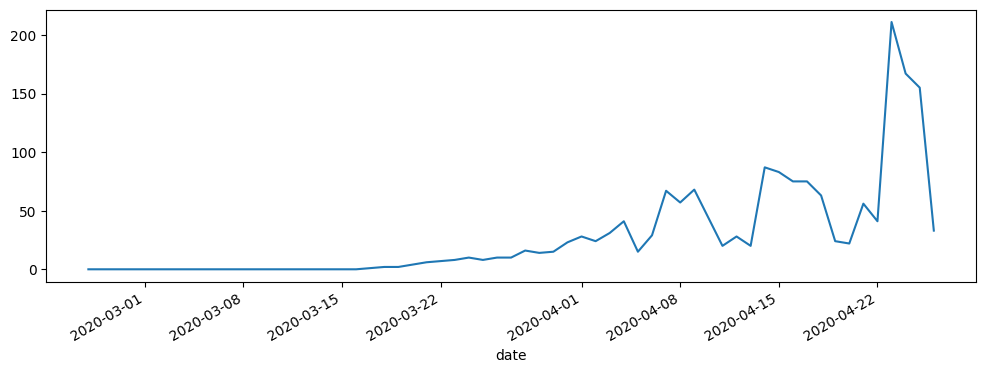

In [16]:
# Visualizando apenas uma parte da série

covidSP['deaths']['2020-02-26':'2020-04-26'].plot(figsize=(12,4))

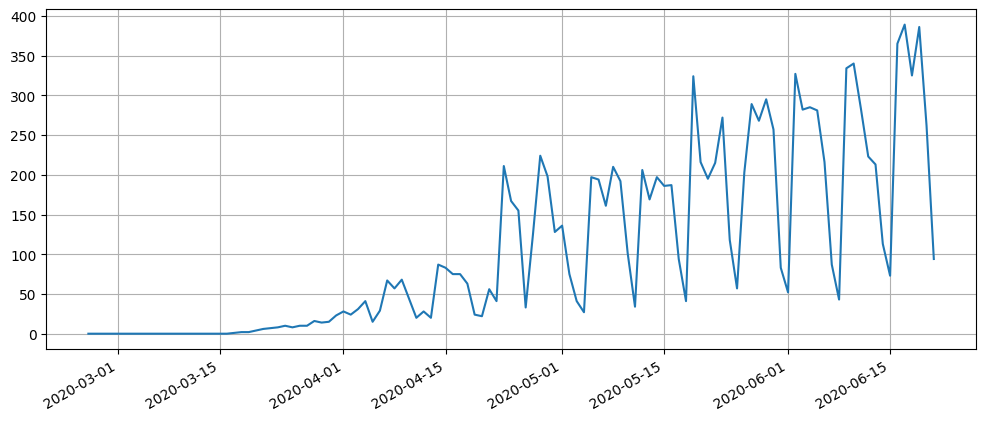

In [17]:
# Adicionando linhas de grade ao gráfico

ax=covidSP['deaths']['2020-02-26':'2020-06-21'].plot(figsize=(12,5))
ax.set(xlabel='')

ax.xaxis.grid(True)
ax.yaxis.grid(True)

# Conceitos básicos

## Processos estocásticos

Os modelos utilizados para descrever séries temporais são processos estocásticos. Em geral, assume-se que uma **série temporal observada é uma realização de um processo estocástico adjacente**.


**Definição**

Seja $T$ um conjunto arbitrário. Um _processo estocástico_ é uma família $Z = \{Z(t), t\in T\}$ tal que, para cada $t\in T$, $Z(t)$ é uma variável aleatória.


Um processo estocástico pode ser visto como uma família de variáveis aleatórias. Por outro lado, uma realização ou trajetória do processo estocástico pode ser visto como uma **série temporal**.



O **espaço de estados** de um processo estocástico é o conjunto de todos os possíveis valores que as variáveis aleatórias $Z(t)$ podem assumir.

Os processos estocásticos podem ser **discretos**, por exemplo, o número de chamadas telefônicas que chega a uma central em duas horas, ou **contínuo**, por exemplo o preço de um ativo financeiro.

Poderíamos descrever um processo estocástico por meio da distribuição de probabilidade conjunta de $Z(t_1),\ldots,Z(t_k)$, mas aqui abordaremos o assunto de uma forma um pouco mais simples. Vamos portanto utilizar as funções (para o caso contínuo)

- Média: $\mu(t) = E(Z(t))$

- Variância: $\sigma^2(t) = Var(Z(t))$

- Autocovariância: $\gamma(t_1,t_2) = E[Z(t_1)-\mu(t_1)][Z(t_2)-\mu(t_2)]$



### Alguns exemplos de processos estocásticos conhecidos

- Sequência aleatória

- Ruído branco

- Passeio aleatório


### Sequência aleatória

Considere $\{X_n,n=1,2,\ldots\}$ uma sequência de v.a. definidas no mesmo espaço amostral $\Omega$. Aqui, $\mathcal{T}=\{1,2,\ldots\}$ e temos um processo com parâmetro discreto, ou uma sequência aleatória. Para todo $n\geq 1$, podemos escrever

$$P(X_1=a_1,\ldots,X_n=a_n) = P(X_1=a_1)P(X_2=a_2|X_1=a_1)\ldots P(X_n=a_n|X_1=a_1,\ldots,X_{n-1}=a_{n-1})$$

### Ruído branco (white noise)

Dizemos que $\{\epsilon_t,t\in \mathbb{Z}\}$ é um ruído branco se as v.a. $\epsilon_t$ são não-correlacionadas, isto é, se $Cov\{\epsilon_t,\epsilon_s\}=0$ para $t\neq s$.

Esse processo será estacionário se $E(\epsilon_t)=\mu_\epsilon$ e $Var(\epsilon_t)=\sigma^2_\epsilon$ para todo $t$.

### Passeio aleatório (random walk)

Considere uma sequência aleatória $\{\epsilon_t,t\geq 1\}$ de v.a. i.i.d $(\mu_\epsilon,\sigma^2_\epsilon)$. Defina a sequência

$$X_t = \epsilon_1 + \ldots + \epsilon_t .$$

Segue que

$E(X_t) = t \mu_\epsilon$ e $Var(X_t ) = t\sigma^2_\epsilon$, ou seja, ambos dependem de $t$.

Esse processo é chamado de passeio aleatório e é claramente não estacionário.

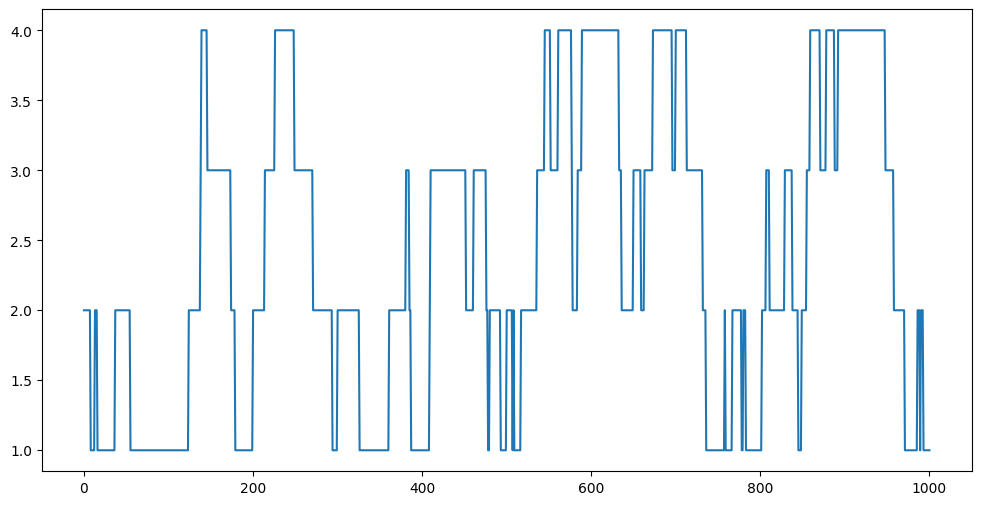

In [18]:
# Exemplo de passeio aleatório - Inspirado em https://www.geeksforgeeks.org/random-walk-implementation-python/

import random
import numpy as np
import matplotlib.pyplot as plt

# Probabilidade de mover para baixo ou para cima
prob = [0.05, 0.95]

# Definição da posição inicial
start = 2
positions = [start]

# Criação de pontos aleatórios
rr = np.random.random(1000)
downp = rr < prob[0]
upp = rr > prob[1]


for idownp, iupp in zip(downp, upp):
	down = idownp and positions[-1] > 1
	up = iupp and positions[-1] < 4
	positions.append(positions[-1] - down + up)

# Gráfico de um passeio aleatório em uma dimensão
plt.plot(positions)
plt.show()


In [19]:
np.round(rr,3)

array([0.062, 0.815, 0.162, 0.479, 0.472, 0.247, 0.7  , 0.024, 0.814,
       0.605, 0.23 , 0.766, 0.994, 0.081, 0.409, 0.035, 0.671, 0.532,
       0.188, 0.419, 0.704, 0.635, 0.022, 0.462, 0.316, 0.157, 0.527,
       0.644, 0.413, 0.719, 0.881, 0.252, 0.273, 0.79 , 0.531, 0.406,
       0.965, 0.482, 0.704, 0.368, 0.097, 0.945, 0.543, 0.792, 0.601,
       0.9  , 0.858, 0.74 , 0.465, 0.287, 0.099, 0.636, 0.284, 0.692,
       0.045, 0.55 , 0.411, 0.562, 0.587, 0.903, 0.063, 0.208, 0.195,
       0.921, 0.115, 0.798, 0.525, 0.233, 0.86 , 0.812, 0.155, 0.504,
       0.439, 0.11 , 0.381, 0.543, 0.734, 0.214, 0.185, 0.041, 0.526,
       0.851, 0.61 , 0.334, 0.579, 0.279, 0.722, 0.243, 0.524, 0.454,
       0.253, 0.886, 0.856, 0.01 , 0.679, 0.171, 0.516, 0.359, 0.805,
       0.423, 0.048, 0.877, 0.504, 0.601, 0.91 , 0.326, 0.101, 0.944,
       0.271, 0.368, 0.885, 0.886, 0.742, 0.107, 0.45 , 0.868, 0.651,
       0.215, 0.805, 0.393, 0.249, 0.713, 0.663, 0.956, 0.465, 0.529,
       0.256, 0.344,

### Processos estocásticos estacionários

Um processo é estacionário se ele se desenvolver no tempo de modo que a escolha da origem não seja importante.

Em outras palavras, as características de $Z(t+\tau)$ são as mesmas de $Z(t)$.

### Processos normais (Gaussianos)

Um processo estocástico $Z = \{Z(t), t\in \mathcal{T}\}$ é dito ser Gaussiano se, para qualquer conjunto $t_1, t_2,\ldots, t_n $ de $\mathcal{T}$ as variáveis aleatórias $Z(t_1),\ldots, Z(t_n)$ têm distribuição normal n-variada.



### Séries Temporais


Considere uma série temporal $Z(t_1),Z(t_2),\ldots,Z(t_n)$ observada nos instantes $t_1,\ldots,t_n$, ou seja, uma realização ou trajetória de um processo estocástico. Temos interesse em

- Investigar o mecanismo gerador da série

- Fazer previsões para valores futuros da série

- Descrever o comportamento da série

- Procurar periodicidades relevantes nos dados



As séries temporais podem ser **contínuas**, quando as observações são feitas continuamente no tempo. Nesse caso,

$$\{Z (t) : t ∈ T \}, T = \{t : t_1 < t < t_2 \}.$$

Ou podem ser **discretas**, quando as observações são feitas em tempos específicos

$$\{Z (t) : t ∈ T \}, T = \{t_1 , . . . , t_n \}.$$




A partir daqui, adotaremos também a notação $\{Z_t\}$ para representar uma série temporal.

Séries contı́nuas podem ser discretizadas se os valores são registrados a certos intervalos de tempo.

Séries podem ter valores agregados ou acumulados em intervalos de tempo, e.g. exportações medidas mensalmente ou quantidade de chuva medida diariamente.

Algumas séries são inerentemente discretas, e.g. dividendos pagos por uma empresa aos seus acionistas em anos sucessivos.

A série temporal é multivariada se k variáveis são observadas a cada tempo $\{Z_{1t} , . . . , Z_{kt} , t ∈ T \}$. As séries correlacionadas devem ser analisadas conjuntamente e em cada tempo tem-se um vetor de observações.



# Tendência e Sazonalidade



Considere as observações $\{Z_t, t=1,\ldots,N\}$ de uma série temporal.

Podemos escrever um modelo de decomposição de $Z_t$ como uma soma de três componentes não-observáveis:

$$Z_t = T_t + S_t + a_t$$

em que

- $T_t$ representa uma componente de **tendência**

- $S_t$ representa uma componente de **sazonalidade**

- $a_t$ é uma **componente aleatória** (resíduos ou ruído), com média 0 e variância $\sigma^2_a$ .

Se $\{a_t\}$ for um ruído branco, então $Cov(a_t,a_s) = 0$ com $s\neq t$, mas podemos eventualmente relaxar essa suposição supondo $\{a_t\}$ um processo estacionário. Segue-se que, em geral, $\{Z_t\}$ é uma série não-estacionária.

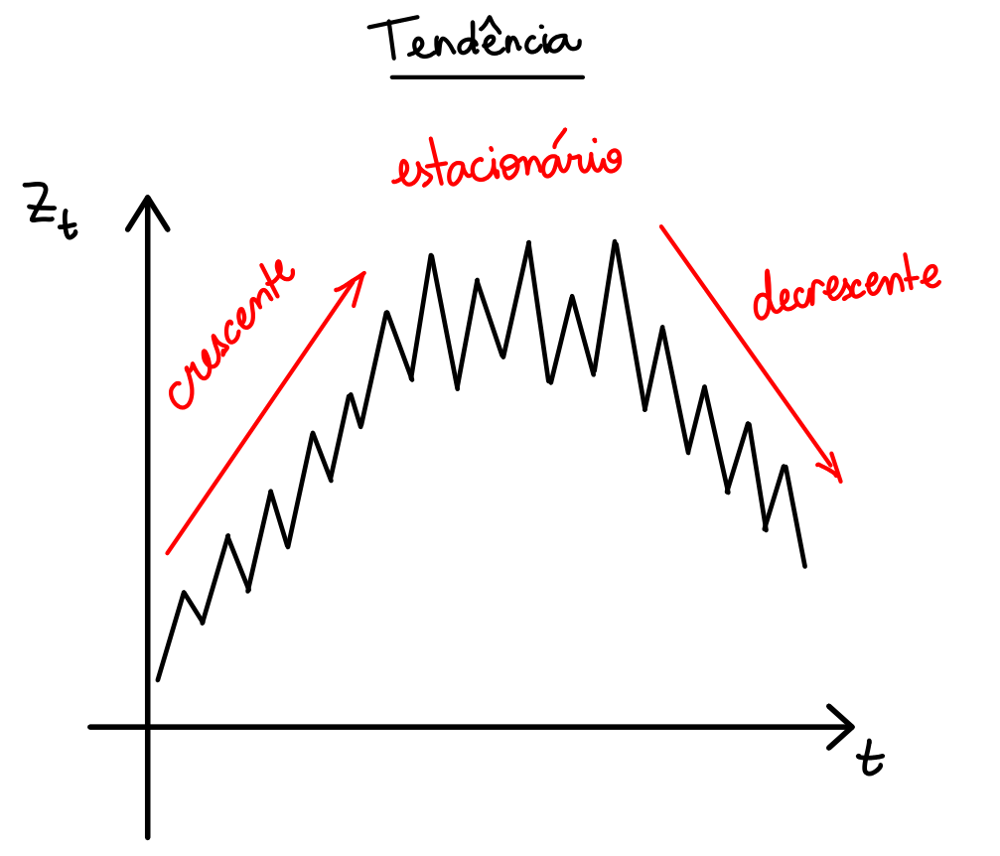

## Tendência

Suponha inicialmente que a componente sazonal $S_t$ não esteja presente. Um modelo inicial é

$$Z_t = T_t + a_t$$

em que $a_t$ é um ruído branco, com variância $\sigma^2_a$.



Queremos estimar $T_t$. Para isso, considere algumas possibilidades:

i. ajustar uma função no tempo, como um polinômio, uma exponencial ou outra função suave de $t$;

ii. suavizar (ou filtrar) os valores da série ao redor de um ponto, para estimar a tendência naquele ponto

iii. suavizar os valores da série através de sucessivos ajustes de retas de mínimos quadrados ponterados ('lowess')


Estimada a tendência, $\widehat{T}_t$, podemos obter a série ajustada para tendência ou livre de tendência

$$Y_t = Z_t - \widehat{T}_t$$

Para eliminar a tendência de uma série, também é possível considerar as diferenças. Normalmente para séries econômicas, a primeira diferença


$$\Delta Z_t = Z_t - Z_{t-1}$$ já é estacionária.



### Tendência polinomial

Suponha que

$$T_t = \beta_0+\beta_1t + \ldots +\beta_m t^m$$

onde o grau do polinômio $m$ é bem menor do que o número de observações N.

Pode-se utilizar o método de mínimos quadrados para estimar $\beta_0,\ldots,\beta_m$ e obter $\widehat{\beta}_0,\ldots,\widehat{\beta}_m$.

In [20]:
# Exemplo tendência polinomial - Carregando as bibliotecas

import pandas as pd
import numpy as np
import matplotlib.dates as mdates
import matplotlib.pyplot as plt


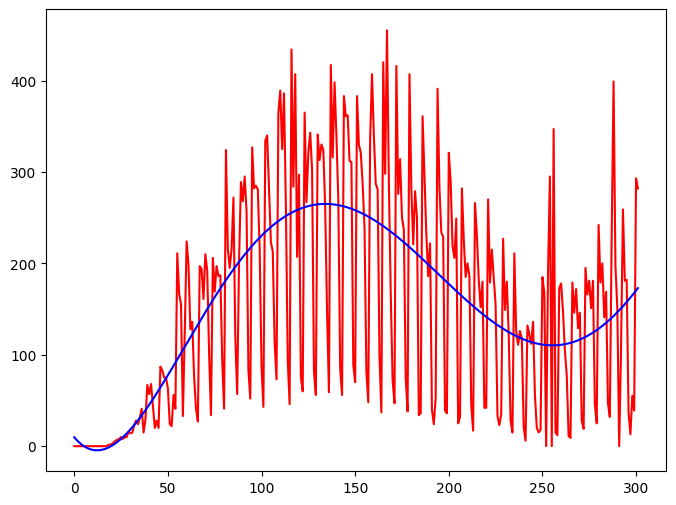

In [21]:
#Leitura dos dados

url = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv'

# Leitura via github
covidSP = pd.read_csv(url,index_col='date',parse_dates=True)

# Aqui não trabalharemos com as datas mas sim com um índice inteiro das observações
x = np.array(range(len(covidSP.index)))
y = np.array(covidSP['deaths'])

polynomial = np.polyfit(x, y, 5)
p5 = np.poly1d(polynomial)

xx = np.linspace(x.min(), x.max(), len(y))

plt.rcParams['figure.figsize'] = [8,6]

plt.plot(x,y,label="Real data",color="red") # Plota os dados
plt.plot(xx,p5(xx),label="Polinomio",color="blue") # Polinômio

## Sazonalidade

Comportamento da série temporal tende a se repetir a cada s perı́odos de tempo.

Por exemplo, para dados de COVID-19, os picos em geral ocorrem às terças-feiras e aos fins de semana os registros diminuem, dada a sistemática das notificações.

**Tipos de Sazonalidade**

- **Aditiva**. A série apresenta flutuações sazonais mais ou menos constantes não importando o nı́vel global da série.

- **Multiplicativa**. O tamanho das flutuações sazonais varia dependendo do nı́vel global da série.


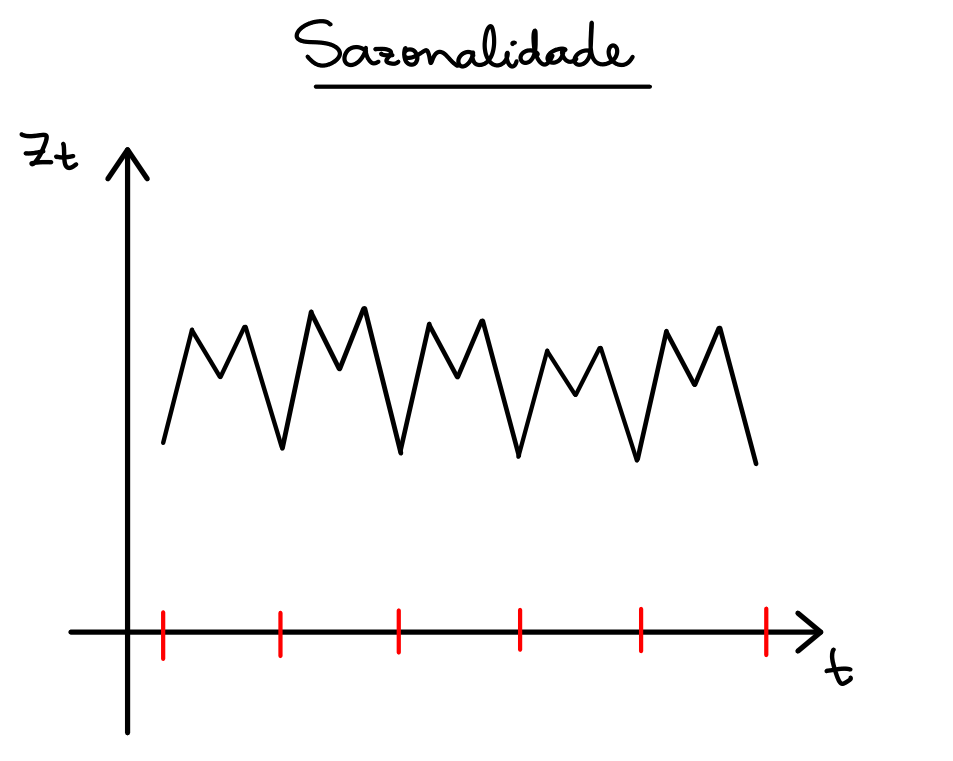

Considere as observações $\{Z_t, t=1,\ldots,N\}$ de uma série temporal.

Supondo que não existe tendência mas somente sazonalidade :

$$Z_t =  S_t + a_t$$

em que

- $S_t$ representa uma componente de **sazonalidade**

- $a_t$ é um ruído branco com média 0 e variância $\sigma^2_a$.

Se a sazonalidade for multiplicativa o modelo é definido como

$$Z_t =  S_t  a_t$$

**Métodos para estimar a sazonalidade**

Para obter a sazonalidade ajustada $\widehat{S_t}$, podemos utilizar diferentes métodos:

- **Método da regressão** (método determinístico) em que as covariáveis são variáveis periódicas, por exemplo seno, cosseno ou variáveis 'dummy', que são variáveis indicadoras  


- **Médias móveis** (método estocástico)

E então obtemos a série livre de sazonalidade (ou sazonalmente ajustada)


$$Y_t = Z_t - \widehat{S}_t, \mbox{  no caso aditivo, ou}$$


$$Y_t = Z_t / \widehat{S}_t \mbox{ no caso multiplicativo}$$

Aqui, nós usaremos a função [seasonal_decompose](https://www.statsmodels.org/dev/generated/statsmodels.tsa.seasonal.seasonal_decompose.html) do pacote [statsmodels](https://www.statsmodels.org/stable/index.html).

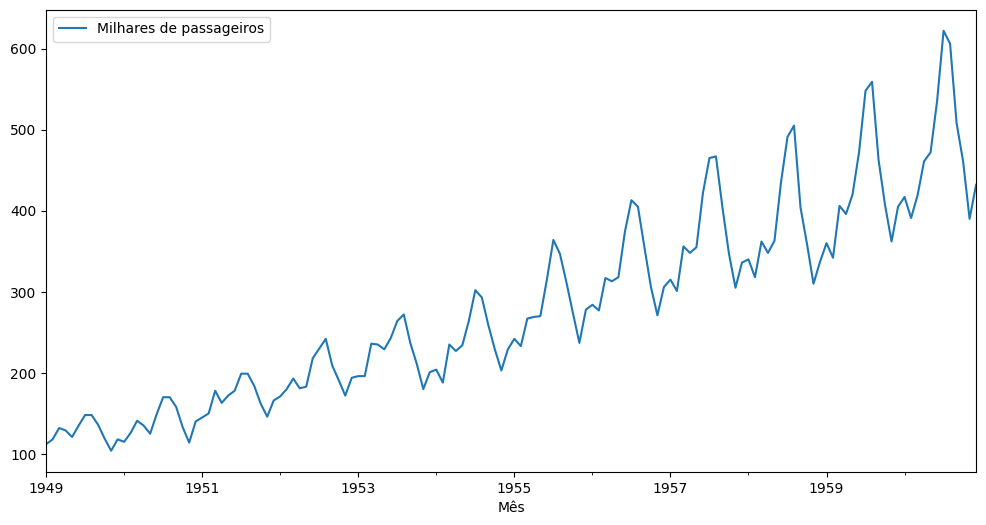

In [22]:
### Passageiros

# Agendamento de passageiros (em milhares) por mês na Pan Am nos Estados Unidos, observadas mensalmente no período de 1949-1960 (Brown, R. G. "Smoothing." Forecasting and Prediction of Discrete Time Series, 1963).
# A companhia usou os dados para prever a demanda futura e antes de programar compras e novas aeronaves e de treinar funcionários.

# Air Passengers: Passageiros aéreos
# Vamos ler os dados direto do github

url='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv'
passageiros = pd.read_csv(url, index_col=0,parse_dates=True)

passageiros.index = passageiros.index.to_period("M")

passageiros.plot(figsize=(12,6));

<Axes: xlabel='Mês'>

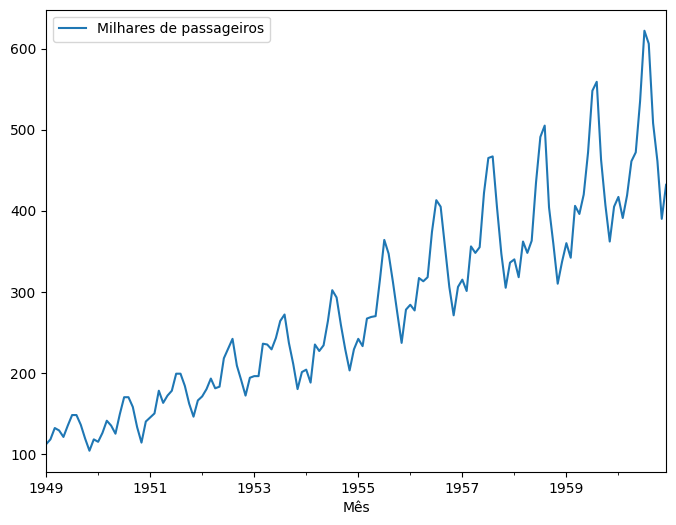

In [23]:
# Para essa análise, os dados faltantes devem ser excluídos!

passageiros = passageiros.dropna()

passageiros.plot()

# A sazonalidade é aditiva ou multiplicativa?


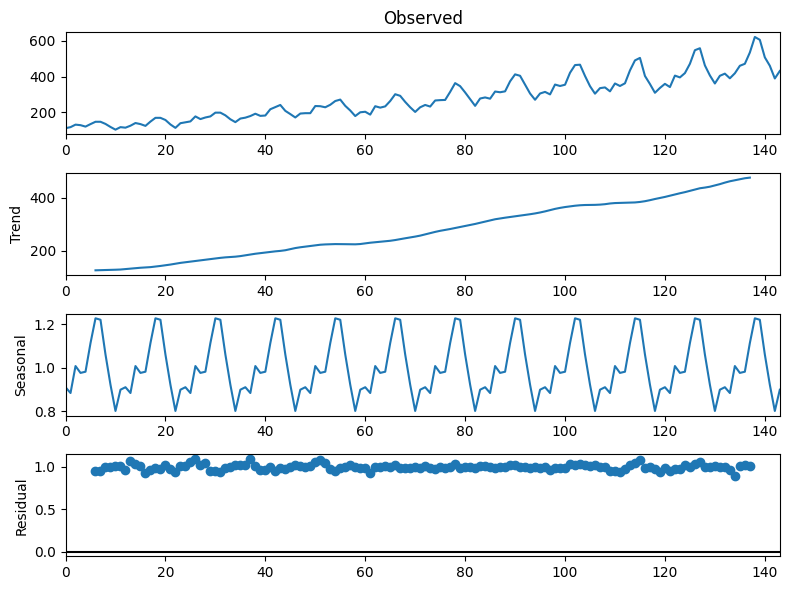

In [24]:
import statsmodels.api as sm

# Decomposição em tendência e sazonalidade

passag = np.array(passageiros['Milhares de passageiros'])

result = sm.tsa.seasonal_decompose(passag, model='multiplicative', period=12)


result.plot();


In [25]:
# Olhe para as componentes do objeto result

result.seasonal

array([0.91023037, 0.88362532, 1.00736629, 0.97590601, 0.98137803,
       1.11277583, 1.22655554, 1.21991097, 1.06049193, 0.92175724,
       0.80117808, 0.89882439, 0.91023037, 0.88362532, 1.00736629,
       0.97590601, 0.98137803, 1.11277583, 1.22655554, 1.21991097,
       1.06049193, 0.92175724, 0.80117808, 0.89882439, 0.91023037,
       0.88362532, 1.00736629, 0.97590601, 0.98137803, 1.11277583,
       1.22655554, 1.21991097, 1.06049193, 0.92175724, 0.80117808,
       0.89882439, 0.91023037, 0.88362532, 1.00736629, 0.97590601,
       0.98137803, 1.11277583, 1.22655554, 1.21991097, 1.06049193,
       0.92175724, 0.80117808, 0.89882439, 0.91023037, 0.88362532,
       1.00736629, 0.97590601, 0.98137803, 1.11277583, 1.22655554,
       1.21991097, 1.06049193, 0.92175724, 0.80117808, 0.89882439,
       0.91023037, 0.88362532, 1.00736629, 0.97590601, 0.98137803,
       1.11277583, 1.22655554, 1.21991097, 1.06049193, 0.92175724,
       0.80117808, 0.89882439, 0.91023037, 0.88362532, 1.00736

In [26]:
result.trend

array([         nan,          nan,          nan,          nan,
                nan,          nan, 126.79166667, 127.25      ,
       127.95833333, 128.58333333, 129.        , 129.75      ,
       131.25      , 133.08333333, 134.91666667, 136.41666667,
       137.41666667, 138.75      , 140.91666667, 143.16666667,
       145.70833333, 148.41666667, 151.54166667, 154.70833333,
       157.125     , 159.54166667, 161.83333333, 164.125     ,
       166.66666667, 169.08333333, 171.25      , 173.58333333,
       175.45833333, 176.83333333, 178.04166667, 180.16666667,
       183.125     , 186.20833333, 189.04166667, 191.29166667,
       193.58333333, 195.83333333, 198.04166667, 199.75      ,
       202.20833333, 206.25      , 210.41666667, 213.375     ,
       215.83333333, 218.5       , 220.91666667, 222.91666667,
       224.08333333, 224.70833333, 225.33333333, 225.33333333,
       224.95833333, 224.58333333, 224.45833333, 225.54166667,
       228.        , 230.45833333, 232.25      , 233.91

# Suavização e Alisamento exponencial



## Suavização

- A suavização permite que a tendência da série em um instante t possa ser estimada usando-se observações $Z_s$ com $s$ ao redor de $t$, por exemplo, usando as observações $Z_{t-n},Z_{t-n+1},\ldots, Z_{t+n}$ para estimar $T_t$.

- Procedimentos não paramétricos para aproximar localmente a série

- Transformação da série $Z_t$ em uma série $Z_t^{\star}$

Considere que as observações da série temporal $\{Z_t\}$ possam ser localmente decompostas em seu nível e mais um ruído aleatório

$$Z_t = \mu_t + a_t, \mbox{ para } t=1,\ldots, N$$

com $E(a_t)=0$ e $Var(a_t) = \sigma^2$ e $\mu_t$ é um parâmetro desconhecido, que pode variar lentamente com o tempo e que queremos estimar.



Alguns procedimentos de suavização:

- Médias móveis

- Medianas móveis

- Lowess

- Métodos de Holt-Winters




## Média móvel simples


Dadas as observações $Z_1,\ldots,Z_N$, a média móvel é dada por

$$Z_t^{\star} = M_t = \displaystyle{\frac{Z_t+Z_{t-1}+\ldots +Z_{t-(r+1)}}{r}},$$

ou

$$Z_t^{\star} = M_t = M_{t-1} + \displaystyle{\frac{Z_t-Z_{t-r}}{r}}$$



In [27]:
# Médias móveis para dados de passageiros aéreos

import pandas as pd
import numpy as np
%matplotlib inline

In [28]:
# Leitura dos dados

url = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv'

# Leitura via github
# Air Passengers: Passageiros aéreos
passageiros = pd.read_csv(url, index_col=0,parse_dates=True)

# Tirar dados faltantes pois influenciariam no cálculo da média móvel
passageiros = passageiros.dropna()

# OU poderia fazer simplesmente passageiros.dropna(inplace=True)

In [29]:
passageiros.head()

,Milhares de passageiros
Mês,
1949-01-01,112
1949-02-01,118
1949-03-01,132
1949-04-01,129
1949-05-01,121


Podemos criar uma série para a média móvel simples usando a função mean em rolling, que usa janelas deslizantes.
[Veja a documentação do rolling do pandas](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.rolling.html)




In [30]:
passageiros['MMS-6-meses'] = passageiros['Milhares de passageiros'].rolling(window=6).mean()
passageiros['MMS-12-meses'] = passageiros['Milhares de passageiros'].rolling(window=12).mean()

In [31]:
passageiros.head(15)

,Milhares de passageiros,MMS-6-meses,MMS-12-meses
Mês,,,
1949-01-01,112,NaN,NaN
1949-02-01,118,NaN,NaN
1949-03-01,132,NaN,NaN
1949-04-01,129,NaN,NaN
1949-05-01,121,NaN,NaN
1949-06-01,135,124.500000,NaN
1949-07-01,148,130.500000,NaN
1949-08-01,148,135.500000,NaN
1949-09-01,136,136.166667,NaN


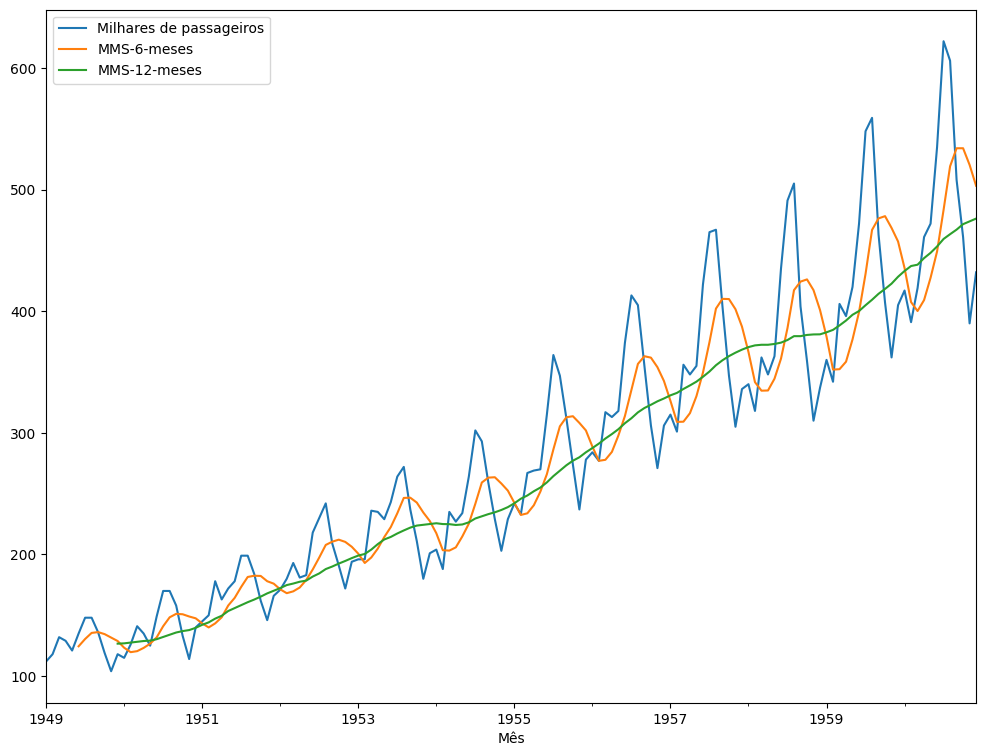

In [32]:
passageiros.plot(figsize=(12,9));

**Exercício:**

Crie um gráfico da mediana móvel. Quais as implicações?

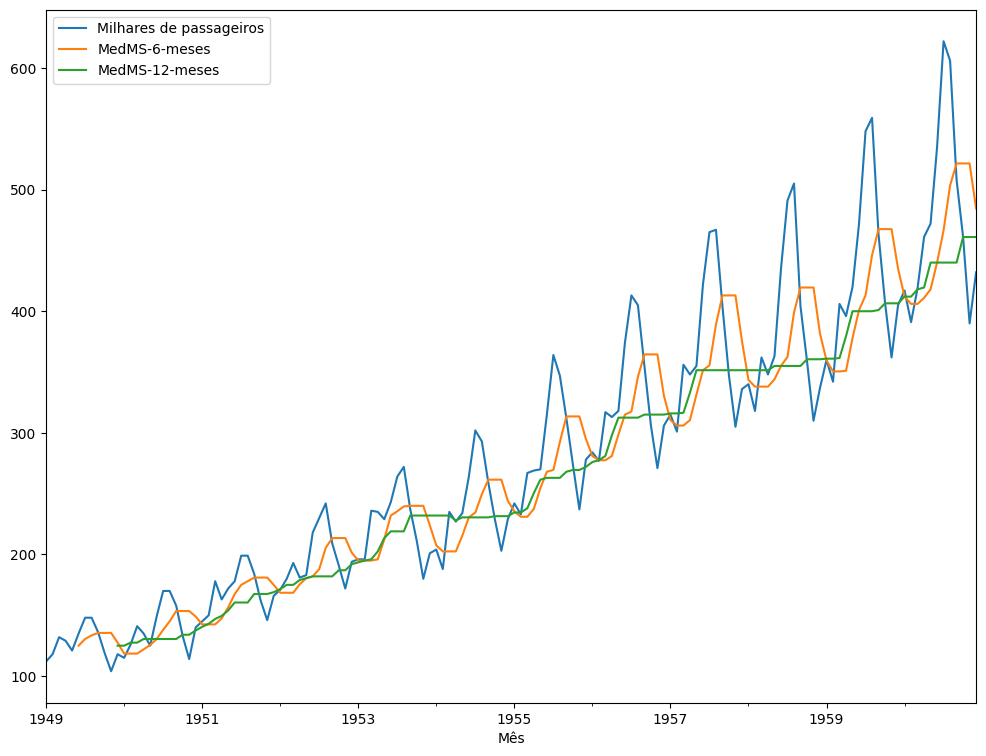

In [33]:
passageiros['MedMS-6-meses'] = passageiros['Milhares de passageiros'].rolling(window=6).median()
passageiros['MedMS-12-meses'] = passageiros['Milhares de passageiros'].rolling(window=12).median()

passageiros[['Milhares de passageiros','MedMS-6-meses','MedMS-12-meses']].plot(figsize=(12,9));

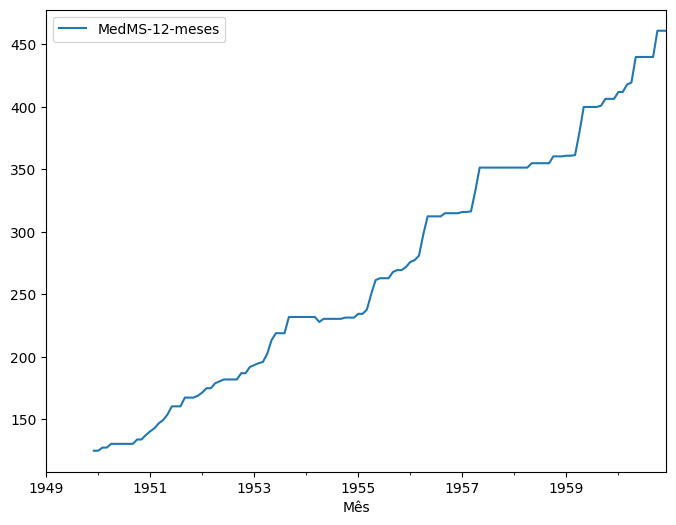

In [34]:
passageiros[['MedMS-12-meses']].plot(figsize=(8,6));

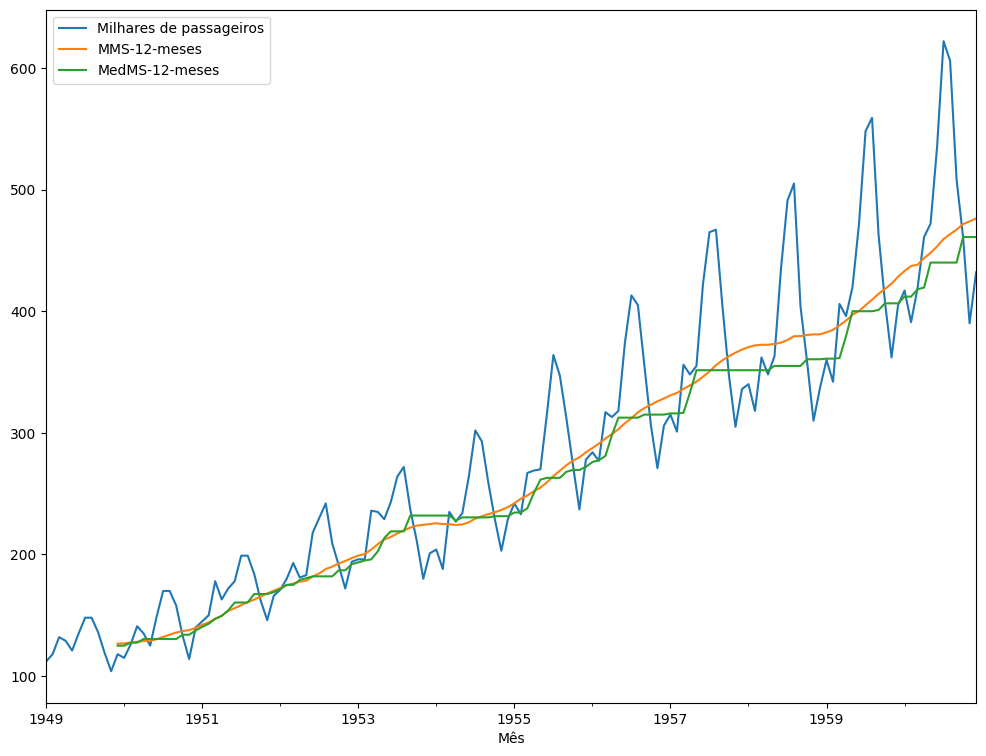

In [35]:
passageiros[['Milhares de passageiros','MMS-12-meses','MedMS-12-meses']].plot(figsize=(12,9));

## Média móvel exponencialmente ponderada  (MMEP)

As médias móveis simples têm algumas desvantagens:

- Janelas menores levarão a mais ruído, em vez de sinal.
- Ele nunca alcançará o pico ou vale máximo dos dados devido ao cálculo da média.
- Valores históricos extremos podem distorcer significativamente a MMS



Uma possível proposta para contornar esses problemas é a **média móvel exponencialmente ponderada**.

A MMEP permite reduzir o efeito de atraso da MMS e dará mais peso aos valores que ocorreram mais recentemente (aplicando mais peso aos valores mais recentes, portanto, o nome). A quantidade de peso aplicada aos valores mais recentes dependerá dos parâmetros reais usados na MMEP e do número de períodos determinados pelo tamanho da janela.


A MMEP é dada por

$$\overline{Z}_t = \alpha Z_t + (1-\alpha) Z_{t-1},$$

com $\overline{Z}_0=Z_1$;  $t=1,\ldots,N,$ e $\alpha$ é uma constante tal que $0\leq\alpha\leq 1$.



Uma representação alternativa mais geral da MMEP implementada em Python é

$\overline{Z}_t =  \displaystyle \frac{\sum\limits_{i=0}^{t-1} w_i Z_{t-i}}{\sum\limits_{i=0}^{t-1} w_i}$

Aqui, $Z_t$ é a entrada, $w_i$ é o peso aplicado (Note que os pesos podem ser diferentes de $i=0$ a $(t-1)$), e $\overline{Z}_t$ é a saída.

Agora a questão é, como podemos definir o peso $w_i$?

Isso pode ser feito mudando valores do parâmetro adjust no método .ewm (https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.ewm.html)

Quando <tt>adjust=True</tt> (default) as médias móveis ponderadas são calculadas usando pesos iguais a $w_i = (1 - \alpha)^i$

o que nos dá

$\overline{Z}_t = \displaystyle\frac{Z_t + (1 - \alpha)Z_{t-1} + (1 - \alpha)^2 Z_{t-2} + \ldots
+ (1 - \alpha)^{t-1} Z_{1}}{1 + (1 - \alpha) + (1 - \alpha)^2 + ...
+ (1 - \alpha)^{t-1}}$

Quando <tt>adjust=False</tt> as médias móveis são calculadas da forma

$\begin{array}{ll}\overline{Z}_0 &= Z_1 \\
\overline{Z}_t &= (1 - \alpha) Z_{t-1} + \alpha Z_t,\end{array}$

o que é equivalente a usar os pesos

$w_i = \begin{cases}
    \alpha (1 - \alpha)^i & \text{se } i < t \\
    (1 - \alpha)^i        & \text{se } i = t.
\end{cases}$

Quando adjust=True nós temos $\overline{Z}_0=Z_1$ e da última representação acima nós temos
$\overline{Z}_t=\alpha Z_t+(1−α)\overline{Z}_{t−1}$, portanto existe uma suposição que $Z_1$ não é um valor ordinário mas um momento exponencialmente ponderado das séries infinitas até aquele ponto.

Para o fator de suavização $\alpha$ tem-se que $0<\alpha≤1$ e é frequentemente mais fácil pensar ou em **span**, **centro de massa** ou **meia vida** de um momento exponencialmente ponderado

$\alpha =
 \begin{cases}
     \displaystyle\frac{2}{s + 1},               & \text{para span}\ s \geq 1\\
     \displaystyle\frac{1}{1 + c},               & \text{para centro de massa}\ c \geq 0\\
     \displaystyle 1 - \exp{\displaystyle(\frac{\log 0.5}{h})}, & \text{para meia-vida}\ h > 0
 \end{cases}$

* **Span** (período) corresponde ao que é comumente chamado uma "média móvel exponencialmente ponderada em N dias".
* **Centro de massa** tem uma interpretação física e pode ser pensado em termos do span: $c=(s−1)/2$
* **Meia-vida** é o período de tempo para o peso exponencial se reduzir pela metade.
* **Alpha** especifica o fator de suavização diretamente.

Temos que passar precisamente um dos parâmetros acima para a função .ewm(). Usaremos span=12.

In [36]:
passageiros['MMEP12'] = passageiros['Milhares de passageiros'].ewm(span=12,adjust=False).mean()

In [37]:
passageiros

,Milhares de passageiros,MMS-6-meses,MMS-12-meses,MedMS-6-meses,MedMS-12-meses,MMEP12
Mês,,,,,,
1949-01-01,112,NaN,NaN,NaN,NaN,112.000000
1949-02-01,118,NaN,NaN,NaN,NaN,112.923077
1949-03-01,132,NaN,NaN,NaN,NaN,115.857988
1949-04-01,129,NaN,NaN,NaN,NaN,117.879836
1949-05-01,121,NaN,NaN,NaN,NaN,118.359861
...,...,...,...,...,...,...
1960-08-01,606,519.166667,463.333333,503.5,440.0,494.898619
1960-09-01,508,534.000000,467.083333,521.5,440.0,496.914216
1960-10-01,461,534.000000,471.583333,521.5,461.0,491.388952


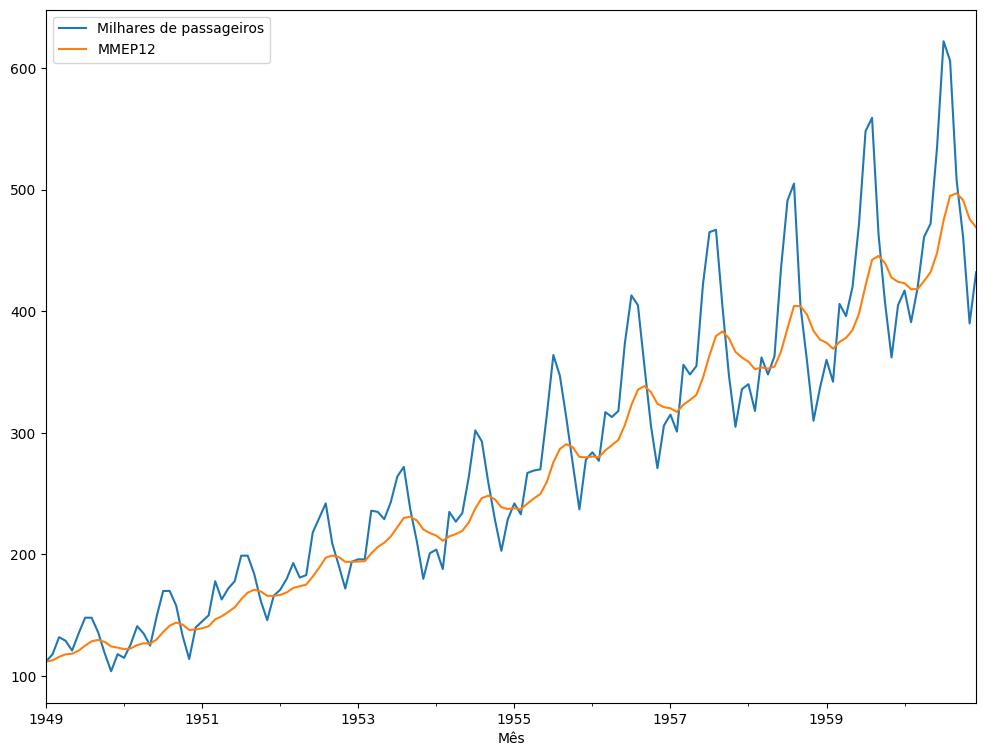

In [38]:
passageiros[['Milhares de passageiros','MMEP12']].plot(figsize=(12,9));

## Comparando MMS com MMEP

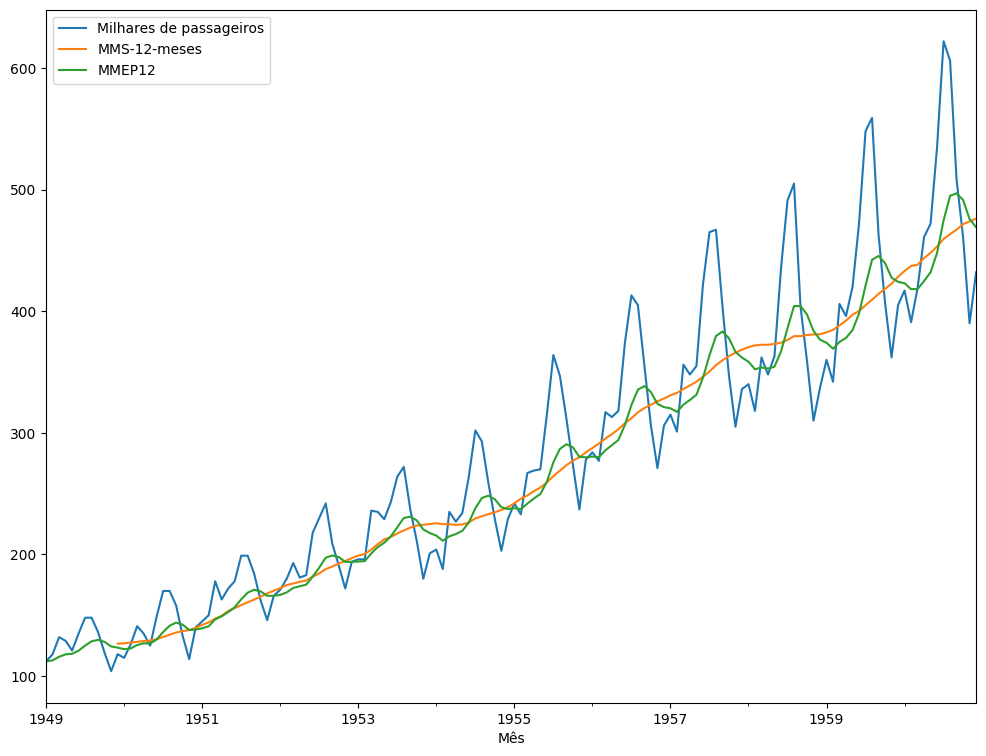

In [39]:
passageiros[['Milhares de passageiros','MMS-12-meses','MMEP12']].plot(figsize=(12,9)).autoscale(axis='x',tight=True);

**Exercício**

Aplique os métodos de média móvel (7 dias) e média exponencialmente ponderada (span=7) aos dados de mortes registradas por COVID-19 no estado de SP.


In [40]:
# Leitura dos dados

url = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv'

# Leitura via github
covidSP = pd.read_csv(url,index_col='date',parse_dates=True)


In [41]:
covidSP.head()

,confirmed,deaths
date,,
2020-02-26,0,0
2020-02-27,0,0
2020-02-28,1,0
2020-02-29,0,0
2020-03-01,0,0


In [42]:
covidSP['MMS-7-dias'] = covidSP['deaths'].rolling(window=7).mean()
covidSP['MMEP-7'] = covidSP['deaths'].ewm(span=7,adjust=False).mean()

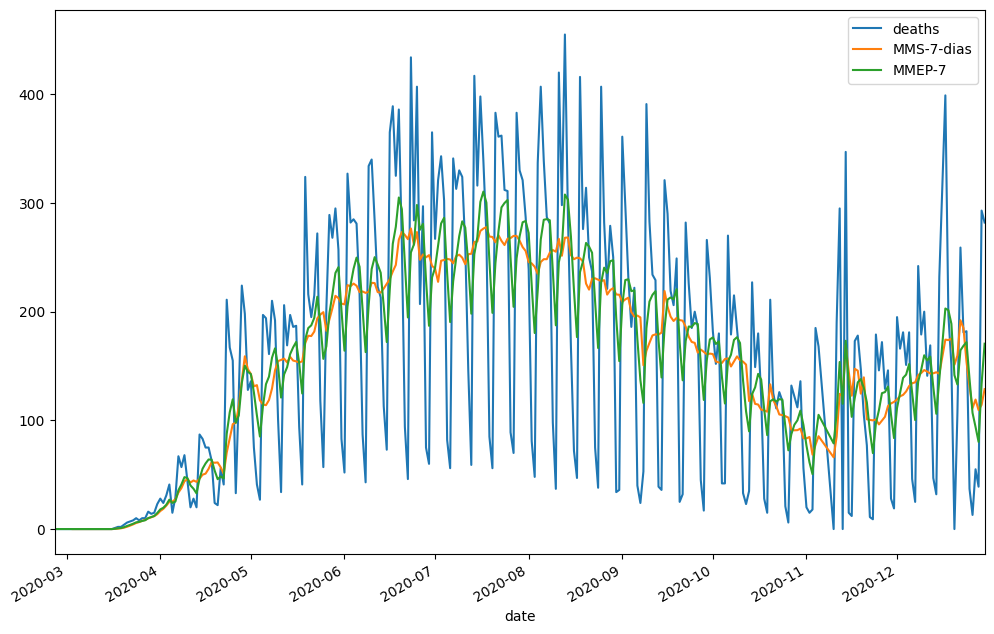

In [43]:
covidSP[['deaths','MMS-7-dias','MMEP-7']].plot(figsize=(12,8)).autoscale(axis='x',tight=True);

**Exercício**
Repita para 14 dias e span=14.
Compare esses resultados com os gráficos com 5 dias e span=5.
Você nota alguma relação com esses parâmetros e a suavidade da curva?

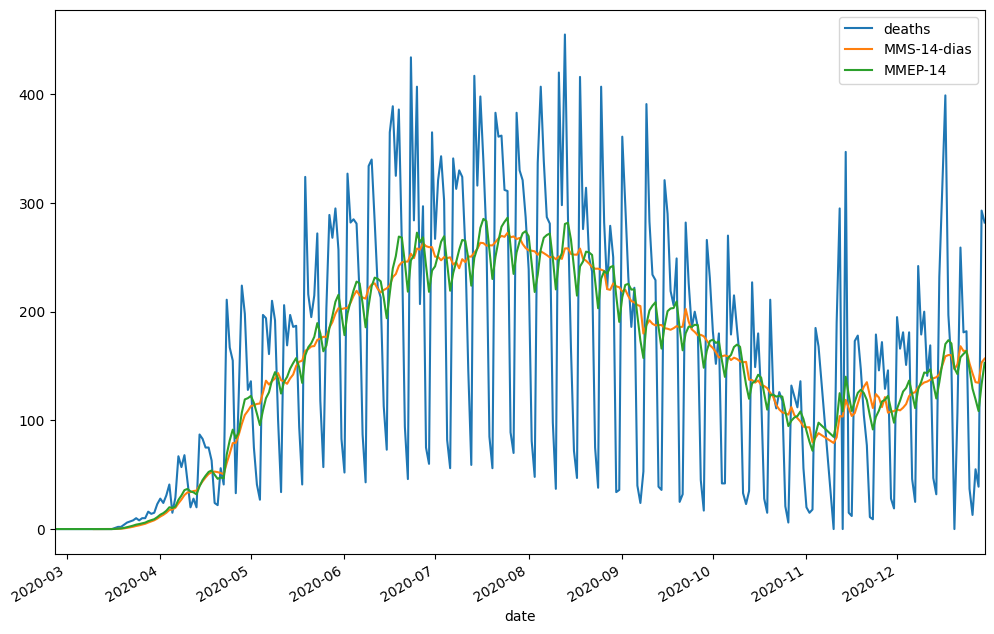

In [44]:
covidSP['MMS-14-dias'] = covidSP['deaths'].rolling(window=14).mean()
covidSP['MMEP-14'] = covidSP['deaths'].ewm(span=14,adjust=False).mean()
covidSP[['deaths','MMS-14-dias','MMEP-14']].plot(figsize=(12,8)).autoscale(axis='x',tight=True);

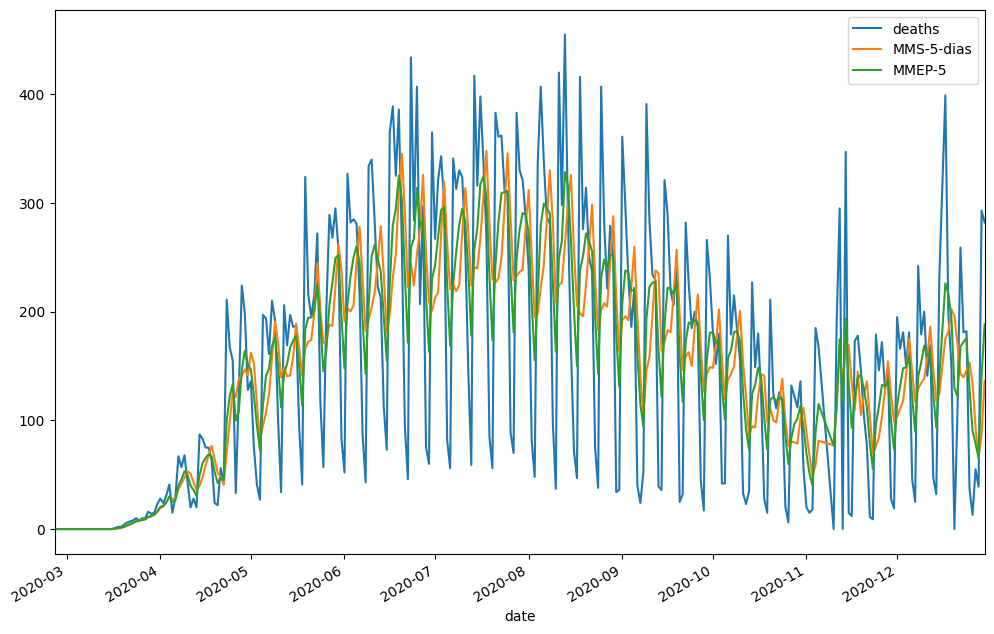

In [45]:
covidSP['MMS-5-dias'] = covidSP['deaths'].rolling(window=5).mean()
covidSP['MMEP-5'] = covidSP['deaths'].ewm(span=5,adjust=False).mean()
covidSP[['deaths','MMS-5-dias','MMEP-5']].plot(figsize=(12,8)).autoscale(axis='x',tight=True);

## Algumas outras séries que iremos tratar neste curso


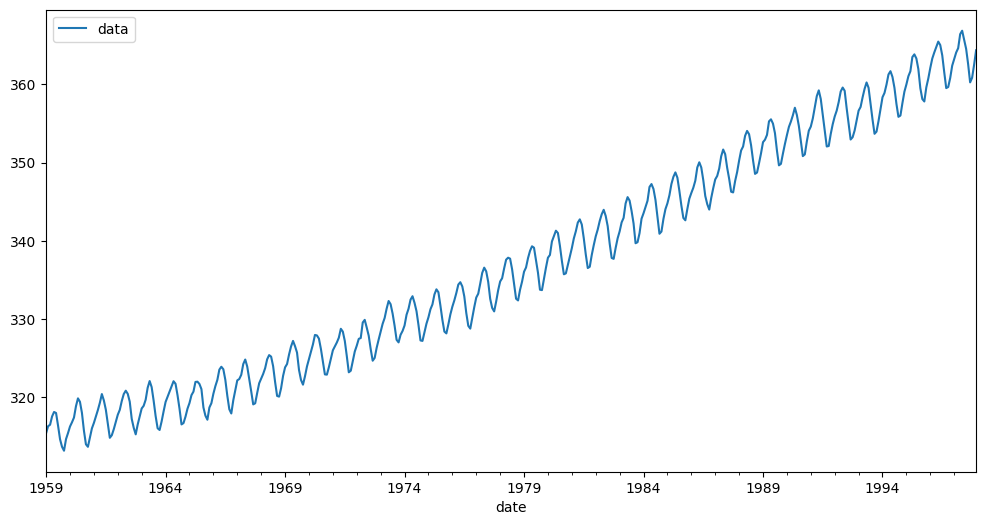

In [46]:
# Exemplo - CO2

# CO2 Concentrações atmosfericas de CO2 (em ppm) janeiro/1953 a dezembro/1997
# Dados disponíveis em https://github.com/mjuez/pytsdatasets/ e
# https://github.com/cibelerusso/Aprendizado-Dinamico/tree/main/Data

url='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/co2.csv'
co2 = pd.read_csv(url, index_col=0, parse_dates=True)
co2.index = co2.index.to_period("M")

co2.plot(figsize=(12,6));

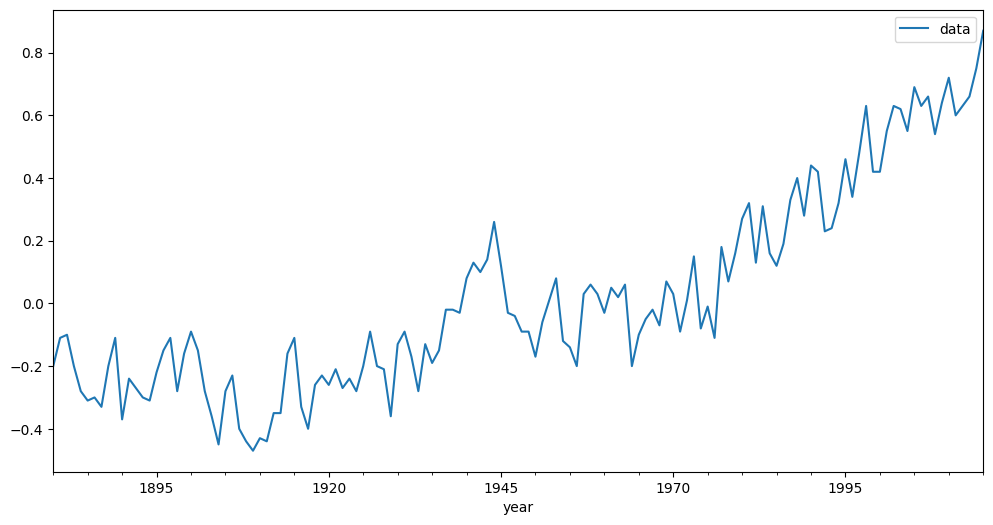

In [47]:
# Temperatura global

# Diferenças na média de temperatura global.
# Dados disponíveis em https://github.com/mjuez/pytsdatasets/ e
# https://github.com/cibelerusso/Aprendizado-Dinamico/tree/main/Data

url='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/globaltemp.csv'
globaltemp = pd.read_csv(url, index_col=0, parse_dates=True)
globaltemp.index = globaltemp.index
globaltemp.plot(figsize=(12,6));


In [48]:
globaltemp

,data
year,
1880-01-01,-0.20
1881-01-01,-0.11
1882-01-01,-0.10
1883-01-01,-0.20
1884-01-01,-0.28
...,...
2011-01-01,0.60
2012-01-01,0.63
2013-01-01,0.66


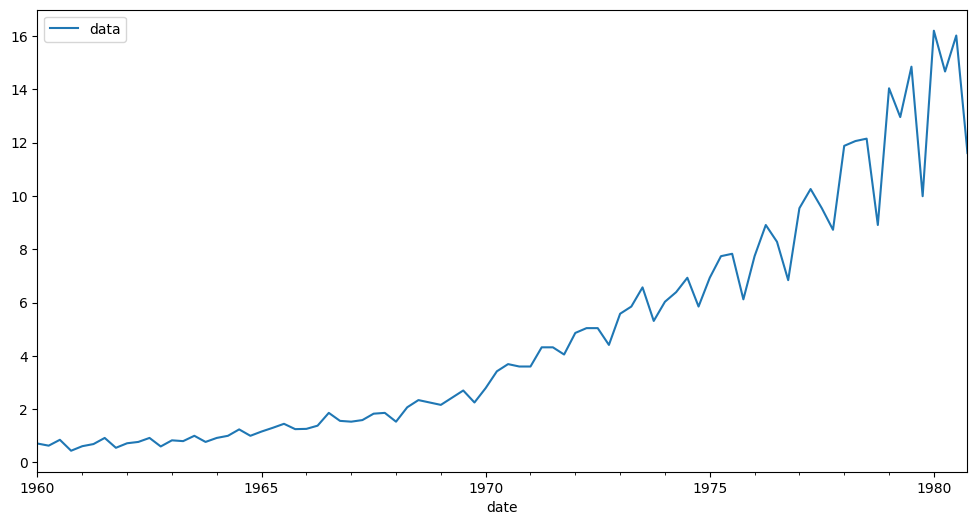

In [49]:
# Jhonson & Johnson

# Ganhos quadrimestrais da Jhonson & Jhonson
# Dados disponíveis em https://github.com/mjuez/pytsdatasets/ e
# https://github.com/cibelerusso/Aprendizado-Dinamico/tree/main/Data

url='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/jj.csv'
jj = pd.read_csv(url, index_col=0, parse_dates=True)
jj.index = jj.index.to_period("Q")
jj.plot(figsize=(12,6));


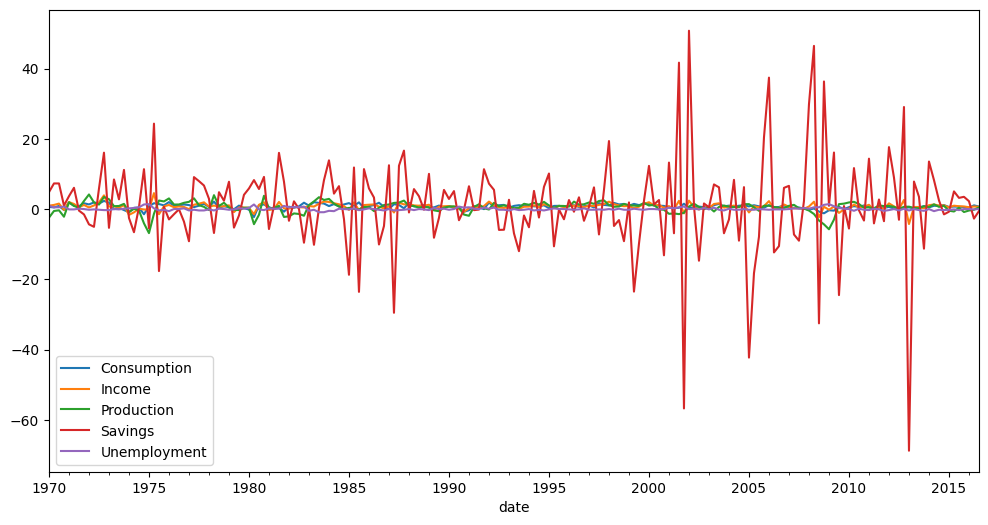

In [50]:
# US Change 1970 a 2016
# Fontes:
# Hyndman, Rob J., and George Athanasopoulos. Forecasting: principles and practice. OTexts, 2018.
# Dados disponíveis em https://github.com/robjhyndman/fpp2-package e
# https://github.com/cibelerusso/Aprendizado-Dinamico/tree/main/Data
# Percentage changes in quarterly personal consumption expenditure, personal disposable income, production, savings and the unemployment rate for the US, 1960 to 2016.

uschange = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/uschange.csv', index_col=0,
                       parse_dates=True)
uschange.index = uschange.index.to_period("Q")
uschange.plot(figsize=(12,6));

In [51]:
uschange

,Consumption,Income,Production,Savings,Unemployment
date,,,,,
1970Q1,0.615986,0.972261,-2.452700,4.810312,0.9
1970Q2,0.460376,1.169085,-0.551525,7.287992,0.5
1970Q3,0.876791,1.553271,-0.358708,7.289013,0.5
1970Q4,-0.274245,-0.255272,-2.185455,0.985230,0.7
1971Q1,1.897371,1.987154,1.909734,3.657771,-0.1
...,...,...,...,...,...
2015Q3,0.664970,0.801663,0.380606,3.180930,-0.3
2015Q4,0.561680,0.740063,-0.845546,3.482786,0.0
2016Q1,0.404682,0.519025,-0.417930,2.236534,0.0


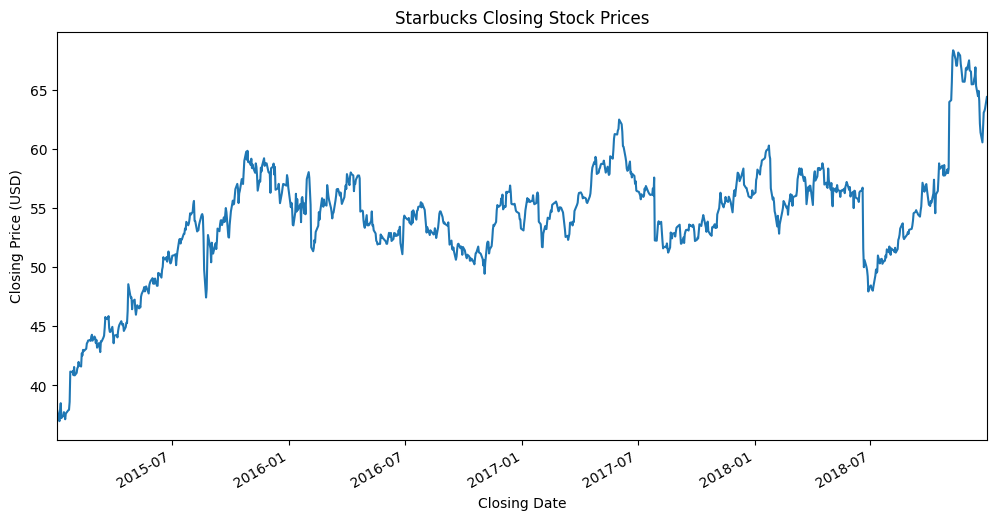

In [52]:
# Preço de fechamento e volume negociado de ações da Starbucks entre 2015 e 2018
# SBUX dataset
# Mais informações em https://medium.com/analytics-vidhya/pull-open-source-stock-price-history-using-python-d67ad0e3efe2
# Disponível em https://github.com/cibelerusso/Aprendizado-Dinamico/tree/main/Data

url='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/starbucks.csv'
df = pd.read_csv(url,index_col='Date',parse_dates=True)

title='Starbucks Closing Stock Prices'
ylabel='Closing Price (USD)'
xlabel='Closing Date'

ax = df['Close'].plot(figsize=(12,6),title=title)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel);


Você pode repetir a decomposição em tendência e sazonalidade para algumas dessas séries, e mesmo utilizar janelas deslizantes para observar as médias móveis simples e exponencialmente ponderadas.

Na próxima semana daremos continuidade às técnicas de suavização com os **Métodos de Suavização Holt-Winters**, e falaremos também sobre estacionariedade e outros aspectos de séries temporais.

<a id="section2"></a>
Aula 1: exercícios

# Prática 1

***Aprendizado Dinâmico***

por **Cibele Russo** (ICMC/USP - São Carlos SP)

**MBA em Ciências de Dados**



Considere os dados de COVID-19 para a cidade de São Paulo. Nesta prática, aplicaremos os conhecimentos adquiridos na Aula 1, fazendo:

1. Visualização de dados completos e parciais.

2. Construiremos gráficos da média móvel simples e exponencialmente ponderada, para casos e para mortes separadamente.

3. Faremos a decomposição das séries em tendência e sazonalidade

## Exercício 1:

1. Leia os dados de COVID-19 da cidade de São Paulo no arquivo covidSaoPaulo.csv.

2. Produza um gráfico da séries de casos e mortes diários da cidade de São Paulo desde o primeiro caso.

3. Em seguida, considere o gráfico do log de casos a partir somente do centésimo caso.




In [1]:
# Bibliotecas

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline



**1. Faça a leitura dos dados a partir do arquivo covid_caso.csv disponível no material do curso.**

In [2]:
url = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSaoPaulo.csv'

# COVID - Leitura dos dados
covid = pd.read_csv(url, index_col='date', parse_dates=True)
covid.head()


,confirmed,deaths
date,,
2020-02-26,0,0
2020-02-27,0,0
2020-02-28,1,0
2020-02-29,0,0
2020-03-01,0,0


In [3]:
y1 = list(np.diff(covid['confirmed']))
y2 = list(np.diff(covid['deaths']))
x = covid.index[1:] # Note o subconjunto de dados em x iniciando em 1 pois interessa as diferenças

covid = pd.DataFrame({'date':x,'confirmed':y1,'deaths':y2})

covid = covid.set_index('date') # Estabelece o índice

covid.head()

,confirmed,deaths
date,,
2020-02-27,0,0
2020-02-28,1,0
2020-02-29,-1,0
2020-03-01,0,0
2020-03-02,0,0


**Produza um gráfico da séries de casos e mortes diários da cidade de São Paulo desde o primeiro caso.**

In [4]:
covid[covid['confirmed']>0].head(3)

,confirmed,deaths
date,,
2020-02-28,1,0
2020-03-04,1,0
2020-03-05,2,0


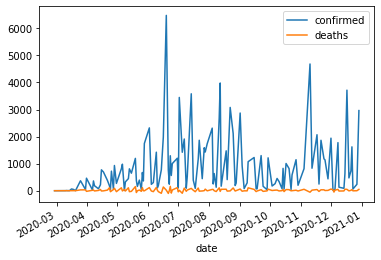

In [5]:
covid[covid['confirmed']>0].plot();

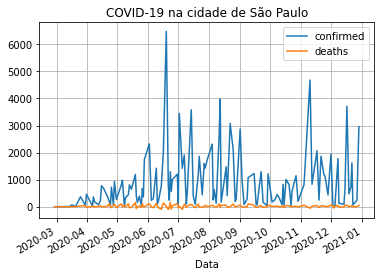

In [6]:
title = 'COVID-19 na cidade de São Paulo'
ylabel = ''
xlabel = 'Data'

ax=covid[covid['confirmed']>0].plot(title=title);
ax.autoscale(axis='both');
ax.set(xlabel=xlabel,ylabel=ylabel);

ax.xaxis.grid(True) # Com grades
ax.yaxis.grid(True)

**4. Considere o gráfico do log de casos a partir somente do centésimo caso.**

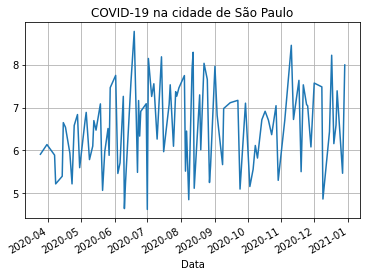

In [7]:
title = 'COVID-19 na cidade de São Paulo'
ylabel = ''
xlabel = 'Data'

ax=np.log(covid[covid['confirmed']>100]['confirmed']).plot(title=title);
ax.autoscale(axis='both');
ax.set(xlabel=xlabel,ylabel=ylabel);

ax.xaxis.grid(True) # Com grades
ax.yaxis.grid(True)

## Exercício 2

1. Construa gráficos da média móvel simples e exponencialmente ponderada para casos. Utilize janela de 7 dias para a MMS e span=7 para MMEP.

2. Construa gráficos da média móvel simples e exponencialmente ponderada para mortes. Utilize janela de 7 dias para a MMS e span=7 para MMEP.


**Construa gráficos da média móvel simples e exponencialmente ponderada para a variável casos.**

In [8]:
covid['MM-7'] = covid['confirmed'].rolling(window=7).mean()


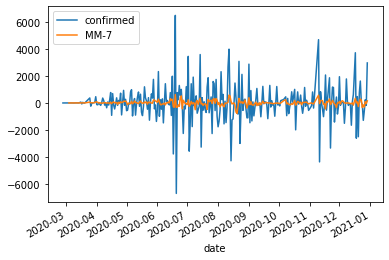

In [9]:
covid[['confirmed','MM-7']].plot();

In [10]:
covid['MMEP-7'] = covid['confirmed'].ewm(span=7,adjust=False).mean()

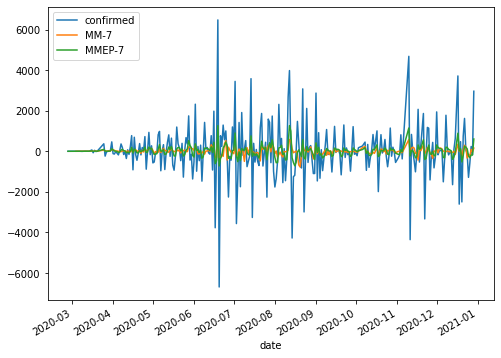

In [11]:
covid[['confirmed','MM-7','MMEP-7']].plot(figsize=(8,6));

**Construa gráficos da média móvel simples e exponencialmente ponderada para a variável mortes (deaths).**

In [12]:
covid['MM-7'] = covid['deaths'].rolling(window=7).mean()

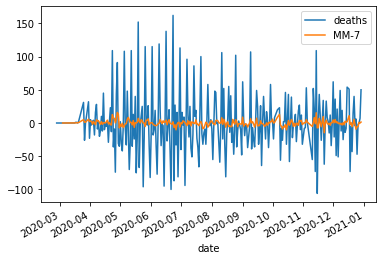

In [13]:
covid[['deaths','MM-7']].plot();

In [14]:
covid['MMEP-7'] = covid['deaths'].ewm(span=7,adjust=False).mean()

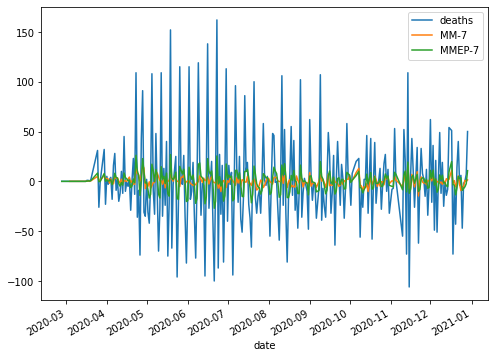

In [15]:
covid[['deaths','MM-7','MMEP-7']].plot(figsize=(8,6));

## Exercício 3

Faça a decomposição em tendência e sazonalidade do número de casos utilizando a função seasonal_decompose do módulo statsmodels.

In [12]:
covidSP = pd.read_csv(url, index_col='date')

covidSP.index = pd.DatetimeIndex(covidSP.index)

covidSP.head()

,confirmed,deaths
date,,
2020-02-26,0,0
2020-02-27,0,0
2020-02-28,1,0
2020-02-29,0,0
2020-03-01,0,0


In [13]:
covidSP.index

DatetimeIndex(['2020-02-26', '2020-02-27', '2020-02-28', '2020-02-29',
               '2020-03-01', '2020-03-02', '2020-03-03', '2020-03-04',
               '2020-03-05', '2020-03-07',
               ...
               '2020-12-20', '2020-12-21', '2020-12-22', '2020-12-23',
               '2020-12-24', '2020-12-25', '2020-12-26', '2020-12-27',
               '2020-12-28', '2020-12-29'],
              dtype='datetime64[ns]', name='date', length=286, freq=None)

/Users/leonardopiccaro/opt/anaconda3/envs/new_pyoffice/lib/python3.8/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


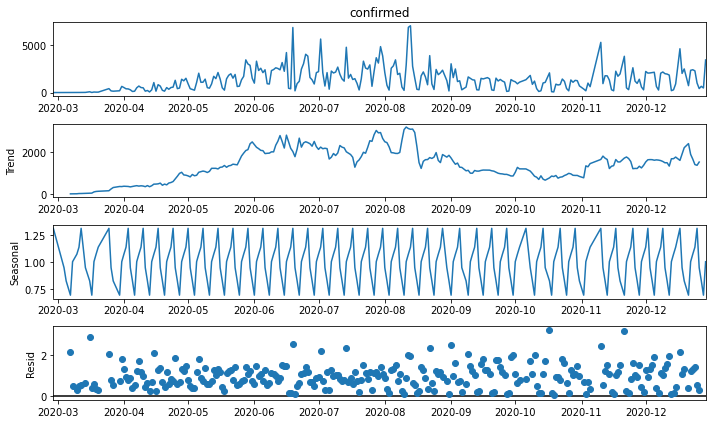

In [14]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose
from pylab import rcParams

result = seasonal_decompose(covidSP[covidSP['confirmed']>0]['confirmed'], model='multiplicative', period=7)

rcParams['figure.figsize'] = 10, 6

fig = result.plot()

plt.show()



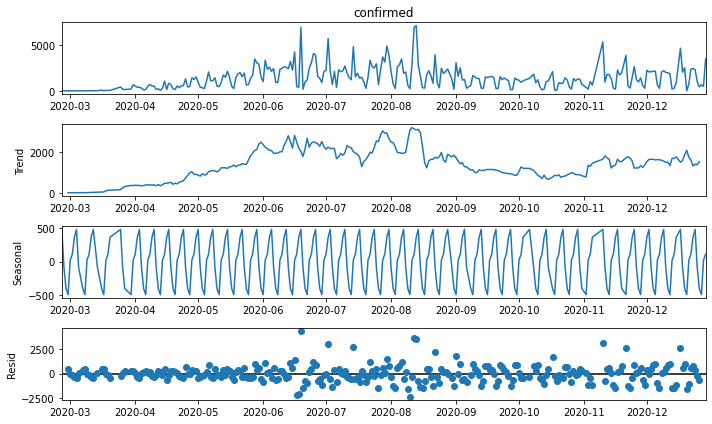

In [15]:

result = seasonal_decompose(covidSP['confirmed'], model='additive', period=7)

rcParams['figure.figsize'] = 10,6

fig = result.plot()

plt.show()


**Na sua opinião, qual o tipo de sazonalidade mais adequada, aditiva ou multiplicativa? Justifique com base nos resíduos.**

R: Embora haja pontos atípicos nos gráficos de resíduos de ambos os casos, a sazonalidade multiplicativa parece mais adequada a esses dados.

<a id="section3"></a>
Aula 2: Suavização

# Métodos de Suavização de Holt e Holt-Winters

por **Cibele Russo**

Baseado em

- MORETTIN, P. A.; TOLOI, C. M. C.. Análise de séries temporais: modelos lineares univariados. 3. ed. São Paulo: Blucher, 2018.

- EHLERS, R.S. Análise de Séries Temporais. ICMC USP. 2009.

Métodos de Holt e Holt-Winters:

- COWPERTWAIT, P. S.P., METCALFE, A. V. Introductory time series with R. Springer New York, NY, 2009.

- HYNDMAN, R. J., ATHANASOPOULOS, G.; Forecasting: principle and practice: O Texts; 2nd edition. 2018. Material sobre Holt-Winters disponível em https://otexts.com/fpp2/holt-winters.html. Acesso em 09/07/2022.

- HOLT, C.  Forecasting trends and seasonals by exponentially weighted averages. ONR. Memorandum no.52, p. 5-10, Carregie Institute of Technology.1957.

- WINTERS, P.R. Forecasting sales by exponentially weighted moving averages. Management Science, 6:324–342. 1960. DOI: https://doi.org/10.1287/mnsc.6.3.324

Implementações:

- BROWNLEE, J. Introduction to time series forecasting with python: how to prepare data and develop models to predict the future. Machine Learning Mastery, 2017.

- https://www.statsmodels.org/devel/generated/statsmodels.tsa.holtwinters.ExponentialSmoothing.html

- https://machinelearningmastery.com/exponential-smoothing-for-time-series-forecasting-in-python/

## MMS e MMEP

Na aula anterior, vimos métodos de suavização médias móveis e médias móveis exponencialmente ponderadas considerando a seguinte decomposição de uma série temporal $\{Z_t\}$

$$Z_t = \mu_t + a_t, \mbox{ para } t=1,\ldots, N$$

com $E(a_t)=0$ e $Var(a_t) = \sigma^2$ e $\mu_t$ um parâmetro desconhecido.

Esses métodos não levam em consideração que a série tem uma componente de tendência.

São técnicas descritivas não aconselháveis para fazer previsão.


**Queremos estimar a tendência e a sazonalidade, e com isso já podemos fazer previsões!**


Considere inicialmente que a série temporal seja composta localmente por soma de nível, tendência e erro aleatório (ruído), com média zero e variância constante $\sigma^2_a$, isto é

$$Z_t = \mu_t + T_t + a_t, \mbox{ com  } t=1,\ldots, N.$$



## Método de Holt

Parecido com a MMEP, porém utiliza uma nova constante para modelar a **tendência**

Os valores do nível e da tendência da série, no instante $t$, serão estimados por

$\overline{Z}_t = A Z_t + (1-A)(\overline{Z}_{t-1} + \widehat{T}_{t-1}),\ 0<A<1 \mbox{ e } t=2,\ldots,N$

$\widehat{T}_t = C (\overline{Z}_t - \overline{Z}_{t-1}) + (1-C) \widehat{T}_{t-1},\ 0<C<1 \mbox{ e } t=2,\ldots,N,$

respectivamente, $A$ e $C$ são denominadas constantes de suavização.


### Previsão

A previsão para o valor $Z_{t+h}$ com origem em $t$ é dada por

$\widehat{Z}_{t} (h)= \overline{Z}_t + h \widehat{T}_{t},\ \forall h>0$

ou seja, adiciona-se ao valor básico $\overline{Z}_t$ a tendência multiplicada pelo número de passos à frente que se deseja prever $(h)$.


Para atualizar a previsão, quando tivermos uma nova observação $Z_{t+1}$, podemos fazer

$\overline{Z}_{t+1} = A Z_{t+1} + (1-A)(\overline{Z}_{t} + \widehat{T}_{t}),$

$\widehat{T}_{t+1} = C (\overline{Z}_{t+1} - \overline{Z}_{t}) + (1-C) \widehat{T}_{t}$

e a nova previsão do valor $Z_{t+h}$ dado que temos uma nova observação $Z_{t+1}$ será

$$\widehat{Z}_{t+1}(h-1) = \overline{Z}_{t+1} + (h-1)\widehat{T}_{t+1}.$$

Precisamos assumir hipóteses sobre os valores iniciais, por exemplo, assumir que $\widehat{T}_2 = Z_2-Z_1$ e $\overline{Z}_2 = Z_2$. Se $Z_t$ for gerado por um processo $ARIMA(0,2,2)$, essa previsão será ótima.


As constantes $A$ e $C$ são escolhidas de forma que a soma dos erros quadráticos de previsão seja mínimo.

## Método de Holt-Winters

Para séries com padrão de comportamento mais complexo, existem outras formas de suavização, tais com os métodos de Holt-Winters.

Considere uma série sazonal com período $s$.

### Modelo com sazonalidade multiplicativa e tendência aditiva

$$Z_t = \mu_t F_t + T_t + a_t, \mbox{ com  } t=1,\ldots, N.$$

As três equações de suavização são dadas por

$\widehat{F}_t = D \left(\displaystyle\frac{Z_t}{\overline{Z}_t}\right) + (1-D)\widehat{F}_{t-s}, 0<D<1, t=s+1,\ldots,N$

$\overline{Z}_t = A  \left(\displaystyle\frac{Z_t}{\widehat{F}_{t-s}}\right) + (1-A)(\overline{Z}_{t-1} + \widehat{T}_{t-1}),\ 0<A<1 \mbox{ e } t=s+1,\ldots,N$

$\widehat{T}_t = C (\overline{Z}_t - \overline{Z}_{t-1}) + (1-C) \widehat{T}_{t-1},\ 0<C<1 \mbox{ e } t=s+1,\ldots,N,$

e representam estimativas do fator sazonal, do nível e da tendência, respectivamente, e $A$, $C$ e $D$ são constantes de suavização.




### Previsão


$\widehat{Z}_t(h) = (\overline{Z}_t+h \widehat{T}_t)\widehat{F}_{t+h-s}, h=1,2,\ldots,s$

$\widehat{Z}_t(h) = (\overline{Z}_t+h \widehat{T}_t)\widehat{F}_{t+h-2s}, h=s+1,\ldots,2s$

$\vdots \ \  \ \  =\ \  \ \   \vdots$

onde $\overline{Z}_t$, $\widehat{F}_t$ e $\widehat{T}_t$ são obtidos das equações do método.

Para fazermos atualizações das previsões, quando temos uma nova observação $Z_{t+1}$, utilizamos os valores

$\widehat{F}_{t+1} = D \displaystyle\left(\frac{Z_{t+1}}{\overline{Z}_{t+1}}\right) + (1-D)\widehat{F}_{{t+1}-s},$

$\overline{Z}_{t+1} = A  \displaystyle\left(\frac{Z_{t+1}}{\widehat{F}_{{t+1}-s}}\right) + (1-A)(\overline{Z}_{t} + \widehat{T}_{t}),$

$\widehat{T}_{t+1} = C (\overline{Z}_{t+1} - \overline{Z}_{t}) + (1-C) \widehat{T}_{t},$

e a nova previsão para a observação $Z_{t+h}$ será

$\widehat{Z}_{t+1}(h-1) = (\overline{Z}_{{t+1}}+(h-1)\widehat{T}_{t+1})\widehat{F}_{t+1+h-s}, h=1,2,\ldots,s+1$

$\widehat{Z}_{t+1}(h-1) = (\overline{Z}_{{t+1}}+(h-1)\widehat{T}_{t+1})\widehat{F}_{t+1+h-2s}, h=s+2,\ldots, 2s+1$


Também é necessário fazer suposições sobre os valores iniciais para o processo.

### Modelo com sazonalidade e tendência aditivas

$$Z_t = \mu_t + T_t +F_t+ a_t, \mbox{ com  } t=1,\ldots, N.$$

As estimativas do fator sazonal, do nível e da tendência da série são dadas por

$\widehat{F}_t = D   ({Z}_t - \overline{Z}_{t})+ (1-D)\widehat{F}_{t-s}, 0<D<1, t=s+1,\ldots,N$

$\overline{Z}_t = A  (Z_t - \widehat{F}_{t-s}) + (1-A)(\overline{Z}_{t-1} + \widehat{T}_{t-1}),\ 0<A<1 \mbox{ e } t=s+1,\ldots,N$

$\widehat{T}_t = C (\overline{Z}_t - \overline{Z}_{t-1}) + (1-C) \widehat{T}_{t-1},\ 0<C<1 \mbox{ e } t=s+1,\ldots,N,$

respectivamente, e $A$, $C$ e $D$ são constantes de suavização e são estimadas de forma que minimizem a soma dos quadrados dos erros dos ajustes.

### Previsão


$\widehat{Z}_t(h) = \overline{Z}_t+h \widehat{T}_t + \widehat{F}_{t+h-s}, h=1,2,\ldots,s$

$\widehat{Z}_t(h) = \overline{Z}_t+h \widehat{T}_t + \widehat{F}_{t+h-2s}, h=s+1,\ldots,2s$

$\vdots \ \  \ \  =\ \  \ \   \vdots$

onde $\overline{Z}_t$, $\widehat{F}_t$ e $\widehat{T}_t$ são obtidos das equações do método.

Para fazermos atualizações das previsões, quando temos uma nova observação $Z_{t+1}$, utilizamos os valores

$\widehat{F}_{t+1} = D   (Z_{t+1} - \overline{Z}_{t+1})+ (1-D)\widehat{F}_{t+1-s}, $

$\overline{Z}_{t+1} = A  (Z_{t+1} - \widehat{F}_{{t+1}-s}) + (1-A)(\overline{Z}_{{t}} + \widehat{T}_{{t}}),$

$\widehat{T}_{t+1} = C (\overline{Z}_{t+1} - \overline{Z}_{t}) + (1-C) \widehat{T}_{t},$


e a nova previsão para a observação $Z_{t+h}$ será

$\widehat{Z}_{t+1}(h-1) = \overline{Z}_{{t+1}}+(h-1)\widehat{T}_{t+1} + \widehat{F}_{t+1+h-s}, h=1,2,\ldots,s+1$

$\widehat{Z}_{t+1}(h-1) = \overline{Z}_{{t+1}}+(h-1)\widehat{T}_{t+1}+\widehat{F}_{t+1+h-2s}, h=s+2,\ldots, 2s+1$

Também é necessário fazer suposições sobre os valores iniciais para o processo.

Se $Z_t$ for gerado por um processo $ARIMA$, essa previsão será ótima.



## Visão geral de vantagens e desvantagens dos métodos de suavização

### Média móvel simples

- Simples implementação;

- Aplicável mesmo com um número pequeno de observações;

- Flexibilidade de acordo com o tamanho da janela

Porém

- Método descritivo e não recomendável para previsões

- Não leva em consideração a componente de tendência na série


### Média móvel exponencialmente ponderada

- Fácil compreensão e aplicabilidade;

- Necessidade de armazenar somente $Z_t$, $\overline{Z}_t$ e $\alpha$

Porém

- Método descritivo e não recomendável para previsões

- Não leva em consideração a componente de tendência na série

### Método de Holt

- Pode ser usado para prever séries que tem tendência

- Apresenta um nível maior de dificuldade para encontrar os valores apropriados para as constantes de suavização $A$ e $C$, em geral que minimizem a soma dos quadrados dos erros dos ajustes

### Método de Holt-Winters

- Pode ser usado para prever séries que tem tendência e sazonalidade, seja ela aditiva ou multiplicativa

Porém

- Impossibilidade e dificuldade para estudar propriedades estatísticas como média e variância das previsões, e consequentemente construção de intervalos de confiança para as previsões

- Nível maior de dificuldade para encontrar os valores apropriados para as constantes de suavização $A$, $C$ e $D$, em geral que minimizem a soma dos quadrados dos erros dos ajustes

### Aplicação: dados de passageiros aéreos

In [60]:
import pandas as pd
import numpy as np
%matplotlib inline


# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")


In [61]:
passageiros = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv', index_col=0, parse_dates=True)
passageiros.head()

,Milhares de passageiros
Mês,
1949-01-01,112
1949-02-01,118
1949-03-01,132
1949-04-01,129
1949-05-01,121


In [62]:
passageiros.index

DatetimeIndex(['1949-01-01', '1949-02-01', '1949-03-01', '1949-04-01',
               '1949-05-01', '1949-06-01', '1949-07-01', '1949-08-01',
               '1949-09-01', '1949-10-01',
               ...
               '1960-03-01', '1960-04-01', '1960-05-01', '1960-06-01',
               '1960-07-01', '1960-08-01', '1960-09-01', '1960-10-01',
               '1960-11-01', '1960-12-01'],
              dtype='datetime64[ns]', name='Mês', length=144, freq=None)

**Estabeleça a frequência do DatetimeIndex!**

Para construir um modelo de suavização Holt-Winters, o pacote statsmodels precisa saber a frequência dos dados. Para os dados de passageiros aéreos, as observações são coletadas no início do mês, usaremos MS.

Veja <a href='http://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#offset-aliases'>aqui</a> uma lista de possibilidades.

In [63]:
passageiros.index.freq = 'MS'
passageiros.index

DatetimeIndex(['1949-01-01', '1949-02-01', '1949-03-01', '1949-04-01',
               '1949-05-01', '1949-06-01', '1949-07-01', '1949-08-01',
               '1949-09-01', '1949-10-01',
               ...
               '1960-03-01', '1960-04-01', '1960-05-01', '1960-06-01',
               '1960-07-01', '1960-08-01', '1960-09-01', '1960-10-01',
               '1960-11-01', '1960-12-01'],
              dtype='datetime64[ns]', name='Mês', length=144, freq='MS')


## Suavização exponencial simples

Uma variação da função Holt-Winters de statsmodels apresenta a Suavização exponencial simples, que fornece os mesmos cálculos da média móvel exponencialmente ponderada do método .ewm do pandas que vimos na última aula.

 $\begin{split}\overline{Z}_0 &= Z_1 \\
\overline{Z}_t &= (1 - \alpha) Z_{t-1} + \alpha Z_t,\end{split}$


In [64]:
# É possível ajustar a MMEP usando o pacote statsmodels.tsa.holtwinters e a função SimpleExpSmoothing

from statsmodels.tsa.holtwinters import SimpleExpSmoothing

span = 12
alpha = 2/(span+1)

passageiros['MMEP12'] = passageiros['Milhares de passageiros'].ewm(alpha=alpha,adjust=False).mean()
passageiros['SES12'] = SimpleExpSmoothing(passageiros['Milhares de passageiros']).fit(smoothing_level=alpha,optimized=False).fittedvalues.shift(-1)
passageiros.head()

,Milhares de passageiros,MMEP12,SES12
Mês,,,
1949-01-01,112,112.000000,112.000000
1949-02-01,118,112.923077,112.923077
1949-03-01,132,115.857988,115.857988
1949-04-01,129,117.879836,117.879836
1949-05-01,121,118.359861,118.359861


## Método de Holt

In [65]:
# Método de Holt

from statsmodels.tsa.api import ExponentialSmoothing


modelo =  ExponentialSmoothing(passageiros['Milhares de passageiros'], trend='add');

ajustado = modelo.fit();

passageiros['Holt'] = ajustado.fittedvalues.shift(-1);

passageiros.head()



,Milhares de passageiros,MMEP12,SES12,Holt
Mês,,,,
1949-01-01,112,112.000000,112.000000,114.102394
1949-02-01,118,112.923077,112.923077,120.040657
1949-03-01,132,115.857988,115.857988,134.001539
1949-04-01,129,117.879836,117.879836,131.085845
1949-05-01,121,118.359861,118.359861,123.110263


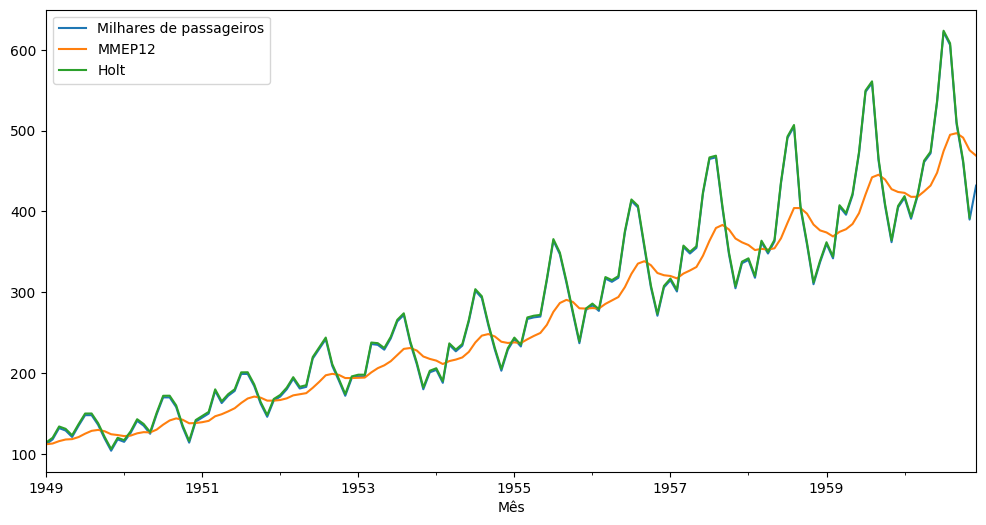

In [66]:
passageiros[['Milhares de passageiros','MMEP12','Holt']].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

**Podemos notar que o método de Holt já apresenta um ajuste bem melhor do que a MMEP!**

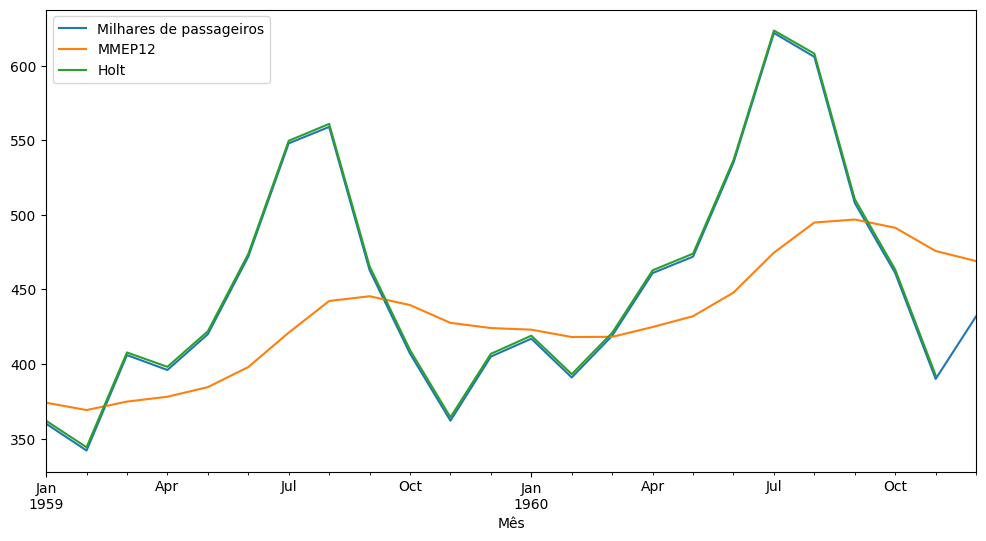

In [67]:
passageiros[['Milhares de passageiros','MMEP12','Holt']].iloc[-24:].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

## Método de Holt-Winters - sazonalidade aditiva ou multiplicativa

In [68]:
# Ajuste do modelo pelo Método de Holt-Winters com sazonalidade aditiva

modelo =  ExponentialSmoothing(passageiros['Milhares de passageiros'],trend='add',seasonal='add',seasonal_periods=12);

ajustado = modelo.fit();

passageiros['Holt-Winters-adit-12'] = ajustado.fittedvalues;

passageiros.head()


,Milhares de passageiros,MMEP12,SES12,Holt,Holt-Winters-adit-12
Mês,,,,,
1949-01-01,112,112.000000,112.000000,114.102394,111.959998
1949-02-01,118,112.923077,112.923077,120.040657,120.193337
1949-03-01,132,115.857988,115.857988,134.001539,134.676835
1949-04-01,129,117.879836,117.879836,131.085845,131.407263
1949-05-01,121,118.359861,118.359861,123.110263,124.643743


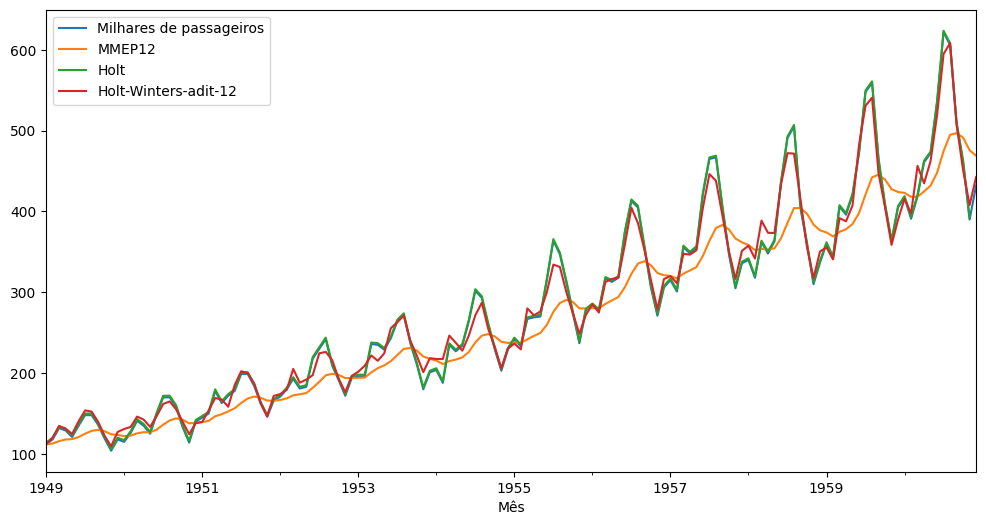

In [69]:
passageiros[['Milhares de passageiros','MMEP12','Holt', 'Holt-Winters-adit-12']].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

In [70]:
# Ajuste do modelo pelo Método de Holt-Winters com sazonalidade multiplicativa

modelo =  ExponentialSmoothing(passageiros['Milhares de passageiros'],trend='add',seasonal='mul',seasonal_periods=12)

ajustado = modelo.fit()

passageiros['Holt-Winters-mult-12'] = ajustado.fittedvalues

passageiros.tail()

,Milhares de passageiros,MMEP12,SES12,Holt,Holt-Winters-adit-12,Holt-Winters-mult-12
Mês,,,,,,
1960-08-01,606,494.898619,494.898619,608.168786,608.231973,625.009023
1960-09-01,508,496.914216,496.914216,510.571382,507.656792,506.744600
1960-10-01,461,491.388952,491.388952,463.313463,451.325360,443.213024
1960-11-01,390,475.790652,475.790652,392.424879,407.931084,393.493719
1960-12-01,432,469.053629,NaN,NaN,442.599519,432.351048


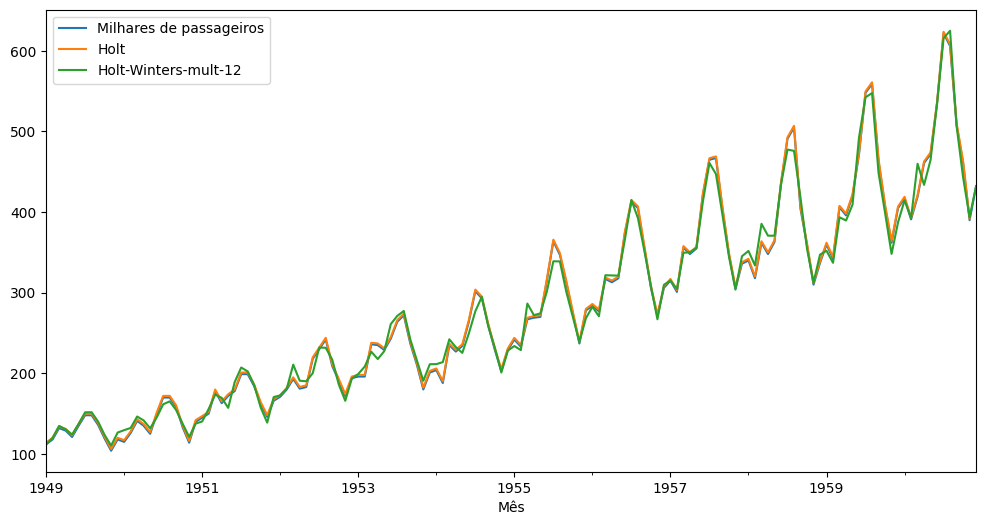

In [71]:
passageiros[['Milhares de passageiros','Holt','Holt-Winters-mult-12']].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

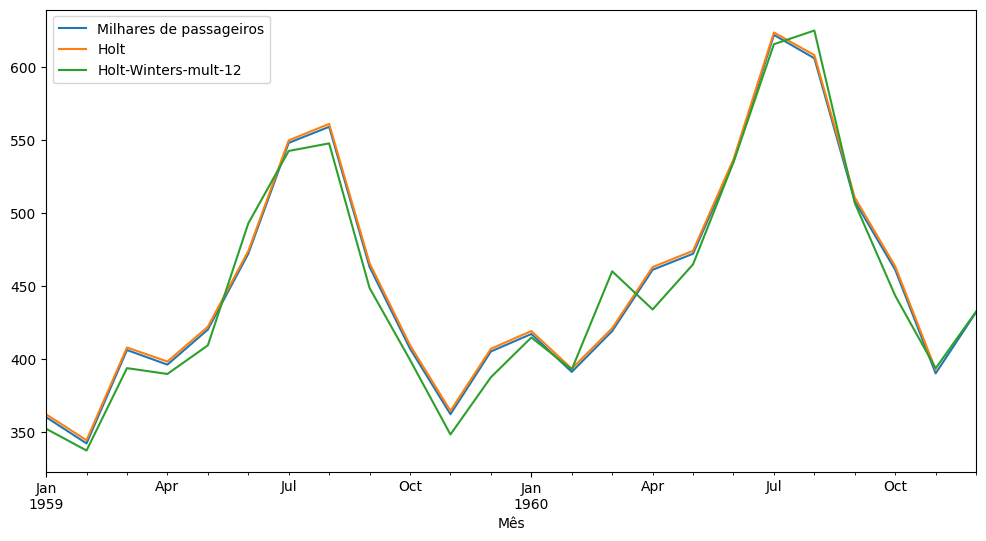

In [72]:
## Olhando somente para os últimos dois anos

passageiros[['Milhares de passageiros','Holt','Holt-Winters-mult-12']].iloc[-24:].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

Aparentemente, o método de Holt está performando melhor para esses dados.

Vamos ver como se comportam na predição de observações futuras?


In [73]:
len(passageiros)

144


## Previsão com o método Holt-Winters

Neste exemplo, usaremos o mesmo conjunto de dados airlines_passengers e os dividiremos em 108 registros de treinamento e 36 registros de teste. Em seguida, avaliaremos o desempenho do modelo.


In [74]:
import pandas as pd
import numpy as np
%matplotlib inline

#pkgdir = '/hdd/MBA/AprendizadoDinamico/Data'
#passageiros = pd.read_csv(f'{pkgdir}/airline_passengers.csv',index_col='Mês',parse_dates=True)

url='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv'
passageiros = pd.read_csv(url, index_col=0, parse_dates=True)


passageiros.index.freq = 'MS'
passageiros.head()

,Milhares de passageiros
Mês,
1949-01-01,112
1949-02-01,118
1949-03-01,132
1949-04-01,129
1949-05-01,121


In [75]:
passageiros.tail()

,Milhares de passageiros
Mês,
1960-08-01,606
1960-09-01,508
1960-10-01,461
1960-11-01,390
1960-12-01,432


In [76]:
passageiros.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 144 entries, 1949-01-01 to 1960-12-01
Freq: MS
Data columns (total 1 columns):
 #   Column                   Non-Null Count  Dtype
---  ------                   --------------  -----
 0   Milhares de passageiros  144 non-null    int64
dtypes: int64(1)
memory usage: 2.2 KB


## Divisão da base em treino e teste

In [77]:
dados_treino = passageiros.iloc[:108] # Dados de treinamento até observação 108, sem incluí-la
dados_teste = passageiros.iloc[108:] # Dados de teste a partir da observação 108

## Ajuste do modelo

In [78]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing

ajustado_HW = ExponentialSmoothing(dados_treino['Milhares de passageiros'],trend='add',seasonal='mul',seasonal_periods=12).fit()


## Avaliação do modelo com predições para dados de teste

In [79]:
predito_HW = ajustado_HW.forecast(36).rename('Previsão Holt-Winters')



In [80]:
predito_HW.head()

1958-01-01    345.593736
1958-02-01    337.453466
1958-03-01    391.270831
1958-04-01    380.630372
1958-05-01    382.065456
Freq: MS, Name: Previsão Holt-Winters, dtype: float64

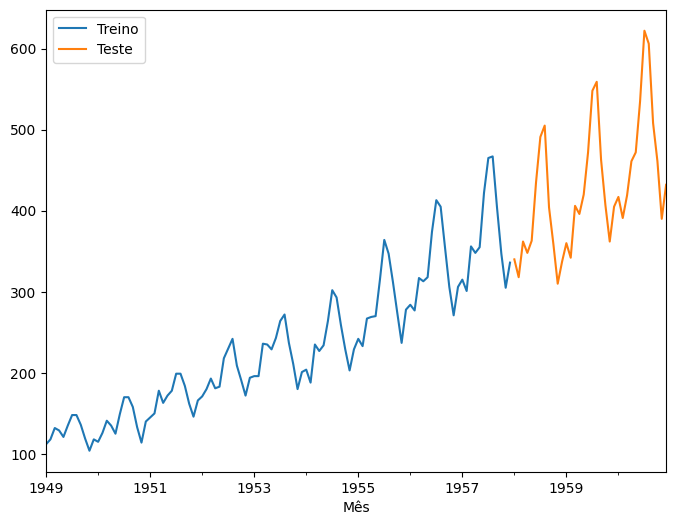

In [81]:
dados_treino['Milhares de passageiros'].plot(legend=True,label='Treino')
dados_teste['Milhares de passageiros'].plot(legend=True,label='Teste',figsize=(8,6));

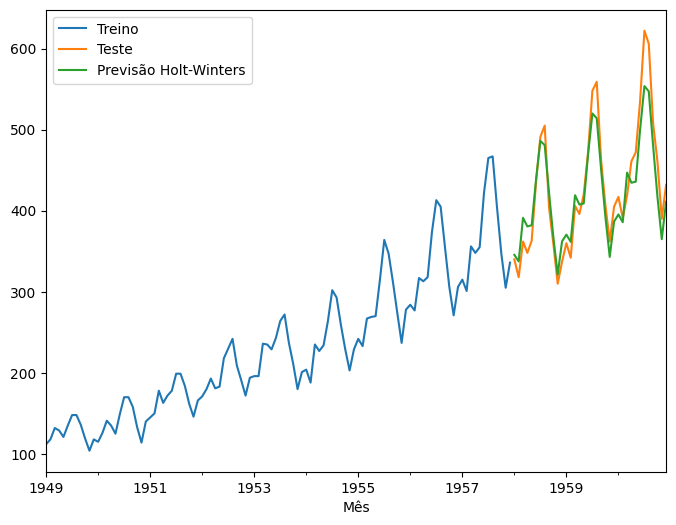

In [82]:
dados_treino['Milhares de passageiros'].plot(legend=True,label='Treino')
dados_teste['Milhares de passageiros'].plot(legend=True,label='Teste',figsize=(8,6))

predito_HW.plot(legend=True,label='Previsão Holt-Winters');



**Exercício: Obtenha a previsão pelo Método de Holt**


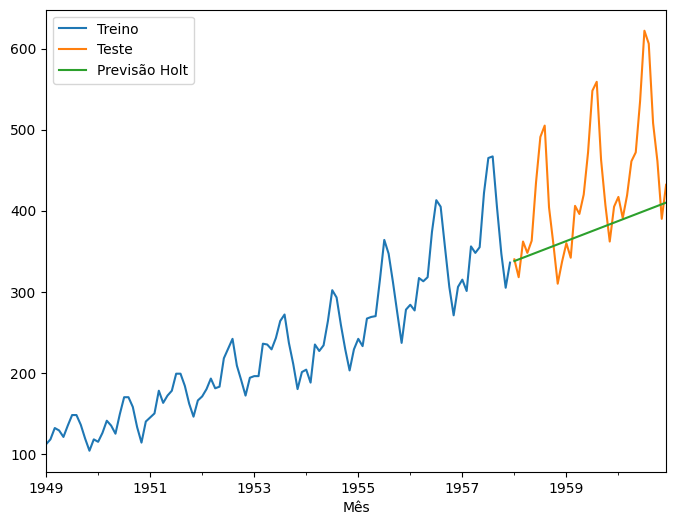

In [83]:
ajustado_H = ExponentialSmoothing(dados_treino['Milhares de passageiros'],trend='add').fit()
predito_H = ajustado_H.forecast(36).rename('Previsão Holt')


dados_treino['Milhares de passageiros'].plot(legend=True,label='Treino')
dados_teste['Milhares de passageiros'].plot(legend=True,label='Teste',figsize=(8,6))
predito_H.plot(legend=True,label='Previsão Holt');

## Métricas de avaliação dos ajustes

Para avaliar a distância da predição para o valor ajustado, usamos o erro quadrático médio e o erro absoluto médio

### Erro quadrático médio


$EQM = MSE = \displaystyle\sum_ {i=t+1}^{k}\frac{({Z_i - \widehat{Z}_i})^2}{k-t-1}$


### Erro absoluto médio

$EAM = MAE =  \displaystyle\sum_ {i=t+1}^{k}\frac{|{Z_t - \widehat{Z}_t}|}{k-t-1}$


In [84]:
from sklearn.metrics import mean_squared_error,mean_absolute_error

In [85]:
mean_absolute_error(dados_teste,predito_HW)

22.318015069498156

In [86]:
mean_absolute_error(dados_teste,predito_H)

63.34330706527367

In [87]:
mean_squared_error(dados_teste,predito_HW)

711.4977943398478

In [88]:
mean_squared_error(dados_teste,predito_H)

7791.631326444609

In [89]:
np.sqrt(mean_squared_error(dados_teste,predito_HW))

26.673915991842065

In [90]:
np.sqrt(mean_squared_error(dados_teste,predito_H))

88.27021766396982

In [91]:
dados_teste.describe()

,Milhares de passageiros
count,36.000000
mean,428.500000
std,79.329152
min,310.000000
25%,362.000000
50%,412.000000
75%,472.000000
max,622.000000


In [92]:
predito_HW.describe()

count     36.000000
mean     420.367852
std       60.201964
min      321.233042
25%      378.095636
50%      410.046789
75%      455.867686
max      553.744256
Name: Previsão Holt-Winters, dtype: float64

In [93]:
predito_H.describe()

count     36.000000
mean     373.968065
std       21.704398
min      337.916485
25%      355.942275
50%      373.968065
75%      391.993855
max      410.019644
Name: Previsão Holt, dtype: float64

## Previsão para os dados da COVID-19

In [94]:
# Dados de COVID-19 no estado de SP

import pandas as pd
import numpy as np
%matplotlib inline

covidSP = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv', index_col=0, parse_dates=True)
covidSP.index = pd.to_datetime(covidSP.index)

In [95]:
covidSP.head()

,confirmed,deaths
date,,
2020-02-26,0,0
2020-02-27,0,0
2020-02-28,1,0
2020-02-29,0,0
2020-03-01,0,0


In [96]:
covidSP.index.min()

Timestamp('2020-02-26 00:00:00')

In [97]:
covidSP.index.max()

Timestamp('2020-12-30 00:00:00')

In [98]:
idx = pd.date_range(start='2020-02-28', end='2020-12-30', freq='D')
idx

DatetimeIndex(['2020-02-28', '2020-02-29', '2020-03-01', '2020-03-02',
               '2020-03-03', '2020-03-04', '2020-03-05', '2020-03-06',
               '2020-03-07', '2020-03-08',
               ...
               '2020-12-21', '2020-12-22', '2020-12-23', '2020-12-24',
               '2020-12-25', '2020-12-26', '2020-12-27', '2020-12-28',
               '2020-12-29', '2020-12-30'],
              dtype='datetime64[ns]', length=307, freq='D')

In [99]:
covidSP = covidSP.reindex(idx)
covidSP.head(30)

,confirmed,deaths
2020-02-28,1.0,0.0
2020-02-29,0.0,0.0
2020-03-01,0.0,0.0
2020-03-02,0.0,0.0
2020-03-03,0.0,0.0
2020-03-04,1.0,0.0
2020-03-05,3.0,0.0
2020-03-06,4.0,0.0
2020-03-07,3.0,0.0
2020-03-08,3.0,0.0


In [100]:
covidSP.fillna(0,inplace=True)
covidSP.head(30)

,confirmed,deaths
2020-02-28,1.0,0.0
2020-02-29,0.0,0.0
2020-03-01,0.0,0.0
2020-03-02,0.0,0.0
2020-03-03,0.0,0.0
2020-03-04,1.0,0.0
2020-03-05,3.0,0.0
2020-03-06,4.0,0.0
2020-03-07,3.0,0.0
2020-03-08,3.0,0.0


In [101]:
len(covidSP)

307

In [102]:
covidSP.index

DatetimeIndex(['2020-02-28', '2020-02-29', '2020-03-01', '2020-03-02',
               '2020-03-03', '2020-03-04', '2020-03-05', '2020-03-06',
               '2020-03-07', '2020-03-08',
               ...
               '2020-12-21', '2020-12-22', '2020-12-23', '2020-12-24',
               '2020-12-25', '2020-12-26', '2020-12-27', '2020-12-28',
               '2020-12-29', '2020-12-30'],
              dtype='datetime64[ns]', length=307, freq='D')

## Divisão da base em treino e teste


In [103]:
dados_treino = covidSP.iloc[:286] # Dados de treinamento até observação 240, sem incluí-la
dados_teste = covidSP.iloc[286:] # Dados de teste a partir da observação 240

In [104]:
dados_treino

,confirmed,deaths
2020-02-28,1.0,0.0
2020-02-29,0.0,0.0
2020-03-01,0.0,0.0
2020-03-02,0.0,0.0
2020-03-03,0.0,0.0
...,...,...
2020-12-05,8938.0,181.0
2020-12-06,2675.0,46.0
2020-12-07,1116.0,25.0
2020-12-08,7923.0,242.0


In [105]:
## Ajuste do modelo
from statsmodels.tsa.holtwinters import ExponentialSmoothing


ajustado = ExponentialSmoothing(dados_treino['deaths'],trend='add',seasonal='add',seasonal_periods=7).fit()

In [106]:
# Previsão

predito = ajustado.forecast(21).rename('Previsão Holt-Winters')

In [107]:
predito.index = covidSP.index[286:]
predito.index

DatetimeIndex(['2020-12-10', '2020-12-11', '2020-12-12', '2020-12-13',
               '2020-12-14', '2020-12-15', '2020-12-16', '2020-12-17',
               '2020-12-18', '2020-12-19', '2020-12-20', '2020-12-21',
               '2020-12-22', '2020-12-23', '2020-12-24', '2020-12-25',
               '2020-12-26', '2020-12-27', '2020-12-28', '2020-12-29',
               '2020-12-30'],
              dtype='datetime64[ns]', freq='D')

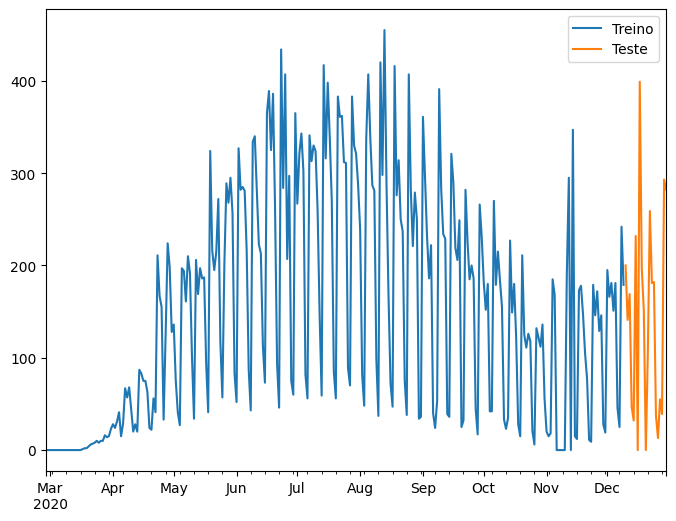

In [108]:
dados_treino['deaths'].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6));


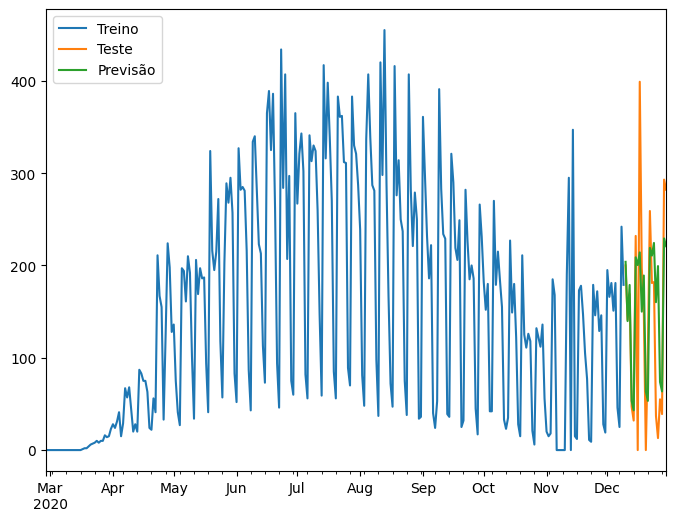

In [109]:
dados_treino['deaths'].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6))
predito.plot(legend=True,label='Previsão');

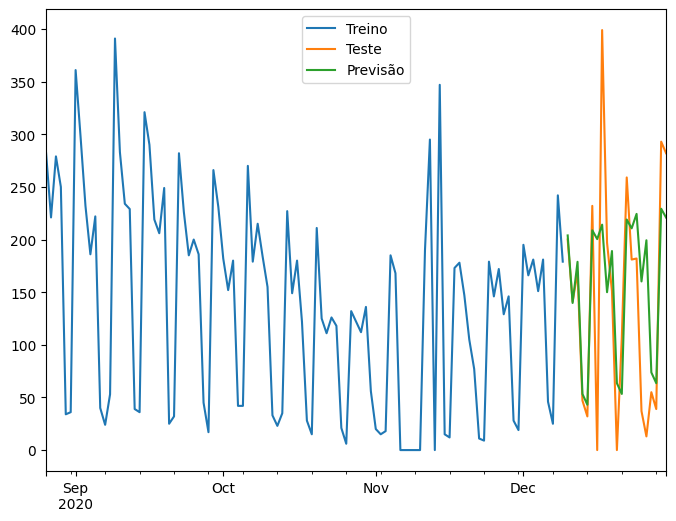

In [110]:
dados_treino['deaths'].iloc[180:].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6))
predito.plot(legend=True,label='Previsão');

In [111]:
## Ajuste do modelo com sazonalidade multiplicativa
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Precisamos considerar somente os dados positivos, mas vamos considerar os dados entre o início de maio e o início de setembro

In [112]:
covidSP = covidSP.loc['2020-05-01':'2020-09-01']

In [113]:
len(covidSP)

124

In [114]:
dados_treino = covidSP.iloc[:103] # Dados de treinamento até observação 240, sem incluí-la
dados_teste = covidSP.iloc[103:] # Dados de teste a partir da observação 240

In [115]:
ajustado = ExponentialSmoothing(dados_treino['deaths'],trend='add',seasonal='mul',seasonal_periods=7).fit()

In [116]:
predito = ajustado.forecast(21).rename('Previsão Holt-Winters')
predito.index = covidSP.index[103:]


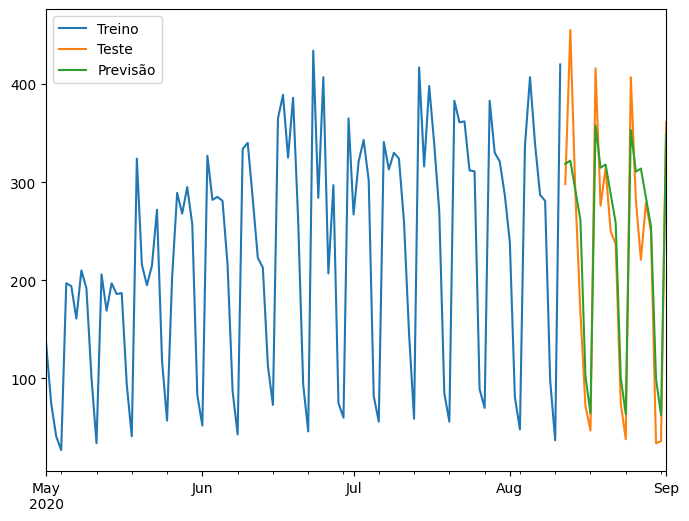

In [117]:
dados_treino['deaths'].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6))
predito.plot(legend=True,label='Previsão');

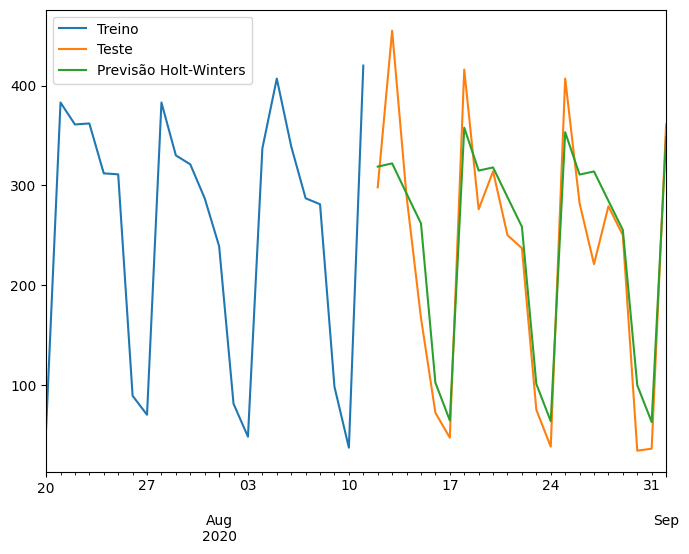

In [118]:
dados_treino['deaths'].iloc[80:].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6))
predito.plot(legend=True,label='Previsão Holt-Winters');

# Métodos de Suavização de Holt e Holt-Winters

por **Cibele Russo**

Baseado em

- MORETTIN, P. A.; TOLOI, C. M. C.. Análise de séries temporais: modelos lineares univariados. 3. ed. São Paulo: Blucher, 2018.

- EHLERS, R.S. Análise de Séries Temporais. ICMC USP. 2009.

Métodos de Holt e Holt-Winters:

- COWPERTWAIT, P. S.P., METCALFE, A. V. Introductory time series with R. Springer New York, NY, 2009.

- HYNDMAN, R. J., ATHANASOPOULOS, G.; Forecasting: principle and practice: O Texts; 2nd edition. 2018. Material sobre Holt-Winters disponível em https://otexts.com/fpp2/holt-winters.html. Acesso em 09/07/2022.

- HOLT, C.  Forecasting trends and seasonals by exponentially weighted averages. ONR. Memorandum no.52, p. 5-10, Carregie Institute of Technology.1957.

- WINTERS, P.R. Forecasting sales by exponentially weighted moving averages. Management Science, 6:324–342. 1960. DOI: https://doi.org/10.1287/mnsc.6.3.324

Implementações:

- BROWNLEE, J. Introduction to time series forecasting with python: how to prepare data and develop models to predict the future. Machine Learning Mastery, 2017.

- https://www.statsmodels.org/devel/generated/statsmodels.tsa.holtwinters.ExponentialSmoothing.html

- https://machinelearningmastery.com/exponential-smoothing-for-time-series-forecasting-in-python/

## MMS e MMEP

Na aula anterior, vimos métodos de suavização médias móveis e médias móveis exponencialmente ponderadas considerando a seguinte decomposição de uma série temporal $\{Z_t\}$

$$Z_t = \mu_t + a_t, \mbox{ para } t=1,\ldots, N$$

com $E(a_t)=0$ e $Var(a_t) = \sigma^2$ e $\mu_t$ um parâmetro desconhecido.

Esses métodos não levam em consideração que a série tem uma componente de tendência.

São técnicas descritivas não aconselháveis para fazer previsão.


**Queremos estimar a tendência e a sazonalidade, e com isso já podemos fazer previsões!**


Considere inicialmente que a série temporal seja composta localmente por soma de nível, tendência e erro aleatório (ruído), com média zero e variância constante $\sigma^2_a$, isto é

$$Z_t = \mu_t + T_t + a_t, \mbox{ com  } t=1,\ldots, N.$$



## Método de Holt

Parecido com a MMEP, porém utiliza uma nova constante para modelar a **tendência**

Os valores do nível e da tendência da série, no instante $t$, serão estimados por

$\overline{Z}_t = A Z_t + (1-A)(\overline{Z}_{t-1} + \widehat{T}_{t-1}),\ 0<A<1 \mbox{ e } t=2,\ldots,N$

$\widehat{T}_t = C (\overline{Z}_t - \overline{Z}_{t-1}) + (1-C) \widehat{T}_{t-1},\ 0<C<1 \mbox{ e } t=2,\ldots,N,$

respectivamente, $A$ e $C$ são denominadas constantes de suavização.


### Previsão

A previsão para o valor $Z_{t+h}$ com origem em $t$ é dada por

$\widehat{Z}_{t} (h)= \overline{Z}_t + h \widehat{T}_{t},\ \forall h>0$

ou seja, adiciona-se ao valor básico $\overline{Z}_t$ a tendência multiplicada pelo número de passos à frente que se deseja prever $(h)$.


Para atualizar a previsão, quando tivermos uma nova observação $Z_{t+1}$, podemos fazer

$\overline{Z}_{t+1} = A Z_{t+1} + (1-A)(\overline{Z}_{t} + \widehat{T}_{t}),$

$\widehat{T}_{t+1} = C (\overline{Z}_{t+1} - \overline{Z}_{t}) + (1-C) \widehat{T}_{t}$

e a nova previsão do valor $Z_{t+h}$ dado que temos uma nova observação $Z_{t+1}$ será

$$\widehat{Z}_{t+1}(h-1) = \overline{Z}_{t+1} + (h-1)\widehat{T}_{t+1}.$$

Precisamos assumir hipóteses sobre os valores iniciais, por exemplo, assumir que $\widehat{T}_2 = Z_2-Z_1$ e $\overline{Z}_2 = Z_2$. Se $Z_t$ for gerado por um processo $ARIMA(0,2,2)$, essa previsão será ótima.


As constantes $A$ e $C$ são escolhidas de forma que a soma dos erros quadráticos de previsão seja mínimo.

## Método de Holt-Winters

Para séries com padrão de comportamento mais complexo, existem outras formas de suavização, tais com os métodos de Holt-Winters.

Considere uma série sazonal com período $s$.

### Modelo com sazonalidade multiplicativa e tendência aditiva

$$Z_t = \mu_t F_t + T_t + a_t, \mbox{ com  } t=1,\ldots, N.$$

As três equações de suavização são dadas por

$\widehat{F}_t = D \left(\displaystyle\frac{Z_t}{\overline{Z}_t}\right) + (1-D)\widehat{F}_{t-s}, 0<D<1, t=s+1,\ldots,N$

$\overline{Z}_t = A  \left(\displaystyle\frac{Z_t}{\widehat{F}_{t-s}}\right) + (1-A)(\overline{Z}_{t-1} + \widehat{T}_{t-1}),\ 0<A<1 \mbox{ e } t=s+1,\ldots,N$

$\widehat{T}_t = C (\overline{Z}_t - \overline{Z}_{t-1}) + (1-C) \widehat{T}_{t-1},\ 0<C<1 \mbox{ e } t=s+1,\ldots,N,$

e representam estimativas do fator sazonal, do nível e da tendência, respectivamente, e $A$, $C$ e $D$ são constantes de suavização.




### Previsão


$\widehat{Z}_t(h) = (\overline{Z}_t+h \widehat{T}_t)\widehat{F}_{t+h-s}, h=1,2,\ldots,s$

$\widehat{Z}_t(h) = (\overline{Z}_t+h \widehat{T}_t)\widehat{F}_{t+h-2s}, h=s+1,\ldots,2s$

$\vdots \ \  \ \  =\ \  \ \   \vdots$

onde $\overline{Z}_t$, $\widehat{F}_t$ e $\widehat{T}_t$ são obtidos das equações do método.

Para fazermos atualizações das previsões, quando temos uma nova observação $Z_{t+1}$, utilizamos os valores

$\widehat{F}_{t+1} = D \displaystyle\left(\frac{Z_{t+1}}{\overline{Z}_{t+1}}\right) + (1-D)\widehat{F}_{{t+1}-s},$

$\overline{Z}_{t+1} = A  \displaystyle\left(\frac{Z_{t+1}}{\widehat{F}_{{t+1}-s}}\right) + (1-A)(\overline{Z}_{t} + \widehat{T}_{t}),$

$\widehat{T}_{t+1} = C (\overline{Z}_{t+1} - \overline{Z}_{t}) + (1-C) \widehat{T}_{t},$

e a nova previsão para a observação $Z_{t+h}$ será

$\widehat{Z}_{t+1}(h-1) = (\overline{Z}_{{t+1}}+(h-1)\widehat{T}_{t+1})\widehat{F}_{t+1+h-s}, h=1,2,\ldots,s+1$

$\widehat{Z}_{t+1}(h-1) = (\overline{Z}_{{t+1}}+(h-1)\widehat{T}_{t+1})\widehat{F}_{t+1+h-2s}, h=s+2,\ldots, 2s+1$


Também é necessário fazer suposições sobre os valores iniciais para o processo.

### Modelo com sazonalidade e tendência aditivas

$$Z_t = \mu_t + T_t +F_t+ a_t, \mbox{ com  } t=1,\ldots, N.$$

As estimativas do fator sazonal, do nível e da tendência da série são dadas por

$\widehat{F}_t = D   ({Z}_t - \overline{Z}_{t})+ (1-D)\widehat{F}_{t-s}, 0<D<1, t=s+1,\ldots,N$

$\overline{Z}_t = A  (Z_t - \widehat{F}_{t-s}) + (1-A)(\overline{Z}_{t-1} + \widehat{T}_{t-1}),\ 0<A<1 \mbox{ e } t=s+1,\ldots,N$

$\widehat{T}_t = C (\overline{Z}_t - \overline{Z}_{t-1}) + (1-C) \widehat{T}_{t-1},\ 0<C<1 \mbox{ e } t=s+1,\ldots,N,$

respectivamente, e $A$, $C$ e $D$ são constantes de suavização e são estimadas de forma que minimizem a soma dos quadrados dos erros dos ajustes.

### Previsão


$\widehat{Z}_t(h) = \overline{Z}_t+h \widehat{T}_t + \widehat{F}_{t+h-s}, h=1,2,\ldots,s$

$\widehat{Z}_t(h) = \overline{Z}_t+h \widehat{T}_t + \widehat{F}_{t+h-2s}, h=s+1,\ldots,2s$

$\vdots \ \  \ \  =\ \  \ \   \vdots$

onde $\overline{Z}_t$, $\widehat{F}_t$ e $\widehat{T}_t$ são obtidos das equações do método.

Para fazermos atualizações das previsões, quando temos uma nova observação $Z_{t+1}$, utilizamos os valores

$\widehat{F}_{t+1} = D   (Z_{t+1} - \overline{Z}_{t+1})+ (1-D)\widehat{F}_{t+1-s}, $

$\overline{Z}_{t+1} = A  (Z_{t+1} - \widehat{F}_{{t+1}-s}) + (1-A)(\overline{Z}_{{t}} + \widehat{T}_{{t}}),$

$\widehat{T}_{t+1} = C (\overline{Z}_{t+1} - \overline{Z}_{t}) + (1-C) \widehat{T}_{t},$


e a nova previsão para a observação $Z_{t+h}$ será

$\widehat{Z}_{t+1}(h-1) = \overline{Z}_{{t+1}}+(h-1)\widehat{T}_{t+1} + \widehat{F}_{t+1+h-s}, h=1,2,\ldots,s+1$

$\widehat{Z}_{t+1}(h-1) = \overline{Z}_{{t+1}}+(h-1)\widehat{T}_{t+1}+\widehat{F}_{t+1+h-2s}, h=s+2,\ldots, 2s+1$

Também é necessário fazer suposições sobre os valores iniciais para o processo.

Se $Z_t$ for gerado por um processo $ARIMA$, essa previsão será ótima.



## Visão geral de vantagens e desvantagens dos métodos de suavização

### Média móvel simples

- Simples implementação;

- Aplicável mesmo com um número pequeno de observações;

- Flexibilidade de acordo com o tamanho da janela

Porém

- Método descritivo e não recomendável para previsões

- Não leva em consideração a componente de tendência na série


### Média móvel exponencialmente ponderada

- Fácil compreensão e aplicabilidade;

- Necessidade de armazenar somente $Z_t$, $\overline{Z}_t$ e $\alpha$

Porém

- Método descritivo e não recomendável para previsões

- Não leva em consideração a componente de tendência na série

### Método de Holt

- Pode ser usado para prever séries que tem tendência

- Apresenta um nível maior de dificuldade para encontrar os valores apropriados para as constantes de suavização $A$ e $C$, em geral que minimizem a soma dos quadrados dos erros dos ajustes

### Método de Holt-Winters

- Pode ser usado para prever séries que tem tendência e sazonalidade, seja ela aditiva ou multiplicativa

Porém

- Impossibilidade e dificuldade para estudar propriedades estatísticas como média e variância das previsões, e consequentemente construção de intervalos de confiança para as previsões

- Nível maior de dificuldade para encontrar os valores apropriados para as constantes de suavização $A$, $C$ e $D$, em geral que minimizem a soma dos quadrados dos erros dos ajustes

### Aplicação: dados de passageiros aéreos

In [60]:
import pandas as pd
import numpy as np
%matplotlib inline


# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")


In [61]:
passageiros = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv', index_col=0, parse_dates=True)
passageiros.head()

,Milhares de passageiros
Mês,
1949-01-01,112
1949-02-01,118
1949-03-01,132
1949-04-01,129
1949-05-01,121


In [62]:
passageiros.index

DatetimeIndex(['1949-01-01', '1949-02-01', '1949-03-01', '1949-04-01',
               '1949-05-01', '1949-06-01', '1949-07-01', '1949-08-01',
               '1949-09-01', '1949-10-01',
               ...
               '1960-03-01', '1960-04-01', '1960-05-01', '1960-06-01',
               '1960-07-01', '1960-08-01', '1960-09-01', '1960-10-01',
               '1960-11-01', '1960-12-01'],
              dtype='datetime64[ns]', name='Mês', length=144, freq=None)

**Estabeleça a frequência do DatetimeIndex!**

Para construir um modelo de suavização Holt-Winters, o pacote statsmodels precisa saber a frequência dos dados. Para os dados de passageiros aéreos, as observações são coletadas no início do mês, usaremos MS.

Veja <a href='http://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#offset-aliases'>aqui</a> uma lista de possibilidades.

In [63]:
passageiros.index.freq = 'MS'
passageiros.index

DatetimeIndex(['1949-01-01', '1949-02-01', '1949-03-01', '1949-04-01',
               '1949-05-01', '1949-06-01', '1949-07-01', '1949-08-01',
               '1949-09-01', '1949-10-01',
               ...
               '1960-03-01', '1960-04-01', '1960-05-01', '1960-06-01',
               '1960-07-01', '1960-08-01', '1960-09-01', '1960-10-01',
               '1960-11-01', '1960-12-01'],
              dtype='datetime64[ns]', name='Mês', length=144, freq='MS')


## Suavização exponencial simples

Uma variação da função Holt-Winters de statsmodels apresenta a Suavização exponencial simples, que fornece os mesmos cálculos da média móvel exponencialmente ponderada do método .ewm do pandas que vimos na última aula.

 $\begin{split}\overline{Z}_0 &= Z_1 \\
\overline{Z}_t &= (1 - \alpha) Z_{t-1} + \alpha Z_t,\end{split}$


In [64]:
# É possível ajustar a MMEP usando o pacote statsmodels.tsa.holtwinters e a função SimpleExpSmoothing

from statsmodels.tsa.holtwinters import SimpleExpSmoothing

span = 12
alpha = 2/(span+1)

passageiros['MMEP12'] = passageiros['Milhares de passageiros'].ewm(alpha=alpha,adjust=False).mean()
passageiros['SES12'] = SimpleExpSmoothing(passageiros['Milhares de passageiros']).fit(smoothing_level=alpha,optimized=False).fittedvalues.shift(-1)
passageiros.head()

,Milhares de passageiros,MMEP12,SES12
Mês,,,
1949-01-01,112,112.000000,112.000000
1949-02-01,118,112.923077,112.923077
1949-03-01,132,115.857988,115.857988
1949-04-01,129,117.879836,117.879836
1949-05-01,121,118.359861,118.359861


## Método de Holt

In [65]:
# Método de Holt

from statsmodels.tsa.api import ExponentialSmoothing


modelo =  ExponentialSmoothing(passageiros['Milhares de passageiros'], trend='add');

ajustado = modelo.fit();

passageiros['Holt'] = ajustado.fittedvalues.shift(-1);

passageiros.head()



,Milhares de passageiros,MMEP12,SES12,Holt
Mês,,,,
1949-01-01,112,112.000000,112.000000,114.102394
1949-02-01,118,112.923077,112.923077,120.040657
1949-03-01,132,115.857988,115.857988,134.001539
1949-04-01,129,117.879836,117.879836,131.085845
1949-05-01,121,118.359861,118.359861,123.110263


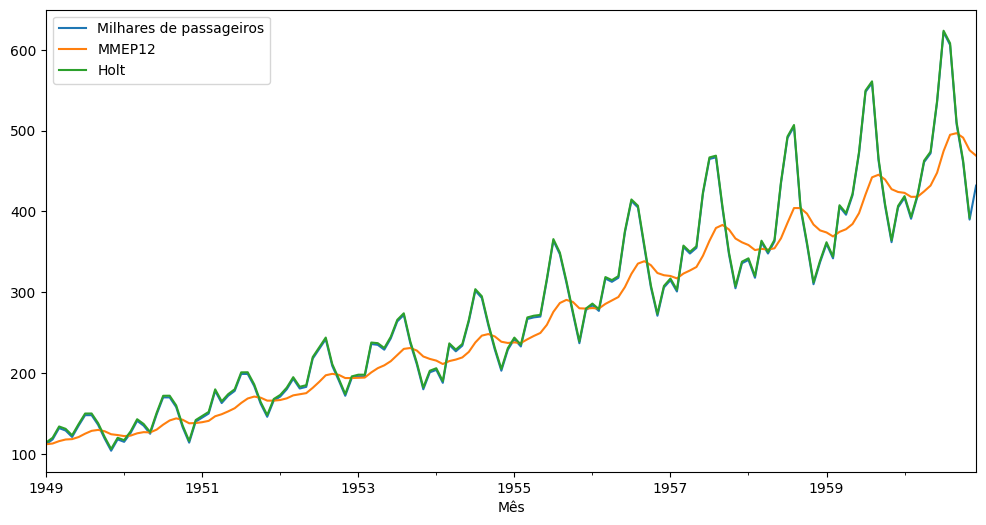

In [66]:
passageiros[['Milhares de passageiros','MMEP12','Holt']].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

**Podemos notar que o método de Holt já apresenta um ajuste bem melhor do que a MMEP!**

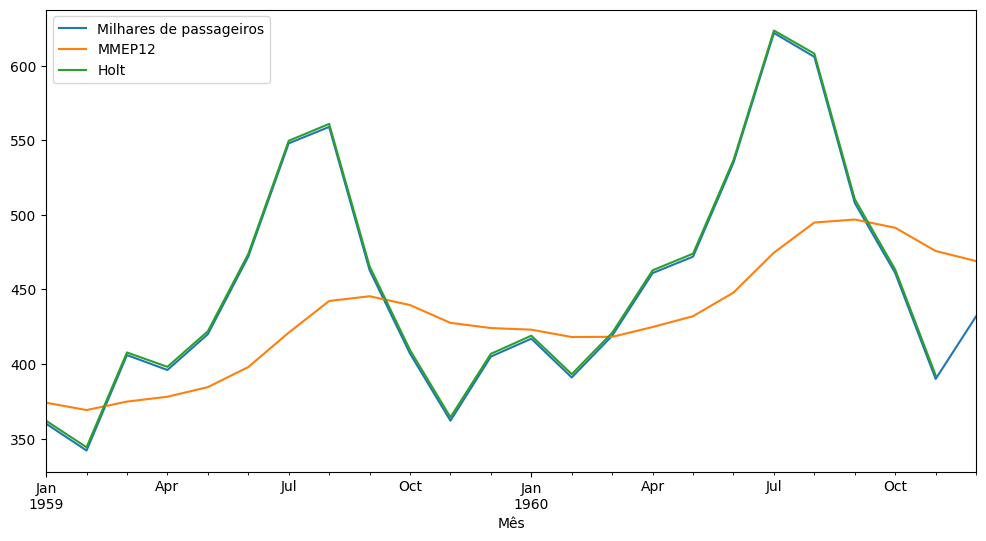

In [67]:
passageiros[['Milhares de passageiros','MMEP12','Holt']].iloc[-24:].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

## Método de Holt-Winters - sazonalidade aditiva ou multiplicativa

In [68]:
# Ajuste do modelo pelo Método de Holt-Winters com sazonalidade aditiva

modelo =  ExponentialSmoothing(passageiros['Milhares de passageiros'],trend='add',seasonal='add',seasonal_periods=12);

ajustado = modelo.fit();

passageiros['Holt-Winters-adit-12'] = ajustado.fittedvalues;

passageiros.head()


,Milhares de passageiros,MMEP12,SES12,Holt,Holt-Winters-adit-12
Mês,,,,,
1949-01-01,112,112.000000,112.000000,114.102394,111.959998
1949-02-01,118,112.923077,112.923077,120.040657,120.193337
1949-03-01,132,115.857988,115.857988,134.001539,134.676835
1949-04-01,129,117.879836,117.879836,131.085845,131.407263
1949-05-01,121,118.359861,118.359861,123.110263,124.643743


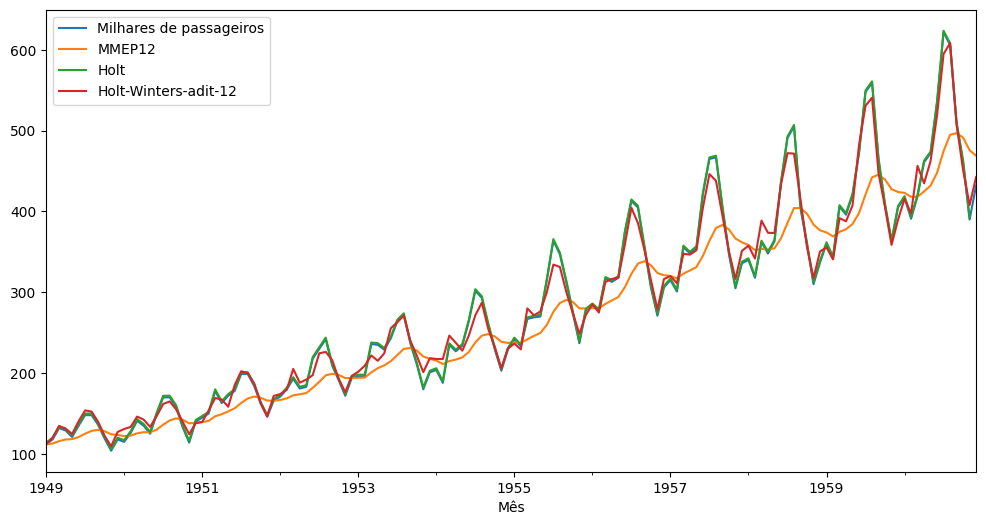

In [69]:
passageiros[['Milhares de passageiros','MMEP12','Holt', 'Holt-Winters-adit-12']].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

In [70]:
# Ajuste do modelo pelo Método de Holt-Winters com sazonalidade multiplicativa

modelo =  ExponentialSmoothing(passageiros['Milhares de passageiros'],trend='add',seasonal='mul',seasonal_periods=12)

ajustado = modelo.fit()

passageiros['Holt-Winters-mult-12'] = ajustado.fittedvalues

passageiros.tail()

,Milhares de passageiros,MMEP12,SES12,Holt,Holt-Winters-adit-12,Holt-Winters-mult-12
Mês,,,,,,
1960-08-01,606,494.898619,494.898619,608.168786,608.231973,625.009023
1960-09-01,508,496.914216,496.914216,510.571382,507.656792,506.744600
1960-10-01,461,491.388952,491.388952,463.313463,451.325360,443.213024
1960-11-01,390,475.790652,475.790652,392.424879,407.931084,393.493719
1960-12-01,432,469.053629,NaN,NaN,442.599519,432.351048


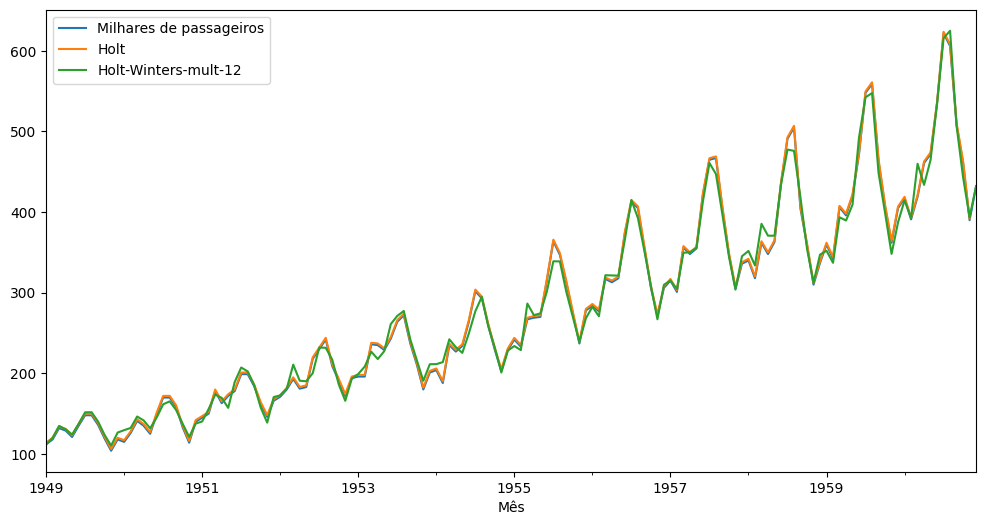

In [71]:
passageiros[['Milhares de passageiros','Holt','Holt-Winters-mult-12']].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

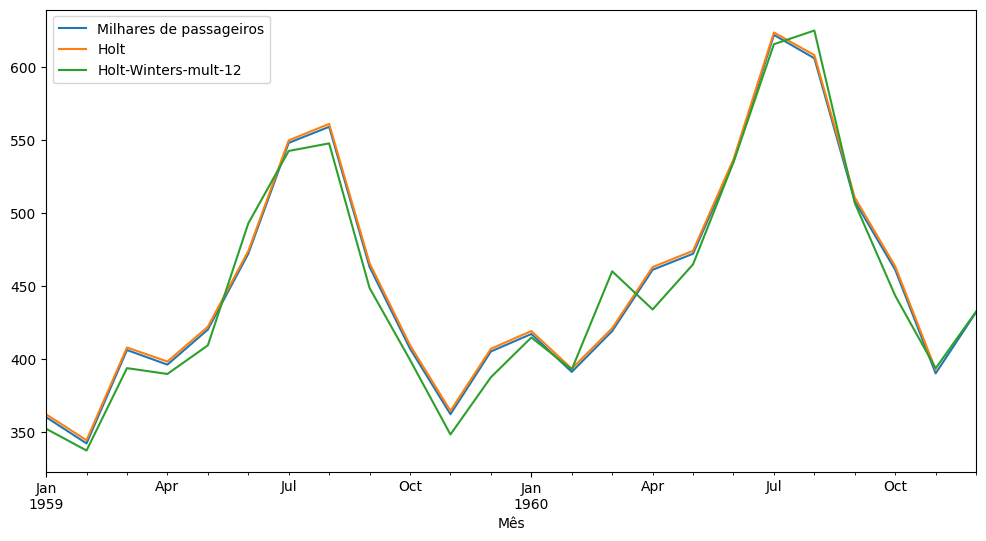

In [72]:
## Olhando somente para os últimos dois anos

passageiros[['Milhares de passageiros','Holt','Holt-Winters-mult-12']].iloc[-24:].plot(figsize=(12,6)).autoscale(axis='x',tight=True);

Aparentemente, o método de Holt está performando melhor para esses dados.

Vamos ver como se comportam na predição de observações futuras?


In [73]:
len(passageiros)

144


## Previsão com o método Holt-Winters

Neste exemplo, usaremos o mesmo conjunto de dados airlines_passengers e os dividiremos em 108 registros de treinamento e 36 registros de teste. Em seguida, avaliaremos o desempenho do modelo.


In [74]:
import pandas as pd
import numpy as np
%matplotlib inline

#pkgdir = '/hdd/MBA/AprendizadoDinamico/Data'
#passageiros = pd.read_csv(f'{pkgdir}/airline_passengers.csv',index_col='Mês',parse_dates=True)

url='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv'
passageiros = pd.read_csv(url, index_col=0, parse_dates=True)


passageiros.index.freq = 'MS'
passageiros.head()

,Milhares de passageiros
Mês,
1949-01-01,112
1949-02-01,118
1949-03-01,132
1949-04-01,129
1949-05-01,121


In [75]:
passageiros.tail()

,Milhares de passageiros
Mês,
1960-08-01,606
1960-09-01,508
1960-10-01,461
1960-11-01,390
1960-12-01,432


In [76]:
passageiros.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 144 entries, 1949-01-01 to 1960-12-01
Freq: MS
Data columns (total 1 columns):
 #   Column                   Non-Null Count  Dtype
---  ------                   --------------  -----
 0   Milhares de passageiros  144 non-null    int64
dtypes: int64(1)
memory usage: 2.2 KB


## Divisão da base em treino e teste

In [77]:
dados_treino = passageiros.iloc[:108] # Dados de treinamento até observação 108, sem incluí-la
dados_teste = passageiros.iloc[108:] # Dados de teste a partir da observação 108

## Ajuste do modelo

In [78]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing

ajustado_HW = ExponentialSmoothing(dados_treino['Milhares de passageiros'],trend='add',seasonal='mul',seasonal_periods=12).fit()


## Avaliação do modelo com predições para dados de teste

In [79]:
predito_HW = ajustado_HW.forecast(36).rename('Previsão Holt-Winters')



In [80]:
predito_HW.head()

1958-01-01    345.593736
1958-02-01    337.453466
1958-03-01    391.270831
1958-04-01    380.630372
1958-05-01    382.065456
Freq: MS, Name: Previsão Holt-Winters, dtype: float64

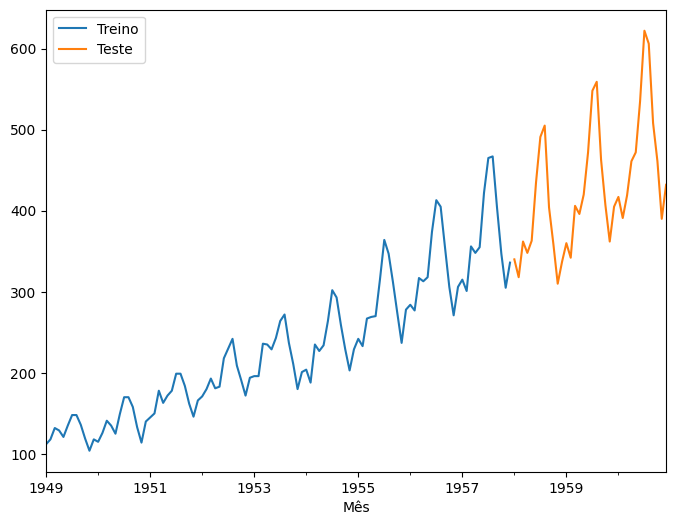

In [81]:
dados_treino['Milhares de passageiros'].plot(legend=True,label='Treino')
dados_teste['Milhares de passageiros'].plot(legend=True,label='Teste',figsize=(8,6));

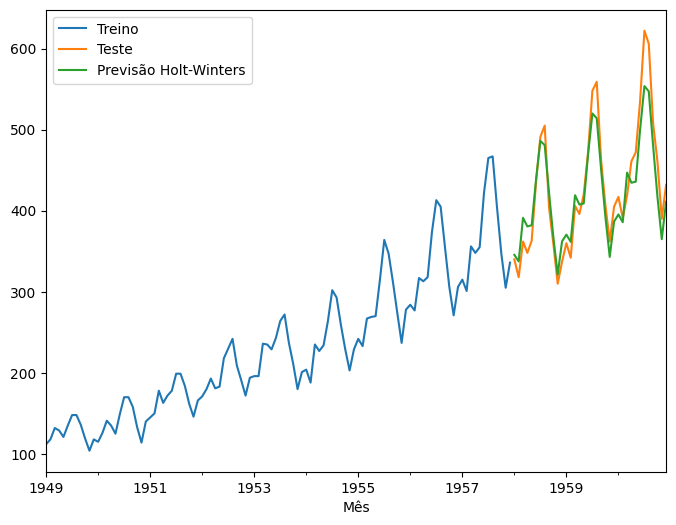

In [82]:
dados_treino['Milhares de passageiros'].plot(legend=True,label='Treino')
dados_teste['Milhares de passageiros'].plot(legend=True,label='Teste',figsize=(8,6))

predito_HW.plot(legend=True,label='Previsão Holt-Winters');



**Exercício: Obtenha a previsão pelo Método de Holt**


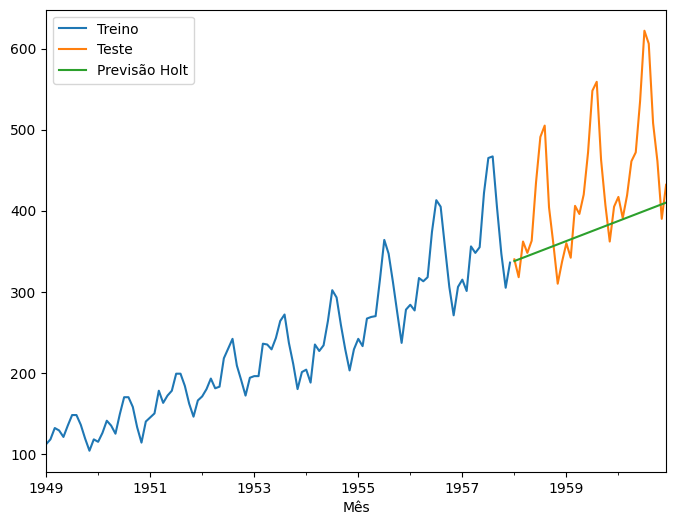

In [83]:
ajustado_H = ExponentialSmoothing(dados_treino['Milhares de passageiros'],trend='add').fit()
predito_H = ajustado_H.forecast(36).rename('Previsão Holt')


dados_treino['Milhares de passageiros'].plot(legend=True,label='Treino')
dados_teste['Milhares de passageiros'].plot(legend=True,label='Teste',figsize=(8,6))
predito_H.plot(legend=True,label='Previsão Holt');

## Métricas de avaliação dos ajustes

Para avaliar a distância da predição para o valor ajustado, usamos o erro quadrático médio e o erro absoluto médio

### Erro quadrático médio


$EQM = MSE = \displaystyle\sum_ {i=t+1}^{k}\frac{({Z_i - \widehat{Z}_i})^2}{k-t-1}$


### Erro absoluto médio

$EAM = MAE =  \displaystyle\sum_ {i=t+1}^{k}\frac{|{Z_t - \widehat{Z}_t}|}{k-t-1}$


In [84]:
from sklearn.metrics import mean_squared_error,mean_absolute_error

In [85]:
mean_absolute_error(dados_teste,predito_HW)

22.318015069498156

In [86]:
mean_absolute_error(dados_teste,predito_H)

63.34330706527367

In [87]:
mean_squared_error(dados_teste,predito_HW)

711.4977943398478

In [88]:
mean_squared_error(dados_teste,predito_H)

7791.631326444609

In [89]:
np.sqrt(mean_squared_error(dados_teste,predito_HW))

26.673915991842065

In [90]:
np.sqrt(mean_squared_error(dados_teste,predito_H))

88.27021766396982

In [91]:
dados_teste.describe()

,Milhares de passageiros
count,36.000000
mean,428.500000
std,79.329152
min,310.000000
25%,362.000000
50%,412.000000
75%,472.000000
max,622.000000


In [92]:
predito_HW.describe()

count     36.000000
mean     420.367852
std       60.201964
min      321.233042
25%      378.095636
50%      410.046789
75%      455.867686
max      553.744256
Name: Previsão Holt-Winters, dtype: float64

In [93]:
predito_H.describe()

count     36.000000
mean     373.968065
std       21.704398
min      337.916485
25%      355.942275
50%      373.968065
75%      391.993855
max      410.019644
Name: Previsão Holt, dtype: float64

## Previsão para os dados da COVID-19

In [94]:
# Dados de COVID-19 no estado de SP

import pandas as pd
import numpy as np
%matplotlib inline

covidSP = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv', index_col=0, parse_dates=True)
covidSP.index = pd.to_datetime(covidSP.index)

In [95]:
covidSP.head()

,confirmed,deaths
date,,
2020-02-26,0,0
2020-02-27,0,0
2020-02-28,1,0
2020-02-29,0,0
2020-03-01,0,0


In [96]:
covidSP.index.min()

Timestamp('2020-02-26 00:00:00')

In [97]:
covidSP.index.max()

Timestamp('2020-12-30 00:00:00')

In [98]:
idx = pd.date_range(start='2020-02-28', end='2020-12-30', freq='D')
idx

DatetimeIndex(['2020-02-28', '2020-02-29', '2020-03-01', '2020-03-02',
               '2020-03-03', '2020-03-04', '2020-03-05', '2020-03-06',
               '2020-03-07', '2020-03-08',
               ...
               '2020-12-21', '2020-12-22', '2020-12-23', '2020-12-24',
               '2020-12-25', '2020-12-26', '2020-12-27', '2020-12-28',
               '2020-12-29', '2020-12-30'],
              dtype='datetime64[ns]', length=307, freq='D')

In [99]:
covidSP = covidSP.reindex(idx)
covidSP.head(30)

,confirmed,deaths
2020-02-28,1.0,0.0
2020-02-29,0.0,0.0
2020-03-01,0.0,0.0
2020-03-02,0.0,0.0
2020-03-03,0.0,0.0
2020-03-04,1.0,0.0
2020-03-05,3.0,0.0
2020-03-06,4.0,0.0
2020-03-07,3.0,0.0
2020-03-08,3.0,0.0


In [100]:
covidSP.fillna(0,inplace=True)
covidSP.head(30)

,confirmed,deaths
2020-02-28,1.0,0.0
2020-02-29,0.0,0.0
2020-03-01,0.0,0.0
2020-03-02,0.0,0.0
2020-03-03,0.0,0.0
2020-03-04,1.0,0.0
2020-03-05,3.0,0.0
2020-03-06,4.0,0.0
2020-03-07,3.0,0.0
2020-03-08,3.0,0.0


In [101]:
len(covidSP)

307

In [102]:
covidSP.index

DatetimeIndex(['2020-02-28', '2020-02-29', '2020-03-01', '2020-03-02',
               '2020-03-03', '2020-03-04', '2020-03-05', '2020-03-06',
               '2020-03-07', '2020-03-08',
               ...
               '2020-12-21', '2020-12-22', '2020-12-23', '2020-12-24',
               '2020-12-25', '2020-12-26', '2020-12-27', '2020-12-28',
               '2020-12-29', '2020-12-30'],
              dtype='datetime64[ns]', length=307, freq='D')

## Divisão da base em treino e teste


In [103]:
dados_treino = covidSP.iloc[:286] # Dados de treinamento até observação 240, sem incluí-la
dados_teste = covidSP.iloc[286:] # Dados de teste a partir da observação 240

In [104]:
dados_treino

,confirmed,deaths
2020-02-28,1.0,0.0
2020-02-29,0.0,0.0
2020-03-01,0.0,0.0
2020-03-02,0.0,0.0
2020-03-03,0.0,0.0
...,...,...
2020-12-05,8938.0,181.0
2020-12-06,2675.0,46.0
2020-12-07,1116.0,25.0
2020-12-08,7923.0,242.0


In [105]:
## Ajuste do modelo
from statsmodels.tsa.holtwinters import ExponentialSmoothing


ajustado = ExponentialSmoothing(dados_treino['deaths'],trend='add',seasonal='add',seasonal_periods=7).fit()

In [106]:
# Previsão

predito = ajustado.forecast(21).rename('Previsão Holt-Winters')

In [107]:
predito.index = covidSP.index[286:]
predito.index

DatetimeIndex(['2020-12-10', '2020-12-11', '2020-12-12', '2020-12-13',
               '2020-12-14', '2020-12-15', '2020-12-16', '2020-12-17',
               '2020-12-18', '2020-12-19', '2020-12-20', '2020-12-21',
               '2020-12-22', '2020-12-23', '2020-12-24', '2020-12-25',
               '2020-12-26', '2020-12-27', '2020-12-28', '2020-12-29',
               '2020-12-30'],
              dtype='datetime64[ns]', freq='D')

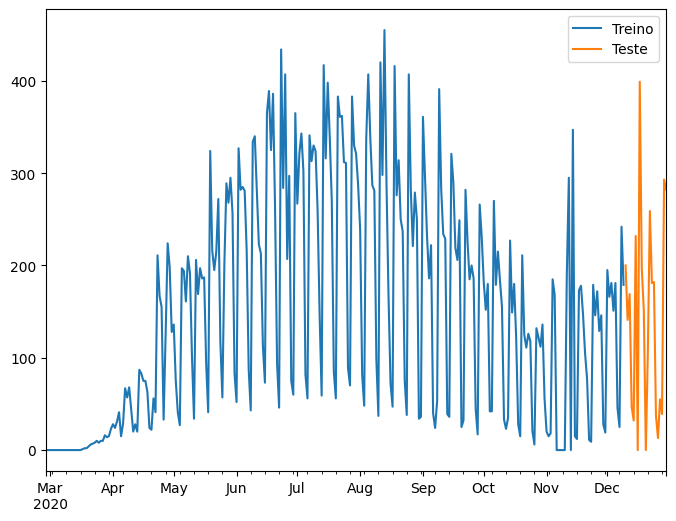

In [108]:
dados_treino['deaths'].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6));


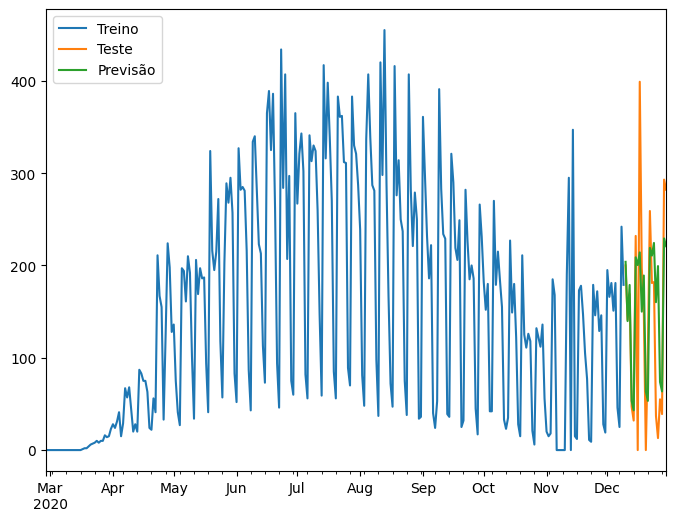

In [109]:
dados_treino['deaths'].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6))
predito.plot(legend=True,label='Previsão');

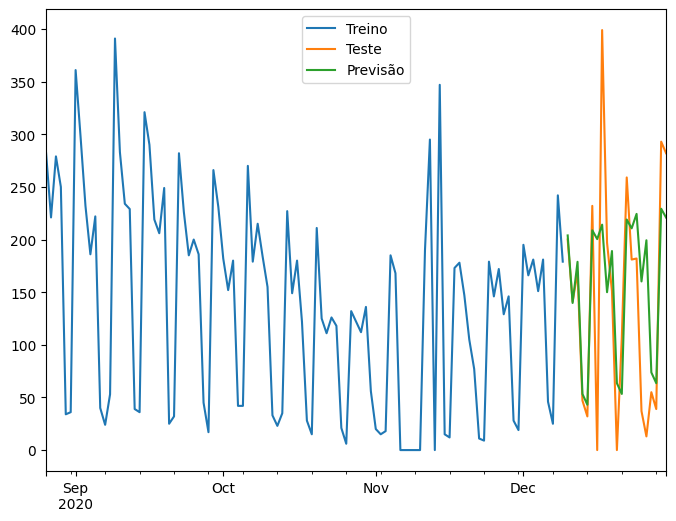

In [110]:
dados_treino['deaths'].iloc[180:].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6))
predito.plot(legend=True,label='Previsão');

In [111]:
## Ajuste do modelo com sazonalidade multiplicativa
from statsmodels.tsa.holtwinters import ExponentialSmoothing

# Precisamos considerar somente os dados positivos, mas vamos considerar os dados entre o início de maio e o início de setembro

In [112]:
covidSP = covidSP.loc['2020-05-01':'2020-09-01']

In [113]:
len(covidSP)

124

In [114]:
dados_treino = covidSP.iloc[:103] # Dados de treinamento até observação 240, sem incluí-la
dados_teste = covidSP.iloc[103:] # Dados de teste a partir da observação 240

In [115]:
ajustado = ExponentialSmoothing(dados_treino['deaths'],trend='add',seasonal='mul',seasonal_periods=7).fit()

In [116]:
predito = ajustado.forecast(21).rename('Previsão Holt-Winters')
predito.index = covidSP.index[103:]


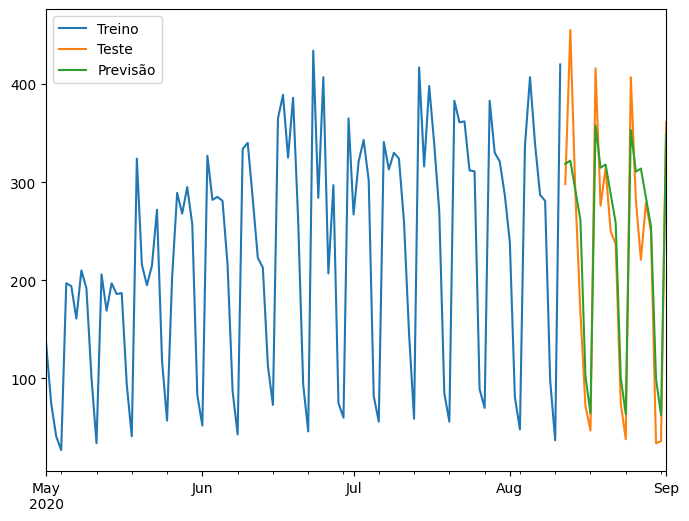

In [117]:
dados_treino['deaths'].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6))
predito.plot(legend=True,label='Previsão');

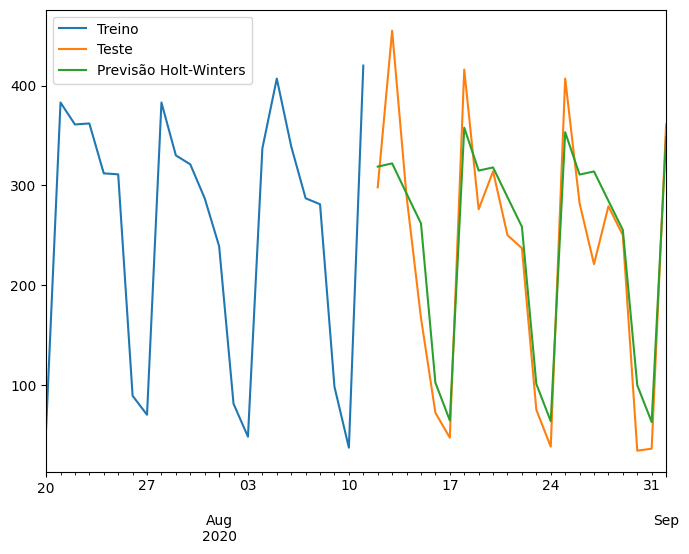

In [118]:
dados_treino['deaths'].iloc[80:].plot(legend=True,label='Treino')
dados_teste['deaths'].plot(legend=True,label='Teste',figsize=(8,6))
predito.plot(legend=True,label='Previsão Holt-Winters');

<a id="section4"></a>
Aula 2: Séries estacionárias

# Séries estacionárias

Baseado em

- MORETTIN, P. A.; TOLOI, C. M. C.. Análise de séries temporais: modelos lineares univariados. 3. ed. São Paulo: Blucher, 2018.

- EHLERS, R.S. Análise de Séries Temporais. ICMC USP. 2009.


Leituras adicionais recomendadas

- Boxplots https://pt.wikipedia.org/wiki/Diagrama_de_caixa

- Boxplots usando o pacote seaborn https://seaborn.pydata.org/generated/seaborn.boxplot.html

- Teste para raiz unitária
https://en.wikipedia.org/wiki/Unit_root_test

- Teste de Dickey-Fuller aumentado https://en.wikipedia.org/wiki/Augmented_Dickey-Fuller_test.


## Estacionariedade

Como as séries temporais são realizações de processos estocásticos, estudaremos um pouco as características de processos estocásticos estacionários.


**Definição**

Um processo estocástico é dito ser **estritamente estacionário** se a distribuição de probabilidade conjunta de $Z (t_1 ), \ldots , Z (t_k )$ é a mesma de $Z (t_1+\tau), \ldots , Z (t_k +\tau)$.

Ou seja, o deslocamento da origem dos tempos por uma quantidade $\tau$ não tem efeito na distribuição conjunta que portanto depende apenas dos intervalos entre $t_1,\ldots,t_k$.




Para $k=1$, a estacionariedade estrita implica que a distribuição de $Z_t$ é a mesma para todo $t$ de modo que, se os primeiros momentos forem finitos,

$$\mu(t) = \mu \mbox{ e } \sigma^2(t) = \sigma^2\ \  \forall t$$


Para $k=2$, a distribuição conjunta de $Z(t_1)$ e $Z(t_2)$ depende apenas da distância $t_2-t_1$.

A **função de autocovariância** também depende apenas de $t_2-t_1$ e pode ser escrita como $\gamma(\tau)$:

$$\gamma(\tau) = E [(Z (t) − \mu)(Z (t + \tau ) − \mu)] = Cov(Z (t), Z (t + \tau )).$$

$\gamma(\tau)$ é chamado de coeficiente de autocovariância na defasagem $\tau$.

Note que o tamanho de $\gamma(\tau)$ depende da escala de $Z(t)$. Uma quantidade livre de escala é a **função de autocorrelação**

$$\rho(\tau) = \displaystyle\frac{\gamma(\tau)}{\gamma(0)}.$$


Na prática é muito difı́cil usar a definição de estacionariedade estrita e costuma-se definir estacionariedade de uma forma menos restrita.



**Definição**

Um processo estocástico $\{ Z (t), t \in \mathcal{T} \}$ é dito ser **estacionário de segunda ordem ou fracamente estacionário** se a sua função média é constante e sua função de autocovariância depende apenas da
defasagem,

$E(Z(t))  = \mu,\  \forall t$ e

$ Cov [Z (t), Z (t + \tau )] =  E [Z (t) − \mu][Z (t + \tau ) − \mu] = \gamma(\tau) \ \forall t $



- Nenhuma outra suposição é feita a respeito dos momentos de ordem mais alta.

- Fazendo $\tau = 0$ segue que $Var [Z (t)] = \gamma(0), \forall t$.

- Tanto a média quanto a variância precisam ser finitos.



**Definição**

Um processo estocástico é dito ser um processo **Gaussiano** se, para qualquer conjunto $\{ t_1 , t_ 2 , \ldots , t_n\}$ as variáveis aleatórias $Z (t_1 ), Z (t_2 ), \ldots , Z (t_n )$ tem distribuição normal multivariada.

- A distribuição normal multivariada fica completamente caracterizada pelo primeiro e segundo momentos, ou seja, média,variâncias e covariâncias.


- **Estacionariedade fraca implica em estacionariedade estrita para processos Gaussianos.**


- Por outro lado, $\mu$ e $\gamma(t)$ podem não descrever adequadamente processos que se afastem muito da normalidade.


Já vimos na primeira aula um **passeio aleatório**


$$Z_t = Z_{t-1}+\epsilon_t.$$


A série temporal se desenvolve no tempo de forma aleatória ao redor de uma média constante?

A maior parte das séries temporais não! Em geral, as séries de tempo apresentam *tendências*, positivas ou negativas, que podem ser lineares ou não lineares.



## Séries estacionárias

- Uma série temporal é estacionária se a sua média, variância e autocovariância são fixas para quaisquer dois pontos equidistantes. Isso significa que, independente de onde tomarmos um subconjunto da série, a **média, variância, autocorrelação devem se manter constantes**.


- Uma série que apresenta sazonalidade ou tendência não é estacionária.





## Transformações para buscar estacionariedade

#### Diferenças da série original

Como a maioria dos procedimentos da análise estatística das séries temporais supõe estacionariedade, pode ser necessário transformar os dados originais para obter uma série estacionária.

A transformação (filtro) mais comum consiste em tomar _diferenças sucessivas_ da série original, até obter uma série estacionária.

* Primeira diferença

$$\Delta Z(t) = Z(t) - Z(t-1)$$

* Segunda diferença

$$\Delta^2 Z(t) = \Delta(\Delta(Z(t))) = \Delta(Z(t) - Z(t-1)) $$

$$\Delta^2 Z(t)  = Z(t) - 2 Z(t-1) + Z(t-2)$$



### Exemplos:

1. Considere os dados dos passageiros. A série é estacionária? A primeira diferença é estacionária?

2. Considere a série de mortes da COVID-19 em SP. Ela é estacionária? A primeira diferença é estacionária?

Veremos outros exemplos!

In [175]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller

passageiros = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv', index_col=0, parse_dates=True)

# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")


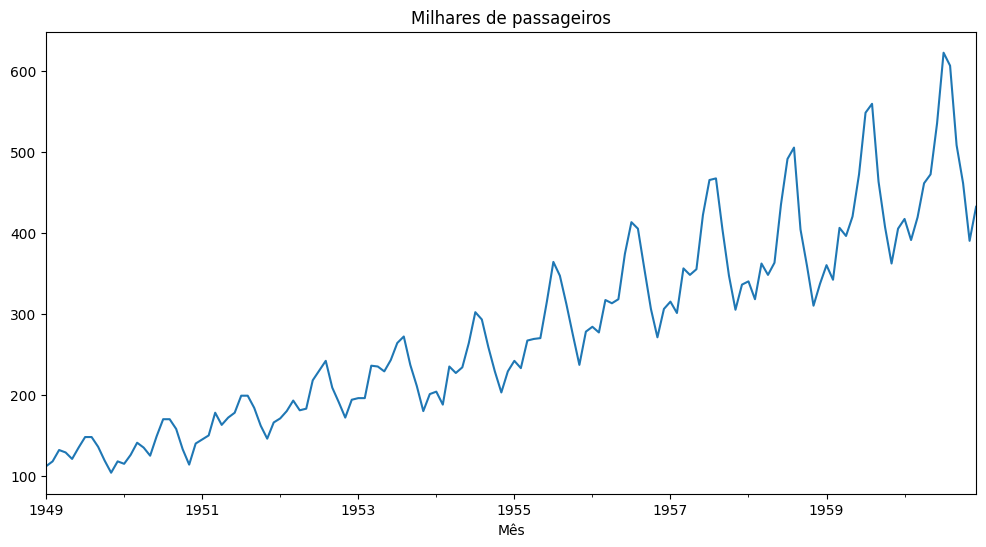

In [176]:
passageiros['Milhares de passageiros'].plot(figsize=(12,6), title='Milhares de passageiros');

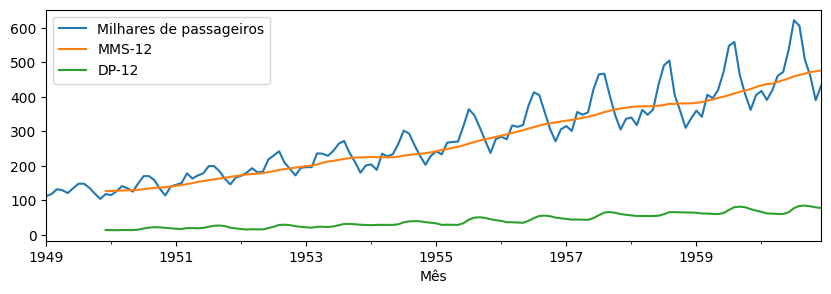

In [177]:
# Verificando as séries de média e desvio-padrão móvel com janela de 12 meses

passageiros['MMS-12'] = passageiros['Milhares de passageiros'].rolling(window=12).mean()
passageiros['DP-12'] = passageiros['Milhares de passageiros'].rolling(window=12).std()

passageiros[['Milhares de passageiros','MMS-12','DP-12']].plot();

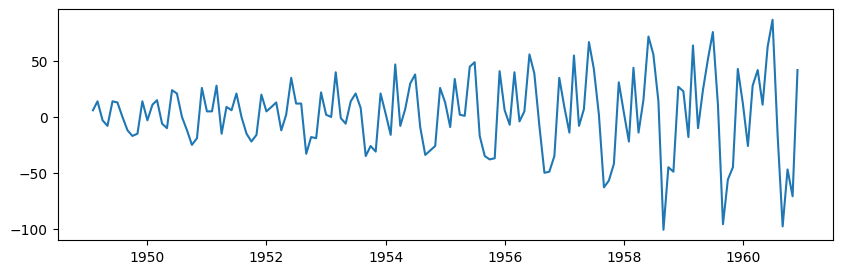

In [178]:
# Primeiras diferenças
y = np.diff(passageiros['Milhares de passageiros'])
x = passageiros.iloc[1:].index

plt.plot(x,y);

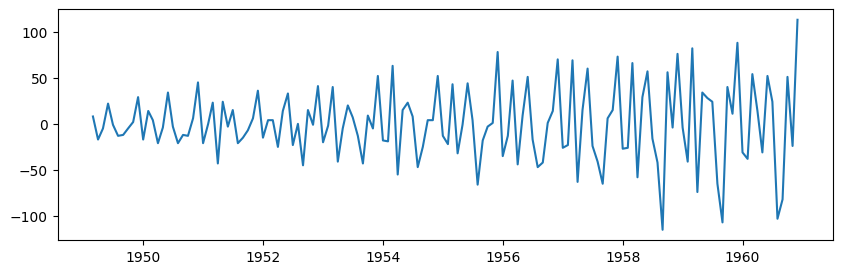

In [179]:
# Segundas diferenças
y2 = np.diff(y)
x2 = x[1:]

plt.plot(x2,y2);

## Boxplots por períodos

Veja mais em

https://pt.wikipedia.org/wiki/Diagrama_de_caixa

https://seaborn.pydata.org/generated/seaborn.boxplot.html

<Axes: xlabel='Ano', ylabel='Milhares de passageiros'>

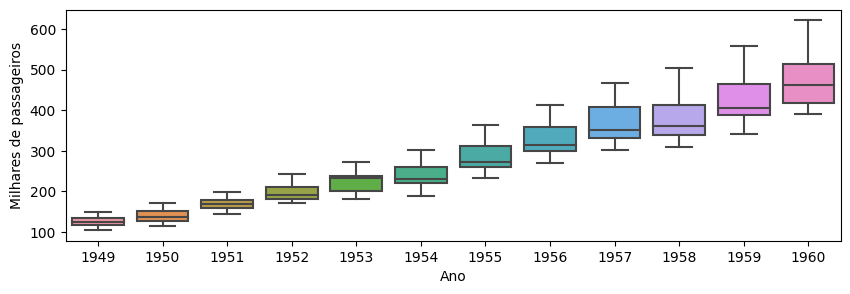

In [180]:
import seaborn as sns

passageiros['Ano'] = passageiros.index.year


sns.boxplot(x=passageiros['Ano'], y=passageiros['Milhares de passageiros'])

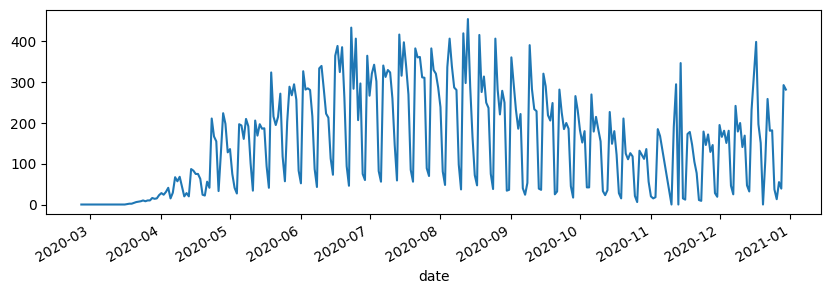

In [181]:
# Mortes por COVID-19 no estado de SP

covidSP = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv', index_col=0, parse_dates=True)

covidSP['deaths'].plot();


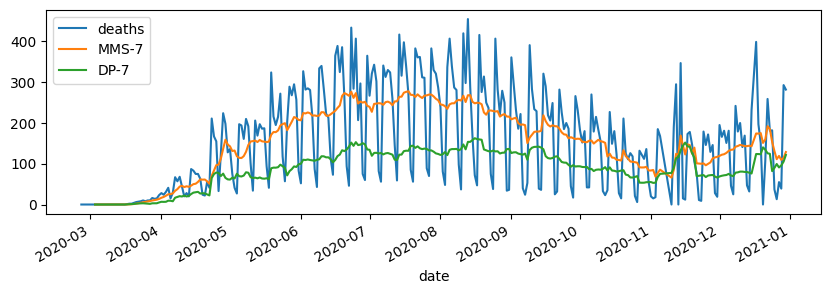

In [182]:
# Verificando as séries de média e desvio-padrão móvel com janela de 7 dias

covidSP['MMS-7'] = covidSP['deaths'].rolling(window=7).mean()
covidSP['DP-7'] = covidSP['deaths'].rolling(window=7).std()

covidSP[['deaths','MMS-7','DP-7']].plot();

<Axes: xlabel='Week', ylabel='deaths'>

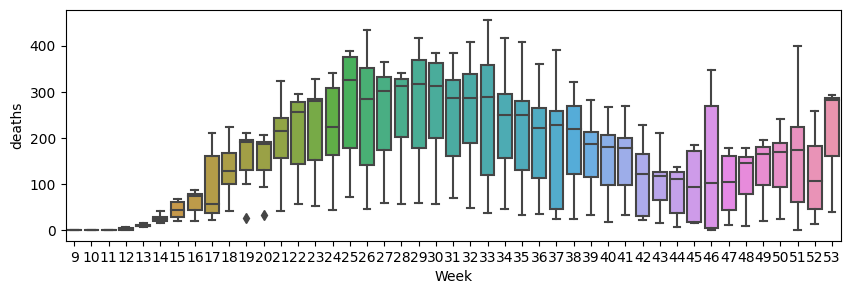

In [183]:
import seaborn as sns

covidSP['Week'] = covidSP.index.week

sns.boxplot(x=covidSP['Week'], y=covidSP['deaths'])

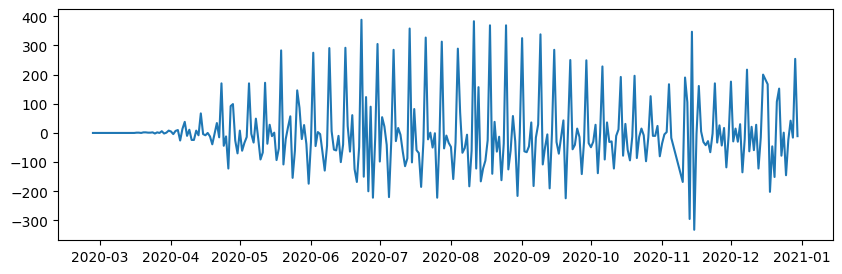

In [184]:
# Primeiras diferenças
y = np.diff(covidSP['deaths'])
x = covidSP.index[1:]


plt.rcParams['figure.figsize'] = [10,3]
plt.plot(x,y)


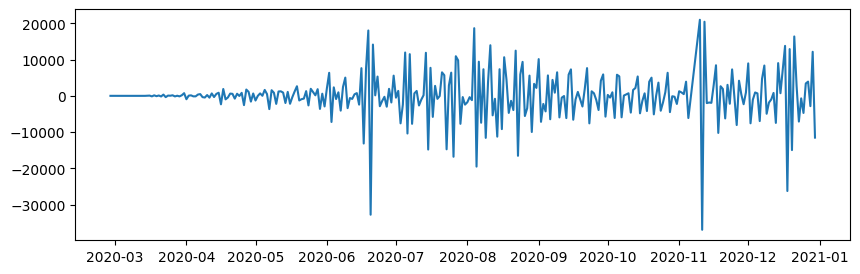

In [185]:
# Segundas diferenças

y = np.diff(np.diff(covidSP['confirmed']))
x = covidSP.iloc[2:].index


plt.rcParams['figure.figsize'] = [10,3]
plt.plot(x,y);





<Axes: xlabel='Date'>

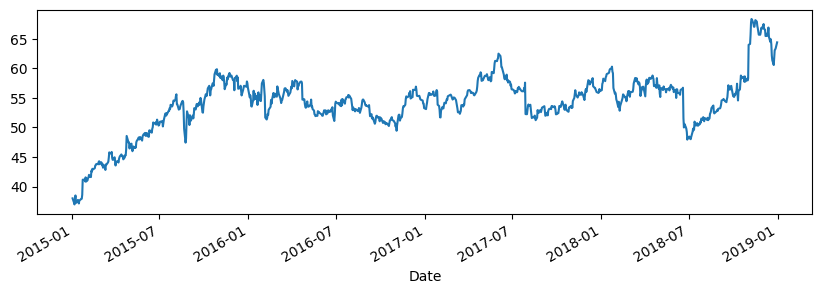

In [186]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller

starbucks = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/starbucks.csv', index_col=0, parse_dates=True)

starbucks['Close'].plot()

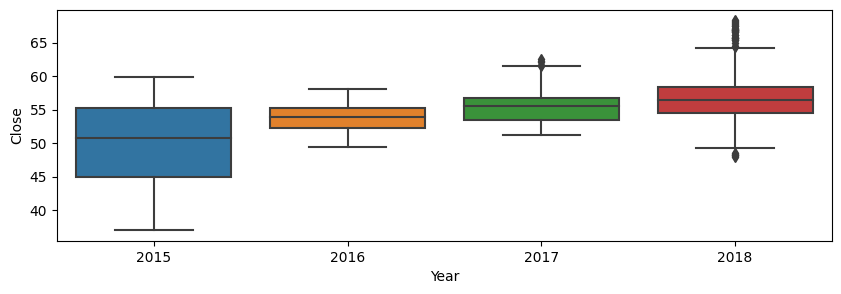

In [187]:
import seaborn as sns

starbucks['Year']= starbucks.index.year

x = sns.boxplot(x=starbucks['Year'], y=starbucks['Close'])

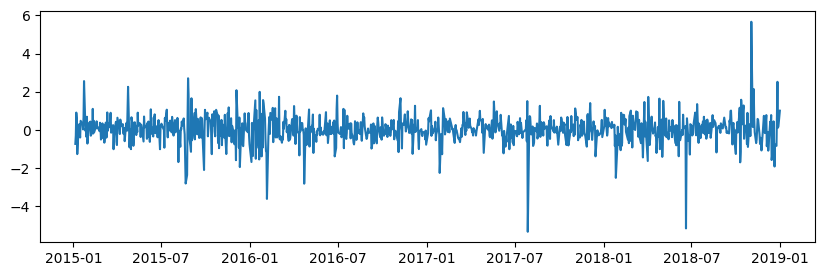

In [188]:
# Primeiras diferenças
y = np.diff(starbucks['Close'])
x = starbucks.iloc[1:].index

plt.plot(x,y);

**O Teste de Dickey-Fuller é usado para testar estacionariedade em um contexto de modelos autorregressivos.**

## Um teste para "alguma evidência sobre estacionariedade"


Considere inicialmente um modelo AR(1), que veremos com mais detalhes nas próximas aulas.

$$Z_t = \phi Z_{t-1} + a_t$$

em que $a_t \sim RBN(0,\sigma^2)$.

Segue-se que

$$\Delta Z_t = \phi^{\star} Z_{t-1} + a_t$$

no qual $ \phi^{\star}  = \phi-1$.

Queremos avaliar as hipóteses

$H_0: \phi^{\star} = 0$ contra

$H_1: \phi^{\star} < 0 $.

Para isso, diversos desenvolvimentos são necessários para se obter a estatística de teste, mas não daremos detalhes aqui!




Existem outros tipos de testes de hipóteses como esse, e muitos deles testam se:


$H_0: \mbox{ a série é não estacionária e contém uma raiz unitária}$

$H_1: \mbox{ a série é estacionária ou tendência-estacionária }$


Para mais informações, veja  (https://en.wikipedia.org/wiki/Unit_root_test)

O teste Dickey-Fuller aumentado também tem essa proposta  (https://en.wikipedia.org/wiki/Augmented_Dickey-Fuller_test).

Para o Teste de Dickey-Fuller:

- Quando o valor-p é pequeno ($p < 0.05$, por exemplo), rejeitamos $H_0$ e portanto há evidências de que a série é estacionária ou tendência-estacionária.

- Se o valor-p for grande ($p \geq 0.05$, por exemplo), não rejeitamos $H_0$ e a série não é estacionária e contém uma raiz unitária.


**Neste momento, vamos apenas aplicar o teste de Dickey-Fuller e verificar se há ou não evidências contra a estacionariedade da série**.


In [189]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pandas import read_csv
from statsmodels.tsa.stattools import adfuller

passageiros = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv', index_col=0, parse_dates=True)


In [190]:
# fonte: https://machinelearningmastery.com/time-series-data-stationary-python/

result = adfuller(passageiros['Milhares de passageiros'], autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))


ADF Statistic: 0.815369
p-value: 0.991880
Critical Values:
	1%: -3.482
	5%: -2.884
	10%: -2.579


Há evidências de que a série não seja estacionária!

In [191]:
result = adfuller(np.diff(passageiros['Milhares de passageiros']), autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -2.829267
p-value: 0.054213
Critical Values:
	1%: -3.482
	5%: -2.884
	10%: -2.579


Há evidências fracas de que a série das primeiras diferenças não seja estacionária!

In [192]:
result = adfuller(np.diff(np.diff(passageiros['Milhares de passageiros'])), autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -16.384232
p-value: 0.000000
Critical Values:
	1%: -3.482
	5%: -2.884
	10%: -2.579


Há evidências de que a série das segundas diferenças seja estacionária ou tendência-estacionária!

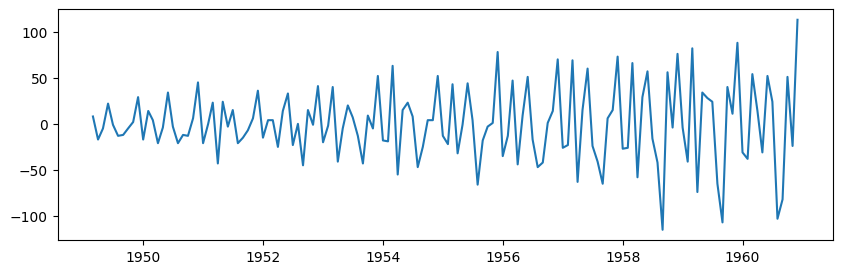

In [193]:
y = np.diff(np.diff(passageiros['Milhares de passageiros']))
x = passageiros.index[1:][1:]


plt.rcParams['figure.figsize'] = [10,3]
plt.plot(x,y)

In [194]:
result = adfuller(covidSP['deaths'], autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -2.017376
p-value: 0.279007
Critical Values:
	1%: -3.453
	5%: -2.872
	10%: -2.572


Há evidências de que a série não seja estacionária!

In [195]:
result = adfuller(np.diff(covidSP['deaths']), autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -8.026969
p-value: 0.000000
Critical Values:
	1%: -3.453
	5%: -2.872
	10%: -2.572


Há evidências de que a série das primeiras diferenças seja estacionária ou tendência-estacionária!

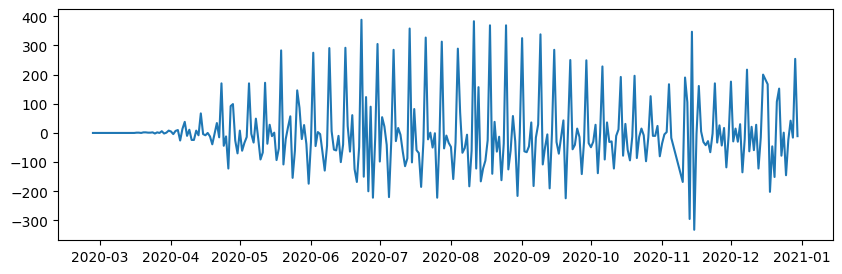

In [196]:
y = np.diff(covidSP['deaths'])
x = covidSP.index[1:]


plt.rcParams['figure.figsize'] = [10,3]
plt.plot(x,y)

<Axes: xlabel='date'>

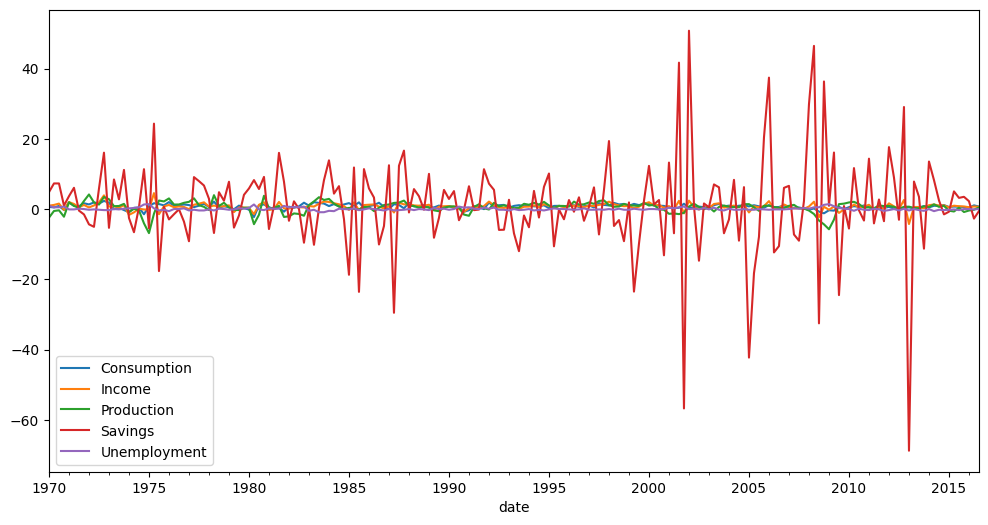

In [197]:
# dados US change

uschange = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/uschange.csv',index_col=0,parse_dates=True)
uschange.index = uschange.index.to_period("Q")
uschange.plot(figsize=(12,6))

In [198]:

result = adfuller(uschange['Savings'], autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -18.705760
p-value: 0.000000
Critical Values:
	1%: -3.466
	5%: -2.877
	10%: -2.575


Há fortes evidências para concluir que a série seja estacionária ou tendência-estacionária!

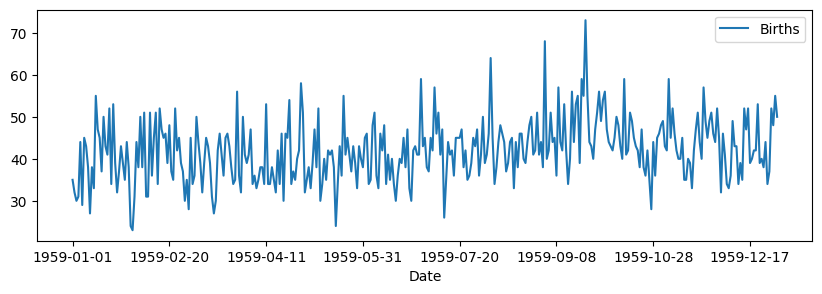

In [199]:
# Dados daily-total-female-births, cujo objetivo seria prever nascimentos diários de meninas


from pandas import read_csv
from matplotlib import pyplot


plt.rcParams['figure.figsize'] = [10,3]
births = read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/daily-total-female-births.csv', header=0, index_col=0)

births.plot();

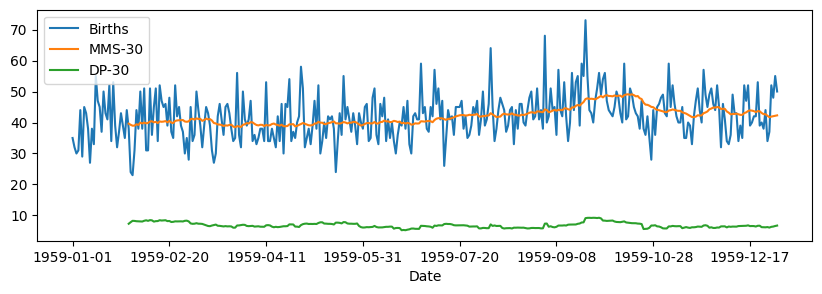

In [200]:
births['MMS-30'] = births['Births'].rolling(window=30).mean()
births['DP-30'] = births['Births'].rolling(window=30).std()


plt.rcParams['figure.figsize'] = [10,3]
births[['Births','MMS-30','DP-30']].plot();

In [201]:

result = adfuller(births['Births'], autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -4.808291
p-value: 0.000052
Critical Values:
	1%: -3.449
	5%: -2.870
	10%: -2.571


Há evidências de que a série seja estacionária ou tendência-estacionária!

**Exercício: Faça o teste para avaliar a estacionariedade dos dados do Starbucks. Existem evidências de que a série das primeiras diferenças é estacionária?**

In [202]:
plt.rcParams['figure.figsize'] = [10,3]

url = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/starbucks.csv'

starbucks = pd.read_csv(url, index_col=0, parse_dates=True)
starbucks

,Close,Volume
Date,,
2015-01-02,38.0061,6906098
2015-01-05,37.2781,11623796
2015-01-06,36.9748,7664340
2015-01-07,37.8848,9732554
2015-01-08,38.4961,13170548
...,...,...
2018-12-24,60.5600,6323252
2018-12-26,63.0800,16646238
2018-12-27,63.2000,11308081


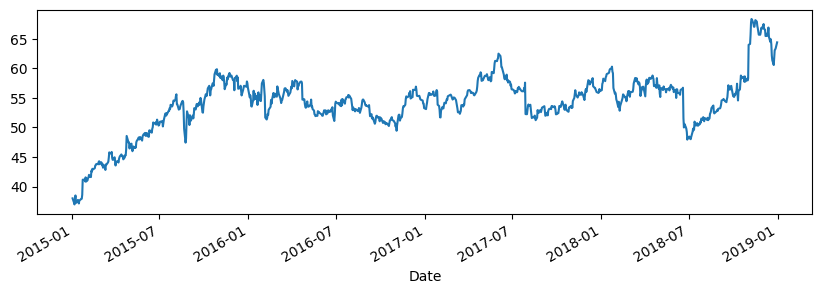

In [203]:

starbucks['Close'].plot();

In [204]:
result = adfuller(starbucks['Close'], autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -3.048094
p-value: 0.030641
Critical Values:
	1%: -3.437
	5%: -2.864
	10%: -2.568


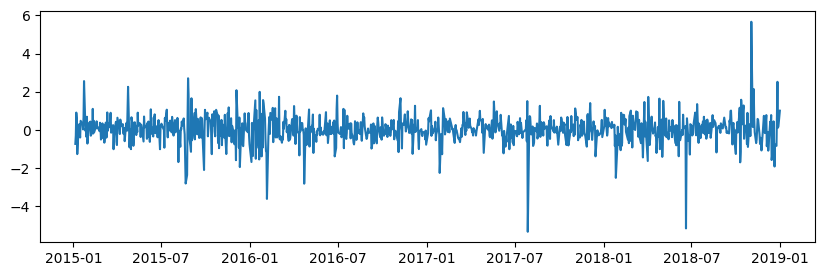

In [205]:
# Primeiras diferenças
y = np.diff(starbucks['Close'])
x = starbucks.iloc[1:].index

plt.plot(x,y);

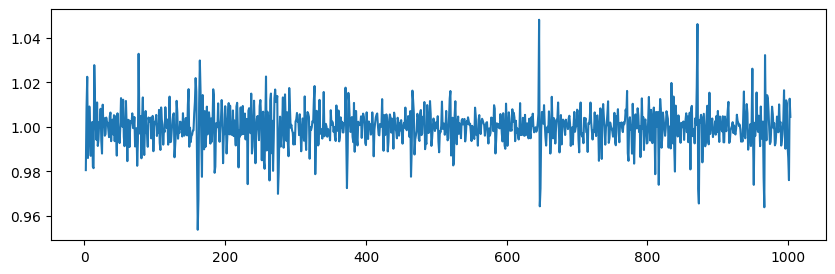

In [206]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

starbucks = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/starbucks.csv', index_col=0, parse_dates=True)

y = np.array(starbucks['Close'])

decomp = seasonal_decompose(y, model='multiplicative', period=5)
plt.plot(decomp.resid);



In [207]:
x = decomp.resid
x = x[~np.isnan(x)]
x
result = adfuller(x, autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -11.920651
p-value: 0.000000
Critical Values:
	1%: -3.437
	5%: -2.864
	10%: -2.568


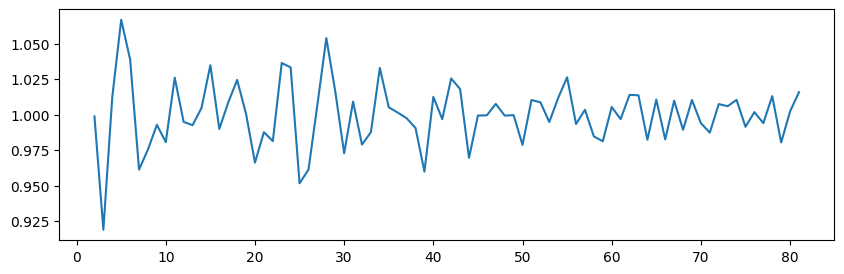

In [208]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

url = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/PETR4.csv'
PETR4 = pd.read_csv(url, header=0, index_col=0)

y = np.array(PETR4['Close'])

decomp = seasonal_decompose(y, model='multiplicative', period=5)
plt.plot(decomp.resid);

In [209]:
x = decomp.resid
x = x[~np.isnan(x)]
x
result = adfuller(x, autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -7.914345
p-value: 0.000000
Critical Values:
	1%: -3.519
	5%: -2.900
	10%: -2.587


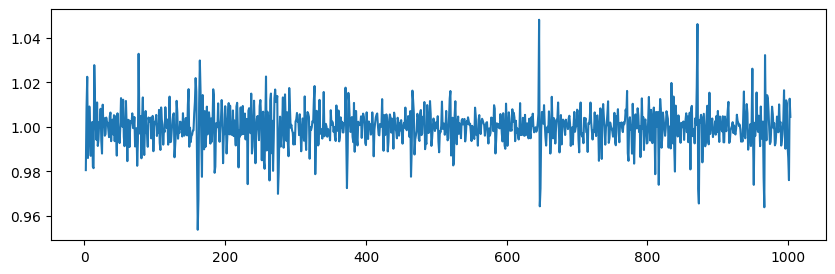

In [210]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

url='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/starbucks.csv'
starbucks = pd.read_csv(url, index_col=0, parse_dates=True)

y = np.array(starbucks['Close'])

decomp = seasonal_decompose(y, model='multiplicative', period=5)
plt.plot(decomp.resid);

<a id="section5"></a>
Aula 2: Exercícios

# Prática 2

***Aprendizado Dinâmico***

por **Cibele Russo** (ICMC/USP - São Carlos SP)

**MBA em Ciências de Dados**

Considere os dados de fechamento do papel VALE3 a partir de 21/07/2020 no arquivo VALE3.csv.
(fonte dos dados https://br.financas.yahoo.com/quote/VALE3.SA/history?p=VALE3.SA em Acesso em 20/07/2021)


Nesta prática, aplicaremos os conhecimentos adquiridos na Aula 2 a esses dados, a saber:

- Método de Holt

- Método de Holt-Winters

- Previsão

- Estacionariedade


Carregue as bibliotecas

In [1]:
# Bibliotecas

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline

# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")


**1. Faça a leitura dos dados a partir do arquivo VALE3.csv disponível no material do curso. Para essa análise, utilizaremos a variável que indica os fechamentos, Close. Quantas observações tem a série original? Visualize a série Close.**

In [2]:
# VALE3 - Leitura dos dados
url='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/VALE3.csv'
VALE3 = pd.read_csv(url, index_col='Date', parse_dates=True)

VALE3.head()


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2020-07-21,60.439999,60.480000,59.270000,59.700001,53.772350,29043600.0
2020-07-22,59.930000,60.250000,58.799999,59.240002,53.358028,19644700.0
2020-07-23,59.900002,60.160000,58.639999,58.849998,53.006744,17291900.0
2020-07-24,58.570000,58.849998,57.820000,58.599998,52.781574,22544100.0
2020-07-27,59.099998,61.630001,58.980000,61.369999,55.276535,35124800.0


In [3]:
len(VALE3)

246

<Axes: xlabel='Date'>

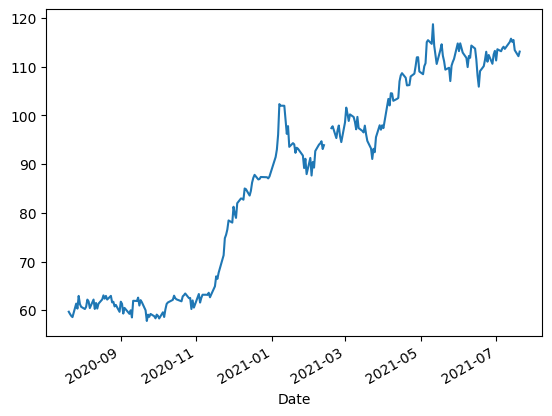

In [4]:
VALE3['Close'].plot()

**2. Quais as datas mínima e máxima de observação da série Close? Repita o procedimento feito em aula para preencher os dados faltantes com a função VALE3.fillna(method='ffill', inplace=True). Nesse caso, a frequência usada em pd.date_range deve ser 'B' pois a bolsa de valores não funciona aos fins de semana. O que faz o método ffill de fillna?**

In [5]:
VALE3.index.min()

Timestamp('2020-07-21 00:00:00')

In [6]:
VALE3.index.max()

Timestamp('2021-07-20 00:00:00')

In [7]:
idx = pd.date_range(start=VALE3.index.min(), end=VALE3.index.max(), freq='B')
idx

DatetimeIndex(['2020-07-21', '2020-07-22', '2020-07-23', '2020-07-24',
               '2020-07-27', '2020-07-28', '2020-07-29', '2020-07-30',
               '2020-07-31', '2020-08-03',
               ...
               '2021-07-07', '2021-07-08', '2021-07-09', '2021-07-12',
               '2021-07-13', '2021-07-14', '2021-07-15', '2021-07-16',
               '2021-07-19', '2021-07-20'],
              dtype='datetime64[ns]', length=261, freq='B')

In [8]:
VALE3 = VALE3.reindex(idx)
VALE3.head()

,Open,High,Low,Close,Adj Close,Volume
2020-07-21,60.439999,60.480000,59.270000,59.700001,53.772350,29043600.0
2020-07-22,59.930000,60.250000,58.799999,59.240002,53.358028,19644700.0
2020-07-23,59.900002,60.160000,58.639999,58.849998,53.006744,17291900.0
2020-07-24,58.570000,58.849998,57.820000,58.599998,52.781574,22544100.0
2020-07-27,59.099998,61.630001,58.980000,61.369999,55.276535,35124800.0


In [9]:
VALE3.fillna(method='ffill', inplace=True)

**3. Qual o novo número de observações da série Close após o procedimento em 2.?**

In [10]:
len(VALE3)

261

**4. Vamos aplicar os métodos de Holt e Holt-Winters para esses dados. Faça a leitura das bibliotecas necessárias e crie a série Holt na base de dados. Atribua a ela os valores ajustados pelo Método de Holt. Lembre-se que a série fica deslocada e corrija com a função shift(-1).**

In [11]:
# Método de Holt

from statsmodels.tsa.holtwinters import ExponentialSmoothing

modelo =  ExponentialSmoothing(VALE3['Close'], trend='add');

ajustadoH = modelo.fit();

VALE3['Holt'] = ajustadoH.fittedvalues.shift(-1);

VALE3.head()


,Open,High,Low,Close,Adj Close,Volume,Holt
2020-07-21,60.439999,60.480000,59.270000,59.700001,53.772350,29043600.0,59.896910
2020-07-22,59.930000,60.250000,58.799999,59.240002,53.358028,19644700.0,59.516445
2020-07-23,59.900002,60.160000,58.639999,58.849998,53.006744,17291900.0,59.127472
2020-07-24,58.570000,58.849998,57.820000,58.599998,52.781574,22544100.0,58.862455
2020-07-27,59.099998,61.630001,58.980000,61.369999,55.276535,35124800.0,61.304498


**5. Visualize as séries Close e Holt. O método apresenta um bom ajuste?**

<Axes: >

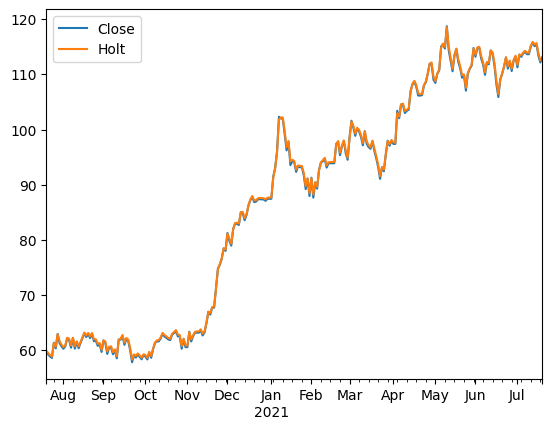

In [12]:
VALE3[['Close','Holt']].plot()

**6. Faz sentido ajustar o método de Holt-Winters? Qual seria o período da sazonalidade? 5 dias pode fazer sentido? Aplique os métodos de Holt-Winters com sazonalidade aditiva e multiplicativa e visualize os resultados.**

In [13]:
# Ajuste do modelo pelo Método de Holt-Winters com sazonalidade aditiva

modelo =  ExponentialSmoothing(VALE3['Close'],trend='add',seasonal='add',seasonal_periods=5);

ajustadoHW = modelo.fit();

VALE3['Holt-Winters-adit-5'] = ajustadoHW.fittedvalues;

VALE3.head()

,Open,High,Low,Close,Adj Close,Volume,Holt,Holt-Winters-adit-5
2020-07-21,60.439999,60.480000,59.270000,59.700001,53.772350,29043600.0,59.896910,59.616470
2020-07-22,59.930000,60.250000,58.799999,59.240002,53.358028,19644700.0,59.516445,59.977256
2020-07-23,59.900002,60.160000,58.639999,58.849998,53.006744,17291900.0,59.127472,59.401942
2020-07-24,58.570000,58.849998,57.820000,58.599998,52.781574,22544100.0,58.862455,59.001572
2020-07-27,59.099998,61.630001,58.980000,61.369999,55.276535,35124800.0,61.304498,59.119887


<Axes: >

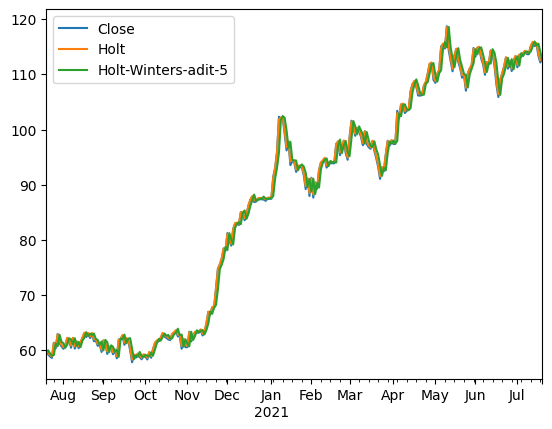

In [14]:
VALE3[['Close','Holt','Holt-Winters-adit-5']].plot()

In [15]:
# Ajuste do modelo pelo Método de Holt-Winters com sazonalidade aditiva

modelo =  ExponentialSmoothing(VALE3['Close'],trend='add',seasonal='mul',seasonal_periods=5);

ajustadoHW = modelo.fit();

VALE3['Holt-Winters-mul-5'] = ajustadoHW.fittedvalues;

VALE3.head()

,Open,High,Low,Close,Adj Close,Volume,Holt,Holt-Winters-adit-5,Holt-Winters-mul-5
2020-07-21,60.439999,60.480000,59.270000,59.700001,53.772350,29043600.0,59.896910,59.616470,59.618774
2020-07-22,59.930000,60.250000,58.799999,59.240002,53.358028,19644700.0,59.516445,59.977256,59.947552
2020-07-23,59.900002,60.160000,58.639999,58.849998,53.006744,17291900.0,59.127472,59.401942,59.454873
2020-07-24,58.570000,58.849998,57.820000,58.599998,52.781574,22544100.0,58.862455,59.001572,59.028070
2020-07-27,59.099998,61.630001,58.980000,61.369999,55.276535,35124800.0,61.304498,59.119887,59.028464


<Axes: >

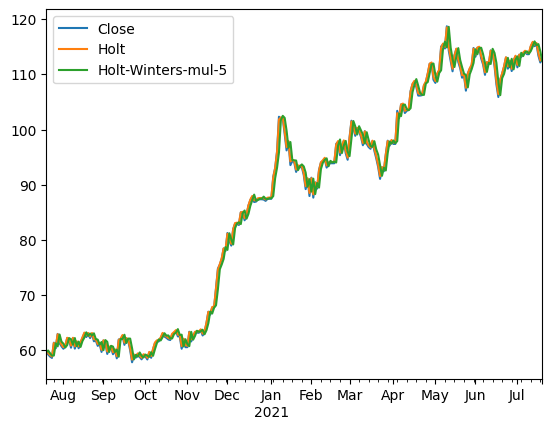

In [16]:
VALE3[['Close','Holt','Holt-Winters-mul-5']].plot()

**7. Olhe as previsões para as últimas 40 observações**

<Axes: >

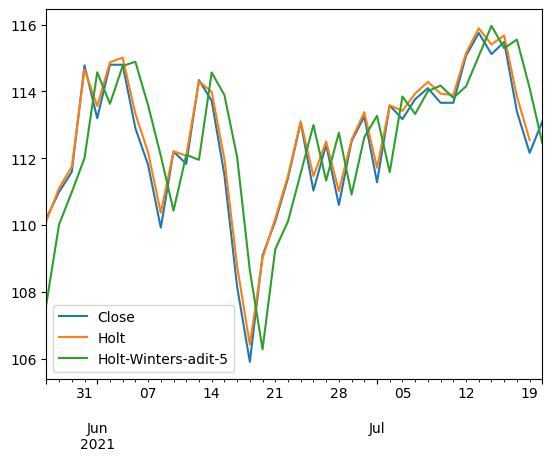

In [17]:
VALE3[['Close','Holt','Holt-Winters-adit-5']][-40:].plot()

**8. Como ficam as previsões? Use 240 observações para treino e 21 para teste.**

In [18]:
len(VALE3)-21

240

In [19]:
dados_treino = VALE3.iloc[:240] # Dados de treinamento até observação 210, sem incluí-la
dados_teste = VALE3.iloc[240:] # Dados de teste a partir da observação 210

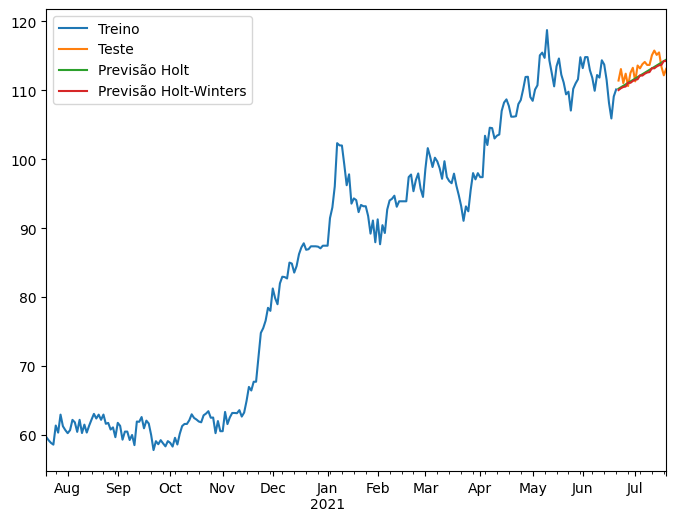

In [20]:
ajustado_H = ExponentialSmoothing(dados_treino['Close'],trend='add').fit()
ajustado_HW = ExponentialSmoothing(dados_treino['Close'],trend='add',seasonal='add',seasonal_periods=5).fit()

predito_H = ajustado_H.forecast(21).rename('Previsão Holt')
predito_HW = ajustado_HW.forecast(21).rename('Previsão Holt')

predito_H.index = VALE3.index[240:]
predito_HW.index = VALE3.index[240:]

dados_treino['Close'].plot(legend=True,label='Treino')
dados_teste['Close'].plot(legend=True,label='Teste',figsize=(8,6))
predito_H.plot(legend=True,label='Previsão Holt');
predito_HW.plot(legend=True,label='Previsão Holt-Winters');



**9. É possível melhorar as previsões com o método de Holt-Winters com sazonalidade e/ou tendência multiplicativos?**

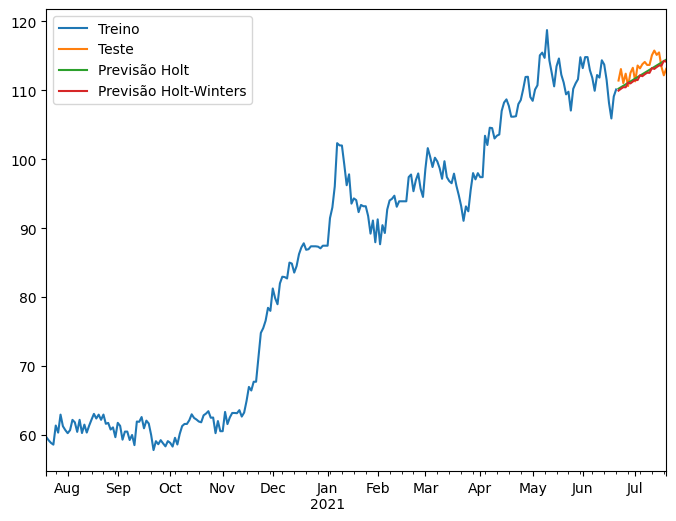

In [21]:
ajustado_H = ExponentialSmoothing(dados_treino['Close'],trend='add').fit()
ajustado_HW = ExponentialSmoothing(dados_treino['Close'],trend='add',seasonal='mul',seasonal_periods=5).fit()

predito_H = ajustado_H.forecast(21).rename('Previsão Holt')
predito_HW = ajustado_HW.forecast(21).rename('Previsão Holt')

predito_H.index = VALE3.index[240:]
predito_HW.index = VALE3.index[240:]

dados_treino['Close'].plot(legend=True,label='Treino')
dados_teste['Close'].plot(legend=True,label='Teste',figsize=(8,6))
predito_H.plot(legend=True,label='Previsão Holt');
predito_HW.plot(legend=True,label='Previsão Holt-Winters');




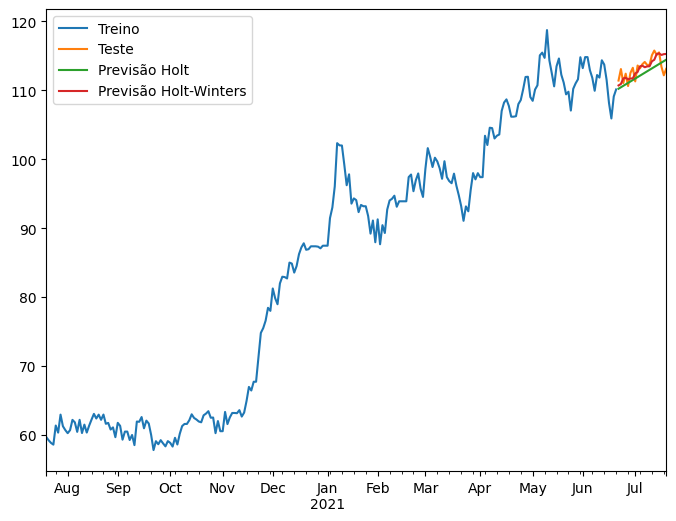

In [22]:

ajustado_H = ExponentialSmoothing(dados_treino['Close'],trend='add').fit()
ajustado_HW = ExponentialSmoothing(dados_treino['Close'],trend='mul',seasonal='mul',seasonal_periods=7).fit()

predito_H = ajustado_H.forecast(21).rename('Previsão Holt')
predito_HW = ajustado_HW.forecast(21).rename('Previsão Holt')

predito_H.index = VALE3.index[240:]
predito_HW.index = VALE3.index[240:]

dados_treino['Close'].plot(legend=True,label='Treino')
dados_teste['Close'].plot(legend=True,label='Teste',figsize=(8,6))
predito_H.plot(legend=True,label='Previsão Holt');
predito_HW.plot(legend=True,label='Previsão Holt-Winters');



**10. Utilize os métodos de Holt e Holt-Winters e compare os erros quadráticos médios e erros absolutos médios. (Depois você pode repetir para os dados de COVID-19).**

In [23]:
from sklearn.metrics import mean_squared_error,mean_absolute_error


In [24]:
mean_squared_error(dados_teste['Close'],predito_HW)

1.5516390917197864

In [25]:
mean_absolute_error(dados_teste['Close'], predito_HW)

0.983407178543852

In [26]:
mean_squared_error(dados_teste['Close'],predito_H)

2.2241845931083652

In [27]:
mean_absolute_error(dados_teste['Close'], predito_H)

1.358655783093491

**11. Crie séries da média móvel simples e desvio padrão móvel com janelas de 5 dias. A série parece estacionária?**

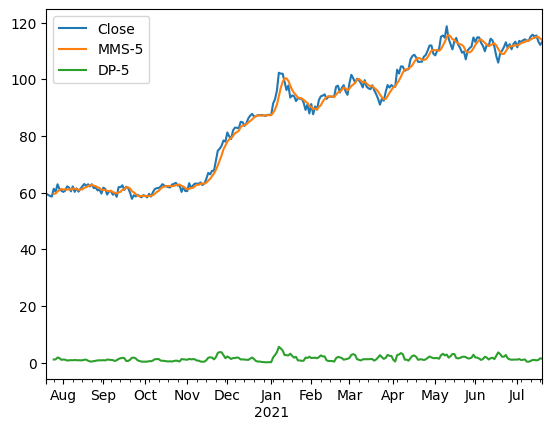

In [28]:
# Verificando as séries de média e desvio-padrão móvel com janela de 7 dias

VALE3['MMS-5'] = VALE3['Close'].rolling(window=5).mean()
VALE3['DP-5'] = VALE3['Close'].rolling(window=5).std()

VALE3[['Close','MMS-5','DP-5']].plot();

A série não parece estacionária.

**12. A série das primeiras diferenças parece estacionária?.**

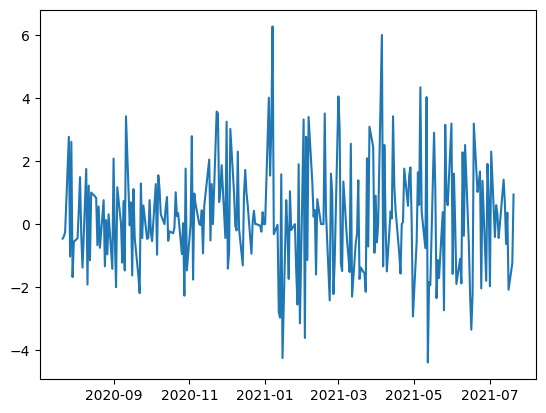

In [29]:
# Primeiras diferenças
y = np.diff(VALE3['Close'])
x = VALE3.iloc[1:].index

plt.plot(x,y);

**13. Considere boxplots semanais para a série original. Ela parece estacionária?**

<Axes: xlabel='Mês de observação', ylabel='Close'>

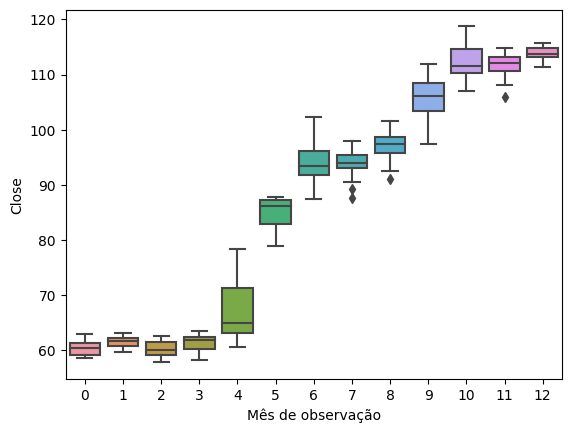

In [30]:
import seaborn as sns


VALE3['Mês de observação'] = (VALE3.index.month + (VALE3.index.year - VALE3.index.min().year)*12) - VALE3.index.min().month

sns.boxplot(x=VALE3['Mês de observação'], y=VALE3['Close'])

**14. Utilize o Teste de Dickey-Fuller aumentado. Que evidências ele dá sobre a estacionariedade da série e da primeira diferença?**

In [31]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(VALE3['Close'], autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -0.758537
p-value: 0.830999
Critical Values:
	1%: -3.457
	5%: -2.873
	10%: -2.573


In [32]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(np.diff(VALE3['Close']), autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))

ADF Statistic: -4.876273
p-value: 0.000039
Critical Values:
	1%: -3.457
	5%: -2.873
	10%: -2.573


<a id="section6"></a>
Aula 3: Autocovariância e autocorrelação

# Funções de Autocovariância e Autocorrelação

Baseado em

- MORETTIN, P. A.; TOLOI, C. M. C.. Análise de séries temporais: modelos lineares univariados. 3. ed. São Paulo: Blucher, 2018.

- EHLERS, R.S. Análise de Séries Temporais. ICMC USP. 2009.


Implementações:

- BROWNLEE, J. Introduction to time series forecasting with python: how to prepare data and develop models to predict the future. Machine Learning Mastery, 2017.

Leituras sugeridas:

- https://en.wikipedia.org/wiki/Autocorrelation

- https://otexts.com/fpp2/autocorrelation.html

- https://www.statsmodels.org/devel/generated/statsmodels.graphics.tsaplots.plot_pacf.html

- https://en.wikipedia.org/wiki/Partial_autocorrelation_function


Logo falaremos de modelos autorregressivos e de médias móveis, mas antes disso precisamos estudar covariância, correlação e como elas são usadas para descrever a associação entre observações de uma série temporal observada.

Nesta aula, falaremos de

- Função de autocovariância

- Função de autocorrelação

- Gráficos de autocorrelação e autocorrelação parcial



<span style="color:red">**Antes de falar de autocovariância e autocorrelação, o que é covariância e correlação?**</span>



Basicamente, a **covariância é uma medida de variabilidade conjunta entre duas variáveis aleatórias**.

Ela mede a força da associação linear entre essas duas variáveis.

E a **correlação é essa medida de associação linear padronizada**, de forma que assuma valores entre -1 e 1.

O sinal da covariância e da correlação indica se as variáveis se associam de forma positiva ou negativa.




## Covariância e correlação

A covariância entre duas variáveis aleatórias  $X$ e $Y$ é dada por

$\sigma^2_{XY}=Cov(X,Y) = E[(X-E(X))(Y-E(Y))]$.

Sejam $\sigma^2_X$ e  $\sigma^2_Y$ as variâncias de $X$ e $Y$, respectivamente.

A correlação entre  $X$ e $Y$ é dada por

$\rho = Cor(X,Y) = \displaystyle\frac{ E[(X-E(X))(Y-E(Y))]}{\sqrt{Var(X)}\sqrt{(Var(Y))}} = \displaystyle\frac{\sigma^2_{XY}}{\sqrt{\sigma^2_X} \sqrt{\sigma^2_Y}}$.

Obs: $-1\leq\rho\leq 1$ e quanto maior a correlação em módulo, mais forte é a associação, positiva ou negativa, entre as duas variáveis.



### Coeficiente de correlação de Pearson

O coeficiente de correlação de Pearson entre as variáveis aleatórias $X$ e $Y$, dada que amostras de $X$ e $Y$ foram observadas, é dado por

${\displaystyle r_{xy}={\frac {\sum _{i=1}^{n}(x_{i}-{\bar {x}})(y_{i}-{\bar {y}})}{{\sqrt {\sum _{i=1}^{n}(x_{i}-{\bar {x}})^{2}}}{\sqrt {\sum _{i=1}^{n}(y_{i}-{\bar {y}})^{2}}}}}}$


Em Python, podemos usar a função numpy.corrcoef(x,y)



<span style="color:red">**Correlação não significa causalidade!**</span>

<span style="color:red">**E então que é autocovariância e autocorrelação?**</span>

## Autocovariância

Seja $\{Z_t, t\in \mathbb{Z}\}$ um processo estacionário real com tempo discreto, de média zero.

A função de autocovariância facv para um deslocamento no tempo $\tau$ é dada por $\gamma_\tau = E(Z_t Z_{t+\tau})$.

Mais geralmente, a **função de autocovariância** é dada por:

$\gamma(\tau) = E[(Z(t)-\mu)(Z (t+\tau )-\mu)] = Cov(Z (t), Z (t + \tau )).$

$\gamma(\tau)$ é chamado de coeficiente de autocovariância na defasagem $\tau$.


## Autocorrelação

Uma quantidade livre de escala é a **função de autocorrelação**

$\rho(\tau) = \displaystyle\frac{\gamma(\tau)}{\gamma(0)}, \mbox{ para } \tau \in \mathbb{Z}.$







A autocorrelação, também conhecida como correlação serial, é a correlação de um sinal com uma cópia atrasada de si mesma em função do atraso (lag). Informalmente, é a semelhança entre as observações em função do intervalo de tempo entre elas.

(Fonte: Traduzido de https://en.wikipedia.org/wiki/Autocorrelation)


Para entender a autocorrelação, é comum construirmos gráficos e autocorrelação e autocorrelação parcial.

## Autocorrelação em séries temporais

Seja $y_k$ a $k$-ésima observação da série temporal, e $\bar{y}$ e média amostral da série.

A autocorrelação entre observações com atraso $k$ é dada por

${\displaystyle \rho_k = \frac {\sum\limits_{t=1}^{n-k} (y_t - \bar{y})(y_{t+k}-\bar{y})} {\sum\limits_{t=1}^{n} (y_t - \bar{y})^2}}$




## Correlograma

O correlograma é uma representação das autocorrelações entre as observações da série temporal.

Ou seja, cada ponto do gráfico representa a correlação entre a série original e a série com o atraso correspondente.

## Autocorrelação parcial

A autocorrelação parcial é uma medida de associação linear de duas variáveis após remover o efeito de outras variáveis que afetam ambas. Ou seja, a autocorrelação parcial com atraso $k$ é a autocorrelação entre $y_t$ e $y_ {t + k}$ em que não são contabilizados os atrasos entre $1$ e $k - 1$.

Na prática, modelos lineares são ajustados para a série "corrente" com a série em atraso como preditor, e os resíduos desse modelo são utilizados para o próximo passo, calcula-se a correlação entre os resíduos e a próxima série em atraso e assim por diante.





## Aplicações

In [17]:
import pandas as pd
import numpy as np
import matplotlib as plt
%matplotlib inline
import statsmodels.api as sm

# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

plt.rcParams['figure.dpi'] = 100

# Dados Passageiros aéreos
df1 = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv',index_col=0,parse_dates=True)
df1.index.freq = 'MS'

# Dados de nascimentos diários de mulheres
df2 = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/DailyTotalFemaleBirths.csv',index_col='Date',parse_dates=True)
df2.index.freq = 'D'


In [18]:
# Funções para cálculo da autocorrelação e autocorrelação parcial

from statsmodels.tsa.stattools import acovf, acf, pacf, pacf_yw, pacf_ols

## Funções para cálculo de autocorrelação e autocorrelação parcial

https://www.statsmodels.org/stable/generated/statsmodels.tsa.stattools.pacf.html

In [19]:
acf(df1['Milhares de passageiros'])

array([1.        , 0.94804734, 0.87557484, 0.80668116, 0.75262542,
       0.71376997, 0.6817336 , 0.66290439, 0.65561048, 0.67094833,
       0.70271992, 0.74324019, 0.76039504, 0.71266087, 0.64634228,
       0.58592342, 0.53795519, 0.49974753, 0.46873401, 0.44987066,
       0.4416288 , 0.45722376])

In [20]:
pacf(df1['Milhares de passageiros'])

array([ 1.        ,  0.95467704, -0.26527732,  0.05546955,  0.10885622,
        0.08112579,  0.00412541,  0.15616955,  0.10370833,  0.28878144,
        0.20691805,  0.2411297 , -0.15800498, -0.7183246 , -0.08948064,
        0.22160591,  0.13462253,  0.11561572,  0.1948294 ,  0.09665618,
       -0.20215868, -0.0936381 ])

In [21]:
pacf(df1['Milhares de passageiros'], method='ols')

array([ 1.        ,  0.95893198, -0.32983096,  0.2018249 ,  0.14500798,
        0.25848232, -0.02690283,  0.20433019,  0.15607896,  0.56860841,
        0.29256358,  0.8402143 ,  0.61268285, -0.66597616, -0.38463943,
        0.0787466 , -0.02663483, -0.05805221, -0.04350748,  0.27732556,
       -0.04046447,  0.13739883])

In [22]:
pacf_ols(df1['Milhares de passageiros'])

array([ 1.        ,  0.95893198, -0.32983096,  0.2018249 ,  0.14500798,
        0.25848232, -0.02690283,  0.20433019,  0.15607896,  0.56860841,
        0.29256358,  0.8402143 ,  0.61268285, -0.66597616, -0.38463943,
        0.0787466 , -0.02663483, -0.05805221, -0.04350748,  0.27732556,
       -0.04046447,  0.13739883])

In [23]:
acf(df2['Births'])

array([ 1.        ,  0.21724118,  0.15287758,  0.10821254,  0.09066059,
        0.09595481,  0.09104012,  0.19508071,  0.14115295,  0.06117859,
        0.04781522,  0.04770662, -0.01964707,  0.02287422,  0.08112657,
        0.11185686,  0.07333732,  0.01501845,  0.07270333,  0.06859   ,
        0.09280107,  0.26386846,  0.14012147,  0.06070286,  0.08716232,
        0.05038825])

In [24]:
pacf(df2['Births'], method='ols')

array([ 1.        ,  0.2179641 ,  0.11388341,  0.06139271,  0.05014092,
        0.05597304,  0.0483302 ,  0.16061715,  0.061602  , -0.0245556 ,
       -0.00774957,  0.00782231, -0.07054357,  0.00367697,  0.05073901,
        0.06869818,  0.02855912, -0.03000743,  0.04890835,  0.05079005,
        0.06672663,  0.23464568,  0.01251561, -0.05701977,  0.03051524,
       -0.03035958])

# Representação gráfica da autocorrelação


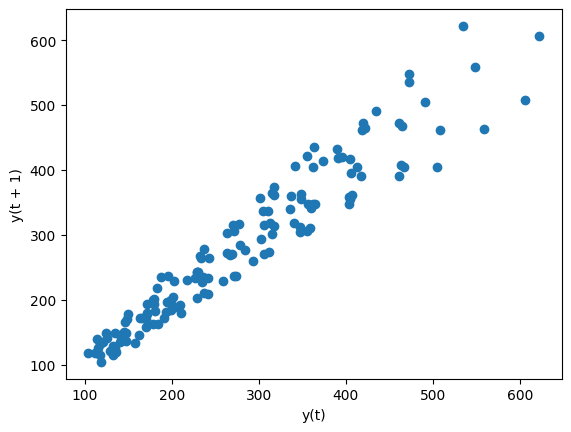

In [25]:
from pandas.plotting import lag_plot

lag_plot(df1['Milhares de passageiros']);

O gráfico acima indica forte correlação entre a série original e a série com atraso 1.

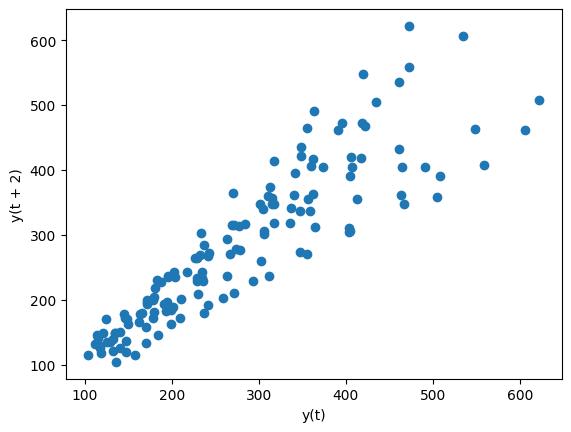

In [26]:
from pandas.plotting import lag_plot

lag_plot(df1['Milhares de passageiros'],lag=2);

**Dados dos nascimentos**

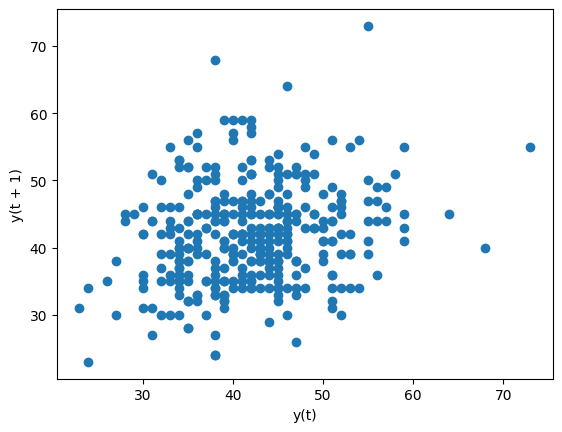

In [27]:
lag_plot(df2['Births']);

<Axes: xlabel='y(t)', ylabel='y(t + 2)'>

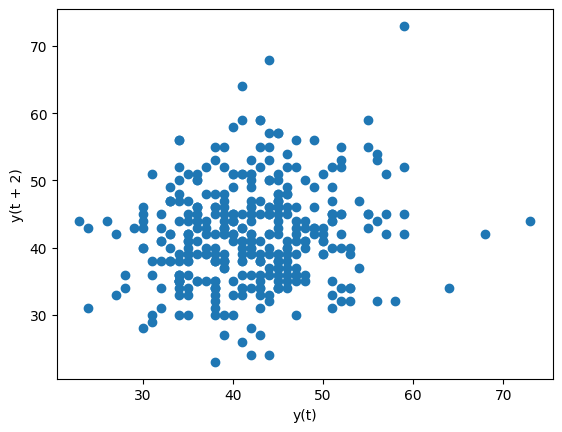

In [28]:
lag_plot(df2['Births'], lag=2)

## Representação gráfica da autocorrelação



In [29]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf

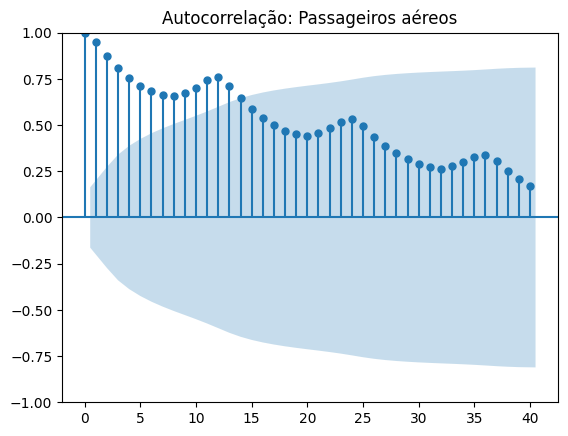

In [30]:
title = 'Autocorrelação: Passageiros aéreos'
lags = 40
plot_acf(df1['Milhares de passageiros'],title=title,lags=lags);


Observe o efeito da sazonalidade e portanto da não-estacionariedade no gráfico da autocorrelação.

A região em azul representa um intervalo de confiança para a correlação, e quando um ponto ultrapassa essa região temos um indicativo de significância da correlação observada.


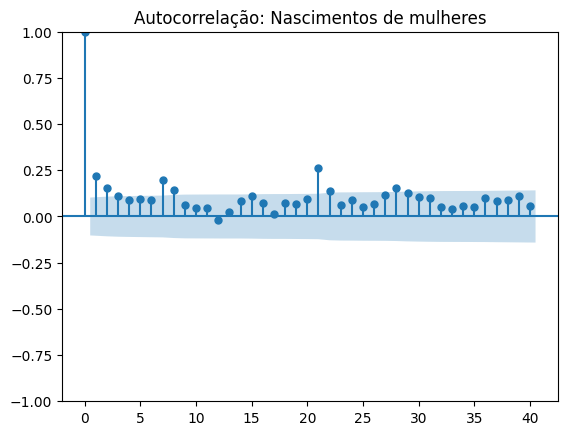

In [31]:
title='Autocorrelação: Nascimentos de mulheres'
lags=40
plot_acf(df2['Births'],title=title,lags=lags);

## Representação gráfica da autocorrelação parcial

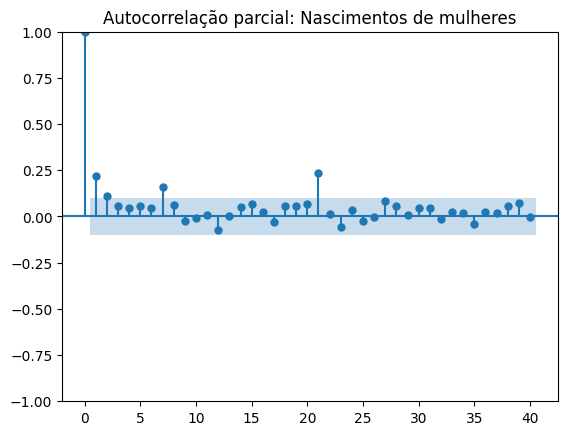

In [32]:
title='Autocorrelação parcial: Nascimentos de mulheres'
lags=40
plot_pacf(df2['Births'],title=title,lags=lags);

**Exercícios:**
    
Obtenha gráficos de autocorrelação e autocorrelação parcial para os dados de COVID-19 do estado de São Paulo. Lembre-se de utilizar os dados completos como fizemos na Aula 2.

Obtenha gráficos de autocorrelação e autocorrelação parcial para os dados PETR4.
    

<a id="section7"></a>
Aula 4: Modelos AR, MA, ARMA, ARIMA

# Modelos AR, MA, ARMA, ARIMA

Baseado em

- MORETTIN, P. A.; TOLOI, C. M. C.. Análise de séries temporais: modelos lineares univariados. 3. ed. São Paulo: Blucher, 2018.

- EHLERS, R.S. Análise de Séries Temporais. ICMC USP. 2009.

Implementações:

- BROWNLEE, J. Introduction to time series forecasting with python: how to prepare data and develop models to predict the future. Machine Learning Mastery, 2017.

Leituras adicionais:

- BOX, G. E., & JENKINS, G. M. Time series analysis: Forecasting and control. San Francisco. Calif: Holden-Day. 1976.

- BOX, G. E., & JENKINS, G. M., & REINSEL, G. C. Time series analysis, forecasting and control. Englewood Clifs. 1994.

- HYNDMAN, R. J., ATHANASOPOULOS, G.; Forecasting: principle and practice: O Texts; 2nd edition. 2018. Acesso em 09/07/2022.

- https://otexts.com/fpp2/AR.html
- https://otexts.com/fpp2/MA.html
- https://otexts.com/fpp2/non-seasonal-arima.html

- https://www.statsmodels.org/stable/examples/notebooks/generated/tsa_arma_0.html
- https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima.model.ARIMA.html
- https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima.model.ARIMAResults.html



# Modelos ARIMA (p,d,q)

**Componentes de um modelo ARIMA:**

- **AR (p)**: Componentes autorregressivas, utilizam a relação de dependência entre a observação corrente e as observações em um período prévio.


- **Integrado (d)**: Diferenças para tornar a série estacionária.


- **MA (q)**: Componentes de médias móveis, utilizam a dependência entre uma obervação e um erro residual de um modelo de média móvel aplicado a observações em atraso.



**SARIMA: ARIMA com componentes sazonais.**



Abordagem de Box e Jenkins (1976): Ajustar modelos autorregressivos integrados de médias móveis, ARIMA(p,d,q) a um conjunto de dados. Veja também Box et al. (1994).

Uma estratégia para a construção do modelo será baseada em um ciclo iterativo, na qual a escolha da estrutura do modelo é baseada nos próprios dados:


1. Uma classe geral de modelos é considerada para a análise, no caso modelos ARIMA (***especificação***),


2. Há ***identificação*** do modelo, com base na análise de autocorrelações, autocorrelações parciais e outros critérios,


3. ***Estimação*** dos parâmetros do modelo identificado,


4. ***Verificação*** ou ***diagnóstico*** do modelo ajustado, por meio de uma análise de resíduos, para saber se esse modelo é adequado para fazer previsão, por exemplo.


Se o modelo não for adequado, as estapas 2, 3 e 4 se repetem até obter um ajuste satisfatório. A etapa mais trabalhosa é a identificação.

No contexto desse curso, utilizaremos a função auto_arima do pacote pmdarima do Python para selecionar a ordem do ARIMA.

## Operadores úteis

### Operador translação (defasagem, backshift)

$B Z_t = Z_{t-1},$

$B^2 Z_t = Z_{t-2},$

$\vdots$

$B^m Z_t = Z_{t-m}$.



### Operador translação para o futuro (forward)

$F Z_t = Z_{t+1},$

$F^2 Z_t = Z_{t+2},$

$\vdots$

$F^m Z_t = Z_{t+m}$.


### Operador diferença

$\Delta Z_t = Z_t - Z_{t-1} = (1-B) Z_t$

ou seja $\Delta = (1-B)$.

### Operador soma (expressão corrigida da aula)

$S Z_t = \displaystyle\sum_{j=0}^ {\infty} Z_{t-j} = Z_t+Z_{t-1}+Z_{t-2}+\ldots = (1+B+B^2+\ldots)Z_t$

do que segue que

$S Z_t = (1-B)^{-1}Z_t = \Delta^{-1}Z_t$

ou seja $S=\Delta^{-1}$.





## Modelos autorregressivos - AR(p)

Considere uma série **estacionária** $Z_t$ com média $\mu$, e considere que $\tilde{Z}_t = Z_t -\mu$.


O termo autoregressão descreve uma regressão da variável contra ela mesma. Uma regressão automática é executada em um conjunto de  valores defasados da ordem $p$.



$\tilde{Z}_{t} = \phi_{1}\tilde{Z}_{t-1} + \phi_{2}\tilde{Z}_{t-2} + \ldots + \phi_{p}\tilde{Z}_{t-p} + a_{t}$

onde $\tilde{Z}_t = Z_t -\mu$, $\phi_ {1}, \ldots, \phi_ {p}$ **são coeficientes de atraso** até $p$ e $a_{t}$ é um ruído branco.

Por exemplo, um modelo <strong> AR (1) </strong> seria dado por

$\tilde{Z}_ {t} = \phi_{1} \tilde{Z}_ {t-1} + a_ {t}$

considerando que um modelo <strong> AR (2) </strong> seria dado por

$\tilde{Z}_ {t} =  \phi_{1} \tilde{Z}_{t-1} + \phi_{2} \tilde{Z}_{t-2} + a_ {t}$

e assim por diante.


## Modelos de médias móveis - MA(q)

Considere uma série **estacionária** $Z_t$ com média $\mu$, e considere que $\tilde{Z}_t = Z_t -\mu$.

$\tilde{Z}_{t} =  a_t  -  \theta_{1}a_{t-1} -\ldots - \theta_q a_{t-q}$

sendo $\tilde{Z}_t = Z_t -\mu$, teremos

$\tilde{Z}_{t} = (1-\theta_1 B - \ldots -\theta_q B^q) a_t = \theta(B) a_t$

onde $\theta(B) = 1-\theta_1 B-\ldots-\theta_q B^q$ é o operador de médias móveis de ordem $q$.

O exemplo mais simples é o MA(1):

$\tilde{Z}_{t} = a_t -\theta_1 a_{t-1}$ ou

$\tilde{Z}_{t} = (1-\theta_1 B) a_t$

com $\theta(B) = (1-\theta_1 B)$.

Um resultado garante que como $\psi(B) = 1 - \theta_1 B$ é finito, o processo é sempre estacionário.




## Modelo autorregressivo e de médias móveis - ARMA(p,q)

Os modelos ARMA(p,q) são dados na forma


$\tilde{Z}_{t} = \phi_{1}\tilde{Z}_{t-1} + \ldots + \phi_{p}\tilde{Z}_{t-p} +  a_t  -  \theta_{1}a_{t-1} -\ldots - \theta_q a_{t-q}$

Exemplo: Um modelo ARMA(1,1) com $p=1$, $q=1$, $\phi(B) = 1-\phi B$, $\theta (B) = 1-\theta B$, é dado por

$\tilde{Z}_{t} = \phi_{1}\tilde{Z}_{t-1} + a_t  -  \theta_{1}a_{t-1}$

Os modelos ARMA podem ser usado para séries estacionárias se as raízes de $\phi(B)=0$ caírem todas fora do círculo unitário.

Para séries não-estacionárias com uma componente de tendência, os modelos ARIMA podem ser mais adequados.


### Função de autocorrelação (fac) e função de autocorrelação parcial (facp) para processos AR, MA, ARMA

Função de autocorrelação (fac):

1. Um processo AR(p) tem fac que decai de acordo com exponenciais ou senoides amortecidas, infinita em extensão;

2. Um processo MA(q) tem fac finita, no sentido de que ela apresenta um corte após o "lag" q;

3. Um processo ARMA (p,q) tem fac infinita em extensão, a qual decai de acordo com exponenciais e/ou senoides amortecidas após o "laq" q-p.

A função de autocorrelação parcial também pode auxiliar na identificação do modelo. Entre outras características,

1. Um processo MA(q) tem facp que se comporta de maneira similar à fac de um processo AR(p), com decaimento exponencial e/ou senoides amortecidas;

2. Um processo ARMA(p,q) tem facp que se comporta como a facp de um processo MA puro.

Para mais informações, veja
- MORETTIN, P. A.; TOLOI, C. M. C.. Análise de séries temporais: modelos lineares univariados. 3. ed. São Paulo: Blucher, 2018.

- BOX, G. E., & JENKINS, G. M., & REINSEL, G. C. Time series analysis, forecasting and control. Englewood Clifs. 1994.



### Correlogramas de dados simulados

In [ ]:
# instale se necessário
#!pip show statsmodels

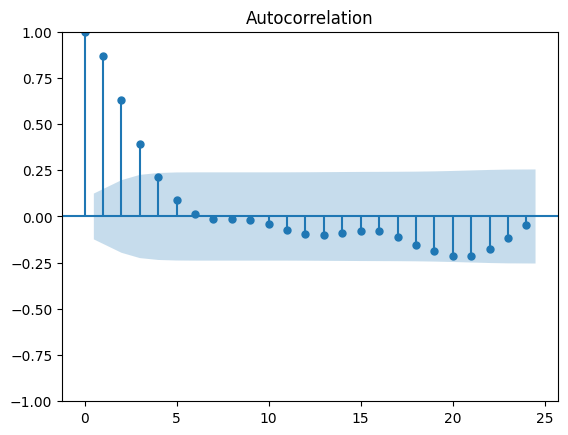

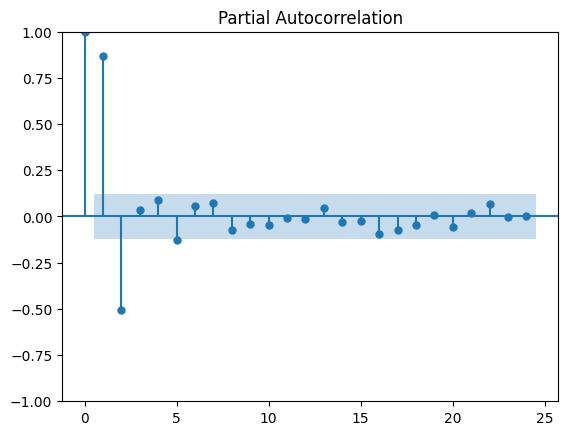

In [ ]:
# ARMA(1,2)
# Fonte: https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima_process.arma_generate_sample.html

import numpy as np
import statsmodels as sm
import matplotlib.pyplot as plt
from statsmodels.tsa.arima_process import arma_generate_sample
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf

# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

plt.rcParams['figure.dpi'] = 100

np.random.seed(12345)
arparams = np.array([.6])
maparams = np.array([.65, .35])
ar = np.r_[1, -arparams] # add zero-lag and negate
ma = np.r_[1, maparams] # add zero-lag
y = arma_generate_sample(ar, ma, 250)
model = ARIMA(endog=y, order=(1,0,2)).fit() # Exercício: Olhar o ajuste

plot_acf(y)
plot_pacf(y, method='ywm') # Método atualizado na nova versão
plt.show()

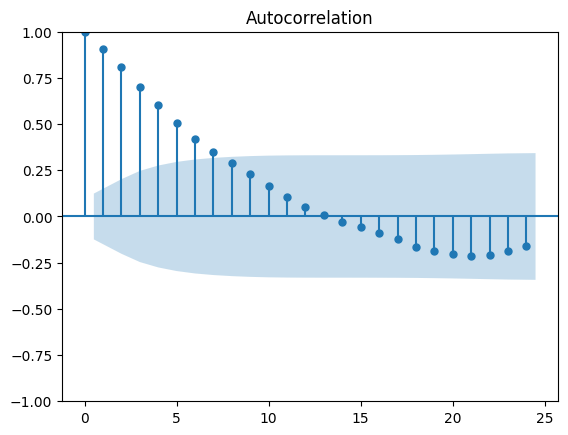

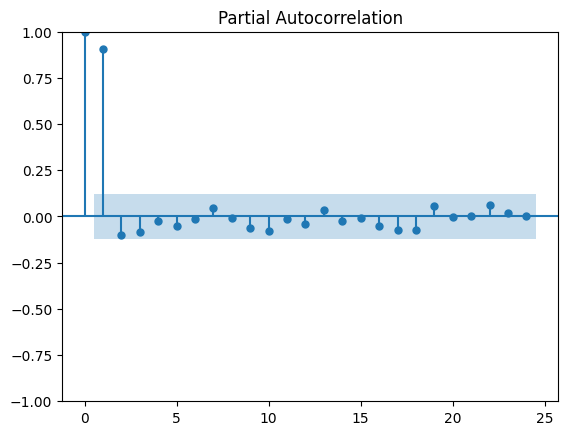

In [ ]:
# ARMA(1,0) ou AR(1)

np.random.seed(12345)
arparams = np.array([.9])
maparams = np.array([.65, .35])
ar = np.r_[1, -arparams]
ma = np.r_[1]
y = arma_generate_sample(ar, ma, 250)
model = ARIMA(y, order=(1,0,0)).fit()
model.params

plot_acf(y)
plot_pacf(y, method='ywm') # Método atualizado na nova versão
plt.show()

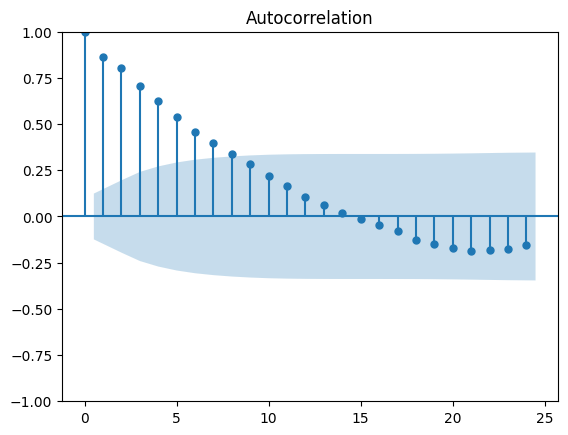

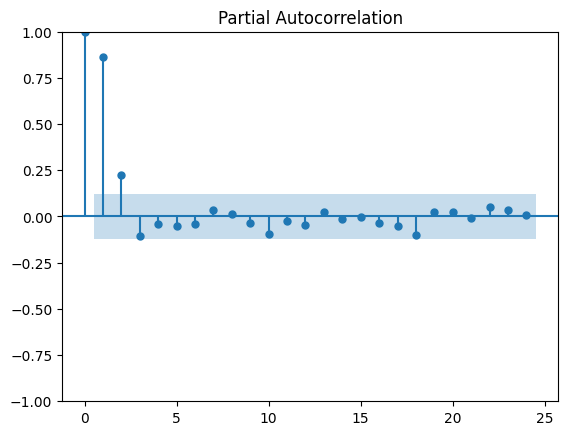

In [ ]:
# ARMA(2,0) ou AR(2)
# Fonte: https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima_process.arma_generate_sample.html

np.random.seed(12345)
arparams = np.array([.6, 0.3])
maparams = np.array([.8, .35])
ar = np.r_[1, -arparams]
ma = np.r_[1]
y = arma_generate_sample(ar, ma, 250)
model = ARIMA(endog=y, order=(2,0,0)).fit()
model.params

plot_acf(y)
plot_pacf(y, method='ywm') # Método atualizado na nova versão
plt.show()

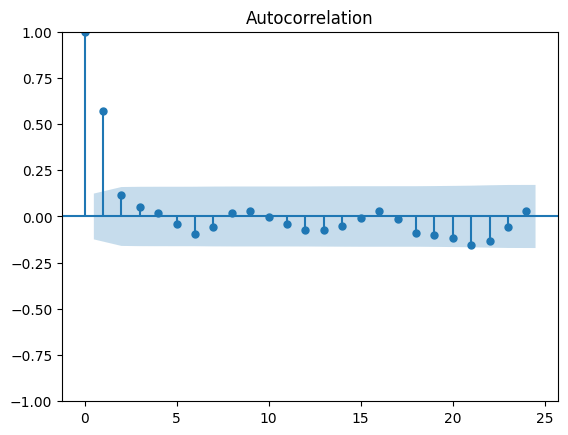

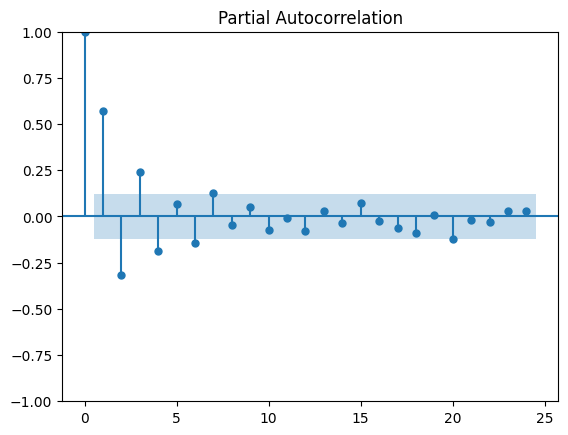

In [ ]:
# ARMA(0,1) ou MA(1)

np.random.seed(12345)
arparams = np.array([.75])
maparams = np.array([.85])
ar = np.r_[1]
ma = np.r_[1, maparams]
y = arma_generate_sample(ar, ma, 250)
model = ARIMA(endog=y, order=(0,0, 1)).fit()

plot_acf(y)
plot_pacf(y, method='ywm') # Método atualizado na nova versão
plt.show()

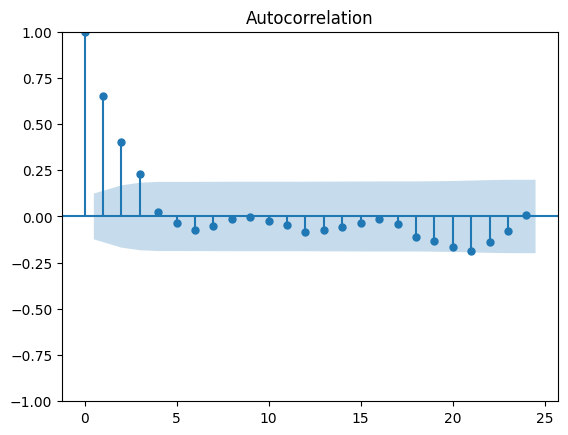

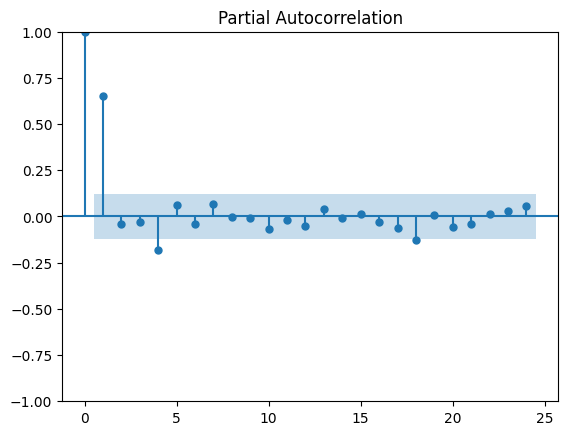

In [ ]:
# ARMA(0,3) ou MA(3)
# Fonte: https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima_process.arma_generate_sample.html

np.random.seed(12345)
arparams = np.array([.75])
maparams = np.array([.6, 0.3, 0.3])
ar = np.r_[1]
ma = np.r_[1, maparams]
y = arma_generate_sample(ar, ma, 250)
model = ARIMA(endog=y, order=(0,0,3)).fit()

plot_acf(y)
plot_pacf(y, method='ywm') # Método atualizado na nova versão
plt.show()

## Aplicações

In [ ]:
#Instale, se necessário, na versão sugerida
!pip install statsmodels==0.13.5

In [ ]:
#Instale, se necessário, na versão sugerida
!pip install pmdarima==2.0.3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 25.1 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
%matplotlib inline
from statsmodels.tsa.stattools import adfuller

# Funções específicas para a modelagem e previsão
from statsmodels.tsa.arima.model import ARIMA, ARIMAResults
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf # para determinar (p,q)

import pmdarima as pm

# Carregue as bases de dados
# Trabalharemos com uma série estacionária, de nascimentos de mulheres, e uma série não estacionária, PETR4

# Dados de nascimentos diários de mulheres
url1='https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/DailyTotalFemaleBirths.csv'
df1 = pd.read_csv(url1,index_col='Date',parse_dates=True)
df1.index.freq = 'D'

# Dados de fechamento das ações da PETR4
url2 = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/PETR4.csv'
df2 = pd.read_csv(url2,index_col='Date',parse_dates=True)
idx = pd.date_range(start=df2.index.min(), end=df2.index.max(), freq='B')
df2 = df2.reindex(idx)
df2.fillna(method='ffill', inplace=True)

## Média móvel autoregressiva - ARMA (p, q)

Olhemos a princípio uma série estacionária e determinaremos (p,q) em um modelo ARMA.


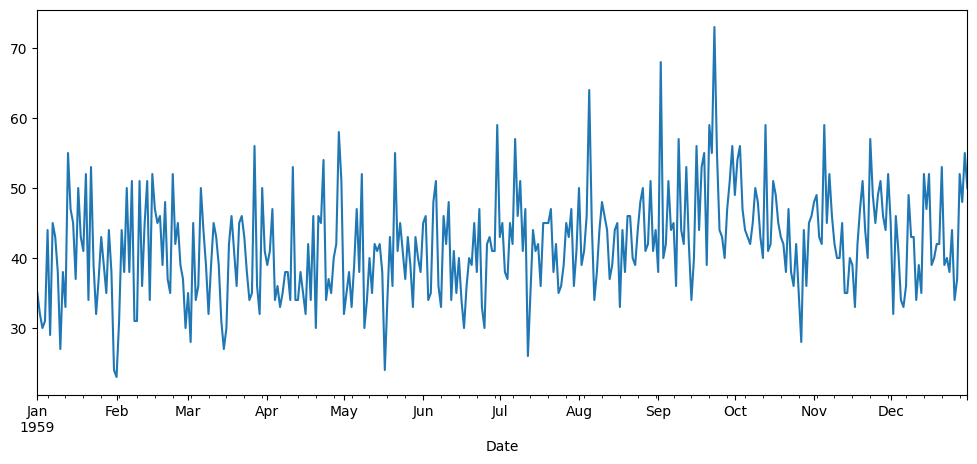

In [ ]:
df1['Births'].plot(figsize=(12,5));

### Execute o teste Dickey-Fuller aumentado para confirmar a estacionariedade

In [ ]:
# Teste de Dickey-Fuller aumentado
# fonte: https://machinelearningmastery.com/time-series-data-stationary-python/

result = adfuller(df1['Births'], autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))



ADF Statistic: -4.808291
p-value: 0.000052
Critical Values:
	1%: -3.449
	5%: -2.870
	10%: -2.571


Há fortes evidências de que a série seja estacionária ou tendência-estacionária.

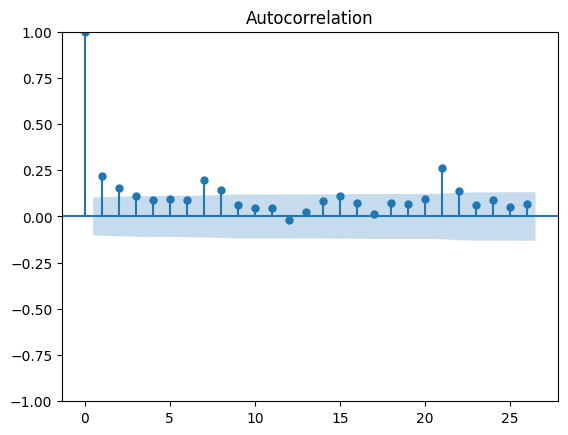

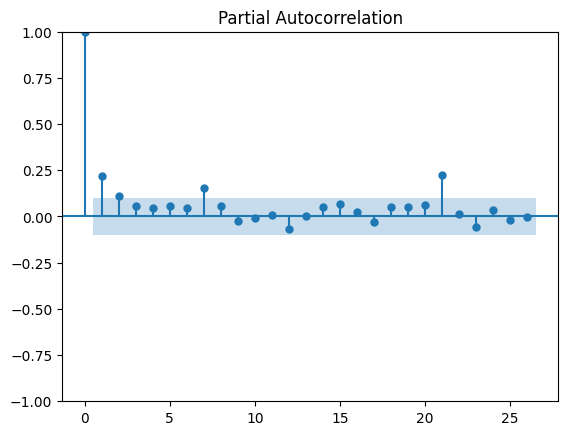

In [ ]:
# Correlograma

plot_acf(df1['Births'])
plot_pacf(df1['Births'], method='ywm') # Método atualizado na nova versão
plt.show()

In [ ]:
# Vamos considerar um modelo ARMA(p,q) e a função auto_arima

In [ ]:
# Novo comando para auto_arima a partir de pm (pmdarima)
stepwise_fit = pm.auto_arima(df1['Births'], start_p=0, start_q=0,
                          max_p=6, max_q=3, m=0,
                          seasonal=False,
                          d=0, trace=True,
                          error_action='ignore',   # we don't want to know if an order does not work
                          suppress_warnings=True,  # we don't want convergence warnings
                          stepwise=True)           # set to stepwise

stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=3776.976, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=2656.891, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=3407.164, Time=0.12 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.13 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2474.496, Time=0.25 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2471.358, Time=0.44 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=2472.653, Time=0.99 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=inf, Time=0.76 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=2471.853, Time=0.54 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=0.19 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=1.07 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=2474.346, Time=1.26 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 5.843 seconds


<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  365
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -1231.679
Date:                Sun, 23 Jul 2023   AIC                           2471.358
Time:                        23:27:53   BIC                           2486.957
Sample:                    01-01-1959   HQIC                          2477.557
                         - 12-31-1959                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.1251      0.060     18.763      0.000       1.008       1.243
ar.L2         -0.1251      0.060     -2.087      0.037      -0.243      -0.008
ma.L1         -0.9623      0.017    -55.585      0.000      -0.996      -0.928
sigma2        49.1469      3.301     14.889      0.000      42.677      55.617
===================================================================================
Ljung-Box (L1) (Q):                   0.04   Jarque-Bera (JB):                24.86
Prob(Q):                              0.84   Prob(JB):                         0.00
Heteroskedasticity (H):               0.96   Skew:                             0.57
Prob(H) (two-sided):                  0.80   Kurtosis:                         3.59
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

### Considere agora bases de treino e teste

In [ ]:
len(df1)

365

In [ ]:
treino = df1.iloc[:290]
teste = df1.iloc[290:]

In [ ]:
# Ignorar warnings não prejudiciais
#
import warnings
warnings.filterwarnings("ignore")

modelo = ARIMA(endog=treino['Births'],order=(2,0,1))
resultados = modelo.fit()
resultados.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                 Births   No. Observations:                  290
Model:                 ARIMA(2, 0, 1)   Log Likelihood                -981.565
Date:                Sun, 23 Jul 2023   AIC                           1973.131
Time:                        23:27:53   BIC                           1991.480
Sample:                    01-01-1959   HQIC                          1980.482
                         - 10-17-1959                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         42.3955      5.590      7.585      0.000      31.440      53.351
ar.L1          1.0670      0.076     13.994      0.000       0.918       1.216
ar.L2         -0.0723      0.069     -1.040      0.298      -0.208       0.064
ma.L1         -0.9521      0.044    -21.883      0.000      -1.037      -0.867
sigma2        50.8100      3.880     13.095      0.000      43.205      58.415
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                22.38
Prob(Q):                              0.94   Prob(JB):                         0.00
Heteroskedasticity (H):               0.90   Skew:                             0.59
Prob(H) (two-sided):                  0.59   Kurtosis:                         3.68
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
# O melhor modelo obtido com esta versão do pmdarima foi ARMA(2,1). Com outra versão pode-se selecionar outro modelo como o melhor.

In [ ]:
# Olhando as previsões

inicio=len(treino)
fim=len(treino)+len(teste)-1
previsoes = resultados.predict(start=inicio, end=fim).rename('Previsões ARMA(2,1)')

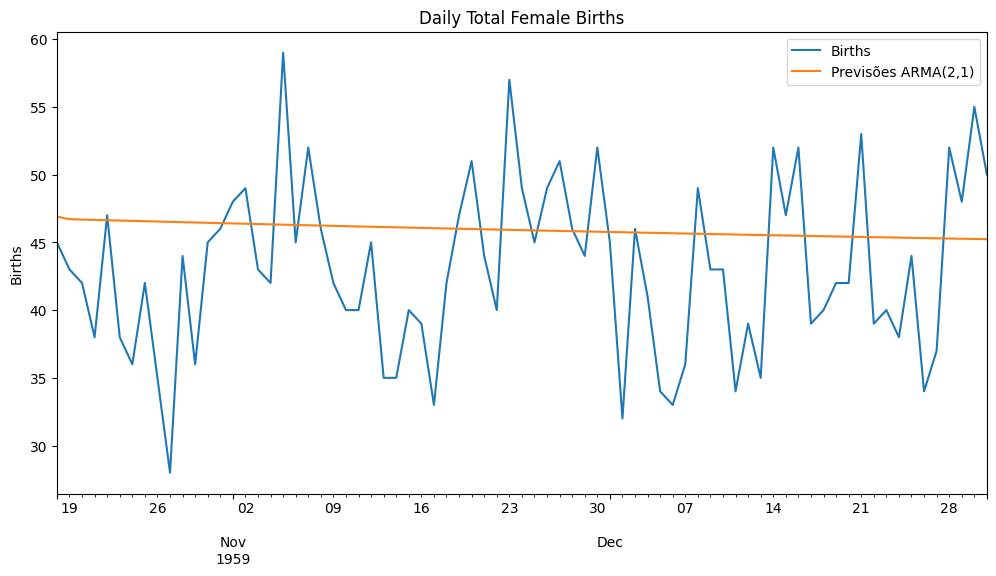

In [ ]:
title = 'Daily Total Female Births'
ylabel='Births'
xlabel='' # we don't really need a label here

ax = teste['Births'].plot(legend=True,figsize=(12,6),title=title)
previsoes.plot(legend=True)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel);

Como nosso conjunto de dados inicial não exibiu tendência ou componente sazonal, essa previsão faz sentido. Na próxima seção, tomaremos medidas adicionais para avaliar o desempenho de nossas previsões e fazer previsões para o futuro.

## Modelo autorregressivo integrado de médias móveis - ARIMA (p,d,q)
As etapas são as mesmas que para o ARMA (p, q), exceto que aplicaremos um componente diferencial para tornar o conjunto de dados estacionário. <br>
Primeiro, vamos dar uma olhada no conjunto de dados PETR4.
### Plotar os dados de origem

[Text(0.5, 0, ''), Text(0, 0.5, 'Fechamentos')]

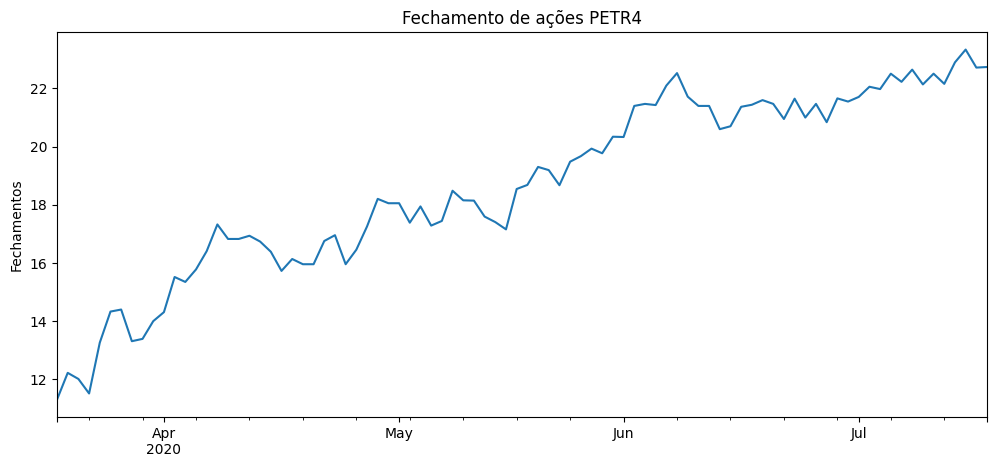

In [ ]:
title = 'Fechamento de ações PETR4'
ylabel='Fechamentos'

ax = df2['Close'].plot(figsize=(12,5),title=title);
ax.set(xlabel=xlabel, ylabel=ylabel)


### Executar uma decomposição em tendência e sazonalidade

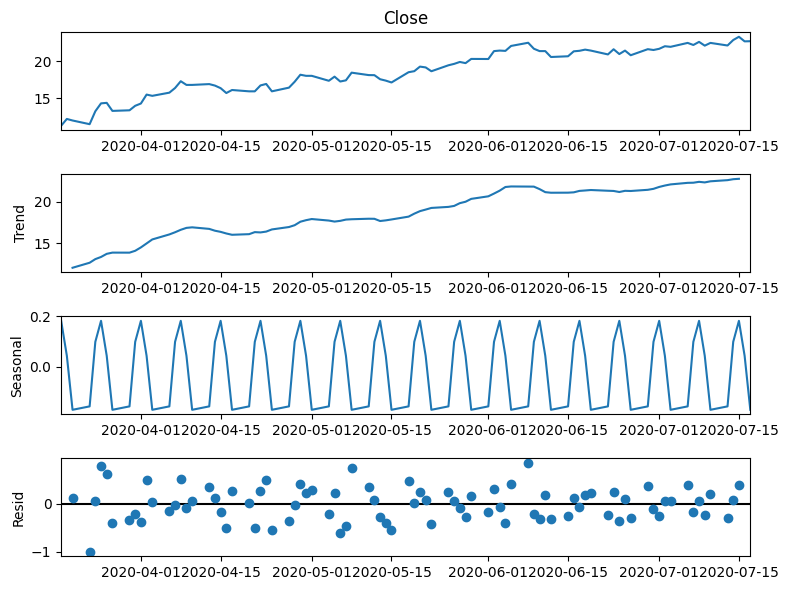

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

plt.rcParams['figure.figsize'] = (8,6)

result = seasonal_decompose(df2['Close'], model='additive')  # model='add' also works
result.plot();

Possivelmente existe sazonalidade nesses dados. A princípio vamos considerar um modelo ARIMA não sazonal.

Vamos usar o pdmarima.auto_arima para determinar o modelo ARIMA.



### Execute o teste Dickey-Fuller aumentado na primeira diferença

In [ ]:
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.statespace.tools import diff

result = adfuller(diff(df2['Close']), autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))


ADF Statistic: -10.506245
p-value: 0.000000
Critical Values:
	1%: -3.509
	5%: -2.896
	10%: -2.585


Isso confirma que atingimos a estacionariedade após a primeira diferença.
### Construa os gráficos ACF e PACF

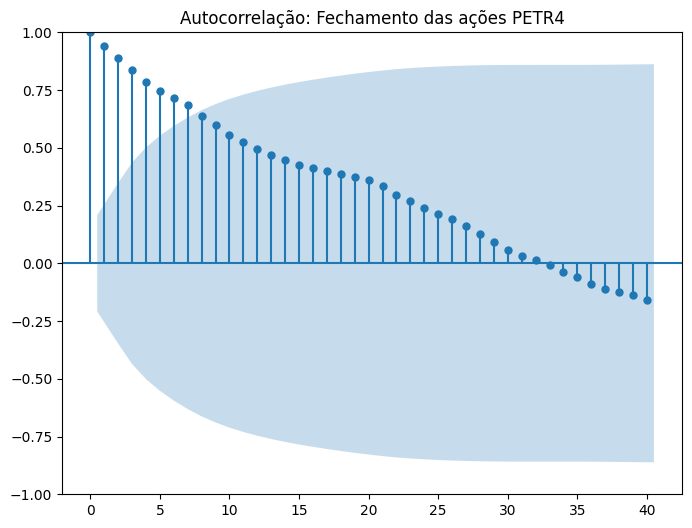

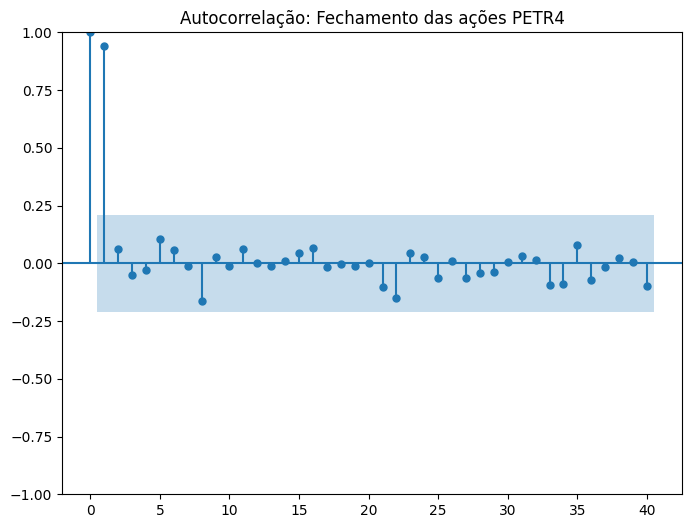

In [ ]:
title = 'Autocorrelação: Fechamento das ações PETR4'
lags = 40
plot_acf(df2['Close'],title=title,lags=lags);
plot_pacf(df2['Close'],title=title,lags=lags, method='ywm'); # Método atualizado na nova versão
plt.show();

Vamos dar uma olhada no <tt> pmdarima.auto_arima </tt> feito com o stepwise_fit para ver se ter os termos $p$ e $q$ o mesmo ainda faz sentido:

In [ ]:
stepwise_fit = pm.auto_arima(df2['Close'], start_p=0, start_q=0,
                          max_p=3, max_q=3, m=7,
                          seasonal=False,
                          d=None, trace=True,
                          error_action='ignore',   # we don't want to know if an order does not work
                          suppress_warnings=True,  # we don't want convergence warnings
                          stepwise=True)           # set to stepwise

stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=152.390, Time=0.03 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=153.013, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=152.598, Time=0.07 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=154.944, Time=0.04 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=152.746, Time=0.39 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 0.596 seconds


<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   88
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -74.195
Date:                Sun, 23 Jul 2023   AIC                            152.390
Time:                        23:27:58   BIC                            157.322
Sample:                    03-18-2020   HQIC                           154.376
                         - 07-17-2020                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.1316      0.062      2.124      0.034       0.010       0.253
sigma2         0.3223      0.053      6.046      0.000       0.218       0.427
===================================================================================
Ljung-Box (L1) (Q):                   1.40   Jarque-Bera (JB):                 1.14
Prob(Q):                              0.24   Prob(JB):                         0.57
Heteroskedasticity (H):               0.57   Skew:                             0.25
Prob(H) (two-sided):                  0.14   Kurtosis:                         2.74
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

Vamos avaliar o modelo ARIMA (0,1,0) em bases de treino e teste


### Divida os dados em conjuntos de treino / teste

In [ ]:
len(df2)

88

In [ ]:
# Defina as bases de treino e teste
treino = df2.iloc[:70]
teste = df2.iloc[70:]

In [ ]:
## Atenção! Versões diferentes de pacotes podem levar a previsões diferentes

from statsmodels.tsa.arima.model import ARIMA

# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

modelo = ARIMA(treino['Close'], order=(0,1,0))
resultados = modelo.fit()
resultados.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                  Close   No. Observations:                   70
Model:                 ARIMA(0, 1, 0)   Log Likelihood                 -63.547
Date:                Sun, 23 Jul 2023   AIC                            129.094
Time:                        23:27:58   BIC                            131.328
Sample:                    03-18-2020   HQIC                           129.981
                         - 06-23-2020                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3694      0.063      5.876      0.000       0.246       0.493
===================================================================================
Ljung-Box (L1) (Q):                   0.06   Jarque-Bera (JB):                 0.99
Prob(Q):                              0.80   Prob(JB):                         0.61
Heteroskedasticity (H):               0.53   Skew:                             0.26
Prob(H) (two-sided):                  0.14   Kurtosis:                         2.74
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

### Previsões

In [ ]:
inicio=len(treino)
fim=len(treino)+len(teste)-1
previsoes = resultados.predict(start=inicio,end = fim, dynamic=False, typ='levels').rename('Previsões ARIMA (0,1,0)')

Passar <tt> dynamic = False </tt> significa que as previsões em cada ponto são geradas usando o histórico completo até aquele ponto (todos os valores defasados).

Passar <tt> typ = 'levels' </tt> prevê os níveis das variáveis endógenas originais. Se tivéssemos usado o padrão <tt> typ = 'linear' </tt>, teríamos visto previsões lineares em termos de variáveis endógenas diferenciadas.

Para obter mais informações sobre esses argumentos, visite https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARIMAResults.predict.html

<Axes: >

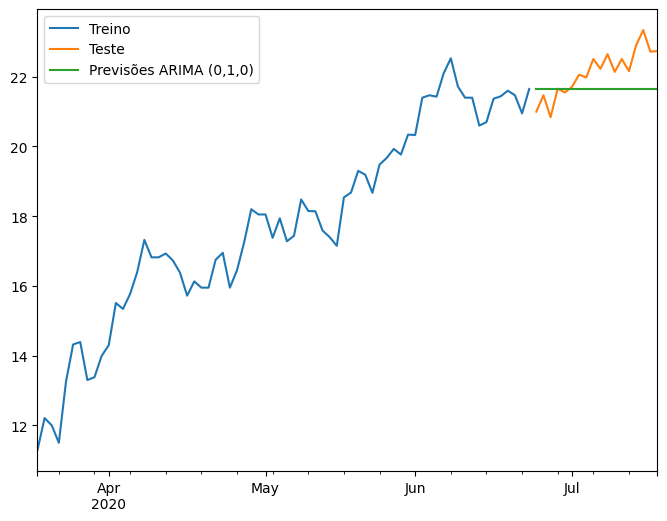

In [ ]:
treino['Close'].plot(legend=True, label='Treino')
teste['Close'].plot(legend=True, label='Teste')
previsoes.plot(legend=True, figsize=(8,6))


### Treine novamente o modelo com os dados completos e preveja o futuro

In [ ]:
modelo = ARIMA(df2['Close'],order=(0,1,0))
resultados = modelo.fit()
fcast = resultados.predict(len(df2),len(df2)+11,typ='levels').rename('Previsões ARIMA(0,1,0) ')

[Text(0.5, 0, ''), Text(0, 0.5, 'Fechamentos')]

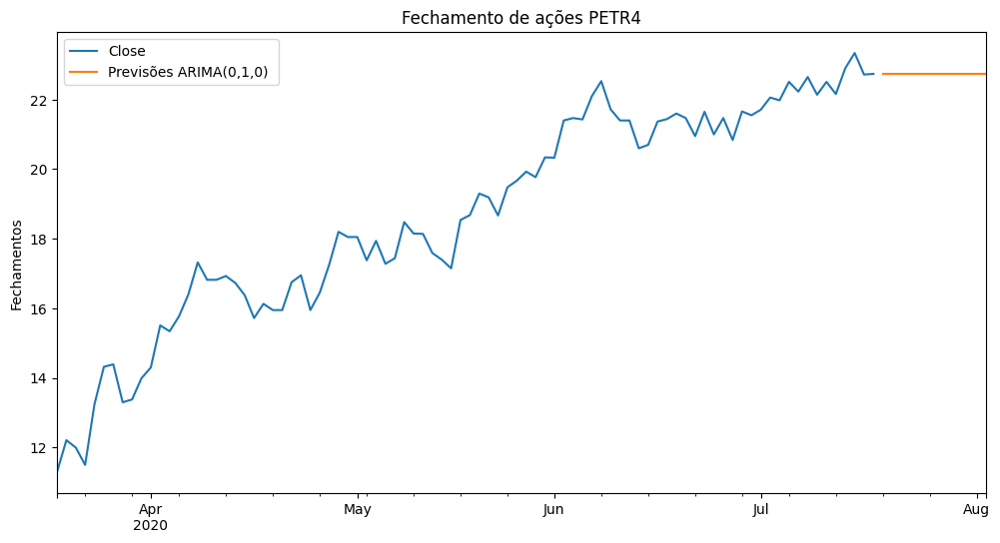

In [ ]:
# Previsão
title = 'Fechamento de ações PETR4'
ylabel='Fechamentos'
xlabel=''

ax = df2['Close'].plot(legend=True,figsize=(12,6),title=title)
fcast.plot(legend=True)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel)


**Como exercício, verifique se o ARIMA com sazonalidade traz previsões melhores para esses dados. Para isso, use seasonal=True no auto_arima.**

<a id="section8"></a>
Aula 3: Exercícios

# Prática 3

***Aprendizado Dinâmico***

Considere as duas bases de dados a seguir

- Dados de fechamento do papel PETR4 de um período de março a julho de 2020 no arquivo PETR4.csv.

- Dados de casos confirmados para COVID-19 no estado de SP.


Nesta prática, aplicaremos os conhecimentos adquiridos na Aula 3 a esses dados, a saber:

- Função de autocorrelação

- Função de autocorrelação parcial

- Repetir a modelagem para os dados de PETR4 visto em aula.

- Para os dados de COVID-19: Um modelo ARIMA sazonal.

**1. Carregue as bibliotecas**

In [12]:
# Bibliotecas

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline

import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf # para determinar (p,q)


# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

**2. Faça a leitura dos dados de PETR4 em df1 e de COVID-19 no estado de SP em df2. Para os dados PETR4 usaremos a variável Close e para os dados de COVID-19 usaremos a variável confirmed. Complete as bases de dados usando reindex e fillna.**

In [13]:
#pkgdir = '/hdd/MBA/AprendizadoDinamico/Data'

# PETR4 - Leitura dos dados
df1 = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/PETR4.csv', index_col='Date', parse_dates=True)

idx1 = pd.date_range(start=df1.index.min(), end=df1.index.max(), freq='B')
df1 = df1.reindex(idx1)
df1.fillna(method='ffill', inplace=True)


# COVID-19 no estado de SP
df2 = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv', index_col='date', parse_dates=True)

idx2 = pd.date_range(start=df2.index.min(), end=df2.index.max(), freq='D')
df2 = df2.reindex(idx2)
df2.fillna(0,inplace=True)


**3. Verifique graficamente se os dados foram lidos de forma correta.**

<Axes: >

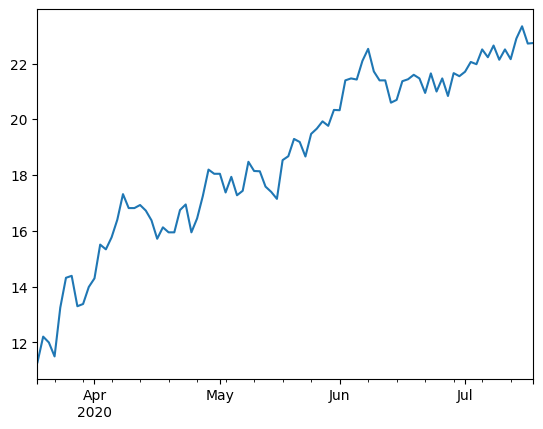

In [14]:
df1['Close'].plot()

<Axes: >

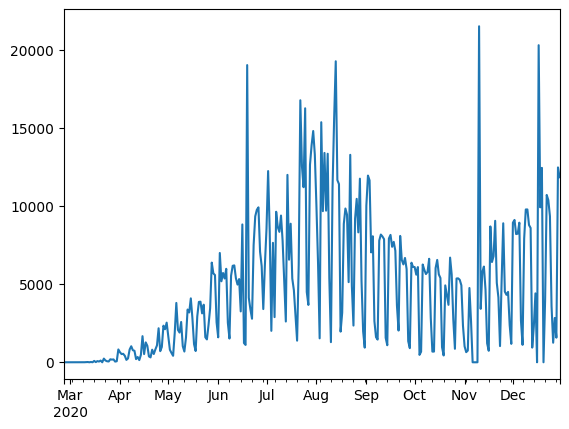

In [15]:
df2['confirmed'].plot()

**4. Obtenha os gráficos de autocorrelação e autocorrelação parcial para ambas as aplicações. Que características você observa nesses gráficos? Que modelo sugeriria com base nos correlogramas?**

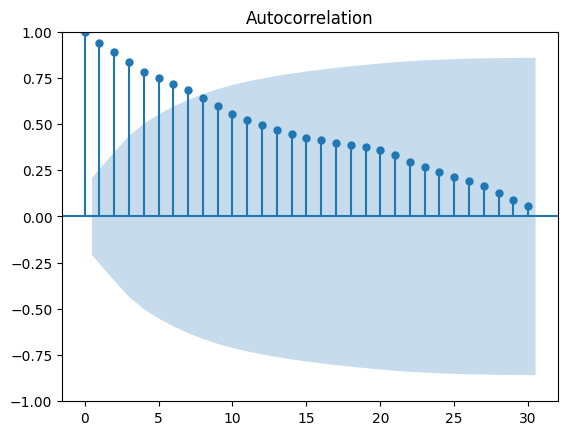

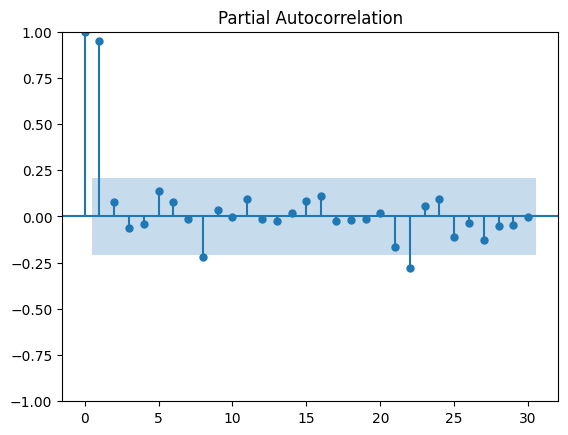

In [16]:
# Correlograma

plot_acf(df1['Close'], lags=30)
plot_pacf(df1['Close'], lags=30)
plt.show()

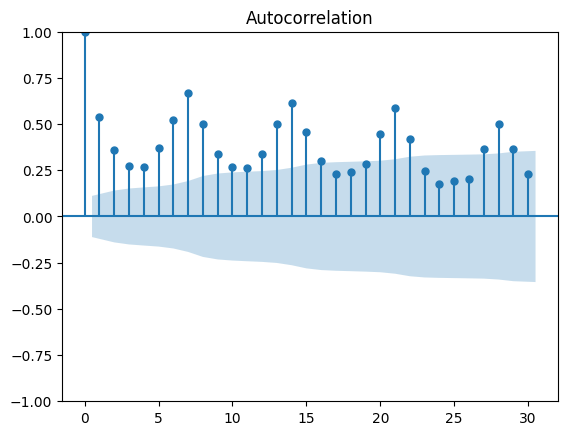

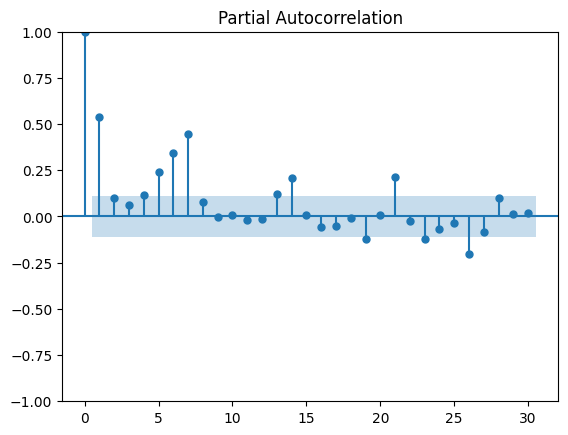

In [17]:

# Correlograma

plot_acf(df2['confirmed'], lags=30)
plot_pacf(df2['confirmed'], lags=30)
plt.show()

**5. Repita os gráficos de autocorrelação e autocorrelação parcial para a primeira diferença de cada aplicação. O que você pode concluir?**

In [18]:
df1.head(10)

,Open,High,Low,Close,Adj Close,Volume
2020-03-18,11.79,12.27,10.87,11.29,11.289389,162515200.0
2020-03-19,11.07,13.07,10.85,12.21,12.209339,157065200.0
2020-03-20,13.11,13.50,11.83,12.00,11.999351,149029900.0
2020-03-23,12.11,12.18,11.28,11.50,11.499378,107092400.0
2020-03-24,12.57,13.54,12.28,13.25,13.249283,114259200.0
2020-03-25,13.24,14.79,12.83,14.32,14.319224,158286200.0
2020-03-26,14.40,15.19,13.81,14.39,14.389221,130618400.0
2020-03-27,13.30,13.69,13.25,13.30,13.299280,101405900.0
2020-03-30,13.15,13.74,12.83,13.38,13.379276,110947200.0
2020-03-31,13.60,14.54,13.60,13.99,13.989244,156116500.0


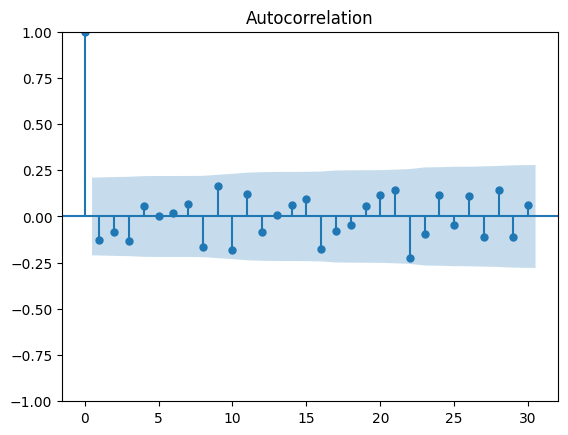

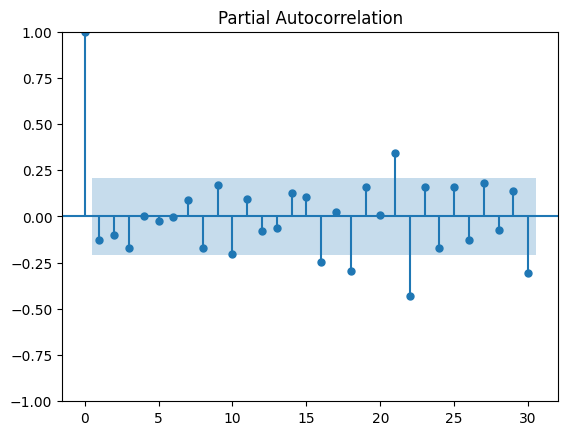

In [19]:
# Correlograma

plot_acf(np.diff(df1['Close']), lags=30)
plot_pacf(np.diff(df1['Close']), lags=30)
plt.show()

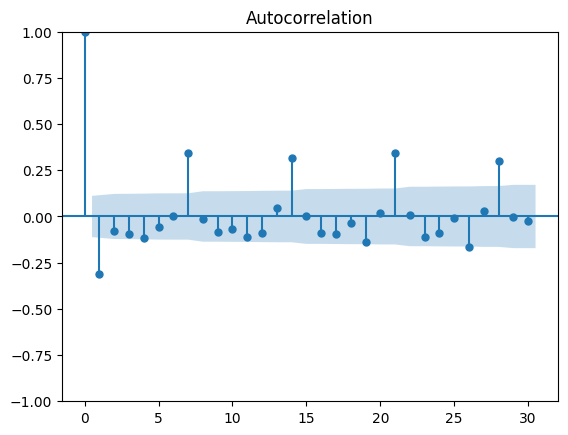

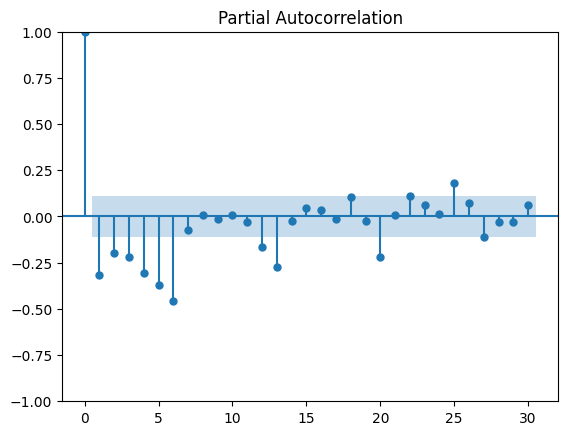

In [20]:
# Correlograma

plot_acf(np.diff(df2['confirmed']), lags=30)
plot_pacf(np.diff(df2['confirmed']), lags=30)
plt.show()

**6. Para os dados de PETR4, refaça a modelagem vista em aula.**

In [21]:
#Instale, se necessário, na versão sugerida
!pip install statsmodels==0.13.5

#Instale, se necessário, na versão sugerida
!pip install pmdarima==2.0.3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 8.2 MB/s eta 0:00:00


In [22]:
from pmdarima import auto_arima # Para determinar a ordem do ARIMA


In [23]:
stepwise_fit = auto_arima(df1['Close'], start_p=0, start_q=0,
                          max_p=2, max_q=2, m=0,
                          seasonal=False,
                          d=None, trace=True,
                          error_action='ignore',   # we don't want to know if an order does not work
                          suppress_warnings=True,  # we don't want convergence warnings
                          stepwise=True)           # set to stepwise

stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=152.390, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=153.013, Time=0.08 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=152.598, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=154.944, Time=0.06 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=152.746, Time=0.32 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0] intercept
Total fit time: 0.754 seconds


<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   88
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -74.195
Date:                Sun, 23 Jul 2023   AIC                            152.390
Time:                        23:33:20   BIC                            157.322
Sample:                    03-18-2020   HQIC                           154.376
                         - 07-17-2020                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.1316      0.062      2.124      0.034       0.010       0.253
sigma2         0.3223      0.053      6.046      0.000       0.218       0.427
===================================================================================
Ljung-Box (L1) (Q):                   1.40   Jarque-Bera (JB):                 1.14
Prob(Q):                              0.24   Prob(JB):                         0.57
Heteroskedasticity (H):               0.57   Skew:                             0.25
Prob(H) (two-sided):                  0.14   Kurtosis:                         2.74
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

**7. Desafio: Ainda não vimos o modelo SARIMA, mas já sabemos que a série de COVID-19 tem sazonalidade. Como os dados de COVID-19 apresentam sazonalidade, vamos arriscar no tema da próxima aula? Altere seasonal para True e escolha o melhor modelo entre os SARIMA propostos. Discutiremos com detalhes este modelo na Aula 4.**

In [ ]:
stepwise_fit = auto_arima(df2['confirmed'], start_p=0, start_q=0,
                          max_p=3, max_q=3, m=7,
                          seasonal=True,
                          d=None, trace=True,
                          error_action='ignore',   # we don't want to know if an order does not work
                          suppress_warnings=True,  # we don't want convergence warnings
                          stepwise=True)           # set to stepwise

stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[7] intercept   : AIC=5922.655, Time=2.41 sec
 ARIMA(0,1,0)(0,0,0)[7] intercept   : AIC=6007.140, Time=0.06 sec
 ARIMA(1,1,0)(1,0,0)[7] intercept   : AIC=5916.437, Time=1.43 sec
 ARIMA(0,1,1)(0,0,1)[7] intercept   : AIC=5845.769, Time=3.00 sec
 ARIMA(0,1,0)(0,0,0)[7]             : AIC=6005.169, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[7] intercept   : AIC=5891.230, Time=0.58 sec
 ARIMA(0,1,1)(1,0,1)[7] intercept   : AIC=5778.886, Time=3.26 sec
 ARIMA(0,1,1)(1,0,0)[7] intercept   : AIC=5816.796, Time=1.83 sec
 ARIMA(0,1,1)(2,0,1)[7] intercept   : AIC=5760.616, Time=6.20 sec
 ARIMA(0,1,1)(2,0,0)[7] intercept   : AIC=5787.518, Time=5.16 sec
 ARIMA(0,1,1)(2,0,2)[7] intercept   : AIC=inf, Time=3.98 sec
 ARIMA(0,1,1)(1,0,2)[7] intercept   : AIC=5813.850, Time=2.91 sec
 ARIMA(0,1,0)(2,0,1)[7] intercept   : AIC=5924.628, Time=2.99 sec
 ARIMA(1,1,1)(2,0,1)[7] intercept   : AIC=5772.417, Time=2.66 sec
 ARIMA(0,1,2)(2,0,1)[7] intercept   : 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:                                 y   No. Observations:                  309
Model:             SARIMAX(0, 1, 1)x(1, 0, 1, 7)   Log Likelihood               -2874.364
Date:                           Sun, 23 Jul 2023   AIC                           5756.727
Time:                                   23:34:24   BIC                           5771.648
Sample:                               02-26-2020   HQIC                          5762.693
                                    - 12-30-2020                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9021      0.027    -33.593      0.000      -0.955      -0.849
ar.S.L7        0.9673      0.034     28.507      0.000       0.901       1.034
ma.S.L7       -0.7733      0.067    -11.459      0.000      -0.906      -0.641
sigma2      7.315e+06   2.74e+05     26.680      0.000    6.78e+06    7.85e+06
===================================================================================
Ljung-Box (L1) (Q):                   0.52   Jarque-Bera (JB):              2203.69
Prob(Q):                              0.47   Prob(JB):                         0.00
Heteroskedasticity (H):              16.15   Skew:                             1.88
Prob(H) (two-sided):                  0.00   Kurtosis:                        15.55
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

<a id="section9"></a>
Aula 4 (continuação): ARIMA, SARIMA, Diagnóstico

# Modelos ARIMA, SARIMA. Diagnóstico.

Baseado em

- MORETTIN, P. A.; TOLOI, C. M. C.. Análise de séries temporais: modelos lineares univariados. 3. ed. São Paulo: Blucher, 2018.

- EHLERS, R.S. Análise de Séries Temporais. ICMC USP. 2009.


Implementações:

- BROWNLEE, J. Introduction to time series forecasting with python: how to prepare data and develop models to predict the future. Machine Learning Mastery, 2017.

Leituras adicionais:

- HYNDMAN, R. J., ATHANASOPOULOS, G.; Forecasting: principle and practice: O Texts; 2nd edition. 2018. Acesso em 09/07/2022.

- https://otexts.com/fpp2/non-seasonal-arima.html
- https://otexts.com/fpp2/seasonal-arima.html



**Vamos fazer uma pequena revisão da aula anterior?**

Sejam

- $\tilde{Z}_t = Z_t -\mu$


- $B^m Z_t = Z_{t-m}$ (Operador translação (defasagem, backshift))


- $F^m Z_t = Z_{t+m}$ (Operador translação para o futuro (forward))


- $\Delta = (1-B)$ (Operador diferença)


- $S Z_t = (1-B)^{-1}Z_t = \Delta^{-1}Z_t$ (Operador soma)






## Modelos autorregressivos - AR(p)

$$\tilde{Z}_{t} = \phi_{1}\tilde{Z}_{t-1} + \phi_{2}\tilde{Z}_{t-2} + \ldots + \phi_{p}\tilde{Z}_{t-p} + a_{t}$$

onde $a_{t}$ é um ruído branco.

Sendo o operador autorregressivo estacionário de ordem p dado por

$$\phi(B) = 1-\phi_1 B-\phi_2 B^2-\ldots -\phi_p B^p,$$

podemos reescrever o modelo AR(p) como

$$\phi(B)\tilde{Z}_{t} =  a_{t}$$


## Modelos de médias móveis - MA(q)

$$\tilde{Z}_{t} =  a_t  -  \theta_{1}a_{t-1} -\ldots - \theta_q a_{t-q}$$

$$\tilde{Z}_{t} = (1-\theta_1 B - \ldots -\theta_q B^q) a_t $$

Assim

$$\tilde{Z}_{t}=\theta(B) a_t$$

onde $\theta(B) = 1-\theta_1 B-\ldots-\theta_q B^q$ é o operador de médias móveis de ordem $q$.


## Modelos ARMA(p,q)

Os modelos ARMA(p,q) são dados na forma

$$\tilde{Z}_{t} = \phi_{1}\tilde{Z}_{t-1} + \ldots + \phi_{p}\tilde{Z}_{t-p} +  a_t  -  \theta_{1}a_{t-1} -\ldots - \theta_q a_{t-q}$$

ou podemos reescrever

$$\phi(B)\tilde{Z}_{t} = \theta(B) a_t$$

em que

- $\phi(B)$ é o operador autorregressivo

- $\theta(B)$ é o operador de médias móveis


# Modelos ARIMA (p,d,q)


**Componentes de um modelo ARIMA (p,d,q):**

- **AR (p)**: Componentes autorregressivas, utilizam a relação de dependência entre a observação corrente e as observações em um período prévio

- **Integrado (d)**: Diferenças para tornar a série estacionária

- **MA (q)**: Componentes de médias móveis, utilizam a dependência entre uma obervação e um erro residual de um modelo de média móvel aplicado a observações em atraso.





Considere que $Z_t$ não é estacionária mas

$$W_t = \Delta^d Z_t$$

é uma série estacionária e utilizamos portanto um modelo ARMA(p,q) para $W_t$, ou seja,

$$\phi(B) W_t = \theta(B) a_t.$$

Se $W_t$ for uma diferença de $Z_t$, então dizemos que $Z_t$ segue um modelo autorregressivo _integrado_ de médias móveis, ou um modelo ARIMA:

$$\phi(B) \Delta^d Z_t = \theta(B) a_t$$

de ordem (p,d,q) e escrevemos ARIMA (p,d,q) em que $p$ e $q$ são as ordens de $\phi(B)$ e $\theta(B)$, respectivamente.



# Modelos SARIMA (p,d,q)x(P, D,Q)m

- **SARIMA: ARIMA com sazonalidade**


- Componente sazonal se repete a cada $m$ observações ($m>1$).


- Com dados mensais e $m=12$, tipicamente espera-se que $Z_t$ dependa de $Z_{t-12}$ e talvez $Z_{t-24}$ além de $Z_{t-1}, Z_{t-2}$, ...


- Tomar a primeira diferença $\Delta Z_t = Z_t -Z_{t-1}$ não é suficiente para tornar a
série (aproximadamente) estacionária.


- Considere as diferenças sazonais
$$\Delta_m Z_t = (1 - B^m )Z_t = Z_t - Z_{t-m}$$
sendo $m$ o periodo da sazonalidade.


- A D-ésima diferença sazonal é denotada por $\Delta^D_m$.


- Combinando-se diferenciação simples e sazonais obtem-se o operador $\Delta^d\Delta^D_m$.


**Componentes de um modelo SARIMA (p,d,q)x(P,D,Q)m:**

- $(p,d,q)$: componentes não-sazonais
- $(P,D,Q)_m$: componentes sazonais

Aqui $m$ é o período da sazonalidade.


$$\phi(B) \Phi(B^m ) W_t = \theta(B) \Theta(B^m ) a_ t$$

onde

- $\phi(B) = (1-\alpha_1 B-\ldots \alpha_p B^p)$

- $\Phi(B^m)= (1- \phi_1 B^m-\ldots - \phi_p B^{P_m})$

- $W_t = \Delta^d \Delta^D Z_t = (1-B)^d (1-B^m)^D Z_t$

- $\theta(B) = (1+\beta_1 B + \ldots + \beta_q B^q)$

- $\Theta(B^m) = (1+\theta_1 B^m+\ldots+\theta_Q B^{Q_m})$






**Exemplo:** Série mensal com 1 diferença simples e 1 sazonal com período 12


$\begin{array}{lll}
\Delta \Delta_{12} Z_t & =& (1-B)(1-B^{12})Z_t\\
&=& (1-B-B^{12}+B^{13}) Z_t\\
&=& Z_t-Z_{t-1}-Z_{t-12}+Z_{t-13}\end{array}$


**Exemplo:** Modelo $\mbox{ SARIMA(1,0,0)}\times(0,1,1)_{12}$


$\begin{array}{rll}
(1-\phi B)(1-B^{12})Z_t &=& (1-\theta B^{12})a_t\\
Z_t &=& Z_{t-12}+\phi(Z_{t-1}-Z_{t-13})+a_t-\theta a_{t-12}\end{array}$



**Observações**

- Na prática os valores de d e D em geral não serão muito maiores do que 1 e um número pequeno de coeficientes será suficiente.

-  Especificar os valores de d e D que tornam a série (aproximadamente) estacionária e remove a maior parte da sazonalidade.

-  Os valores de p, P, q e Q devem ser especificados com base nas funções de autocorrelação e autocorrelação parcial da série diferenciada.

-  Os valores de P e Q são especificados basicamente olhando-se para as defasagens $k = m, 2m, \ldots.$

## Aplicação

In [31]:
#Instale, se necessário, na versão sugerida
!pip install statsmodels==0.13.5

In [32]:
#Instale, se necessário, na versão sugerida
!pip install pmdarima==2.0.3

<Axes: >

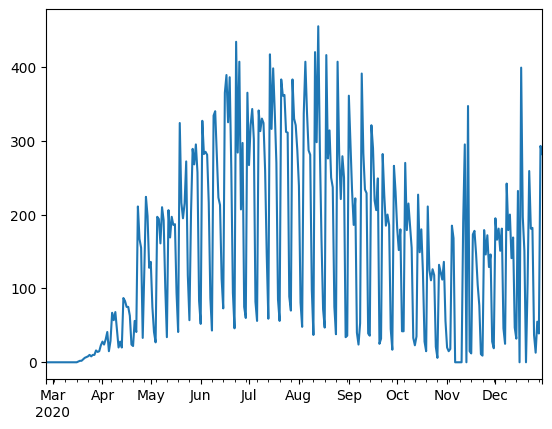

In [33]:
import pandas as pd
import numpy as np
%matplotlib inline

from statsmodels.tsa.statespace.sarimax import SARIMAX

from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from pmdarima import auto_arima

# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

np.random.seed(0)

covidSP = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv', index_col='date', parse_dates=True)

idx = pd.date_range(start=covidSP.index.min(), end=covidSP.index.max(), freq='D')
covidSP = covidSP.reindex(idx)
covidSP.fillna(0,inplace=True)

covidSP['deaths'].plot()

In [34]:
covidSP.index.max()


Timestamp('2020-12-30 00:00:00', freq='D')

Vamos considerar a decomposição em sazonalidade e tendência em um modelo aditivo, nesse caso porque temos muitos zeros.

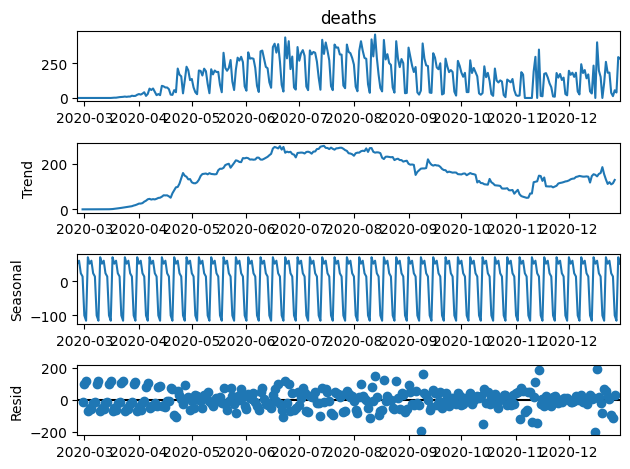

In [35]:
result = seasonal_decompose(covidSP['deaths'], model='additive')
result.plot();

Há sazonalidade nos dados, devido à sistemática de notificações

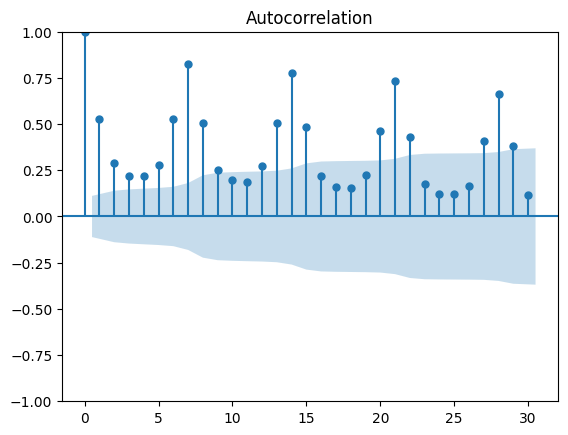

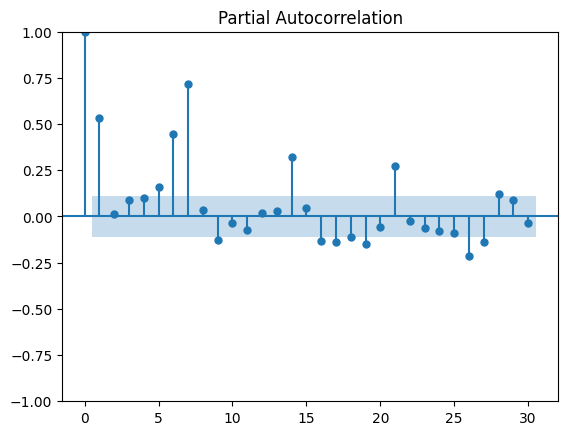

In [36]:
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf # para determinar (p,q)

# Correlograma

plot_acf(covidSP['deaths'], lags=30)
plot_pacf(covidSP['deaths'], lags=30)
plt.show()

In [37]:
# Ajuste de modelo SARIMA
# No google colab o auto_arima retorna outro modelo como o escolhido, o que pode acontecer pois
# estamos utilizando outra versão do pacote e a busca pela melhor configuração do modelo pode
# acontecer em direções distintas. Vamos seguir nas análises seguintes com o
# modelo escolhido no Jupyter notebook para ficar homogêneo para a aula.

auto_arima(covidSP['deaths'],seasonal=True,m=7).summary()


stepwise_fit = auto_arima(covidSP['deaths'], start_p=0, start_q=0,
                          max_p=3, max_q=3, m=7,
                          seasonal=True,
                          trace=True,
                          error_action='ignore',
                          suppress_warnings=True,
                          stepwise=True)

stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[7] intercept   : AIC=3579.716, Time=0.59 sec
 ARIMA(0,1,0)(0,0,0)[7] intercept   : AIC=3825.903, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[7] intercept   : AIC=3563.494, Time=0.59 sec
 ARIMA(0,1,1)(0,0,1)[7] intercept   : AIC=3581.821, Time=0.32 sec
 ARIMA(0,1,0)(0,0,0)[7]             : AIC=3823.921, Time=0.02 sec
 ARIMA(1,1,0)(0,0,0)[7] intercept   : AIC=3808.539, Time=0.11 sec
 ARIMA(1,1,0)(2,0,0)[7] intercept   : AIC=3519.108, Time=1.14 sec
 ARIMA(1,1,0)(2,0,1)[7] intercept   : AIC=3488.255, Time=1.79 sec
 ARIMA(1,1,0)(1,0,1)[7] intercept   : AIC=3486.546, Time=0.84 sec
 ARIMA(1,1,0)(0,0,1)[7] intercept   : AIC=3683.983, Time=0.29 sec
 ARIMA(1,1,0)(1,0,2)[7] intercept   : AIC=3488.166, Time=1.80 sec
 ARIMA(1,1,0)(0,0,2)[7] intercept   : AIC=3635.827, Time=0.85 sec
 ARIMA(1,1,0)(2,0,2)[7] intercept   : AIC=inf, Time=3.35 sec
 ARIMA(2,1,0)(1,0,1)[7] intercept   : AIC=inf, Time=nan sec
 ARIMA(1,1,1)(1,0,1)[7] intercept   : AIC=33

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:                                 y   No. Observations:                  309
Model:             SARIMAX(0, 1, 1)x(1, 0, 1, 7)   Log Likelihood               -1687.560
Date:                           Mon, 31 Jul 2023   AIC                           3383.121
Time:                                   23:53:48   BIC                           3398.041
Sample:                               02-26-2020   HQIC                          3389.087
                                    - 12-30-2020                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9213      0.023    -39.986      0.000      -0.966      -0.876
ar.S.L7        0.9657      0.018     53.047      0.000       0.930       1.001
ma.S.L7       -0.6361      0.053    -12.075      0.000      -0.739      -0.533
sigma2      3250.9431    145.593     22.329      0.000    2965.587    3536.299
===================================================================================
Ljung-Box (L1) (Q):                   0.65   Jarque-Bera (JB):               415.07
Prob(Q):                              0.42   Prob(JB):                         0.00
Heteroskedasticity (H):               2.79   Skew:                             0.15
Prob(H) (two-sided):                  0.00   Kurtosis:                         8.68
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [38]:
len(covidSP)

309

In [39]:
len(covidSP)*0.9

278.1

In [40]:
treino = covidSP.iloc[:278]
teste = covidSP.iloc[278:]

In [41]:
modelo = SARIMAX(treino['deaths'],order=(0,1,1),seasonal_order=(1,0,1,7))
resultado = modelo.fit()
resultado.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:                            deaths   No. Observations:                  278
Model:             SARIMAX(0, 1, 1)x(1, 0, 1, 7)   Log Likelihood               -1504.094
Date:                           Mon, 31 Jul 2023   AIC                           3016.188
Time:                                   23:53:49   BIC                           3030.684
Sample:                               02-26-2020   HQIC                          3022.004
                                    - 11-29-2020                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9181      0.024    -38.829      0.000      -0.964      -0.872
ar.S.L7        0.9652      0.018     54.004      0.000       0.930       1.000
ma.S.L7       -0.6308      0.052    -12.189      0.000      -0.732      -0.529
sigma2      2935.4822    135.107     21.727      0.000    2670.678    3200.286
===================================================================================
Ljung-Box (L1) (Q):                   1.07   Jarque-Bera (JB):               544.31
Prob(Q):                              0.30   Prob(JB):                         0.00
Heteroskedasticity (H):               2.97   Skew:                             0.22
Prob(H) (two-sided):                  0.00   Kurtosis:                         9.85
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [42]:
resultado.fittedvalues

2020-02-26      0.000000
2020-02-27      0.000000
2020-02-28      0.000000
2020-02-29      0.000000
2020-03-01      0.000000
                 ...    
2020-11-25    169.509243
2020-11-26    171.828046
2020-11-27     75.708160
2020-11-28    134.618402
2020-11-29     23.737977
Freq: D, Length: 278, dtype: float64

In [43]:
# Obtain predicted values
inicio=len(treino)
fim=len(treino)+len(teste)-1
previsões = resultado.predict(start=inicio, end=fim, dynamic=False).rename('Previsões SARIMA(0,1,1)(1,0,1,7) ')
previsões.index = teste.index


In [44]:
previsões

2020-11-30     20.604520
2020-12-01    133.816060
2020-12-02    162.276286
2020-12-03    173.646975
2020-12-04     98.628098
2020-12-05    138.720465
2020-12-06     28.733295
2020-12-07     24.063723
2020-12-08    133.332382
2020-12-09    160.801408
2020-12-10    171.776084
2020-12-11     99.369931
2020-12-12    138.065978
2020-12-13     31.909393
2020-12-14     27.402450
2020-12-15    132.865549
2020-12-16    159.377896
2020-12-17    169.970352
2020-12-18    100.085927
2020-12-19    137.434286
2020-12-20     34.974874
2020-12-21     30.624897
2020-12-22    132.414975
2020-12-23    158.003962
2020-12-24    168.227508
2020-12-25    100.776987
2020-12-26    136.824594
2020-12-27     37.933593
2020-12-28     33.735115
2020-12-29    131.980094
2020-12-30    156.677879
Freq: D, Name: Previsões SARIMA(0,1,1)(1,0,1,7) , dtype: float64

Passar <tt> dynamic = False </tt> significa que as previsões em cada ponto são geradas usando o histórico completo até aquele ponto (todos os valores defasados).

Passar <tt> typ = 'levels' </tt> prevê os níveis das variáveis endógenas originais. Se tivéssemos usado o padrão <tt> typ = 'linear' </tt>, teríamos visto previsões lineares em termos de variáveis endógenas diferenciadas.

Para obter mais informações sobre esses argumentos, visite https://www.statsmodels.org/stable/generated/statsmodels.tsa.arima_model.ARIMAResults.predict.html

In [45]:
for i in range(len(previsões)):
    print(f"predicted={previsões[i]:<11.10}, expected={teste['deaths'][i]}")

predicted=20.60451975, expected=19.0
predicted=133.8160597, expected=195.0
predicted=162.2762857, expected=166.0
predicted=173.6469754, expected=181.0
predicted=98.62809833, expected=151.0
predicted=138.7204648, expected=181.0
predicted=28.73329513, expected=46.0
predicted=24.06372256, expected=25.0
predicted=133.3323818, expected=242.0
predicted=160.8014078, expected=179.0
predicted=171.7760842, expected=200.0
predicted=99.36993095, expected=141.0
predicted=138.0659785, expected=169.0
predicted=31.90939259, expected=47.0
predicted=27.40244981, expected=32.0
predicted=132.8655492, expected=232.0
predicted=159.3778963, expected=0.0
predicted=169.9703516, expected=399.0
predicted=100.0859274, expected=197.0
predicted=137.4342863, expected=151.0
predicted=34.97487436, expected=0.0
predicted=30.62489736, expected=107.0
predicted=132.4149753, expected=259.0
predicted=158.0039622, expected=181.0
predicted=168.2275082, expected=182.0
predicted=100.7769874, expected=37.0
predicted=136.8245944,

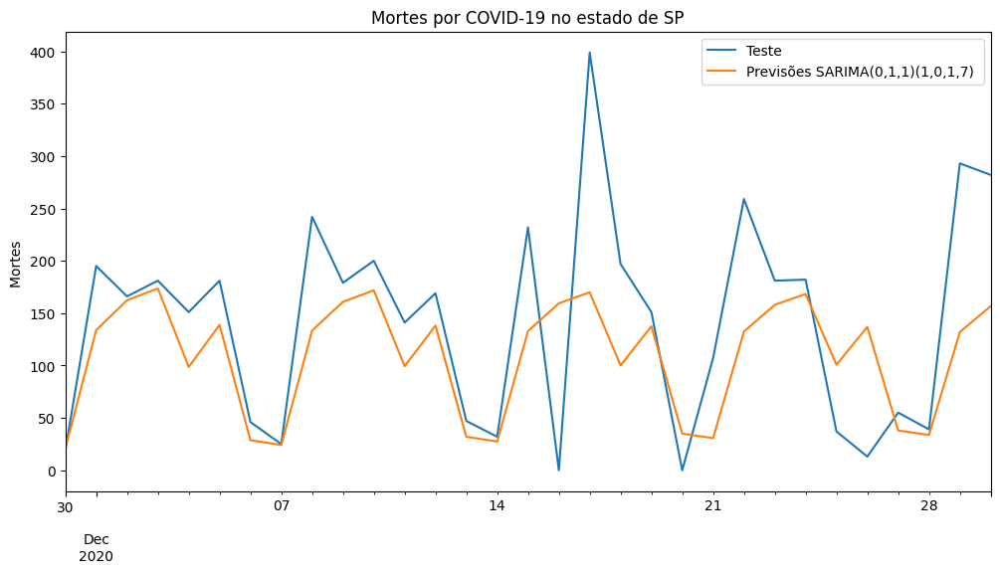

In [46]:
# Plot predictions against known values
title = 'Mortes por COVID-19 no estado de SP'
ylabel='Mortes '
xlabel=''

ax = teste['deaths'].plot(legend=True,figsize=(12,6),title=title, label='Teste')
previsões.plot(legend=True)

ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel);

<Axes: >

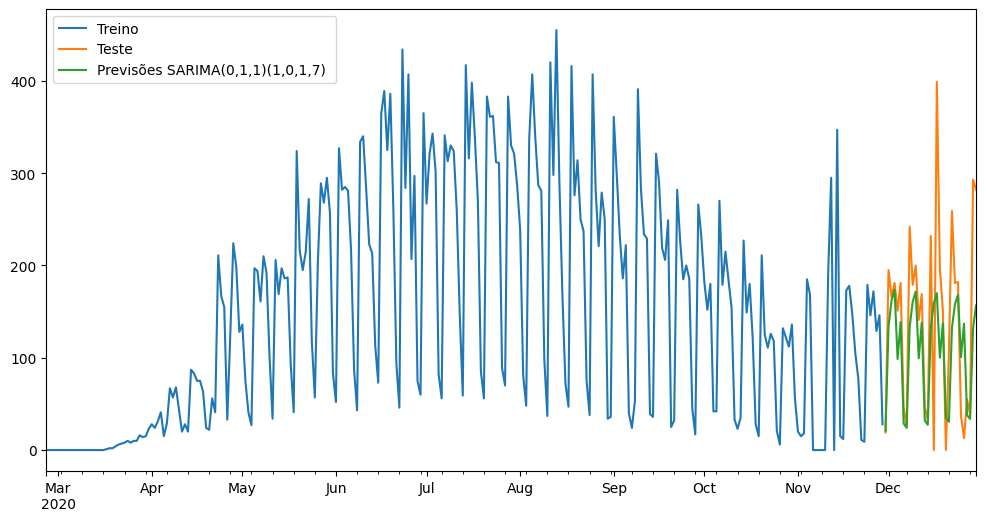

In [47]:
treino['deaths'].plot(legend=True, label='Treino')
teste['deaths'].plot(legend=True, label='Teste')
previsões.plot(legend=True, figsize=(12,6))

### Previsões para dados cujos tempos ainda não estão nas bases

In [48]:
# Notem o uso de "trend", vejam o help para outras variações = Aqui tem mais uma possibilidade para buscar o melhor ajuste.

modelo = SARIMAX(covidSP['deaths'],order=(0,1,1),seasonal_order=(1,0,1,7), trend='c')
resultados = modelo.fit()
fcast = resultados.predict(len(covidSP),len(covidSP)+14).rename('Previsões SARIMA(1,0,1)(1,0,1,7)')

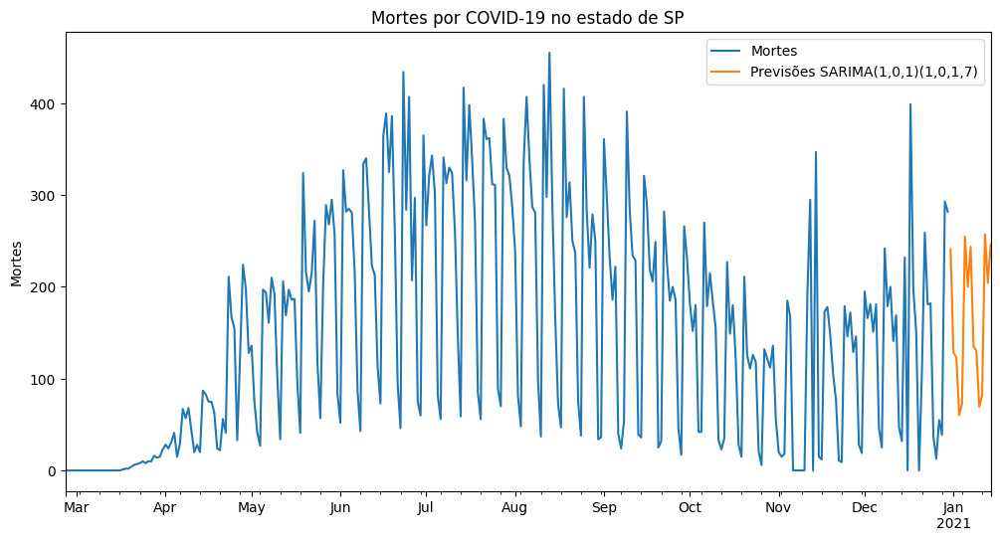

In [49]:
title = 'Mortes por COVID-19 no estado de SP'
ylabel='Mortes'
xlabel=''

ax = covidSP['deaths'].plot(legend=True,figsize=(12,6),title=title, label='Mortes')
fcast.plot(legend=True)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel);

**Exercício: É possível melhorar as previsões para os dados de PETR4 com o SARIMA sazonal?**

## Diagnóstico em modelos SARIMA

### Métricas

In [50]:
from sklearn.metrics import mean_squared_error

error = mean_squared_error(teste['deaths'], previsões)
print(f'EQM SARIMA(0,1,1)(1,0,1,7): {error:11.10}')

EQM SARIMA(0,1,1)(1,0,1,7): 6675.137658


In [51]:
from statsmodels.tools.eval_measures import rmse

error = rmse(teste['deaths'], previsões)
print(f'REQM SARIMA(0,1,1)(1,0,1,7): {error:11.10}')

REQM SARIMA(0,1,1)(1,0,1,7): 81.70151564


### Análise de resíduos

Considere inicialmente um modelo ARIMA

$$\phi(B) W_t = \theta(B) a_t$$ com $W_t = \Delta^d Z_t$ supondo que $a_t$ é um ruído branco.

Se o modelo for verdadeiro, então os erros verdadeiros $a_t = \theta^{-1}(B) \phi(B) W_t$ devem ser um ruído branco.

Uma análise equivalente poderia ser feita para modelos mais gerais SARIMA.

Quando o modelo é estimado, ou seja, quando são obtidos $\widehat{\theta}$ e $\widehat{\phi}$, as quantidades

$$\widehat{a}_t = \widehat{\theta}^{-1}(B) \widehat{\phi}(B) W_t$$

são chamadas de **resíduos**. Se o modelo for correto, eles devem ser aproximadamente não correlacionados.

Uma forma de analisar os resíduos ajustados é simplesmente considerar

$$r_t = Z_t - \widehat{Z}_t$$

e podemos analisar a distribuição, estatísticas descritivas, a autocorrelação dos resíduos e verificar se existe algum padrão nos mesmos.

Leitura adicional: https://otexts.com/fpp2/residuals.html

In [52]:
# Uma forma de obter os resíduos pelo ajuste do modelo

resíduos = resultados.resid

In [53]:
resíduos.describe()

count    309.000000
mean      -0.376696
std       57.008288
min     -291.854568
25%      -24.506137
50%       -1.613822
75%       23.350819
max      306.678928
dtype: float64

{'whiskers': [<matplotlib.lines.Line2D at 0x7ad4c7e710f0>,
 'caps': [<matplotlib.lines.Line2D at 0x7ad4c7e71c30>,
 'boxes': [<matplotlib.lines.Line2D at 0x7ad4c7e70760>],
 'medians': [<matplotlib.lines.Line2D at 0x7ad4c7e722c0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7ad4cded4a90>],
 'means': []}

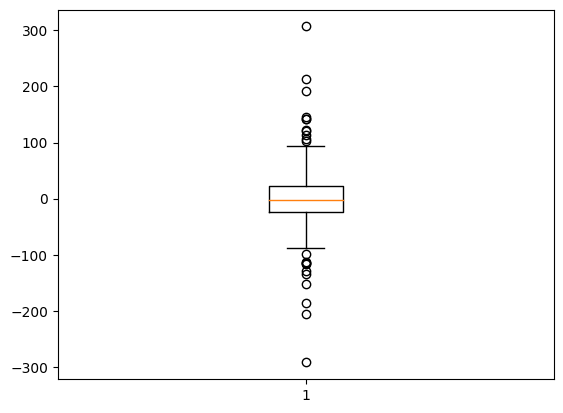

In [54]:
plt.boxplot(resíduos)

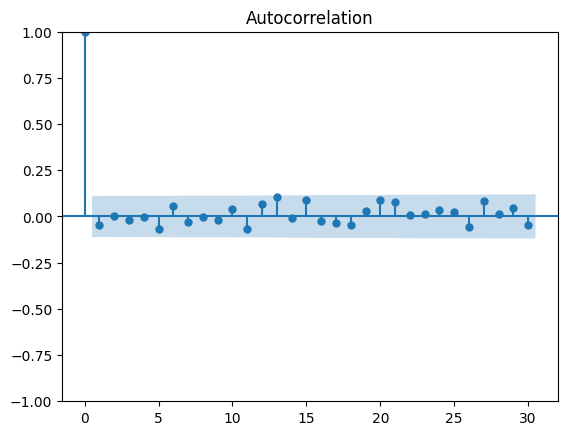

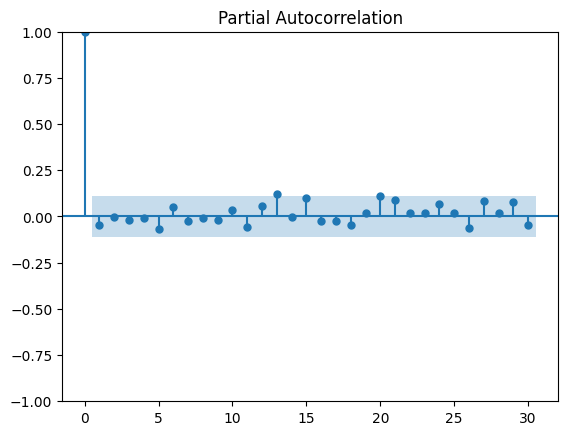

In [55]:
plot_acf(resíduos, lags=30)
plot_pacf(resíduos, lags=30)
plt.show()

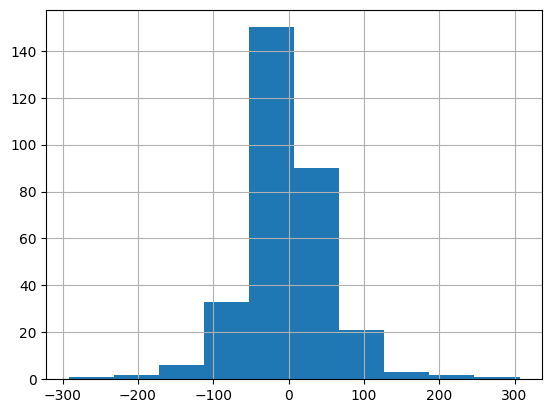

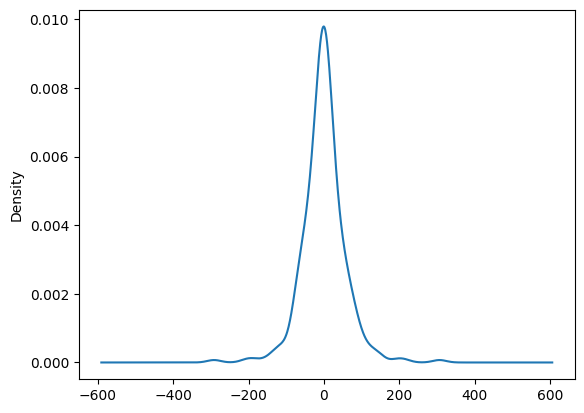

In [56]:
from matplotlib import pyplot


resíduos.hist()

pyplot.show()
resíduos.plot(kind='kde')
pyplot.show()

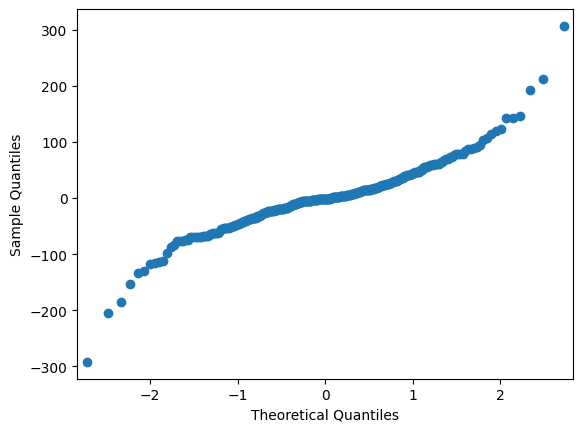

In [57]:
from statsmodels.graphics.gofplots import qqplot

qqplot(resíduos)
pyplot.show()

**Exercício: O que aconteceria com os resíduos se um modelo incorreto tivesse sido ajustado?**

<a id="section10"></a>
Aula 4: Exercícios

# Prática 4

***Aprendizado Dinâmico***

**Exercício 1**

Considere a base de dados de casos confirmados por COVID-19 no estado de SP.

Nesta prática, vamos trabalhar com a análise de má-especificação de modelos, ou seja, como fica a análise de diagnóstico se ajustarmos um modelo "correto" e um modelo "errado".

**Exercício 2**
Obtenha o melhor modelo SARIMA para os dados de passageiros aéreos, com previsões para os próximos 12 meses. Repita para outras bases de dados que trabalhamos anteriormente no curso.

**1. Carregue as bibliotecas que serão utilizadas.**

In [19]:
#Instale, se necessário, nas versões sugeridas
!pip install statsmodels==0.13.5
!pip install pmdarima==2.0.3

In [20]:
import pandas as pd
import numpy as np
%matplotlib inline

from statsmodels.tsa.statespace.sarimax import SARIMAX

from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from pmdarima import auto_arima

# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

np.random.seed(0)

**2. Faça a leitura dos dados de COVID-19 do estado de SP e complete os dados faltantes. Verifique se os dados estão Ok.**

<Axes: >

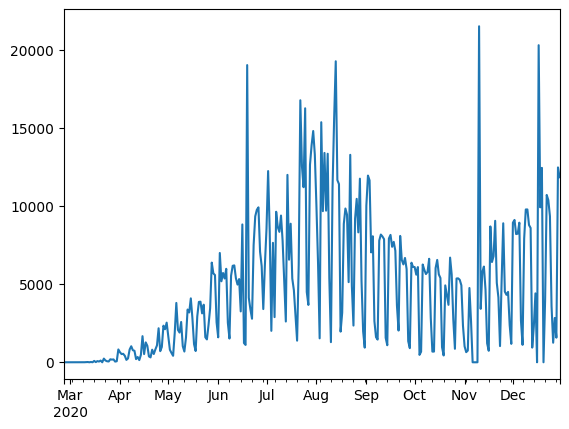

In [21]:
# Leitura dos dados de COVID-19 no estado de SP - vamos trabalhar com os casos confirmados

url = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv'
covidSP = pd.read_csv(url, index_col='date', parse_dates=True)

idx = pd.date_range(start=covidSP.index.min(), end=covidSP.index.max(), freq='D')
covidSP = covidSP.reindex(idx)
covidSP.fillna(0,inplace=True)

covidSP['confirmed'].plot()


 **3. Repita a análise com gráficos de autocorrelação e autocorrelação parcial feitos em aula. Já é possível identificar características do melhor modelo para esses dados?**

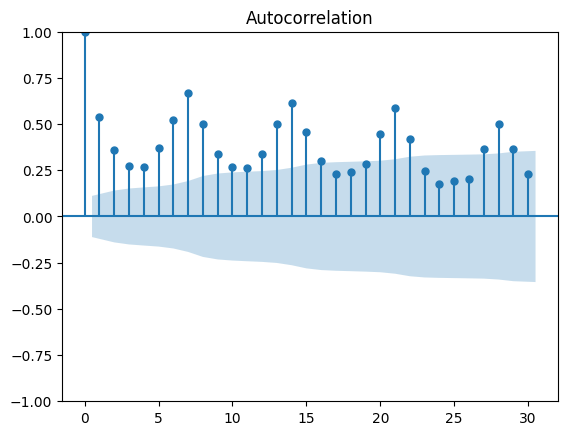

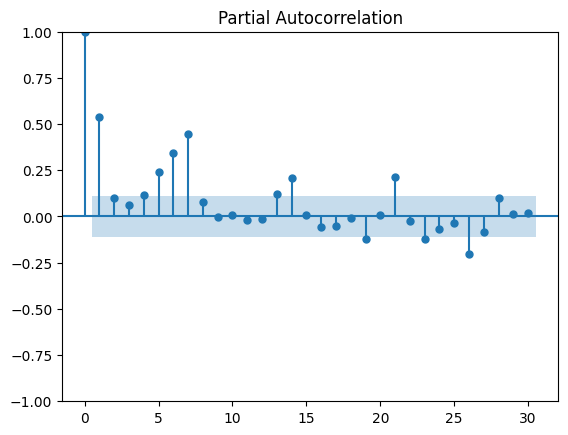

In [22]:
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf # para determinar (p,q)

# Correlograma

plot_acf(covidSP['confirmed'], lags=30)
plot_pacf(covidSP['confirmed'], lags=30)
plt.show()

**4. Utilize o stepwise_fit para escolher as ordens de um modelo SARIMA (p,d,q)x(P,D,Q)m, como feito em aula**

In [23]:
# Ajuste de modelo SARIMA

stepwise_fit = auto_arima(covidSP['confirmed'], start_p=0, start_q=0,
                          max_p=3, max_q=3, m=7,
                          seasonal=True,
                          trace=True,
                          error_action='ignore',
                          suppress_warnings=True,
                          stepwise=True)

stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,0,1)[7] intercept   : AIC=5922.655, Time=3.91 sec
 ARIMA(0,1,0)(0,0,0)[7] intercept   : AIC=6007.140, Time=0.08 sec
 ARIMA(1,1,0)(1,0,0)[7] intercept   : AIC=5916.437, Time=1.33 sec
 ARIMA(0,1,1)(0,0,1)[7] intercept   : AIC=5845.769, Time=1.70 sec
 ARIMA(0,1,0)(0,0,0)[7]             : AIC=6005.169, Time=0.05 sec
 ARIMA(0,1,1)(0,0,0)[7] intercept   : AIC=5891.230, Time=0.69 sec
 ARIMA(0,1,1)(1,0,1)[7] intercept   : AIC=5778.886, Time=4.92 sec
 ARIMA(0,1,1)(1,0,0)[7] intercept   : AIC=5816.796, Time=1.91 sec
 ARIMA(0,1,1)(2,0,1)[7] intercept   : AIC=5760.616, Time=4.08 sec
 ARIMA(0,1,1)(2,0,0)[7] intercept   : AIC=5787.518, Time=4.52 sec
 ARIMA(0,1,1)(2,0,2)[7] intercept   : AIC=inf, Time=6.27 sec
 ARIMA(0,1,1)(1,0,2)[7] intercept   : AIC=5813.850, Time=4.63 sec
 ARIMA(0,1,0)(2,0,1)[7] intercept   : AIC=5924.628, Time=4.38 sec
 ARIMA(1,1,1)(2,0,1)[7] intercept   : AIC=5772.417, Time=4.30 sec
 ARIMA(0,1,2)(2,0,1)[7] intercept   : 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:                                 y   No. Observations:                  309
Model:             SARIMAX(0, 1, 1)x(1, 0, 1, 7)   Log Likelihood               -2874.364
Date:                           Tue, 01 Aug 2023   AIC                           5756.727
Time:                                   00:02:02   BIC                           5771.648
Sample:                               02-26-2020   HQIC                          5762.693
                                    - 12-30-2020                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9021      0.027    -33.593      0.000      -0.955      -0.849
ar.S.L7        0.9673      0.034     28.507      0.000       0.901       1.034
ma.S.L7       -0.7733      0.067    -11.459      0.000      -0.906      -0.641
sigma2      7.315e+06   2.74e+05     26.680      0.000    6.78e+06    7.85e+06
===================================================================================
Ljung-Box (L1) (Q):                   0.52   Jarque-Bera (JB):              2203.69
Prob(Q):                              0.47   Prob(JB):                         0.00
Heteroskedasticity (H):              16.15   Skew:                             1.88
Prob(H) (two-sided):                  0.00   Kurtosis:                        15.55
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

**5. Atribua a um objeto modelo1 o modelo escolhido pelo stepwise_fit e previsões1 os valores preditos por ele**

In [24]:
modelo1 = SARIMAX(covidSP['confirmed'],order=(0,1,1),seasonal_order=(1,0,1,7))
resultado1 = modelo1.fit()

previsões1 = resultado1.predict(start=covidSP.index.min(), end=covidSP.index.max(), dynamic=False, typ='levels')
previsões1.index = covidSP.index


**6. Ajuste um modelo "errado" aos dados, por exemplo um SARIMA(0,0,1)x(0,0,2,7), ou seja, com termos de médias móveis e não autorregressivos. Atribua o ajuste e valores preditos aos objetos modelo2 e previsões2.**

In [25]:
modelo2 = SARIMAX(covidSP['confirmed'],order=(0,0,1),seasonal_order=(0,0,2,7))
resultado2 = modelo2.fit()

previsões2 = resultado2.predict(start=covidSP.index.min(), end=covidSP.index.max(), dynamic=False, typ='levels')
previsões2.index = covidSP.index

**7. Faça uma análise de diagnóstico usando os resíduos obtidos pelo modelo1 e modelo2. Compare, por exemplo, os gráficos de autocorrelação e autocorrelação parcial. Observe também o histograma e a densidade alisada dos resíduos.**

In [26]:
resíduos1 = resultado1.resid
resíduos2 = resultado2.resid

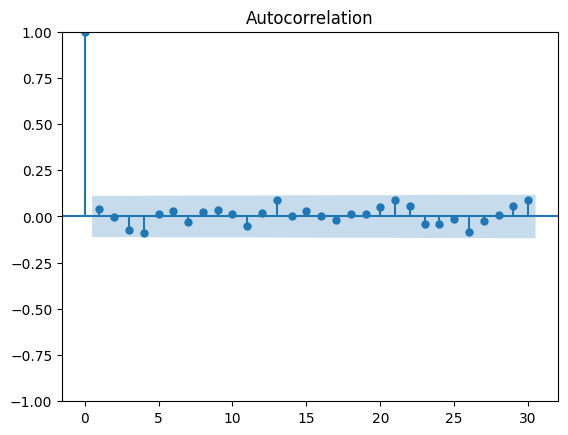

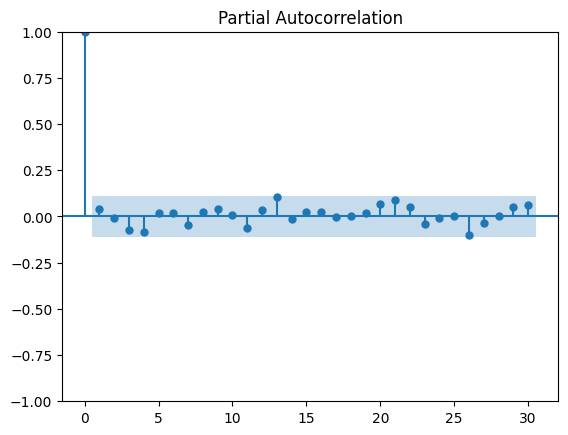

In [27]:
plot_acf(resíduos1, lags=30)
plot_pacf(resíduos1, lags=30)
plt.show()

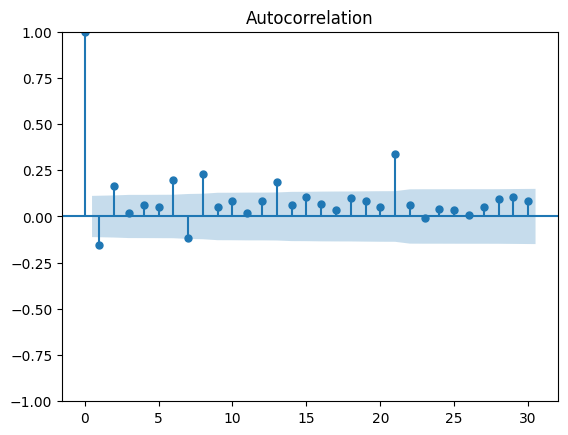

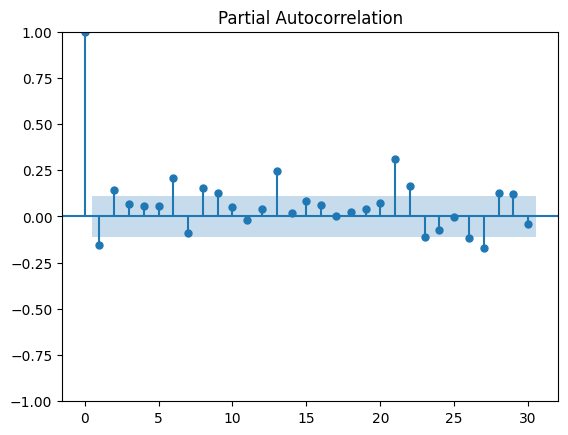

In [28]:
plot_acf(resíduos2, lags=30)
plot_pacf(resíduos2, lags=30)
plt.show()

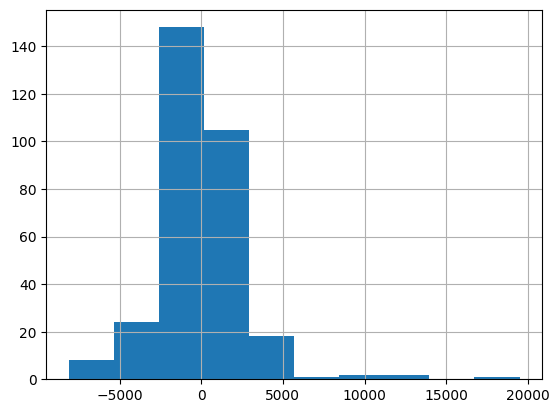

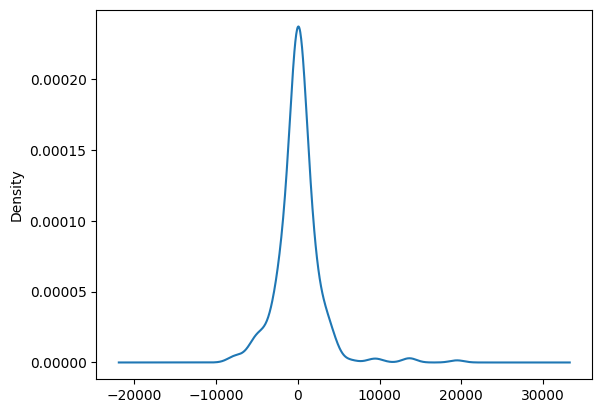

In [29]:
from matplotlib import pyplot


resíduos1.hist()

pyplot.show()
resíduos1.plot(kind='kde')
pyplot.show()

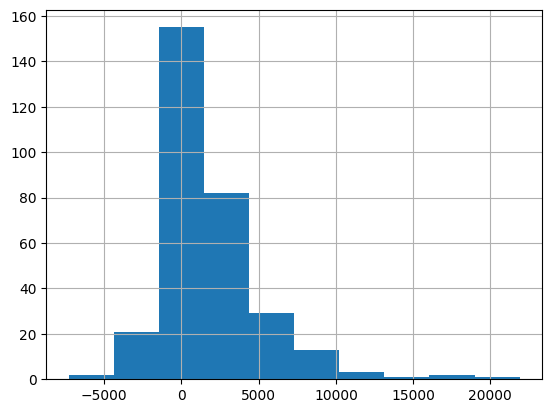

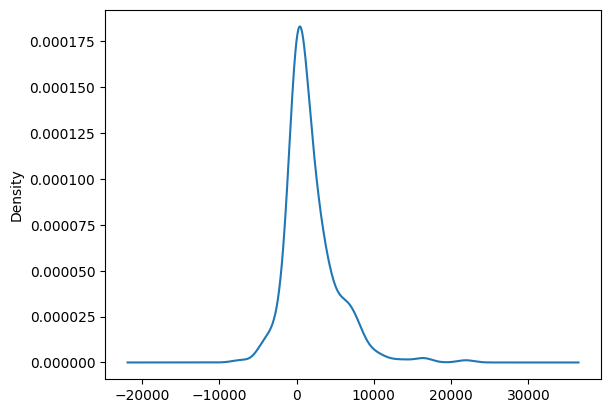

In [30]:
from matplotlib import pyplot


resíduos2.hist()

pyplot.show()
resíduos2.plot(kind='kde')
pyplot.show()

**8. Compare as métricas erro quadrático médio e erro absoluto médio. Existe muita diferença entre eles?**

In [31]:
from sklearn.metrics import mean_squared_error

error = mean_squared_error(covidSP['confirmed'], previsões1)
print(f'EQM SARIMA(0,1,1)(1,0,1,7): {error:11.10}')

EQM SARIMA(0,1,1)(1,0,1,7): 7290150.287


In [32]:
from sklearn.metrics import mean_squared_error

error = mean_squared_error(covidSP['confirmed'], previsões2)
print(f'EQM SARIMA(0,0,4)(0,1,2,7): {error:11.10}')

EQM SARIMA(0,0,4)(0,1,2,7):  14514336.0


In [33]:
from statsmodels.tools.eval_measures import rmse

error = rmse(covidSP['confirmed'], previsões1)
print(f'REQM SARIMA(0,1,1)(1,0,1,7): {error:11.10}')

REQM SARIMA(0,1,1)(1,0,1,7): 2700.027831


In [34]:
from statsmodels.tools.eval_measures import rmse

error = rmse(covidSP['confirmed'], previsões2)
print(f'REQM SARIMA(0,0,1)(0,0,2,7): {error:11.10}')

REQM SARIMA(0,0,1)(0,0,2,7): 3809.768498


**9. Utilize outros métodos de diagnóstico se achar necessário.**

**Exercício 2**
**Considere a série de passageiros aéreos. Obtenha o melhor modelo SARIMA e as previsões para os próximos 12 meses. Você pode repetir para outras bases de dados que vimos anteriormente.**

<Axes: xlabel='Mês'>

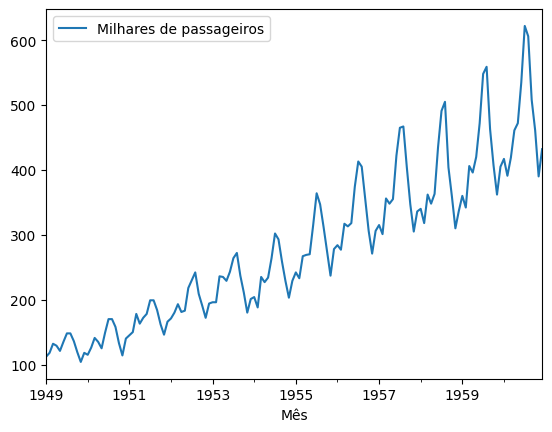

In [35]:
url = 'https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/airline_passengers.csv'

df = pd.read_csv(url, index_col=0, parse_dates=True)

df.plot()


In [36]:
# Ajuste de modelo SARIMA

stepwise_fit = auto_arima(df['Milhares de passageiros'], start_p=0, start_q=0,
                          max_p=3, max_q=3, m=12,
                          seasonal=True,
                          trace=True,
                          error_action='ignore',
                          suppress_warnings=True,
                          stepwise=True)

stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=1032.128, Time=0.42 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=1031.508, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=1020.393, Time=0.15 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=1021.003, Time=0.26 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=1020.393, Time=0.07 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=1019.239, Time=0.40 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=3.77 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=1020.493, Time=1.09 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=1032.120, Time=0.57 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=1021.120, Time=1.09 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=1021.032, Time=0.86 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=1019.178, Time=0.51 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=1020.425, Time=0.20 sec
 ARIMA(0,1,1)(2,1,1)[12]             : AIC=inf, Time=2.81 sec
 ARIMA(0,1,1)(1,1,1)[12]     

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                                   y   No. Observations:                  144
Model:             SARIMAX(0, 1, 1)x(2, 1, [], 12)   Log Likelihood                -505.589
Date:                             Tue, 01 Aug 2023   AIC                           1019.178
Time:                                     00:02:21   BIC                           1030.679
Sample:                                 01-01-1949   HQIC                          1023.851
                                      - 12-01-1960                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.3634      0.074     -4.945      0.000      -0.508      -0.219
ar.S.L12      -0.1239      0.090     -1.372      0.170      -0.301       0.053
ar.S.L24       0.1911      0.107      1.783      0.075      -0.019       0.401
sigma2       130.4480     15.527      8.402      0.000     100.016     160.880
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                 4.59
Prob(Q):                              0.92   Prob(JB):                         0.10
Heteroskedasticity (H):               2.70   Skew:                             0.15
Prob(H) (two-sided):                  0.00   Kurtosis:                         3.87
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [37]:
modelo = SARIMAX(df['Milhares de passageiros'], order=(0,1,1), seasonal_order=(2,1,0,12))
resultados = modelo.fit()
fcast = resultados.predict(len(df),len(df)+12,typ='levels').rename('Previsões ARIMA(0,1,1)x(2,1,0)12')

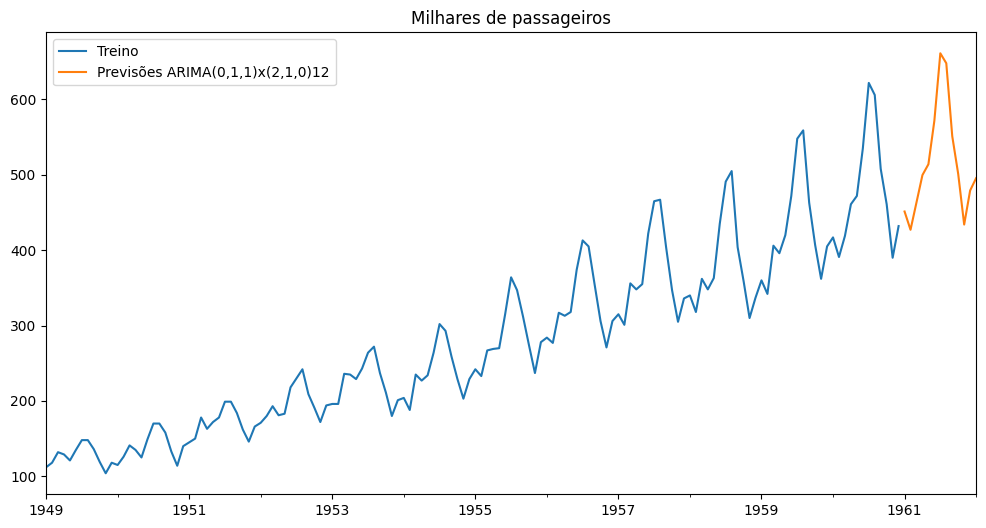

In [38]:
title = 'Milhares de passageiros'
ylabel=''
xlabel=''

ax = df['Milhares de passageiros'].plot(legend=True,figsize=(12,6),title=title, label='Treino')
fcast.plot(legend=True)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel);

<a id="section11"></a>
Aula 5: Modelos de espaço de estado

# Modelos de espaço de estado

- Modelos estruturais/modelos dinâmicos

- Previsão Bayesiana

Baseado em

- COMMANDEUR, J. J. F., and KOOPMAN, S. J. An Introduction to State Space Time Series Analysis. Oxford ; New York: Oxford University Press. 2007.

- DURBIN, J., and KOOPMAN, S. J.. Time Series Analysis by State Space Methods: Second Edition. Oxford University Press. 2012.

- FRANCO, G. C., GAMERMAN, D., & SANTOS, T. R. Modelos de espaço de estados: abordagens clássica e bayesiana. São Paulo: Associação Brasileira de Estatística. Disponível em https://www.researchgate.net/publication/340979229_Modelos_de_Espaco_de_Estados_Abordagens_Classica_e_Bayesiana. Acessado em 21/06/2021. 2009.

- MIGON, H., GAMERMAN, D. & RODRIGUEZ, R. Introdução aos Modelos Dinâmicos Bayesianos. Disponível em http://www.din.uem.br/sbpo/sbpo2004/pdf/arq0278.pdf . Acessado em 21/06/2021. 2004.

Leituras adicionais:

- https://www.statsmodels.org/stable/statespace.html

- https://www.statsmodels.org/devel/examples/notebooks/generated/statespace_local_linear_trend.html

- http://www.chadfulton.com/fulton_statsmodels_2017/sections/1-introduction.html



## Modelos de espaço de estado

- Bastante utilizados em engenharia de controle.

- Na abordagem clássica, são usados "modelos estruturais".

- Na abordagem bayesiana, são usados "modelos dinâmicos".

- Permitem a modelagem multivariada de dados.

- Permitem a inclusão de variáveis endógenas e exógenas.


- Alguns exemplos de aplicação:
    
    - Educação: Prever o nível educacional, com variáveis exógenas, por exemplo acesso a escola, renda, e endógenas, por exemplo habilidades individuais.
    
    - Finanças: Prever o valor de uma ação, com variáveis exógenas, por exemplo, política externa, e endógenas, por exemplo, lucro da empresa.
    


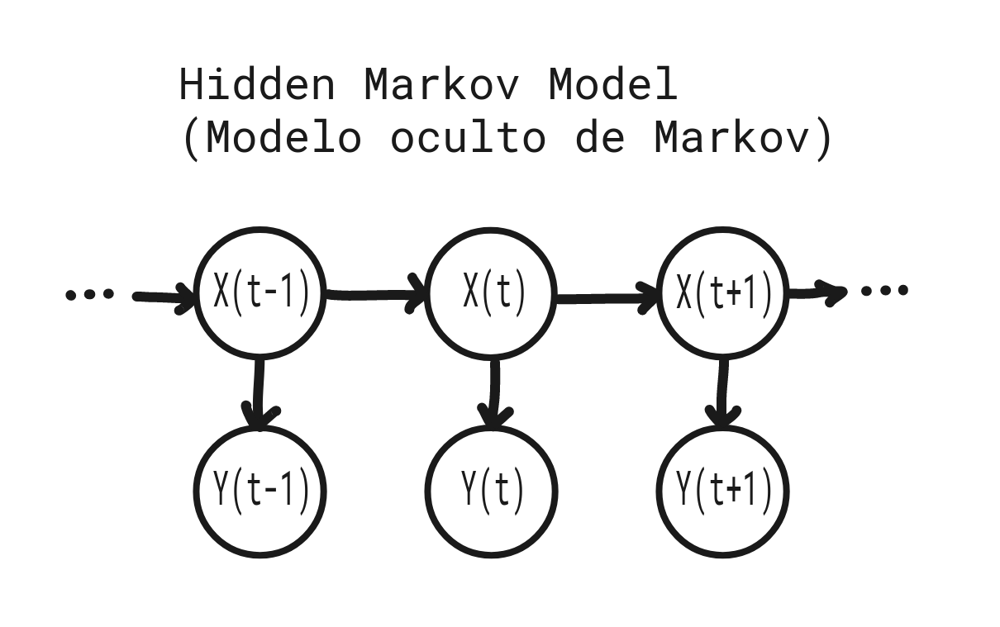






A variável oculta $X(t)$ (no instante de tempo $t$ depende exclusivamente do valor da variável escondida $X(t-1)$ (no instante de tempo $t-1$, o que é chamado de propriedade de Markov. Da mesma forma, o valor da variável observada $Y(t)$ depende exclusivamente do valor da variável escondida $X(t)$ (ambas no instante de tempo $t$).


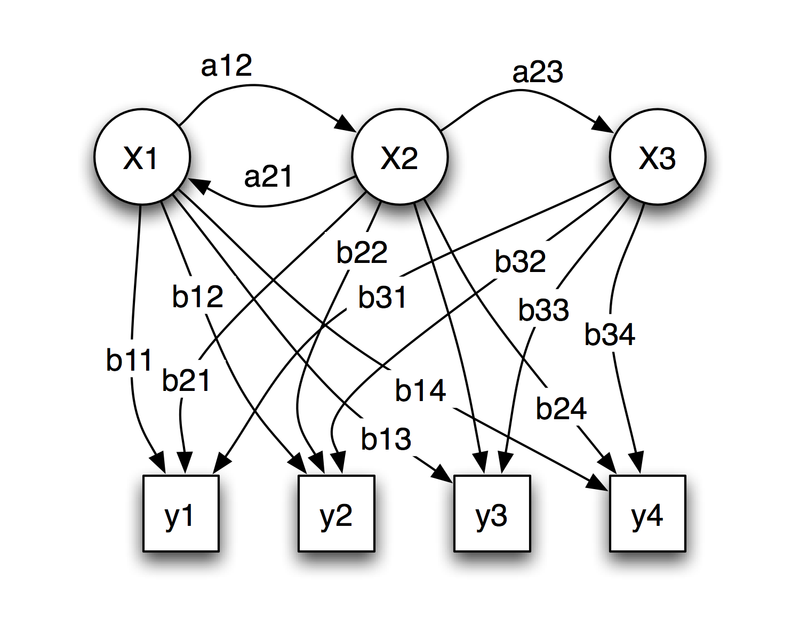


Exemplo de parâmetros probabilísticos de um modelo oculto de Markov

- x: estados

- y: possíveis observações

- a: probabilidades de transição de estado

- b: probabilidades de saídas

Fonte: https://pt.wikipedia.org/wiki/Modelo_oculto_de_Markov


## Análise de séries temporais via método de espaço de estado

Fonte: https://www.statsmodels.org/stable/statespace.html

Um modelo geral de espaço de estado pode ser escrito na forma

$$\begin{array}{ll}y_t & = X_t \alpha_t + d_t + \varepsilon_t \\
  \alpha_{t+1} & = T_t \alpha_t + c_t + R_t \eta_t\end{array}$$
  
em que

- $y_t$ se refere ao vetor observável no tempo $t$,

- $\alpha_t$ se refere ao vetor do estado não-observável no tempo $t$,

e em que os componentes aleatórias são definidos como


$$\begin{array}{l}\varepsilon_t \sim N(0, H_t) \\
  \eta_t \sim N(0, Q_t)\end{array}$$

As variáveis restantes $(X_t, d_t, H_t, T_t, c_t, R_t, Q_t)$ nas equações são matrizes que descrevem o processo. Seus nomes e dimensões são dadas por

- $X$: matriz de desenho $(k\_endog \times k\_states \times nobs)$

- $d$: intercepto das observações $(k\_endog \times nobs)$

- $T$: matriz de transição $(k\_states \times k\_states \times nobs)$

- $c$: intercepto do estado $(k\_states \times nobs)$

- $R$: matriz de seleção $(k\_states \times k\_posdef \times nobs)$

- $H$: matriz de covariância das observações $(k\_endog \times k\_endog \times nobs)$

- $Q$: covariância de estado $(k\_posdef \times k\_posdef \times nobs)$



No caso em que uma das matrizes seja invariante no tempo (por exemplo $X_t = X_{t+1} ~ \forall ~ t$), sua última dimensão seria $nobs=1$.

Esta forma genérica encapsula muitas das séries temporais lineares mais populares
modelos (veja abaixo) e é muito flexível, permitindo a estimativa com falta
observações, previsões, funções de resposta a impulsos e muito mais.

**Exemplo: Modelo AR(2)**

Um modelo autoregressivo é um bom exemplo introdutório para colocar modelos na forma de espaço de estado. Um modelo AR (2) geralmente é escrito como:

$y_t = \phi_1 y_{t-1} + \phi_2 y_{t-2} + \epsilon_t, \quad \epsilon_t \sim N(0, \sigma^2)$

Vamos colocar na forma do espaço de estado, para isso note que

$\begin{bmatrix} y_t \\ y_{t-1} \end{bmatrix}  = \begin{bmatrix}
      \phi_1 & \phi_2 \\
           1 &      0
   \end{bmatrix} \begin{bmatrix} y_{t-1} \\ y_{t-2} \end{bmatrix}  + \begin{bmatrix} 1 \\ 0 \end{bmatrix} \epsilon_t.$


Defina ${\alpha}_t = (y_t, y_{t-1})^\top$. Logo, podemos escrever as seguintes equações

Equação de medida:

$y_t  = \begin{bmatrix} 1 & 0 \end{bmatrix} {\alpha}_t$

Equação de transição:

$\begin{array}{ll}
   {\alpha}_{t+1} & = \begin{bmatrix}
      \phi_1 & \phi_2 \\
           1 &      0
   \end{bmatrix} {\alpha}_t + \begin{bmatrix} 1 \\ 0 \end{bmatrix} \eta_t\end{array}$


Na forma geral do modelo de espaço de estado

$\begin{array}{ll}y_t & = X_t \alpha_t + d_t + \varepsilon_t \\
  {\alpha}_{t+1} & = T_t {\alpha}_t + c_t + R_t \eta_t\end{array}$

temos

$X_t \equiv X = \begin{bmatrix} 1 & 0 \end{bmatrix}$, $T_t \equiv T  = \begin{bmatrix}
      \phi_1 & \phi_2 \\
           1 &      0
   \end{bmatrix}$, $R_t \equiv R  = \begin{bmatrix} 1 \\ 0 \end{bmatrix}$, $\eta_t \equiv \epsilon_{t+1} \sim N(0, \sigma^2)$ e os demais termos nulos.

Os três parâmetros desconhecidos desse modelo são $\phi_1, \phi_2$ e $\sigma^2$.

## Alguns modelos de espaço de estado específicos

Para maior profundidade, ver FRANCO et. al (2009) (https://www.researchgate.net/publication/340979229_Modelos_de_Espaco_de_Estados_Abordagens_Classica_e_Bayesiana).

- Modelo de nível local (MNL)

- Modelo de tendência local (MTL)

- Modelo de tendência polinomial (MTP)

- Modelo estrutural básico (MEB): tendência + sazonalidade


## Métodos de estimação para o modelo de espaço de estado


Alguns métodos são utilizados para a estimação de parâmetros e vetor de estados


- Filtro de Kalman: Um algoritmo recursivo que determina a estimativa do vetor de estados no tempo $t$ dada toda a informação disponı́vel até o instante $t - 1$. https://pt.wikipedia.org/wiki/Filtro_de_Kalman


- Estimação de Máxima verossimilhança na abordagem clássica, em geral numericamente, com um algoritmo de otimização não linear, por exemplo BFGS


- Markov chain Monte Carlo (MCMC) na abordagem Bayesiana, média a posteriori, mediana a posteriori, moda a posteriori, estimador de Bayes.

## Modelos SARIMAX

Fonte: https://www.statsmodels.org/stable/examples/notebooks/generated/statespace_sarimax_stata.html

**Motivação**

Considere os dados apresentados no artigo

FRIEDMAN,  M.,  and  D. MEISELMAN.  The  relative  stability  of  monetary  velocity  and  the  investment  multiplier  in the  United  States,  1897–1958.  In Stabilization  Policies, Commission  on  Money  and  Credit,  123–126.  EnglewoodCliffs,  NJ:  Prentice  Hall. 1963.

Os autores postulam uma relação direta entre as despesas de consumo pessoal (consump) e o suprimento de dinheiro medido por M2 (m2)

$$consumo = \beta_0 + \beta_1 m2_t + \epsilon_t$$


Como definir um modelo com variáveis exógenas com erros SARIMA?

Uma proposta é considerar


$$y_t =\beta_0 + \beta_1 x_t+u_t$$


$$ \phi_p(B) \Phi_P(B^m ) \Delta^d\Delta^D_m u_t = A(t) + \theta_q(B) \Theta_Q (B^m ) a_ t $$

que podemos colocar na forma dos modelos de espaço de estado que falamos acima.

### Aplicação

In [1]:
import numpy as np
import pandas as pd
from scipy.stats import norm
import statsmodels.api as sm
import matplotlib.pyplot as plt
from datetime import datetime
import requests
from io import BytesIO

# Evitar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

pd.plotting.register_matplotlib_converters()

%matplotlib inline


In [2]:
# Leitura dos dados
friedman2 = requests.get('https://www.stata-press.com/data/r12/friedman2.dta').content
data = pd.read_stata(BytesIO(friedman2))
data.index = data.time
data.index.freq = "QS-OCT"

data

,m2,time,m1,consump,pc92
time,,,,,
1946-01-01,NaN,1946-01-01,NaN,134.899994,NaN
1946-04-01,NaN,1946-04-01,NaN,140.100006,NaN
1946-07-01,NaN,1946-07-01,NaN,148.899994,NaN
1946-10-01,NaN,1946-10-01,NaN,153.199997,NaN
1947-01-01,NaN,1947-01-01,NaN,156.600006,912.099976
...,...,...,...,...,...
1997-07-01,3979.270020,1997-07-01,1063.550049,5540.299805,4947.000000
1997-10-01,4046.389893,1997-10-01,1076.040039,5593.200195,4981.000000
1998-01-01,4133.879883,1998-01-01,1081.109985,5676.500000,5055.100098


In [3]:
data.index

DatetimeIndex(['1946-01-01', '1946-04-01', '1946-07-01', '1946-10-01',
               '1947-01-01', '1947-04-01', '1947-07-01', '1947-10-01',
               '1948-01-01', '1948-04-01',
               ...
               '1996-04-01', '1996-07-01', '1996-10-01', '1997-01-01',
               '1997-04-01', '1997-07-01', '1997-10-01', '1998-01-01',
               '1998-04-01', '1998-07-01'],
              dtype='datetime64[ns]', name='time', length=211, freq='QS-OCT')

<Axes: xlabel='time'>

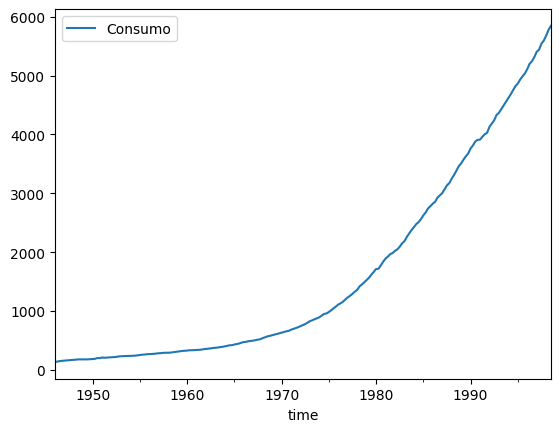

In [4]:
# Visualização dos dados

data['consump'].plot(label='Consumo', legend=True)

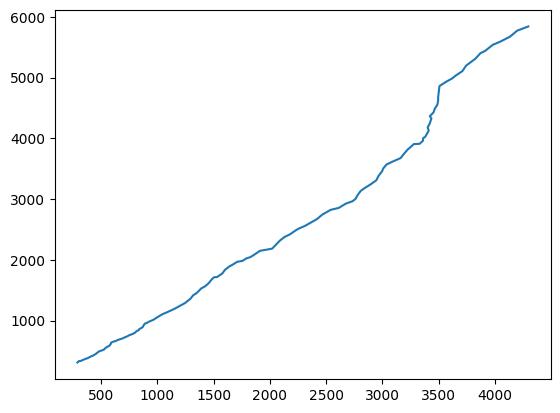

In [5]:
# Explorando a associação entre as variáveis

plt.plot(data['m2'],data['consump'])

In [6]:
# Definição de variáveis endógenas e exógenas + inclusão de intercepto para exog

endog = data.loc['1959':'1981', 'consump']
exog = sm.add_constant(data.loc['1959':'1981', 'm2'])


In [7]:
exog.head()

,const,m2
time,,
1959-01-01,1.0,289.149994
1959-04-01,1.0,294.049988
1959-07-01,1.0,296.730011
1959-10-01,1.0,297.799988
1960-01-01,1.0,299.350006


In [8]:
# Vamos ajustar um modelo ARMA(1,1) considerando os dados de 1959 a 1981
# Veja https://www.statsmodels.org/dev/generated/statsmodels.tsa.statespace.sarimax.SARIMAX.html

modelo = sm.tsa.statespace.SARIMAX(endog, exog, order=(1,0,1))
resultado = modelo.fit(disp=False)
print(resultado.summary())

                               SARIMAX Results                                
Dep. Variable:                consump   No. Observations:                   92
Model:               SARIMAX(1, 0, 1)   Log Likelihood                -340.508
Date:                Thu, 10 Aug 2023   AIC                            691.015
Time:                        00:34:52   BIC                            703.624
Sample:                    01-01-1959   HQIC                           696.105
                         - 10-01-1981                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        -36.0606     56.643     -0.637      0.524    -147.078      74.957
m2             1.1220      0.036     30.824      0.000       1.051       1.193
ar.L1          0.9348      0.041     22.717      0.0

In [9]:
# Base de dados até 1981

raw = pd.read_stata(BytesIO(friedman2))
raw.index = raw.time
raw.index.freq = "QS-OCT"
data = raw.loc[:'1981']


In [10]:
data

,m2,time,m1,consump,pc92
time,,,,,
1946-01-01,NaN,1946-01-01,NaN,134.899994,NaN
1946-04-01,NaN,1946-04-01,NaN,140.100006,NaN
1946-07-01,NaN,1946-07-01,NaN,148.899994,NaN
1946-10-01,NaN,1946-10-01,NaN,153.199997,NaN
1947-01-01,NaN,1947-01-01,NaN,156.600006,912.099976
...,...,...,...,...,...
1980-10-01,1601.099976,1980-10-01,408.920013,1836.800049,3034.199951
1981-01-01,1638.000000,1981-01-01,418.920013,1890.300049,3045.600098
1981-04-01,1670.550049,1981-04-01,423.899994,1923.500000,3045.800049


In [11]:
# Variáveis endógenas e exógenas
endog = data.loc['1959':, 'consump']
exog = sm.add_constant(data.loc['1959':, 'm2'])
nobs = endog.shape[0]

# Ajuste do modelo até 1978
modelo = sm.tsa.statespace.SARIMAX(endog.loc[:'1978-01-01'], exog=exog.loc[:'1978-01-01'], order=(1,0,1))
fit_resultado = modelo.fit(disp=False)
print(fit_resultado.summary())

                               SARIMAX Results                                
Dep. Variable:                consump   No. Observations:                   77
Model:               SARIMAX(1, 0, 1)   Log Likelihood                -243.316
Date:                Thu, 10 Aug 2023   AIC                            496.633
Time:                        00:34:53   BIC                            508.352
Sample:                    01-01-1959   HQIC                           501.320
                         - 01-01-1978                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.6782     18.492      0.037      0.971     -35.565      36.922
m2             1.0379      0.021     50.329      0.000       0.997       1.078
ar.L1          0.8775      0.059     14.859      0.0

In [12]:
modelo = sm.tsa.statespace.SARIMAX(endog, exog=exog, order=(1,0,1))
resultado = modelo.filter(fit_resultado.params)

In [13]:
# Previsão um passo a frente com intervalo de previsão

previsao = resultado.get_prediction()
previsao_ip = previsao.conf_int()

In [14]:
# Previsão dinâmica

data_previsao_dinamica = '1978-01-01'

previsao_di = resultado.get_prediction(dynamic=data_previsao_dinamica)
previsao_di_ip = previsao_di.conf_int()


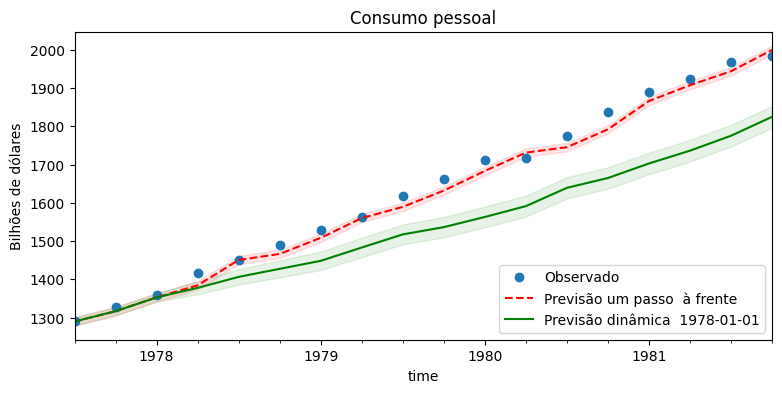

In [15]:
# Visualização dos resultados

# Sobre previsão passo à frente e previsão dinâmica:
# Jackson, E. A. (2018). Comparison between static and dynamic forecast in autoregressive integrated moving average for seasonally adjusted headline consumer price index. Available at SSRN 3162606. Disponível em https://mpra.ub.uni-muenchen.de/86180/1/MPRA_paper_86180.pdf. Acessado em 01/08/2020.


fig, ax = plt.subplots(figsize=(9,4))
npre = 4
ax.set(title='Consumo pessoal', xlabel='Data', ylabel='Bilhões de dólares')

# Plota os dados
data.loc['1977-07-01':, 'consump'].plot(ax=ax, style='o', label='Observado')

# Previsões
previsao.predicted_mean.loc['1977-07-01':].plot(ax=ax, style='r--', label='Previsão um passo  à frente')
ip = previsao_ip.loc['1977-07-01':]
ax.fill_between(ip.index, ip.iloc[:,0], ip.iloc[:,1], color='r', alpha=0.1)

previsao_di.predicted_mean.loc['1977-07-01':].plot(ax=ax, style='g', label='Previsão dinâmica  %s' % data_previsao_dinamica )
ip = previsao_di_ip.loc['1977-07-01':]
ax.fill_between(ip.index, ip.iloc[:,0], ip.iloc[:,1], color='g', alpha=0.1)

legend = ax.legend(loc='lower right')

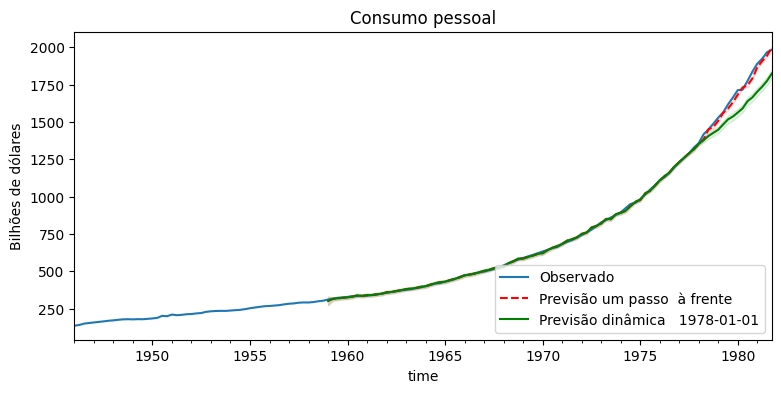

In [16]:
# Visualização dos resultados

fig, ax = plt.subplots(figsize=(9,4))
npre = 4
ax.set(title='Consumo pessoal', xlabel='Data', ylabel='Bilhões de dólares')

# Plota os dados
data['consump'].plot(ax=ax, label='Observado')

# Previsões
previsao.predicted_mean.plot(ax=ax, style='r--', label='Previsão um passo  à frente')
ip = previsao_ip
ax.fill_between(ip.index, ip.iloc[:,0], ip.iloc[:,1], color='r', alpha=0.1)

previsao_di.predicted_mean.plot(ax=ax, style='g', label='Previsão dinâmica   %s' % data_previsao_dinamica )
ip = previsao_di_ip
ax.fill_between(ip.index, ip.iloc[:,0], ip.iloc[:,1], color='g', alpha=0.1)

legend = ax.legend(loc='lower right')

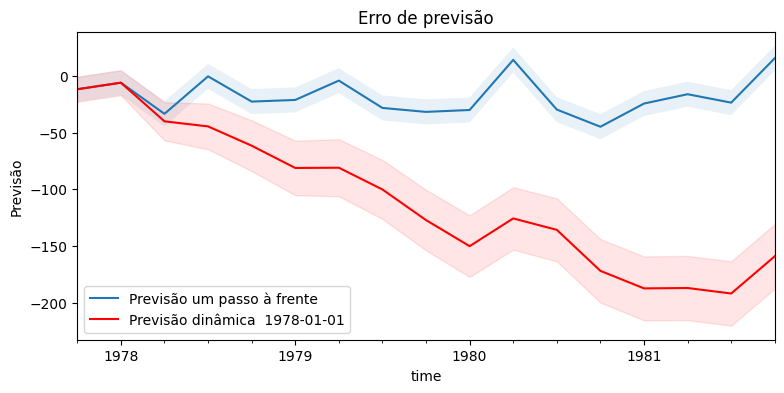

In [17]:
# Erro de predição

fig, ax = plt.subplots(figsize=(9,4))
npre = 4
ax.set(title='Erro de previsão', xlabel='Data', ylabel='Previsão')

# Previsão um passo à frente com intervalos de 95% de confiança
erro_previsao = previsao.predicted_mean - endog
erro_previsao.loc['1977-10-01':].plot(ax=ax, label='Previsão um passo à frente')

ip = previsao_ip.loc['1977-10-01':].copy()
ip.iloc[:,0] -= endog.loc['1977-10-01':]
ip.iloc[:,1] -= endog.loc['1977-10-01':]

ax.fill_between(ip.index, ip.iloc[:,0], ip.iloc[:,1], alpha=0.1)

# Previsão dinâmica com intervalos de 95% de confiança
erro_previsao_di = previsao_di.predicted_mean - endog
erro_previsao_di.loc['1977-10-01':].plot(ax=ax, style='r', label='Previsão dinâmica  %s' % data_previsao_dinamica )

ip_di = previsao_di_ip.loc['1977-10-01':].copy()
ip_di.iloc[:,0] -= endog.loc['1977-10-01':]
ip_di.iloc[:,1] -= endog.loc['1977-10-01':]

ax.fill_between(ip_di.index, ip_di.iloc[:,0], ip_di.iloc[:,1], color='r', alpha=0.1)

legend = ax.legend(loc='lower left');
legend.get_frame().set_facecolor('w')

**Exercício: mude a data da previsão dinâmica e verifique como se alteram as previsões e os erros de previsão**

## Previsão Bayesiana

Leituras adicionais recomendada:


- Pacote Tensorflow Probability: https://www.tensorflow.org/probability

- Modelagem de séries temporais estruturais: https://blog.tensorflow.org/2019/03/structural-time-series-modeling-in.html

- HARVEY, A. C. Forecasting, structural time series models and the Kalman filter. Cambridge University Press. 1989.


Os modelos de séries temporais estruturais (STS) são vistos como uma família de modelos de probabilidade que incluem

- processos autorregressivos,

- médias móveis,

- tendências lineares locais,

- sazonalidade e

- regressão e seleção de variáveis em covariáveis externas (outras séries temporais potencialmente relacionadas às séries de interesse).


De uma forma bem simplificada, um modelo de séries temporais estruturais considera que a série temporal pode ser escrita como uma soma de n componentes

$$f(t) = f_1(t) + f_2(t) + \ldots + f_n(t) + \epsilon_t, \ \ \epsilon_t\sim N(0,\sigma^2)$$

A modelagem bayesiana assume que os parâmetros desse modelo seguem distribuições de probabilidade (distribuições a priori) e, a partir da distribuição conjunta dos parâmetros e dados, obtém estimativas a partir da distribuição a posteriori dos parâmetros dadas as observações. No pacote tensorflow_probability são implementados métodos de inferência variacional e Monte Carlo Hamiltoniano.


### Aplicação


Fonte da implementação:

https://github.com/tensorflow/probability/blob/master/tensorflow_probability/examples/jupyter_notebooks/Structural_Time_Series_Modeling_Case_Studies_Atmospheric_CO2_and_Electricity_Demand.ipynb


Fonte original dos dados de CO2:

https://scrippsco2.ucsd.edu/data/atmospheric_co2/primary_mlo_co2_record.html

KEELING,C. D., PIPER, S. C., BACASTOW, R. B., WAHLEN, M. WHORF, T. P., HEIMANN, M. and MEIJER, H. A.  Atmospheric CO2 and 13CO2 exchange with the terrestrial biosphere and oceans from 1978 to 2000: observations and carbon cycle implications, pages 83-113, in "A History of Atmospheric CO2 and its effects on Plants, Animals, and Ecosystems", editors, Ehleringer, J.R., T. E. Cerling, M. D. Dearing, Springer Verlag, New York, 2005.

In [18]:
# ATENÇÃO: Podem ocorrer problemas de compatibilidade dos pacotes. Se necessário, instalar os pacotes abaixo


#!pip install -U -q segmentation-models
#!pip install -q tensorflow==2.5.0
#!pip install -q keras==2.4.3
#!pip install -U tensorboard==1.15.0

In [19]:
import pandas as pd
import numpy as np

%matplotlib inline
import matplotlib as mpl
from matplotlib import pylab as plt
import matplotlib.dates as mdates
import seaborn as sns

import collections

import numpy as np
import tensorflow.compat.v2 as tf
import tensorflow_probability as tfp

from tensorflow_probability import distributions as tfd
from tensorflow_probability import sts


# Evitar warnings não prejudiciais
import warnings
warnings.filterwarnings('ignore')

pd.plotting.register_matplotlib_converters()


In [20]:
# Algumas funções auxiliares e definição de estilo para a visualização dos dados e de previsões

# Fonte: https://github.com/tensorflow/probability/blob/master/tensorflow_probability/examples/jupyter_notebooks/Structural_Time_Series_Modeling_Case_Studies_Atmospheric_CO2_and_Electricity_Demand.ipynb

from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()


sns.set_context("notebook", font_scale=1.)
sns.set_style("whitegrid")
%config InlineBackend.figure_format = 'retina'


def plot_forecast(x, y,
                  forecast_mean, forecast_scale, forecast_samples,
                  title, x_locator=None, x_formatter=None):
  """Plot a forecast distribution against the 'true' time series."""
  colors = sns.color_palette()
  c1, c2 = colors[0], colors[1]
  fig = plt.figure(figsize=(12, 6))
  ax = fig.add_subplot(1, 1, 1)

  num_steps = len(y)
  num_steps_forecast = forecast_mean.shape[-1]
  num_steps_train = num_steps - num_steps_forecast


  ax.plot(x, y, lw=2, color=c1, label='ground truth')

  forecast_steps = np.arange(
      x[num_steps_train],
      x[num_steps_train]+num_steps_forecast,
      dtype=x.dtype)

  ax.plot(forecast_steps, forecast_samples.T, lw=1, color=c2, alpha=0.1)

  ax.plot(forecast_steps, forecast_mean, lw=2, ls='--', color=c2,
           label='forecast')
  ax.fill_between(forecast_steps,
                   forecast_mean-2*forecast_scale,
                   forecast_mean+2*forecast_scale, color=c2, alpha=0.2)

  ymin, ymax = min(np.min(forecast_samples), np.min(y)), max(np.max(forecast_samples), np.max(y))
  yrange = ymax-ymin
  ax.set_ylim([ymin - yrange*0.1, ymax + yrange*0.1])
  ax.set_title("{}".format(title))
  ax.legend()

  if x_locator is not None:
    ax.xaxis.set_major_locator(x_locator)
    ax.xaxis.set_major_formatter(x_formatter)
    fig.autofmt_xdate()

  return fig, ax


def plot_components(dates,
                    component_means_dict,
                    component_stddevs_dict,
                    x_locator=None,
                    x_formatter=None):
  """Plot the contributions of posterior components in a single figure."""
  colors = sns.color_palette()
  c1, c2 = colors[0], colors[1]

  axes_dict = collections.OrderedDict()
  num_components = len(component_means_dict)
  fig = plt.figure(figsize=(12, 2.5 * num_components))
  for i, component_name in enumerate(component_means_dict.keys()):
    component_mean = component_means_dict[component_name]
    component_stddev = component_stddevs_dict[component_name]

    ax = fig.add_subplot(num_components,1,1+i)
    ax.plot(dates, component_mean, lw=2)
    ax.fill_between(dates,
                     component_mean-2*component_stddev,
                     component_mean+2*component_stddev,
                     color=c2, alpha=0.5)
    ax.set_title(component_name)
    if x_locator is not None:
      ax.xaxis.set_major_locator(x_locator)
      ax.xaxis.set_major_formatter(x_formatter)
    axes_dict[component_name] = ax
  fig.autofmt_xdate()
  fig.tight_layout()
  return fig, axes_dict


In [21]:
# Leitura dos dados e estabelecimento do índice

# CO2 readings from Mauna Loa observatory, monthly beginning January 1966
# Original source: http://scrippsco2.ucsd.edu/data/atmospheric_co2/primary_mlo_co2_record
co2_by_month = np.array('320.62,321.60,322.39,323.70,324.08,323.75,322.38,320.36,318.64,318.10,319.78,321.03,322.33,322.50,323.04,324.42,325.00,324.09,322.54,320.92,319.25,319.39,320.73,321.96,322.57,323.15,323.89,325.02,325.57,325.36,324.14,322.11,320.33,320.25,321.32,322.89,324.00,324.42,325.63,326.66,327.38,326.71,325.88,323.66,322.38,321.78,322.85,324.12,325.06,325.98,326.93,328.14,328.08,327.67,326.34,324.69,323.10,323.06,324.01,325.13,326.17,326.68,327.17,327.79,328.92,328.57,327.36,325.43,323.36,323.56,324.80,326.01,326.77,327.63,327.75,329.73,330.07,329.09,328.04,326.32,324.84,325.20,326.50,327.55,328.55,329.56,330.30,331.50,332.48,332.07,330.87,329.31,327.51,327.18,328.16,328.64,329.35,330.71,331.48,332.65,333.09,332.25,331.18,329.39,327.43,327.37,328.46,329.57,330.40,331.40,332.04,333.31,333.97,333.60,331.90,330.06,328.56,328.34,329.49,330.76,331.75,332.56,333.50,334.58,334.88,334.33,333.05,330.94,329.30,328.94,330.31,331.68,332.93,333.42,334.70,336.07,336.75,336.27,334.92,332.75,331.59,331.16,332.40,333.85,334.97,335.38,336.64,337.76,338.01,337.89,336.54,334.68,332.76,332.55,333.92,334.95,336.23,336.76,337.96,338.88,339.47,339.29,337.73,336.09,333.92,333.86,335.29,336.73,338.01,338.36,340.07,340.77,341.47,341.17,339.56,337.60,335.88,336.02,337.10,338.21,339.24,340.48,341.38,342.51,342.91,342.25,340.49,338.43,336.69,336.86,338.36,339.61,340.75,341.61,342.70,343.57,344.14,343.35,342.06,339.81,337.98,337.86,339.26,340.49,341.38,342.52,343.10,344.94,345.76,345.32,343.98,342.38,339.87,339.99,341.15,342.99,343.70,344.50,345.28,347.06,347.43,346.80,345.39,343.28,341.07,341.35,342.98,344.22,344.97,345.99,347.42,348.35,348.93,348.25,346.56,344.67,343.09,342.80,344.24,345.56,346.30,346.95,347.85,349.55,350.21,349.55,347.94,345.90,344.85,344.17,345.66,346.90,348.02,348.48,349.42,350.99,351.85,351.26,349.51,348.10,346.45,346.36,347.81,348.96,350.43,351.73,352.22,353.59,354.22,353.79,352.38,350.43,348.73,348.88,350.07,351.34,352.76,353.07,353.68,355.42,355.67,355.12,353.90,351.67,349.80,349.99,351.30,352.52,353.66,354.70,355.38,356.20,357.16,356.23,354.81,352.91,350.96,351.18,352.83,354.21,354.72,355.75,357.16,358.60,359.34,358.24,356.17,354.02,352.15,352.21,353.75,354.99,355.99,356.72,357.81,359.15,359.66,359.25,357.02,355.00,353.01,353.31,354.16,355.40,356.70,357.17,358.38,359.46,360.28,359.60,357.57,355.52,353.69,353.99,355.34,356.80,358.37,358.91,359.97,361.26,361.69,360.94,359.55,357.48,355.84,356.00,357.58,359.04,359.97,361.00,361.64,363.45,363.80,363.26,361.89,359.45,358.05,357.75,359.56,360.70,362.05,363.24,364.02,364.71,365.41,364.97,363.65,361.48,359.45,359.61,360.76,362.33,363.18,363.99,364.56,366.36,366.80,365.63,364.47,362.50,360.19,360.78,362.43,364.28,365.33,366.15,367.31,368.61,369.30,368.88,367.64,365.78,363.90,364.23,365.46,366.97,368.15,368.87,369.59,371.14,371.00,370.35,369.27,366.93,364.64,365.13,366.68,368.00,369.14,369.46,370.51,371.66,371.83,371.69,370.12,368.12,366.62,366.73,368.29,369.53,370.28,371.50,372.12,372.86,374.02,373.31,371.62,369.55,367.96,368.09,369.68,371.24,372.44,373.08,373.52,374.85,375.55,375.40,374.02,371.48,370.70,370.25,372.08,373.78,374.68,375.62,376.11,377.65,378.35,378.13,376.61,374.48,372.98,373.00,374.35,375.69,376.79,377.36,378.39,380.50,380.62,379.55,377.76,375.83,374.05,374.22,375.84,377.44,378.34,379.61,380.08,382.05,382.24,382.08,380.67,378.67,376.42,376.80,378.31,379.96,381.37,382.02,382.56,384.37,384.92,384.03,382.28,380.48,378.81,379.06,380.14,381.66,382.58,383.71,384.34,386.23,386.41,385.87,384.45,381.84,380.86,380.86,382.36,383.61,385.07,385.84,385.83,386.77,388.51,388.05,386.25,384.08,383.09,382.78,384.01,385.11,386.65,387.12,388.52,389.57,390.16,389.62,388.07,386.08,384.65,384.33,386.05,387.49,388.55,390.07,391.01,392.38,393.22,392.24,390.33,388.52,386.84,387.16,388.67,389.81,391.30,391.92,392.45,393.37,394.28,393.69,392.59,390.21,389.00,388.93,390.24,391.80,393.07,393.35,394.36,396.43,396.87,395.88,394.52,392.54,391.13,391.01,392.95,394.34,395.61,396.85,397.26,398.35,399.98,398.87,397.37,395.41,393.39,393.70,395.19,396.82,397.92,398.10,399.47,401.33,401.88,401.31,399.07,397.21,395.40,395.65,397.23,398.79,399.85,400.31,401.51,403.45,404.10,402.88,401.61,399.00,397.50,398.28,400.24,401.89,402.65,404.16,404.85,407.57,407.66,407.00,404.50,402.24,401.01,401.50,403.64,404.55,406.07,406.64,407.06,408.95,409.91,409.12,407.20,405.24,403.27,403.64,405.17,406.75,408.05,408.34,409.25,410.30,411.30,410.88,408.90,407.10,405.59,405.99,408.12,409.23,410.92'.split(',')).astype(np.float32)

co2_by_month = co2_by_month
num_forecast_steps = 12 * 10 # Vamos predizer os dados dos últimos 10 anos
co2_by_month_training_data = co2_by_month[:-num_forecast_steps]

co2_dates = np.arange("1966-01", "2019-02", dtype="datetime64[M]")
co2_loc = mdates.YearLocator(3)
co2_fmt = mdates.DateFormatter('%Y')

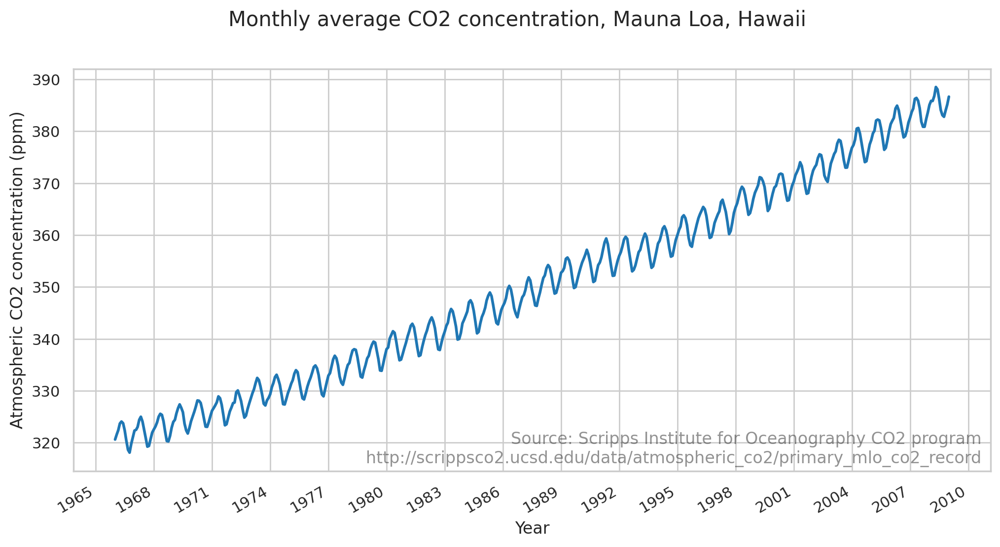

In [22]:
# Visualização dos dados

fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot(1, 1, 1)
ax.plot(co2_dates[:-num_forecast_steps], co2_by_month_training_data, lw=2, label="training data")
ax.xaxis.set_major_locator(co2_loc)
ax.xaxis.set_major_formatter(co2_fmt)
ax.set_ylabel("Atmospheric CO2 concentration (ppm)")
ax.set_xlabel("Year")
fig.suptitle("Monthly average CO2 concentration, Mauna Loa, Hawaii",
             fontsize=15)
ax.text(0.99, .02,
        "Source: Scripps Institute for Oceanography CO2 program\nhttp://scrippsco2.ucsd.edu/data/atmospheric_co2/primary_mlo_co2_record",
        transform=ax.transAxes,
        horizontalalignment="right",
        alpha=0.5)
fig.autofmt_xdate()

In [23]:
# função para ajuste de um modelo com tendência e sazonalidade
# Leituras adicionais:
# https://www.tensorflow.org/probability/api_docs/python/tfp/sts/LocalLinearTrend
# https://www.tensorflow.org/probability/api_docs/python/tfp/sts/Seasonal

def build_model(observed_time_series):
  trend = sts.LocalLinearTrend(observed_time_series=observed_time_series)
  seasonal = tfp.sts.Seasonal(
      num_seasons=12, observed_time_series=observed_time_series)
  model = sts.Sum([trend, seasonal], observed_time_series=observed_time_series)
  return model



In [24]:
# Evitar warnings não prejudiciais
import warnings
warnings.filterwarnings('ignore')

# Ajuste do modelo usando o pacote tensorflow_probability

co2_model = build_model(co2_by_month_training_data)

# A função build_factored_surrogate_posterior constrói as distribuições a posteriori "substitutas" para os parâmetros no modelo proposto, supondo distribuições a priori normais independentes para os parâmetros com hiperparâmetros treináveis, de forma a obter o suporte apropriado para esse parâmetro.

# Build the variational surrogate posteriors `qs`.
variational_posteriors = tfp.sts.build_factored_surrogate_posterior(
    model=co2_model)

### Evidence lower bound (ELBO) e método Bayesiano Variacional:

**https://en.wikipedia.org/wiki/Evidence_lower_bound**

**https://en.wikipedia.org/wiki/Variational_Bayesian_methods**


Instructions for updating:
Please use `StructuralTimeSeries.joint_distribution(observed_time_series).log_prob`


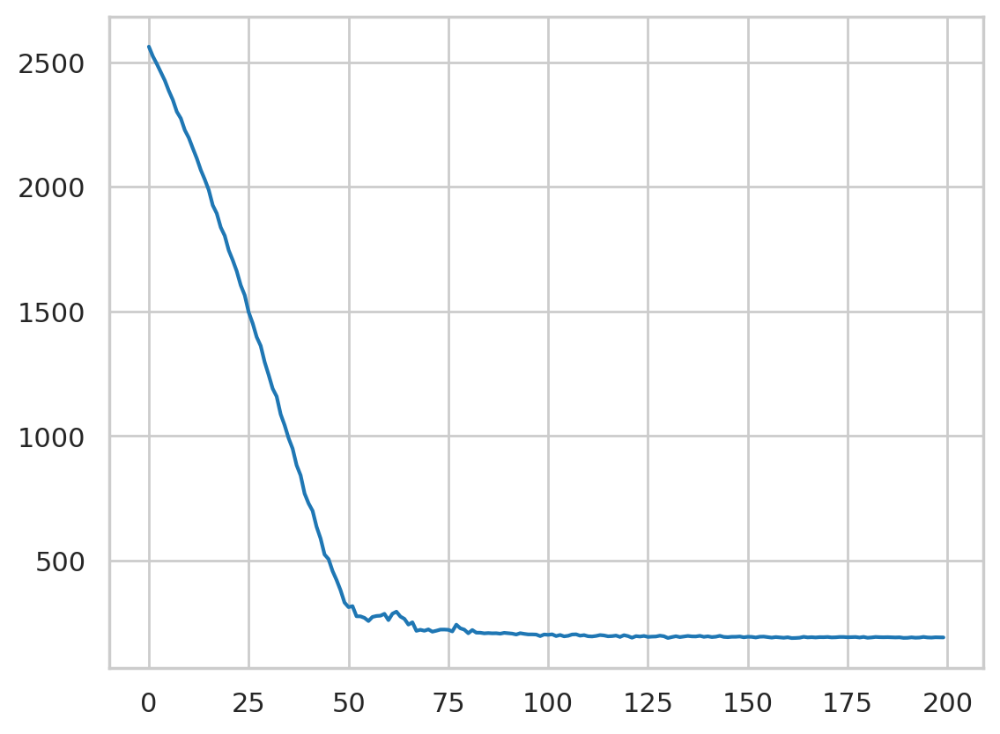

In [25]:
# Evitar warnings não prejudiciais
import warnings
warnings.filterwarnings('ignore')


#@title Minimize the variational loss.

# Allow external control of optimization to reduce test runtimes.
num_variational_steps = 200 # @param { isTemplate: true}
num_variational_steps = int(num_variational_steps)

optimizer = tf.optimizers.Adam(learning_rate=.1)

# Using fit_surrogate_posterior to build and optimize the variational loss function.
@tf.function(experimental_compile=True)
def train():
  elbo_loss_curve = tfp.vi.fit_surrogate_posterior(
    target_log_prob_fn=co2_model.joint_log_prob(
        observed_time_series=co2_by_month_training_data),
    surrogate_posterior=variational_posteriors,
    optimizer=optimizer,
    num_steps=num_variational_steps)
  return elbo_loss_curve

elbo_loss_curve = train()

plt.plot(elbo_loss_curve)
plt.show()


In [26]:
# Draw samples from the variational posterior.

q_samples_co2_ = variational_posteriors.sample(50)

<Axes: >

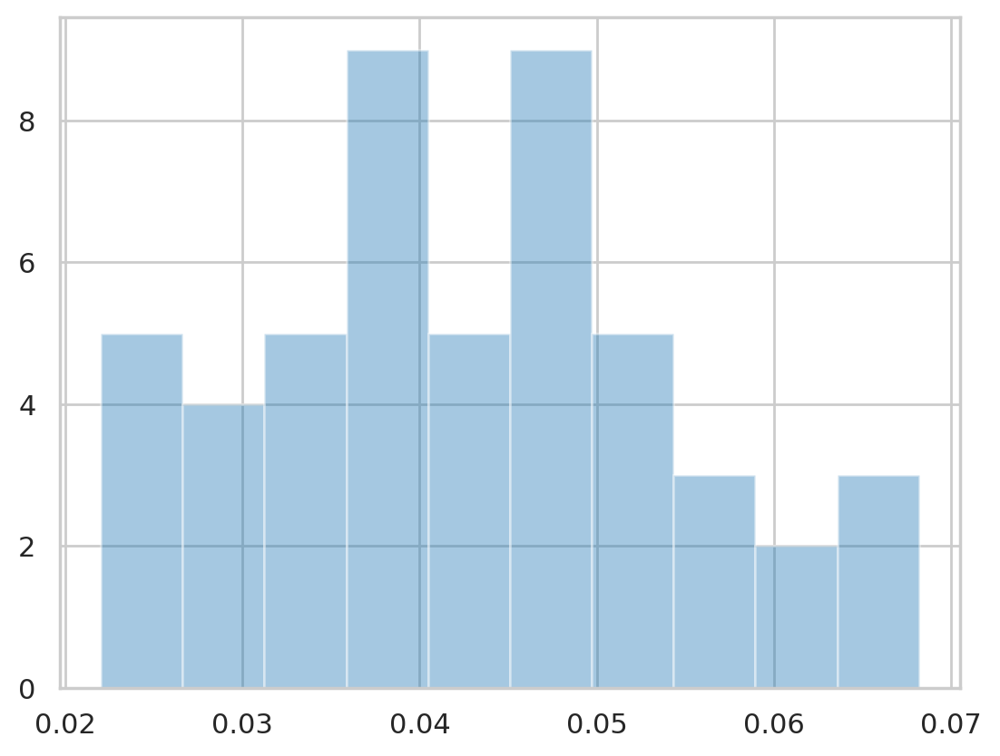

In [27]:
# Olhando para a "cara" da distribuição a posteriori (repita para outras componentes)
import seaborn as sns

sns.distplot(q_samples_co2_['Seasonal/_drift_scale'],kde=False, bins=10)

In [28]:
print("Inferred parameters:")
for param in co2_model.parameters:
  print("{}: {} +- {}".format(param.name,
                              np.mean(q_samples_co2_[param.name], axis=0),
                              np.std(q_samples_co2_[param.name], axis=0)))

Inferred parameters:
observation_noise_scale: 0.16761624813079834 +- 0.012650664895772934
LocalLinearTrend/_level_scale: 0.1788603961467743 +- 0.013679183088243008
LocalLinearTrend/_slope_scale: 0.003690719837322831 +- 0.00169452466070652
Seasonal/_drift_scale: 0.04275647550821304 +- 0.011381520889699459


In [29]:
# Previsão

co2_forecast_dist = tfp.sts.forecast(
    co2_model,
    observed_time_series=co2_by_month_training_data,
    parameter_samples=q_samples_co2_,
    num_steps_forecast=num_forecast_steps)



In [30]:
num_samples=10

co2_forecast_mean, co2_forecast_scale, co2_forecast_samples = (
    co2_forecast_dist.mean().numpy()[..., 0],
    co2_forecast_dist.stddev().numpy()[..., 0],
    co2_forecast_dist.sample(num_samples).numpy()[..., 0])

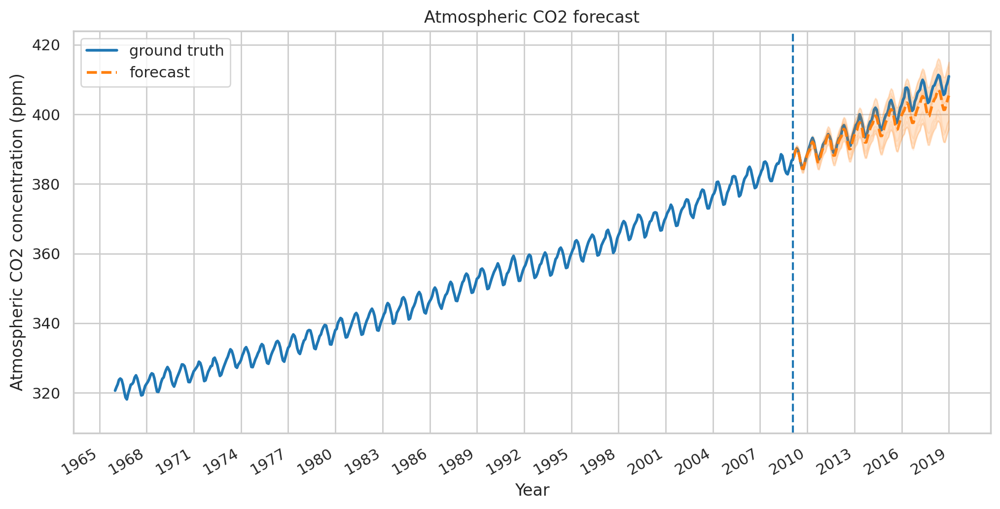

In [31]:
fig, ax = plot_forecast(
    co2_dates, co2_by_month,
    co2_forecast_mean, co2_forecast_scale, co2_forecast_samples,
    x_locator=co2_loc,
    x_formatter=co2_fmt,
    title="Atmospheric CO2 forecast")
ax.axvline(co2_dates[-num_forecast_steps], linestyle="--")
ax.legend(loc="upper left")
ax.set_ylabel("Atmospheric CO2 concentration (ppm)")
ax.set_xlabel("Year")
fig.autofmt_xdate()

In [32]:
# Build a dict mapping components to distributions over
# their contribution to the observed signal.
component_dists = sts.decompose_by_component(
    co2_model,
    observed_time_series=co2_by_month,
    parameter_samples=q_samples_co2_)

In [33]:
co2_component_means_, co2_component_stddevs_ = (
    {k.name: c.mean() for k, c in component_dists.items()},
    {k.name: c.stddev() for k, c in component_dists.items()})


(<Figure size 1200x500 with 2 Axes>,
 OrderedDict([('LocalLinearTrend/',
               <Axes: title={'center': 'LocalLinearTrend/'}>),
              ('Seasonal/', <Axes: title={'center': 'Seasonal/'}>)]))

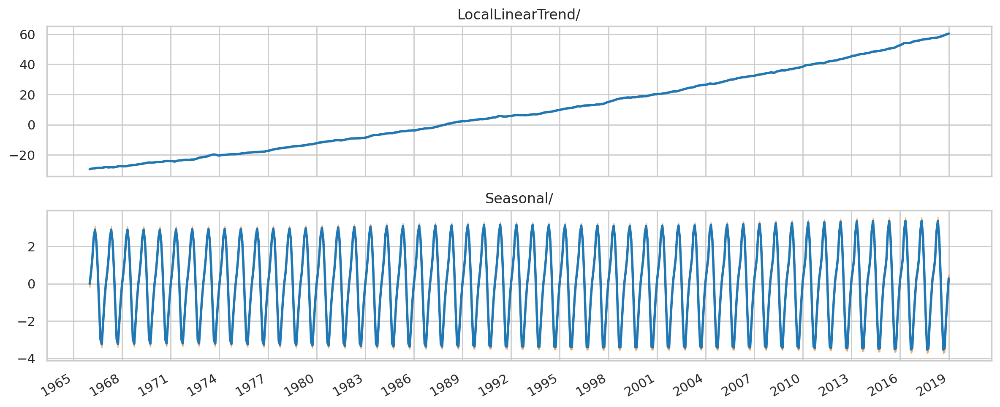

In [34]:
plot_components(co2_dates, co2_component_means_, co2_component_stddevs_,
                    x_locator=co2_loc, x_formatter=co2_fmt)

<a id="section12"></a>
Aula 5: Exercícios

# Prática 5

***Aprendizado Dinâmico***

Considere os dados RestaurantVisitors.csv, que contém dados de visitantes de restaurantes, baseado em uma <a href='https://www.kaggle.com/c/recruit-restaurant-visitor-forecasting'> competição Kaggle </a>. Os dados consideram o total de visitantes diários de quatro restaurantes localizados nos Estados Unidos, sujeitos aos feriados americanos. Para a variável exógena, utilizaremos os feriados, para verificar como eles afetam o movimento nos restaurantes. O conjunto de dados contém 478 dias de dados de restaurantes, além de 39 dias adicionais de dados de feriados para fins de previsão.


Ajuste um modelo SARIMA com uma variável exógena "holiday" usando o enfoque de modelos de espaço de estado para a variável "total".

Faça a divisão da base em treino e teste e verifique as previsões obtidas.

Em seguida, faça a previsão para observações futuras com as informações de feriados disponíveis.

**1. Carregue as bibliotecas necessárias.**

In [2]:
#Instale, se necessário, na versão sugerida
!pip install pmdarima==2.0.3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 10.3 MB/s eta 0:00:00


In [3]:
import numpy as np
import pandas as pd
from scipy.stats import norm
import statsmodels.api as sm
import matplotlib.pyplot as plt
from datetime import datetime
import requests
from io import BytesIO

from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from pmdarima import auto_arima


# Iniba warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

%matplotlib inline


**2. Faça a leitura dos dados. Exclua as observações faltantes em total, que correspondem às observações extras de feriados.**

In [4]:
# Leitura dos dados

df = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/RestaurantVisitors.csv',index_col='date',parse_dates=True)
df.index.freq = 'D'
df.head()

df1 = df.dropna()

**3. Faça a visualização dos dados.**

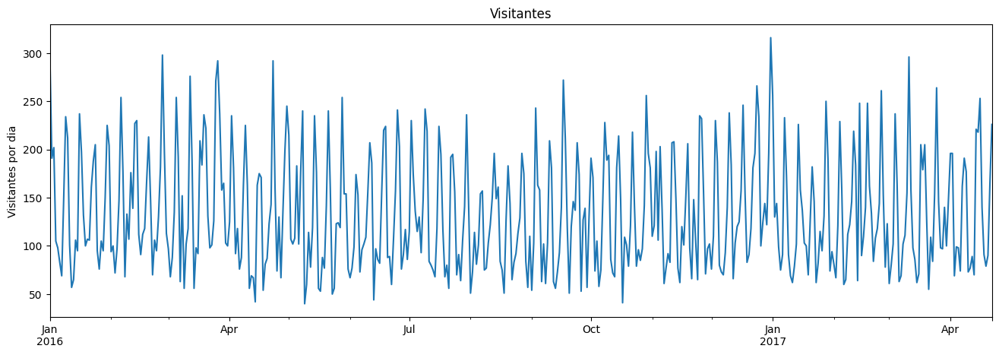

In [5]:
# Visualização dos dados

title='Visitantes'
ylabel='Visitantes por dia'
xlabel=''

ax = df1['total'].plot(figsize=(16,5),title=title)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel);

**4. Marque os feriados com linhas verticais em cinza.**

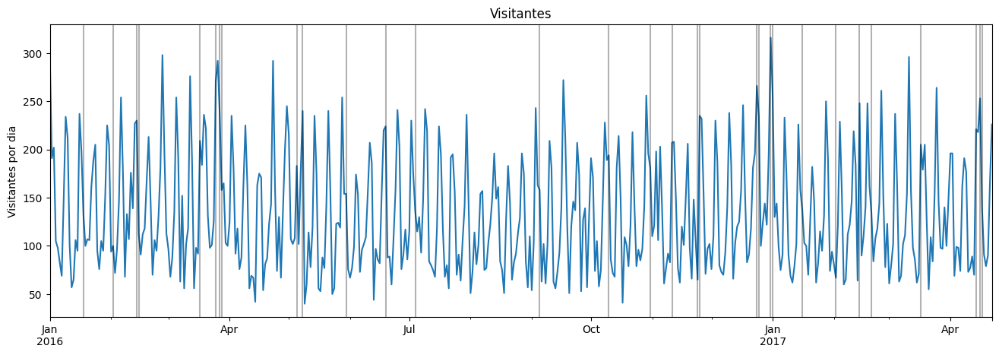

In [6]:
title='Visitantes'
ylabel='Visitantes por dia'
xlabel=''

ax = df1['total'].plot(figsize=(16,5),title=title)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel)
for x in df1.query('holiday==1').index:       # for days where holiday == 1
    ax.axvline(x=x, color='k', alpha = 0.3);  # add a semi-transparent grey line

**5. Faça uma decomposição da série em tendência e sazonalidade.**

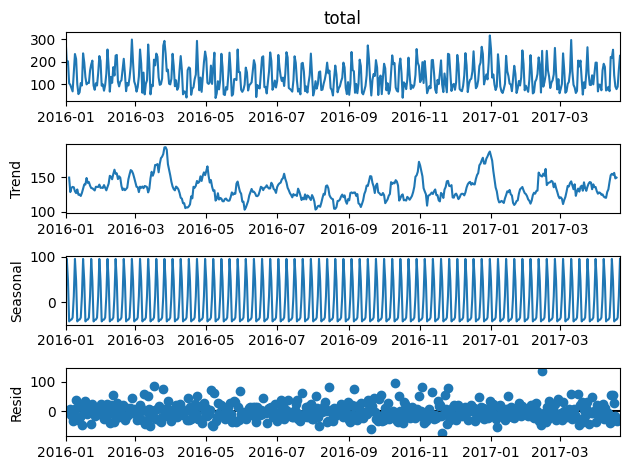

In [7]:
decomposicao = seasonal_decompose(df1['total'])
decomposicao.plot();

**6. Verifique a estacionariedade da série.**

In [8]:
# Testando estacionariedade
# fonte: https://machinelearningmastery.com/time-series-data-stationary-python/


from statsmodels.tsa.stattools import adfuller

result = adfuller(df1['total'], autolag='AIC')
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
	print('\t%s: %.3f' % (key, value))


ADF Statistic: -5.592497
p-value: 0.000001
Critical Values:
	1%: -3.445
	5%: -2.868
	10%: -2.570


**7. Escolha um modelo SARIMA permitindo termos com sazonalidade 7.**


In [9]:
stepwise_fit = auto_arima(df1['total'], start_p=0, start_q=0,
                          max_p=6, max_q=3, m=7,
                          seasonal=True,
                          trace=True,
                          error_action='ignore',
                          suppress_warnings=True,
                          stepwise=True)

stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(1,0,1)[7] intercept   : AIC=4771.197, Time=1.58 sec
 ARIMA(0,0,0)(0,0,0)[7] intercept   : AIC=5269.484, Time=0.08 sec
 ARIMA(1,0,0)(1,0,0)[7] intercept   : AIC=4916.749, Time=1.22 sec
 ARIMA(0,0,1)(0,0,1)[7] intercept   : AIC=5049.644, Time=1.79 sec
 ARIMA(0,0,0)(0,0,0)[7]             : AIC=6126.084, Time=0.09 sec
 ARIMA(0,0,0)(0,0,1)[7] intercept   : AIC=5093.130, Time=1.09 sec
 ARIMA(0,0,0)(1,0,0)[7] intercept   : AIC=4926.360, Time=1.36 sec
 ARIMA(0,0,0)(2,0,1)[7] intercept   : AIC=4987.489, Time=7.80 sec
 ARIMA(0,0,0)(1,0,2)[7] intercept   : AIC=4892.998, Time=6.90 sec
 ARIMA(0,0,0)(0,0,2)[7] intercept   : AIC=5010.582, Time=2.31 sec
 ARIMA(0,0,0)(2,0,0)[7] intercept   : AIC=4859.638, Time=8.78 sec
 ARIMA(0,0,0)(2,0,2)[7] intercept   : AIC=inf, Time=6.84 sec
 ARIMA(1,0,0)(1,0,1)[7] intercept   : AIC=4813.744, Time=3.34 sec
 ARIMA(0,0,1)(1,0,1)[7] intercept   : AIC=inf, Time=4.93 sec
 ARIMA(1,0,1)(1,0,1)[7] intercept   : AIC=i

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                 
=================================================================================
Dep. Variable:                         y   No. Observations:                  478
Model:             SARIMAX(1, 0, [1], 7)   Log Likelihood               -2381.598
Date:                   Thu, 10 Aug 2023   AIC                           4771.197
Time:                           00:53:35   BIC                           4787.875
Sample:                       01-01-2016   HQIC                          4777.754
                            - 04-22-2017                                         
Covariance Type:                     opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      4.3650      1.674      2.607      0.009       1.083       7.647
ar.S.L7        0.9661      0.013     76.835      0.000       0.942       0.991
ma.S.L7       -0.7541      0.051    -14.801      0.000      -0.854      -0.654
sigma2      1269.4981     78.083     16.258      0.000    1116.459    1422.537
===================================================================================
Ljung-Box (L1) (Q):                  15.35   Jarque-Bera (JB):                63.60
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               0.86   Skew:                             0.74
Prob(H) (two-sided):                  0.34   Kurtosis:                         4.00
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

**8. Separe uma base de treino e teste. A base de treino pode ter 80% das observações totais.**


In [10]:
train = df1.iloc[:382]
test = df1.iloc[382:]

endog = train['total']
exog = train['holiday']

**9. Vamos ajustar um modelo SARIMA (0,0,0)x(1,0,1)7 para os dados de treino.**

In [11]:
# Veja https://www.statsmodels.org/dev/generated/statsmodels.tsa.statespace.sarimax.SARIMAX.html

modelo = sm.tsa.statespace.SARIMAX(endog, exog, order=(0,0,0), seasonal_order=(1,0,1,7))
resultado = modelo.fit(disp=False)
print(resultado.summary())


                                 SARIMAX Results                                 
Dep. Variable:                     total   No. Observations:                  382
Model:             SARIMAX(1, 0, [1], 7)   Log Likelihood               -1842.932
Date:                   Thu, 10 Aug 2023   AIC                           3693.863
Time:                           00:53:35   BIC                           3709.645
Sample:                       01-01-2016   HQIC                          3700.124
                            - 01-16-2017                                         
Covariance Type:                     opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
holiday       70.2779      5.088     13.813      0.000      60.306      80.250
ar.S.L7        0.9999   8.96e-05   1.12e+04      0.000       1.000       1.000
ma.S.L7       -0.9389      0

**10.  Obtenha os valores preditos. É importante estabelecer em predict a variável exógena.**

In [12]:
start=len(train)
end=len(train)+len(test)-1
exog_forecast = test[['holiday']]  # Por que não usar apenas colchetes simples?
previsao = resultado.predict(start=start, end=end, exog=exog_forecast).rename('Previsões SARIMAX(0,0,0)(1,0,1,7)')

**11. Observe as previsões do modelo e compare com a base de teste.**

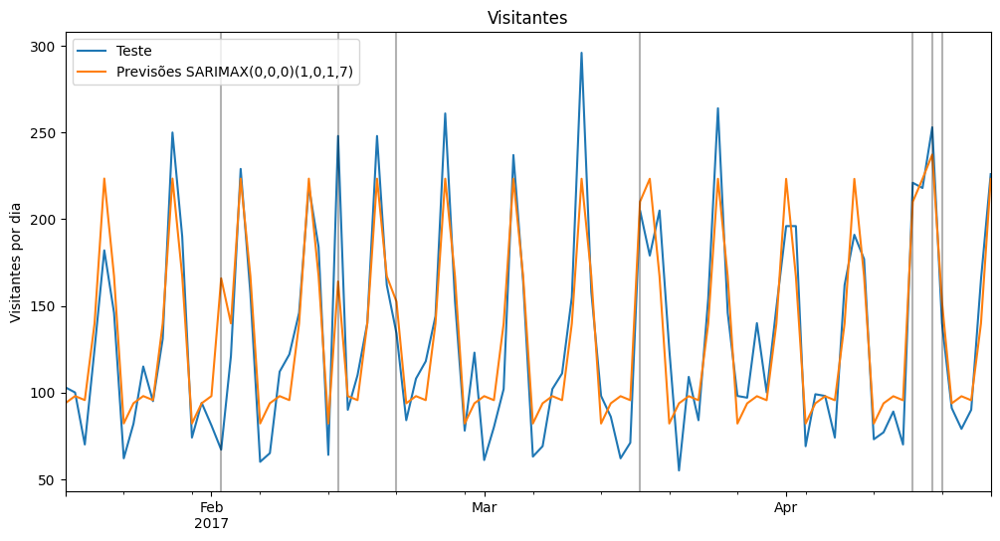

In [13]:
title='Visitantes'
ylabel='Visitantes por dia'
xlabel=''


ax = test['total'].plot(legend=True,figsize=(12,6),title=title, label='Teste')
previsao.plot(legend=True)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel)

for x in test.query('holiday==1').index:
    ax.axvline(x=x, color='k', alpha = 0.3);

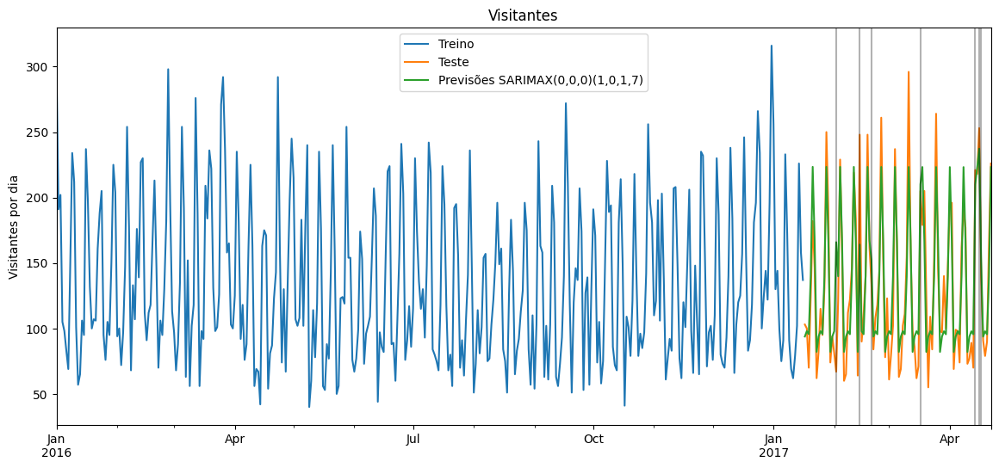

In [14]:
title='Visitantes'
ylabel='Visitantes por dia'
xlabel=''

train['total'].plot(legend=True,label='Treino')

ax = test['total'].plot(legend=True,figsize=(14,6),title=title, label='Teste')
previsao.plot(legend=True)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel)

for x in test.query('holiday==1').index:
    ax.axvline(x=x, color='k', alpha = 0.3);

**12. Faça as previsões para as próximas observações, com os feriados disponíveis na base. Nesse caso, não fará diferença a previsão passo à frente ou dinâmica.**

In [15]:
modelo = sm.tsa.statespace.SARIMAX(df1['total'],exog=df1['holiday'],order=(0,0,0),seasonal_order=(1,0,1,7),enforce_invertibility=False)
resultado = modelo.fit()
exog_forecast = df[478:][['holiday']]


In [16]:
# Previsão um passo a frente. Sugestão: Use get_prediction(len(df1),len(df1)+28,exog=exog_forecast)

previsao = resultado.get_prediction(len(df1),len(df1)+38,exog=exog_forecast)
previsao_ip = previsao.conf_int()


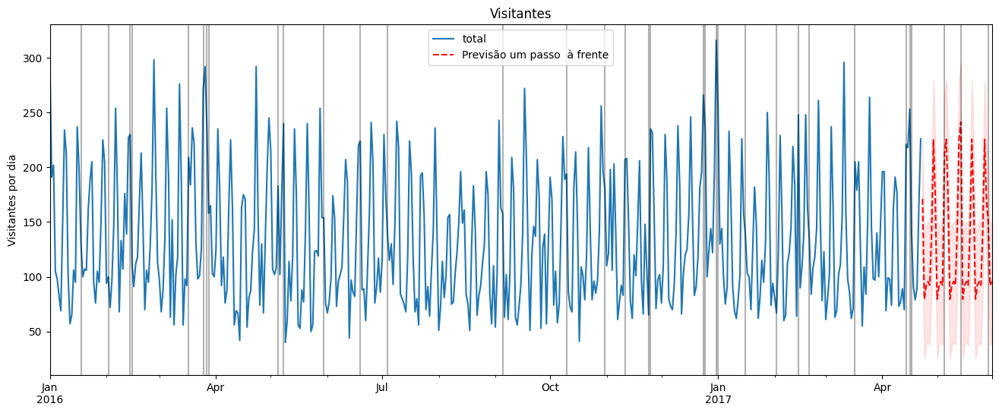

In [17]:
title='Visitantes'
ylabel='Visitantes por dia'
xlabel=''

ax = df1['total'].plot(legend=True,figsize=(16,6),title=title)

previsao.predicted_mean.plot(ax=ax, style='r--', label='Previsão um passo  à frente', legend=True)
ip = previsao_ip.loc['2017-04-23':]
ax.fill_between(ip.index, ip.iloc[:,0], ip.iloc[:,1], color='r', alpha=0.1)


ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel)
for x in df.query('holiday==1').index:
    ax.axvline(x=x, color='k', alpha = 0.3);

**Para essa aplicação, escolher a previsão dinâmica dynamic=data_previsao_dinamica levará aos mesmos resultados na prática.**

In [18]:
# Previsão dinâmica

data_previsao_dinamica = '2017-04-23'

previsao_di = resultado.get_prediction(len(df1),len(df1)+38, dynamic=data_previsao_dinamica, exog=exog_forecast)
previsao_di_ip = previsao_di.conf_int()

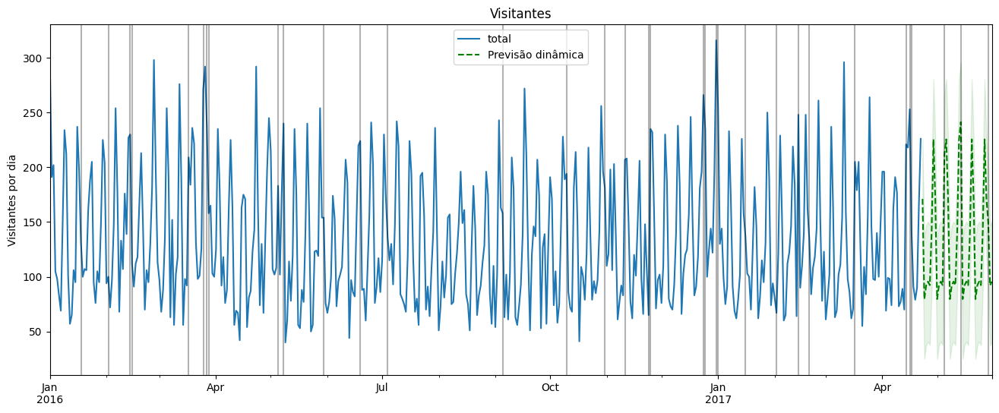

In [19]:
title='Visitantes'
ylabel='Visitantes por dia'
xlabel=''


ax = df1['total'].plot(legend=True,figsize=(16,6),title=title)

previsao_di.predicted_mean.plot(ax=ax, style='g--', label='Previsão dinâmica', legend=True)
ip = previsao_di_ip.loc['2017-04-23':]
ax.fill_between(ip.index, ip.iloc[:,0], ip.iloc[:,1], color='g', alpha=0.1)

ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel)
for x in df.query('holiday==1').index:
    ax.axvline(x=x, color='k', alpha = 0.3);

**Prática extra:**

Ajuste e interprete um modelo Bayesiano para a demanda de eletricidade disponível em

https://blog.tensorflow.org/2019/03/structural-time-series-modeling-in.html

<a id="section13"></a>
Aula 6: Método Theta e expansões

# Previsão de séries temporais: Método Theta e expansões

Baseado em

- ASSIMAKOPOULOS, V., NIKOLOPOULOS, K. The theta model: a decomposition approach to forecasting. International Journal of Forecasting, v. 16, n. 4, p. 521-530, 2000.

Implementações:

https://www.statsmodels.org/devel/examples/notebooks/generated/theta-model.html

Leituras adicionais:

- FIORUCCI, J. A., PELLEGRINI, T. R., LOUZADA, F., PETROPOULOS, F., & KOEHLER, A. B. (2016). Models for optimising the theta method and their relationship to state space models. International Journal of Forecasting, 32(4), 1151-1161. Disponível em https://www.sciencedirect.com/science/article/pii/S0169207016300243. Acessado em 07/08/2022.


- FIORUCCI, J. A. (2016). Time series forecasting:advances on Theta method. Tese de doutorado. Disponível em https://repositorio.ufscar.br/bitstream/handle/ufscar/7399/TeseJAF.pdf?sequence=1&isAllowed=y. Acessado em 07/08/2022.

- PELLEGRINI, T. R. Uma avaliação de métodos de previsão aplicados à grandes quantidades de séries temporais univariadas. Dissertação de mestrado. Universidade Federal de São Carlos. 2012. Disponível em https://repositorio.ufscar.br/bitstream/handle/ufscar/4563/4757.pdf?sequence=1&isAllowed=y. Acessado em 07/08/2022.

- HYNDMAN, R. J., KOEHLER, A. B., SNYDER, R. D., \& GROSE, S. (2002). A state space framework for automatic forecasting using exponential smoothing methods. International Journal of Forecasting, 18(3), 439-454.

- HYNDMAN, R. J., & BILLAH, B. (2003). Unmasking the Theta method. International Journal of Forecasting, 19(2), 287-290.





## Método Theta

- O método Theta é simples e preciso para se fazer previsão (forecasting) em séries temporais.


- Premiado na Competição M3 de forecasting https://en.wikipedia.org/wiki/Makridakis_Competitions


- Suposição: A série é não-sazonal ou dessazonalizada


- Tem relação com o método de Suavização exponencial simples (SES)


**Resumo do Metodo Theta**


1. O método decompõe a série temporal original em duas novas linhas através dos chamados coeficientes Theta, que são aplicados à segunda diferença dos dados. O processo de decomposição tem a vantagem de explorar informações nos dados que geralmente não são capturados e modelados completamente através da extrapolação da série temporal original.


2. As chamadas Linhas-Theta podem ser consideradas como novas séries temporais e são extrapoladas separadamente usando um método de previsão apropriado.


3. Concluída a extrapolação de cada Linha Theta, a recomposição ocorre por meio de um esquema de combinação, a fim de calcular as previsões pontuais da série temporal original.


4. A combinação das Linhas Theta é considerada para a previsão.







Os passos do algoritmo para a implementação (PELLEGRINI, 2012) são


1. **Teste de Sazonalidade**: Teste cada série temporal para verificar a existência de comportamento sazonal via teste para a função de autocorrelação, com lag de um ano para séries anuais, lag de 12 meses para séries mensais e lag de 4 meses para séries trimestrais e assim por diante.  

    De uma forma geral, a série é considerada sazonal se
    
    $$|r_m| > q_{1-a/2}\sqrt{\displaystyle\frac{1+2\sum_{i=1}^{m-1}r_i^2}{n}}$$
    
    em que $r_k$ é a função e autocorrelação de lag $k$, $m$ é o número de períodos do ciclo sazonal (por exemplo, 12 meses em uma sazonalidade anual), $n$ é o tamanho amostral, $q$ é o quantil da distribuição normal e $(1-a/2)$ é o nível de confiança do teste. Se a série for identificada como sazonal, é necessário fazer uma decomposição para eliminar a sazonalidade.  


2. **Dessazonalização**: Dessazonalize as séries temporais identificadas no passo 1 através do método de decomposição clássica (multiplicativo).


3. **Decomposição**: Cada série temporal é decomposta em duas linhas-Theta, $Z_t(0)$ e $Z_t(2)$.


4. **Extrapolação**: $Z_t(0)$ e $Z_t(2)$ são extrapoladas respectivamente através do modelo de regressão linear e do modelo de alisamento exponencial simples.


5. **Combinação**: As previsões produzidas por $\widehat{Z}_{t+h}(0)$ e $\widehat{Z}_{t+h}(2)$ são combinadas a partir da média aritmética.


6. **Resazonalização**: As previsões do passo anterior são resazonalizadas resultando nas previsões finais.


## O Método Theta


O método Theta é baseado no conceito de modificação das curvaturas locais da série temporal.   Esta  mudança  é  obtida  a  partir  de  um  coeficiente,  denominado  coeficiente Theta,  denotado  pela  letra  grega  $\theta$.


Originalmente, ASSIMAKOPOULOS & NIKOLOPOULOS (2000) propuseram a Linha Theta como a solução da equação

$$\Delta^2 Z_t(\theta) = \theta \Delta^2 Y_t, t=3,\ldots,n$$


em que

$Y_1,\ldots, Y_n$ é a série original (não sazonal ou dessazonalizada) e $\Delta$ é o operador diferença

$$\Delta Z_t = Z_t - Z_{t-1}.$$

Os valores iniciais de $Z_1$ e $Z_2$ são obtidos minimizando

$$\sum_{t=1}^{n} [Y_t - Z_t(\theta)]^2$$

Entretanto, uma solução analítica para calcular $Z(\theta)$ é dada por

$$Z_t(\theta) = \theta Y_t + (1-\theta)(A_n + B_n t), \ t=1,\ldots, n$$

em que $A_n$ e $B_n$ são coeficientes de mínimos quadrados de um modelo de regressão linear de $Y_1,\ldots, Y_n$ contra $1,\ldots,n$ (as expressões são dadas em FIORUCCI (2016)).

## Generalizações para o Método Theta

- Existem algumas propostas de generalização do Método Theta na literatura

- Modelos para otimizar o Método Theta são apresentados por FIORUCCI et. al (2016)

### Modelo Theta Otimizado

- Algumas adaptações são feitas e o modelo é reescrito como um modelo de espaço de estado (FIORUCCI et. al, 2016)

$\begin{array}{lll}
Y_t &=& \mu_t + \epsilon_t,\\
\mu_t &= & {{l}}_{t-1} + \left(1-\displaystyle{\frac{1}{\theta}}\right) \left\{(1-\alpha)^{t-1} A_n + \left[\displaystyle\frac{1-(1-\alpha)^t}{\alpha}\right] B_n\right\},\\
{l}_t &=& \alpha Y_t + (1-\alpha){l}_{t-1}
\end{array}$

com parâmetros ${l}_0 \in \mathbb{R}$, $\alpha\in(0,1)$ e $\theta\in[1,\infty]$.




A previsão pra $h$ passos à frente com origem em n é dada por

$\begin{array}{lll}\widehat{Y}_{n+h|n} &=& E[Y_{n+h}|Y_1,\ldots,Y_n]\\
&=&{l}_n + \left(\displaystyle 1-\frac{1}{\theta}\right)\times \\
&& \left\{(1-\alpha)^n A_n + \left[(h-1)+\displaystyle\frac{1-(1-\alpha)^{n+1}}{\alpha}\right] B_n\right\}\end{array}$

Além disso, é possível obter um intervalo de predição com nível de confiança de $(1-a)\%$

$\widehat{Y}_{n+h|n} \pm q_{1-a/2}\sqrt{[1+(h-1)\alpha^2]\sigma^2}$.

Se $\theta = 2$ é possível mostrar que este método produz as mesmas previsões do método usual.


### Modelo Theta Otimizado dinâmico

- Ver FIORUCCI et al. (2016)

- $A_n$ e $B_n$, que antes eram considerados coeficientes fixos, agora são considerados funções dinâmicas, isto é, para atualizar do estado $t$ para o estado $t+1$ consideramos somente a informação prévia $Y_1,\ldots, Y_t$ para calcular $A_t$ e $B_t$, e então usamos esses termos no lugar de $A_n$ e $B_n$.

Assim,


$\begin{array}{lll}\widehat{Y}_{t+1|t} &=& {l}_t + \left(\displaystyle 1-\frac{1}{\theta}\right)\times \\
&& \left\{(1-\alpha)^t A_t + \left[\displaystyle\frac{1-(1-\alpha)^{t+1}}{\alpha}\right] B_t\right\}\end{array}$

Então, assumindo erros aditivos um passo à frente, temos

$\begin{array}{lll}
Y_t &=& \mu_t + \epsilon_t,\\
\mu_t &= & {l}_{t-1} + \left(1-\displaystyle{\frac{1}{\theta}}\right) \left\{(1-\alpha)^{t-1} A_{t-1} + \left[\displaystyle\frac{1-(1-\alpha)^t}{\alpha}\right] B_{t-1}\right\}\\
{l}_t &=&\alpha Y_t + (1-a){l}_{t-1}.\end{array}$


As expressões para $A_t$, $B_t$, tal como valores iniciais podem ser vistas em FIORUCCI et al. (2016).

## Aplicação do Método Theta em Python

In [15]:
#Instale, se necessário, na versão sugerida
!pip install statsmodels==0.13.5

In [16]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.rc("figure",figsize=(12,6))
plt.rc("font",size=15)
plt.rc("lines",linewidth=2)
sns.set_style("darkgrid")

In [17]:
df = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/PETR4.csv', index_col=0, parse_dates=True)

df.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2020-03-18,11.79,12.27,10.87,11.29,11.289389,162515200
2020-03-19,11.07,13.07,10.85,12.21,12.209339,157065200
2020-03-20,13.11,13.50,11.83,12.00,11.999351,149029900
2020-03-23,12.11,12.18,11.28,11.50,11.499378,107092400
2020-03-24,12.57,13.54,12.28,13.25,13.249283,114259200


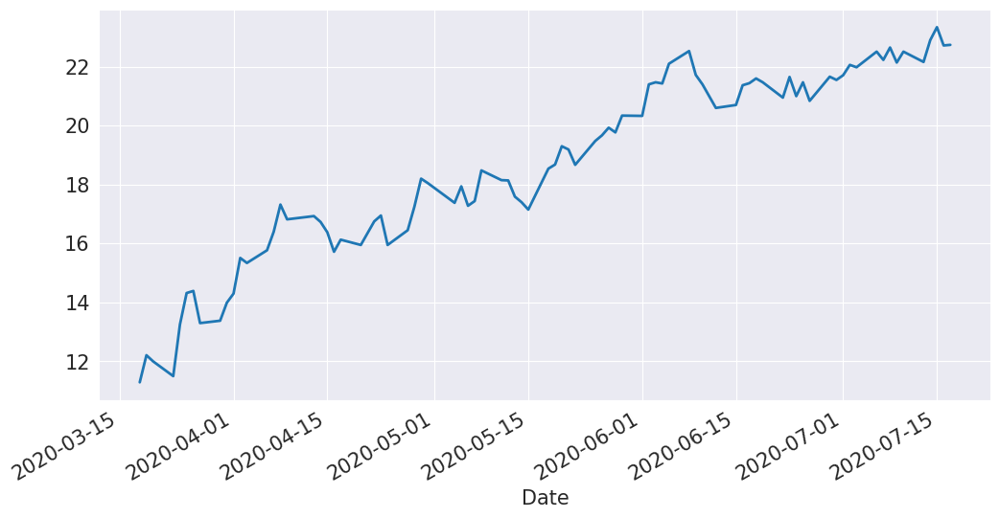

In [18]:
df['Close'].plot();

In [19]:
df.index

DatetimeIndex(['2020-03-18', '2020-03-19', '2020-03-20', '2020-03-23',
               '2020-03-24', '2020-03-25', '2020-03-26', '2020-03-27',
               '2020-03-30', '2020-03-31', '2020-04-01', '2020-04-02',
               '2020-04-03', '2020-04-06', '2020-04-07', '2020-04-08',
               '2020-04-09', '2020-04-13', '2020-04-14', '2020-04-15',
               '2020-04-16', '2020-04-17', '2020-04-20', '2020-04-22',
               '2020-04-23', '2020-04-24', '2020-04-27', '2020-04-28',
               '2020-04-29', '2020-04-30', '2020-05-04', '2020-05-05',
               '2020-05-06', '2020-05-07', '2020-05-08', '2020-05-11',
               '2020-05-12', '2020-05-13', '2020-05-14', '2020-05-15',
               '2020-05-18', '2020-05-19', '2020-05-20', '2020-05-21',
               '2020-05-22', '2020-05-25', '2020-05-26', '2020-05-27',
               '2020-05-28', '2020-05-29', '2020-06-01', '2020-06-02',
               '2020-06-03', '2020-06-04', '2020-06-05', '2020-06-08',
      

In [20]:
idx = pd.date_range(start=df.index.min(), end=df.index.max(), freq='B')
df = df.reindex(idx)
df.fillna(method='ffill', inplace=True)

In [21]:
df.index

DatetimeIndex(['2020-03-18', '2020-03-19', '2020-03-20', '2020-03-23',
               '2020-03-24', '2020-03-25', '2020-03-26', '2020-03-27',
               '2020-03-30', '2020-03-31', '2020-04-01', '2020-04-02',
               '2020-04-03', '2020-04-06', '2020-04-07', '2020-04-08',
               '2020-04-09', '2020-04-10', '2020-04-13', '2020-04-14',
               '2020-04-15', '2020-04-16', '2020-04-17', '2020-04-20',
               '2020-04-21', '2020-04-22', '2020-04-23', '2020-04-24',
               '2020-04-27', '2020-04-28', '2020-04-29', '2020-04-30',
               '2020-05-01', '2020-05-04', '2020-05-05', '2020-05-06',
               '2020-05-07', '2020-05-08', '2020-05-11', '2020-05-12',
               '2020-05-13', '2020-05-14', '2020-05-15', '2020-05-18',
               '2020-05-19', '2020-05-20', '2020-05-21', '2020-05-22',
               '2020-05-25', '2020-05-26', '2020-05-27', '2020-05-28',
               '2020-05-29', '2020-06-01', '2020-06-02', '2020-06-03',
      

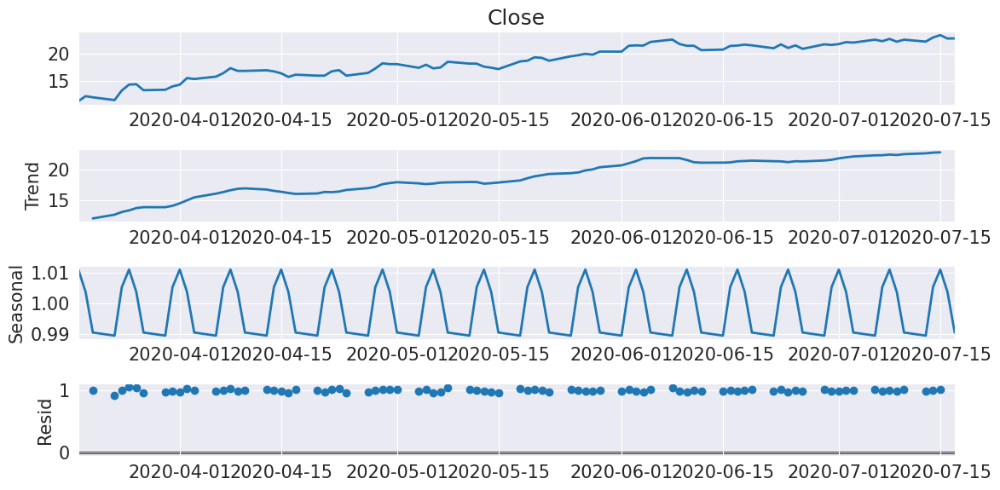

In [22]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot

result = seasonal_decompose(df['Close'], model='multiplicative', period=5)
result.plot()

pyplot.show()

In [23]:
from statsmodels.tsa.forecasting.theta import ThetaModel
tm = ThetaModel(df['Close'])
res = tm.fit()
print(res.summary())

                              ThetaModel Results                              
Dep. Variable:                  Close   No. Observations:                   88
Method:                       OLS/SES   Deseasonalized:                   True
Date:                Thu, 17 Aug 2023   Deseas. Method:         Multiplicative
Time:                        00:10:56   Period:                              5
Sample:                    03-18-2020                                         
                         - 07-17-2020                                         
  Parameter Estimates   
          Parameters    
------------------------
b0    0.1162118401588179
alpha 0.9125105052007179
------------------------


In [24]:
res = ThetaModel(df['Close'],deseasonalize=True,period=5).fit()
fcast = res.forecast(24)


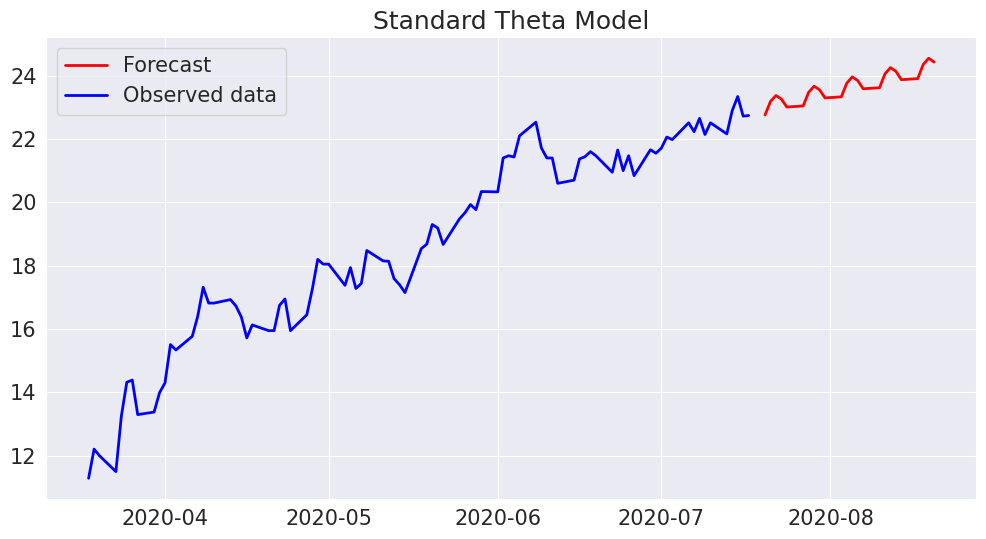

In [25]:
plt.figure(figsize = (12,6))

plt.plot(fcast,  color = 'red', label = 'Forecast')
plt.plot(df['Close'],color = 'blue', label = 'Observed data')


plt.title('Standard Theta Model')
plt.legend()
plt.show()

In [26]:
tm = ThetaModel(df['Close'], method="multiplicative")
res = tm.fit(use_mle=True)
print(res.summary())

                              ThetaModel Results                              
Dep. Variable:                  Close   No. Observations:                   88
Method:                           MLE   Deseasonalized:                   True
Date:                Thu, 17 Aug 2023   Deseas. Method:               Additive
Time:                        00:10:57   Period:                              5
Sample:                    03-18-2020                                         
                         - 07-17-2020                                         
  Parameter Estimates   
          Parameters    
------------------------
b0    0.1338257188850377
alpha 0.8208497367179584
------------------------


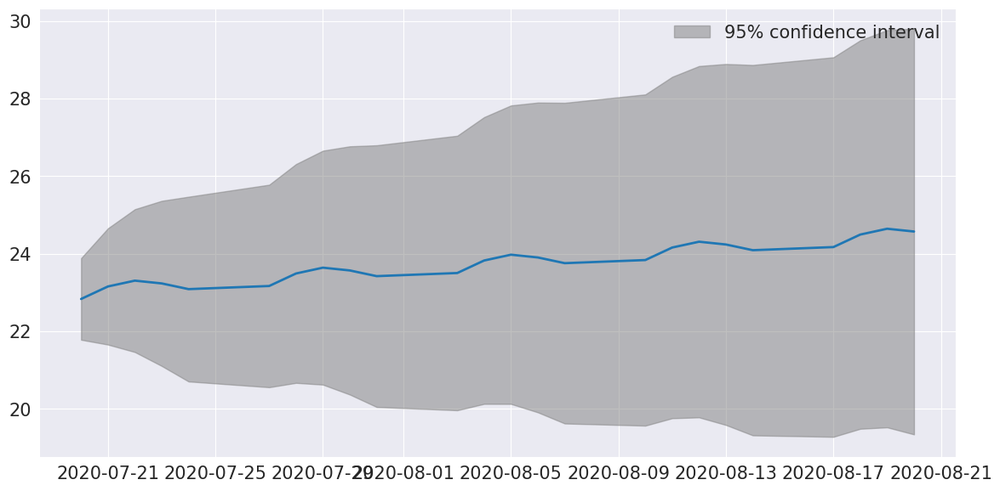

In [27]:
ax = res.plot_predict(24, theta=2)


**Exercício:** Calcule as métricas como erro quadrático médio, erro absoluto médio e raiz do erro quadrático médio para as previsões pontuais pelo método Theta.

<a id="section14"></a>
Aula 6: Exercícios


# Prática 6

***Aprendizado Dinâmico***

Nesta prática vamos comparar o Método Theta com o Método de Holt, visto na Aula 2, para previsões dos 30 próximos dias para os dados VALE3. Repita com janelas menores como 20 ou 10 dias.

**1. Carregue os pacotes que serão utilizados e faça a leitura dos dados, completando os dados faltantes como visto em aula.**

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.rc("figure",figsize=(12,6))
plt.rc("font",size=15)
plt.rc("lines",linewidth=2)
sns.set_style("darkgrid")

# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

**2. Carregue as bibliotecas e faça a leitura dos dados VALE3. Utilizaremos a variável Close.**

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/VALE3.csv', index_col=0, parse_dates=True)

idx = pd.date_range(start=df.index.min(), end=df.index.max(), freq='B')
df = df.reindex(idx)

df.fillna(method='ffill', inplace=True)

df.head()

,Open,High,Low,Close,Adj Close,Volume
2020-07-21,60.439999,60.480000,59.270000,59.700001,53.772350,29043600.0
2020-07-22,59.930000,60.250000,58.799999,59.240002,53.358028,19644700.0
2020-07-23,59.900002,60.160000,58.639999,58.849998,53.006744,17291900.0
2020-07-24,58.570000,58.849998,57.820000,58.599998,52.781574,22544100.0
2020-07-27,59.099998,61.630001,58.980000,61.369999,55.276535,35124800.0


In [3]:
df.index

DatetimeIndex(['2020-07-21', '2020-07-22', '2020-07-23', '2020-07-24',
               '2020-07-27', '2020-07-28', '2020-07-29', '2020-07-30',
               '2020-07-31', '2020-08-03',
               ...
               '2021-07-07', '2021-07-08', '2021-07-09', '2021-07-12',
               '2021-07-13', '2021-07-14', '2021-07-15', '2021-07-16',
               '2021-07-19', '2021-07-20'],
              dtype='datetime64[ns]', length=261, freq='B')

**3. Faça um gráfico da série.**

<Axes: >

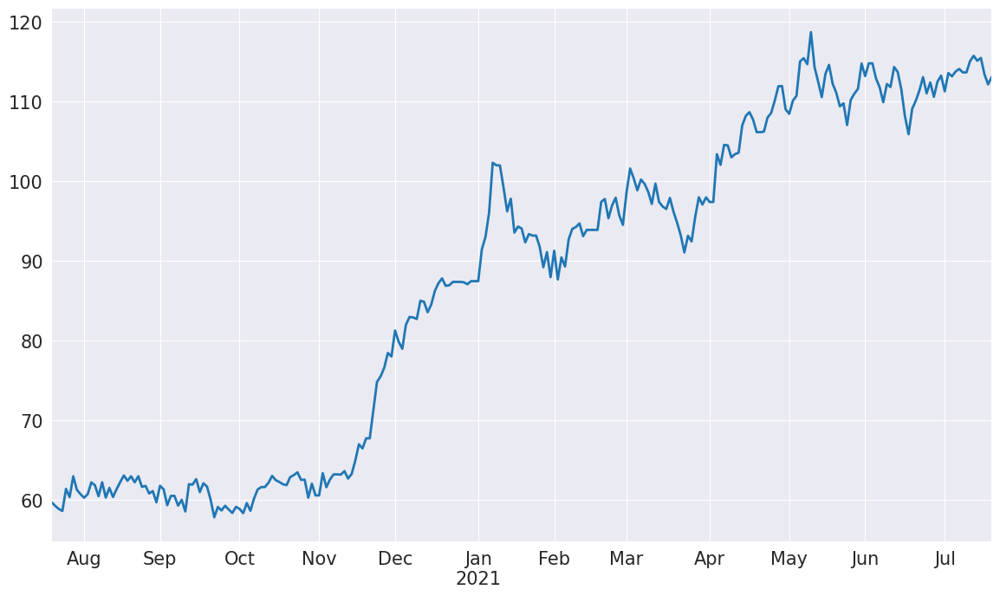

In [4]:
plt.rcParams['figure.figsize'] = [14,8]

df['Close'].plot()

**4. Defina bases de treino e teste, deixando 30 observações para a base de teste.**

In [5]:
treino = df.iloc[:-30]
teste = df.iloc[-30:]

**5. Faça uma decomposição da série em tendência, sazonalidade e resíduos. Qual o período de sazonalidade mais adequado?**

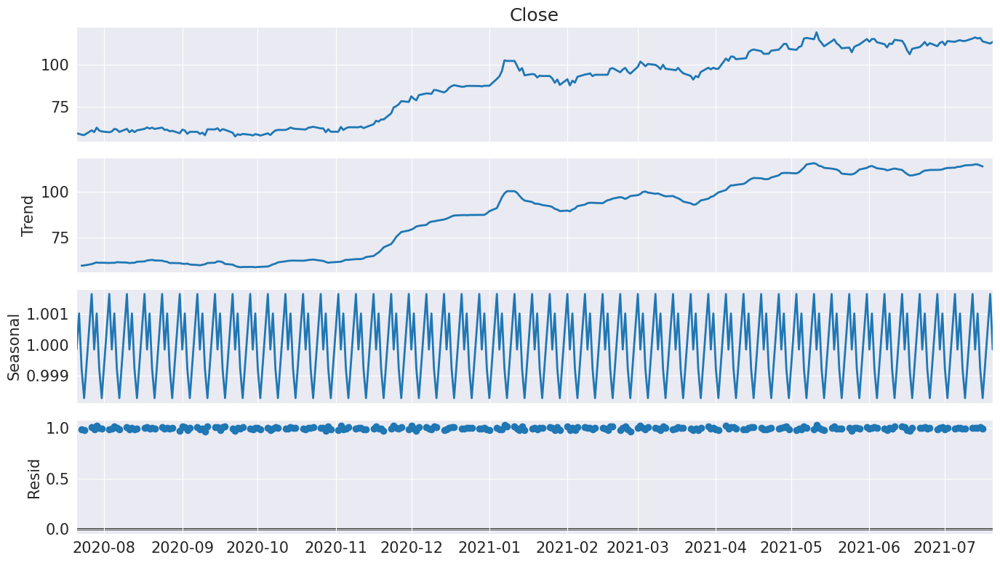

In [6]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot

result = seasonal_decompose(df['Close'], model='multiplicative', period=5)
result.plot()

pyplot.show()

**6. Obtenha as previsões pelo Método Theta.**

In [7]:
from statsmodels.tsa.forecasting.theta import ThetaModel
tm = ThetaModel(treino['Close'])
res = tm.fit()
print(res.summary())

                              ThetaModel Results                              
Dep. Variable:                  Close   No. Observations:                  231
Method:                       OLS/SES   Deseasonalized:                   True
Date:                Thu, 17 Aug 2023   Deseas. Method:         Multiplicative
Time:                        00:11:06   Period:                              5
Sample:                    07-21-2020                                         
                         - 06-08-2021                                         
  Parameter Estimates   
          Parameters    
------------------------
b0    0.2797856062015886
alpha 0.9204099294914058
------------------------


In [8]:
res = ThetaModel(treino['Close'],deseasonalize=True,period=5).fit()
fcast = res.forecast(30)

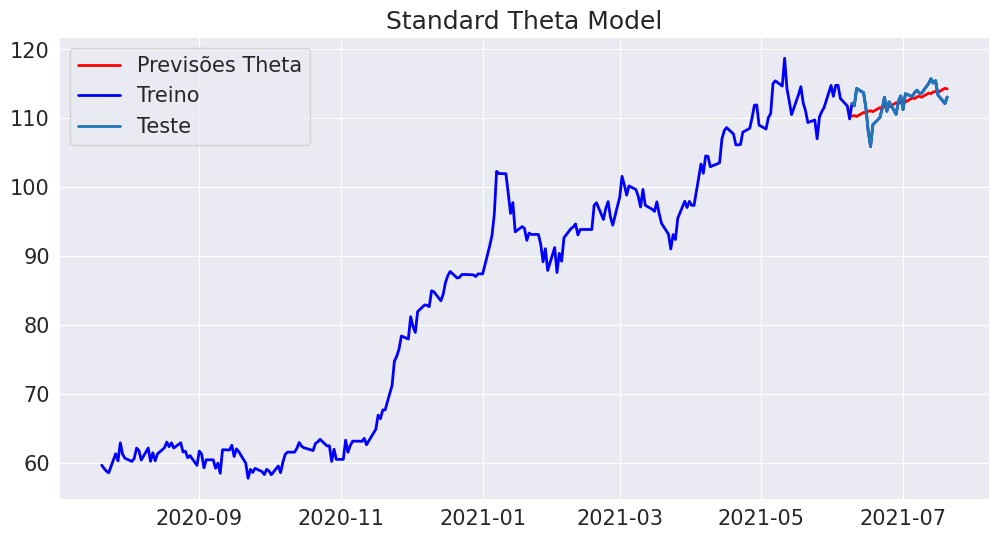

In [9]:
plt.figure(figsize = (12,6))

plt.plot(fcast,  color = 'red', label = 'Previsões Theta')
plt.plot(df['Close'],color = 'blue', label = 'Treino')
plt.plot(teste['Close'], label='Teste')

plt.title('Standard Theta Model')
plt.legend()
plt.show()

**7. Aplique o Método de Holt para os dados de teste e preveja as próximas 30 observações.**

In [10]:
# Método de Holt

from statsmodels.tsa.api import ExponentialSmoothing

modelo_H =  ExponentialSmoothing(treino['Close'], trend='add');

ajustado = modelo_H.fit();

df['Holt'] = ajustado.fittedvalues.shift(-1);

predito_H = ajustado.forecast(30).rename('Previsão Holt')




**8. Represente graficamente os resultados, com as bases de treino e teste.**

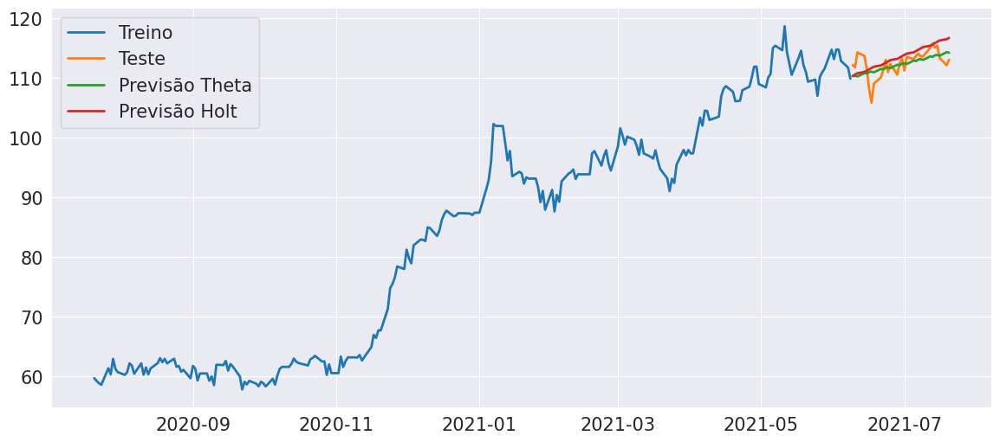

In [11]:
plt.figure(figsize = (14,6))

plt.plot(treino['Close'], label='Treino')
plt.plot(teste['Close'], label='Teste')
plt.plot(fcast, label='Previsão Theta')
plt.plot(predito_H, label='Previsão Holt')

plt.legend()
plt.show()


**9. Utilize o EQM para comparar as previsões. Qual o melhor método?**

In [12]:
from sklearn.metrics import mean_squared_error

error = mean_squared_error(teste['Close'], fcast)
print(f'EQM Theta: {error:11.10}')


error = mean_squared_error(teste['Close'], predito_H)
print(f'EQM Holt: {error:11.10}')

EQM Theta: 3.357431751
EQM Holt: 5.008868392


**11. Repita os procedimentos para obter previsões para dados futuros, ou seja, utilizando todos os dados disponíveis e fazendo previsões para os próximos 20 dias.**

In [13]:
# Método Theta

from statsmodels.tsa.forecasting.theta import ThetaModel

res = ThetaModel(df['Close'],deseasonalize=True,period=5).fit()
fcast = res.forecast(20)




In [14]:
# Método de Holt

from statsmodels.tsa.api import ExponentialSmoothing

modelo_H =  ExponentialSmoothing(df['Close'], trend='add');

ajustado = modelo_H.fit();

df['Holt'] = ajustado.fittedvalues.shift(-1);

predito_H = ajustado.forecast(20).rename('Previsão Holt')




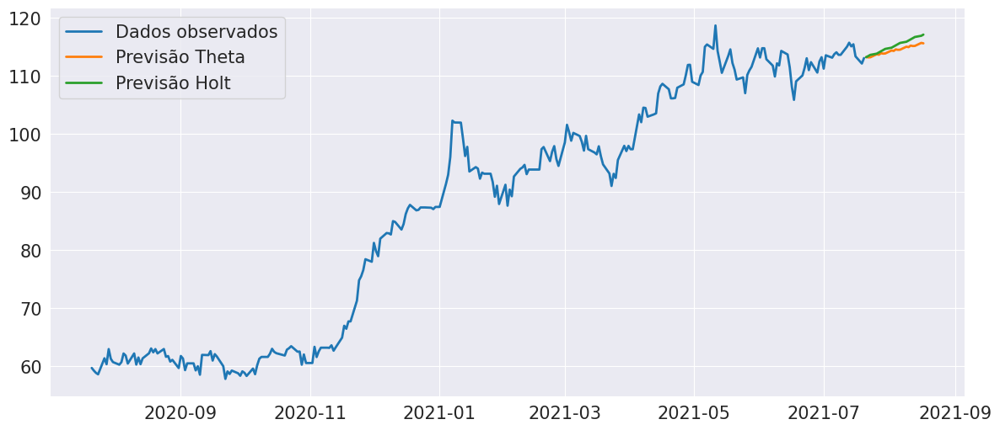

In [15]:
plt.figure(figsize = (14,6))


plt.plot(df['Close'], label='Dados observados')
plt.plot(fcast, label='Previsão Theta')
plt.plot(predito_H, label='Previsão Holt')

plt.legend()
plt.show()


**11. Retorne e mude o tamanho das bases de treino e teste, para por exemplo 10 ou 20 observações na amostra de teste. Os resultados são similares?**

<a id="section15"></a>
Aula 7: Redes dinâmicas

# Redes dinâmicas

-  Representação, manipulação e visualização

-  Caracterização de redes dinâmicas

-  Modelagem de redes dinâmicas

Baseado em

- KOLACZYK, E. D., CSÁRDI, G. Statistical Analysis of Network Data with R, Springer. 2014. Disponível em https://www.aguia.usp.br/ebooks/

- CHO, K., VAN MERRIËNBOER, B., GULCEHRE, C., BAHDANAU, D., BOUGARES, F., SCHWENK, H., & BENGIO, Y. Learning phrase representations using RNN encoder-decoder for statistical machine translation. 2014. arXiv preprint arXiv:1406.1078.

- HOCHREITER, S., & SCHMIDHUBER, J. Long short-term memory. Neural computation, 9(8), 1735-1780. 1997.

Implementações:

- https://www.tensorflow.org/guide/keras/rnn

- https://keras.io/api/layers/recurrent_layers/


Leituras e materiais adicionais recomendados:

- Data Science Academy. Deep Learning Book, 2022. Disponível em: <https://www.deeplearningbook.com.br/>. Acesso em: Agosto de 2022.

- https://otexts.com/fpp2/nnetar.html

- https://www.youtube.com/watch?v=aircAruvnKk

- https://www.youtube.com/watch?v=Ilg3gGewQ5U



## Representação, manipulação e visualização

Redes Neurais fornecem uma nova abordagem para a modelagem de dados e consequentemente para a previsão de séries temporais.


Inspiração na biologia: Dendritos são os numerosos prolongamentos dos neurônios que atuam na recepção de estímulos nervosos do ambiente ou de outros neurônios e na transmissão desses estímulos para o corpo da célula.






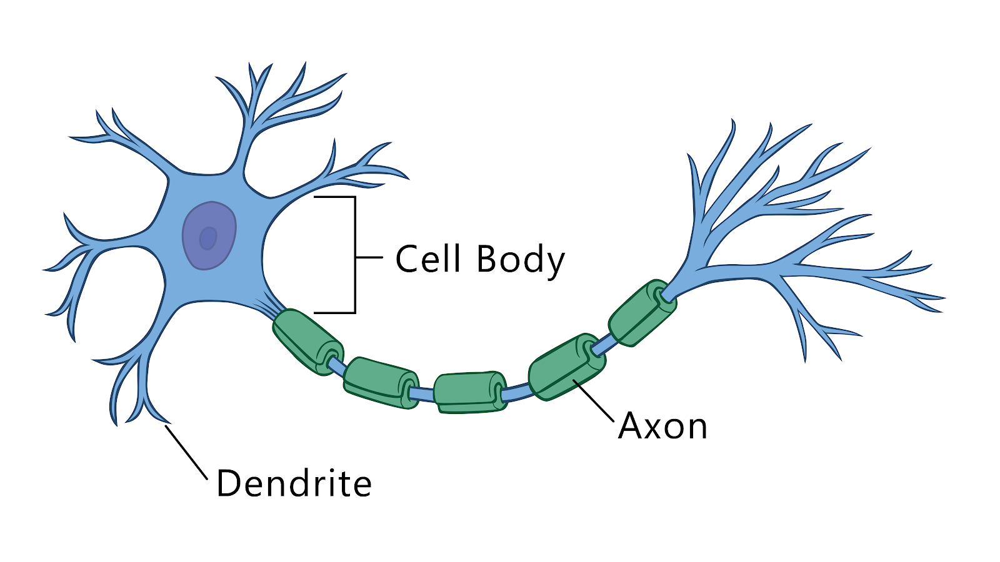
Fonte: https://www.thepartnershipineducation.com/resources/nervous-system





Podemos representar uma rede neural artificial com um único neurônio na forma de um perceptron, com duas entradas, uma saída, uma função de ativação e eventualmente um viés como abaixo.


Neurônios artificiais: perceptron

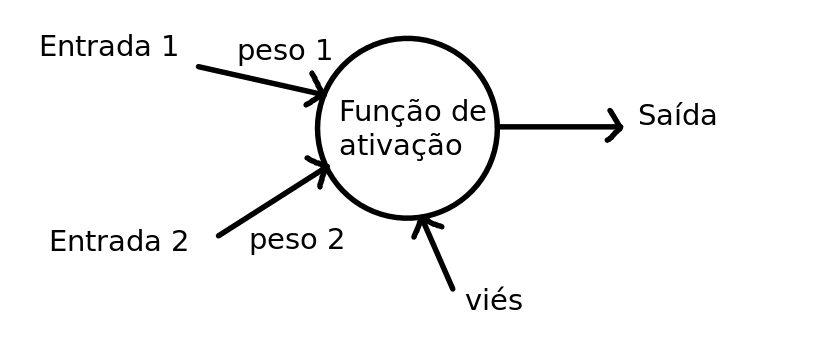




Já uma rede neural tem vários neurônios e camadas de entrada, saída e camadas escondidas, o que dá origem a uma rede neural artificial não linear:

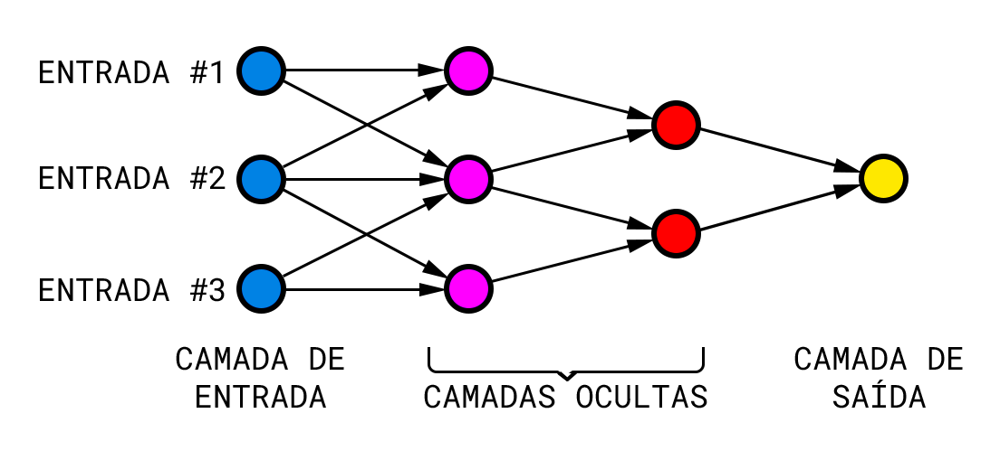




Cada camada de nós recebe entradas das camadas anteriores. As saídas dos nós em uma camada são entradas para a próxima camada. As entradas para cada nó são combinadas usando uma combinação linear ponderada. O resultado é então modificado por uma função não linear antes de ser produzido. Esse modelo é chamado de multilayer feed-forward network.


As entradas em um neurônio da primeria camada oculta são combinadas linearmente, por exemplo, da seguinte forma


$$z_j = b_j + \sum_{i=1}^{3}w_{i,j} x_{i}.$$


Então, na camada oculta, passam por uma função de ativação, por exemplo

$$s(z) = \displaystyle\frac{1}{1+e^{-z}}$$

e passam a ser entrada da próxima camada oculta, onde passarão por um procedimento similar e passarão para a camada de saída. Os parâmetros em cada passo são estimados de forma a minimizar, por exemplo, o erro quadrático médio.




Curiosidade: Site para visualizar algumas aplicações de redes neurais artificiais:

http://playground.tensorflow.org/

Mais sobre funções de ativação:

https://7-hiddenlayers.com/deep-learning-2/


### Redes Neurais Recorrentes (RNN)

Existem diversos tipos de redes neurais artificiais que podemos utilizar para a análise de dados de séries temporais. Algumas delas são as redes neurais recorrentes (RNN), que servem para modelar dados sequenciais, como séries temporais, dados que vem de arquivos de audio, trajetórias de carros, etc.

Para isso suponha um neurônio na multilayer feed-forward network, que permite que sua saída seja novamente uma entrada para si mesmo:

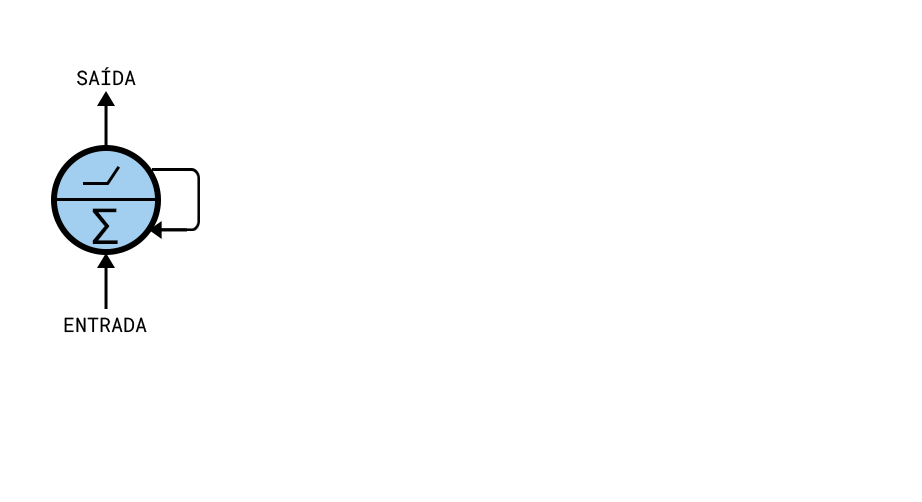




E então imagine que temos esse comportamento possível ao longo do tempo:

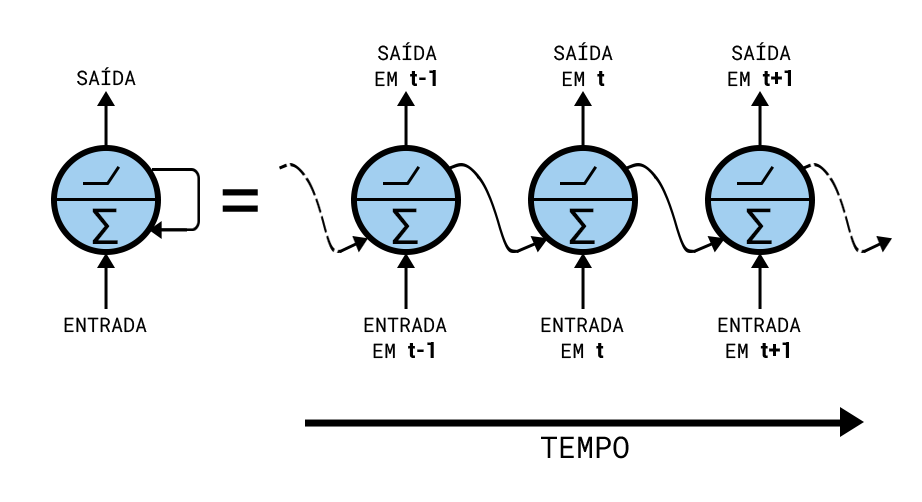

Dessa forma, poderíamos combinar as multilayers feed-forward networks sequencialmente. Note que existe uma espécie de memória, já que a estrutura do modelo se repete ao longo do tempo.


Algumas arquiteturas de RNN que estão implementadas no pacote Keras:

1. `keras.layers.SimpleRNN`, um RNN totalmente conectado, onde a saída do passo anterior no tempo deve ser alimentado para o próximo instante de tempo.

2. `keras.layers.GRU` (Gated recurrent unit) proposto por
[CHO et al., 2014](https://arxiv.org/abs/1406.1078).

3. `keras.layers.LSTM`, (Long Short Term Memory) proposto por
[HOCHREITER & SCHMIDHUBER, 1997](https://www.bioinf.jku.at/publications/older/2604.pdf).






## LSTM = Long Short-Term Memory


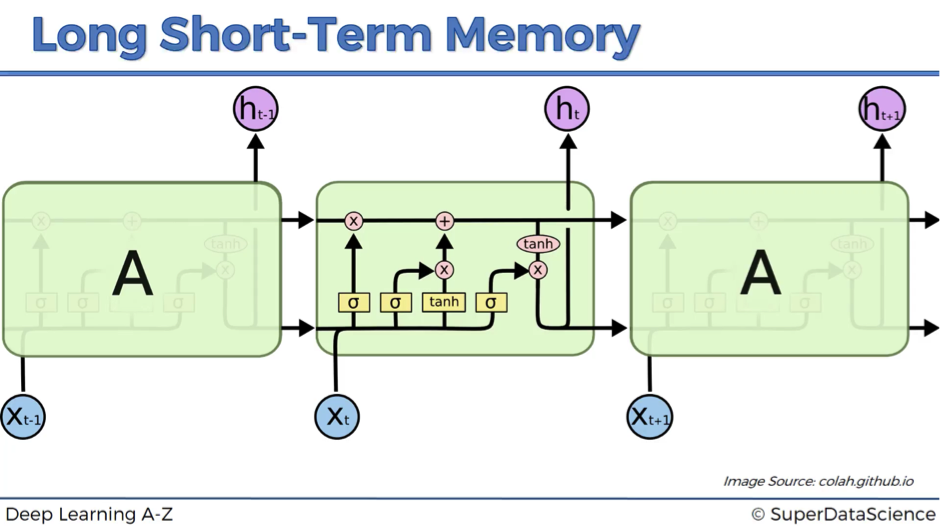


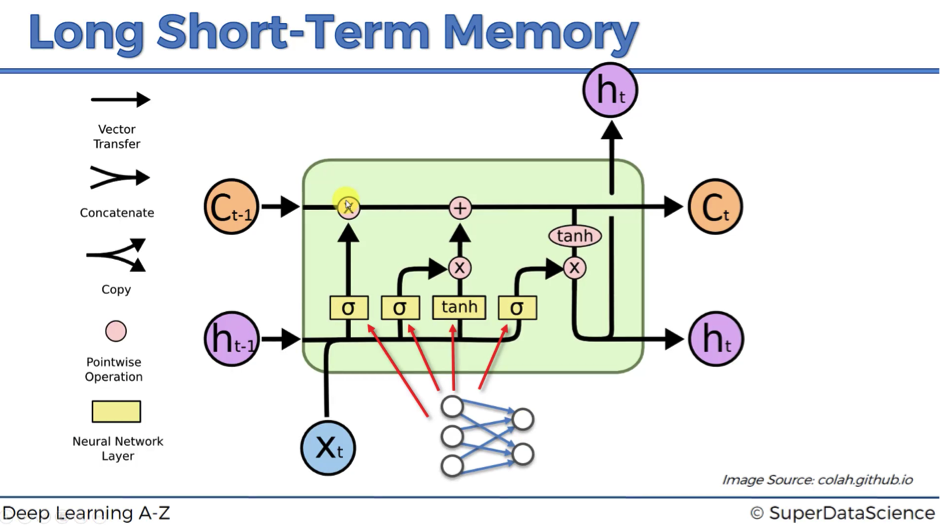

Fonte: https://www.superdatascience.com/blogs/recurrent-neural-networks-rnn-long-short-term-memory-lstm


Notação

- $c_{t-1}$ representa a entrada de uma célula de memória no momento $t$;

- $x_t$ é uma entrada no ponto de tempo $t$;

- $h_t$ é uma saída no ponto de tempo $t$ que vai para a camada de saída e a camada oculta no próximo ponto de tempo.



Assim, cada bloco tem três entradas $(x_t, h_{t-1} \mbox{ e } c_{t-1})$ e duas saídas $(h_t \mbox{ e } c_t)$. É importante observar que todas essas entradas e saídas não são valores únicos, mas vetores com muitos valores por trás de cada um deles.

Para mais informações, veja [HOCHREITER & SCHMIDHUBER, 1997](https://www.bioinf.jku.at/publications/older/2604.pdf), https://en.wikipedia.org/wiki/Long_short-term_memory e https://www.youtube.com/watch?v=8HyCNIVRbSU.




## GRU - Gated recurrent unit

É como o LSTM simplificado, não tem porta de esquecimento.

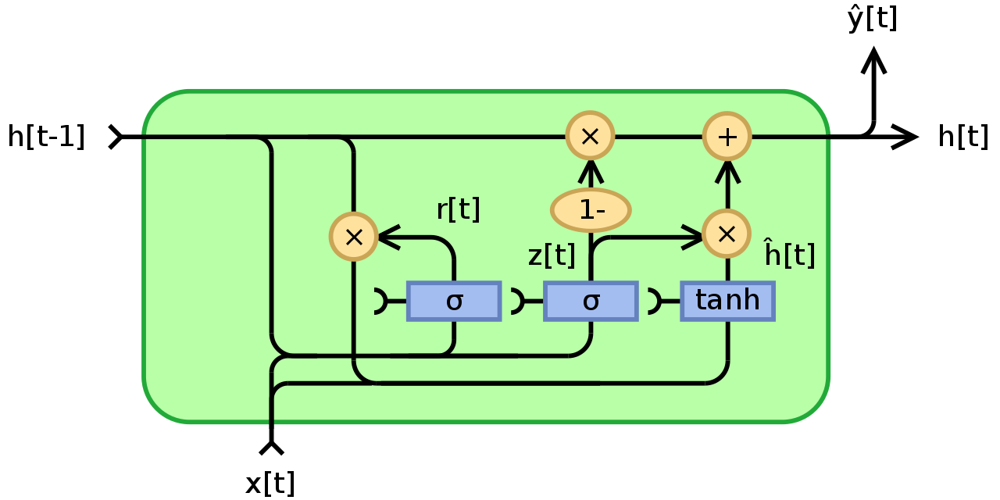


Fonte: https://en.wikipedia.org/wiki/Gated_recurrent_unit


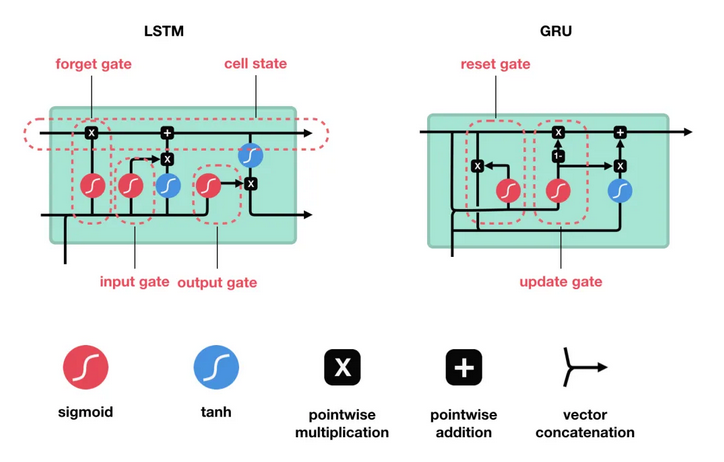


Fonte: http://deeplearningbook.com.br/arquitetura-de-redes-neurais-gated-recurrent-unit-gru/
        



Obs: Sobre o otimizador Adam (Adaptive Moment Estimation): https://keras.io/api/optimizers/adam/


## Modelagem de redes neurais artificiais


Começaremos com um exemplo mais simples e depois partiremos para a RNN.

In [1]:
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt

### Um modelo simples do tipo  y=mx+b+ruído

In [2]:
m = 3
b = 4
x = np.linspace(0,50,100)

np.random.seed(0)
ruído = np.random.normal(loc=0.0,scale=8.0,size=len(x))

(array([ 1.,  5.,  7., 13., 17., 18., 16., 11.,  7.,  5.]),
 array([-20.42391853, -16.56572297, -12.70752742,  -8.84933187,
         -4.99113632,  -1.13294077,   2.72525478,   6.58345034,
         10.44164589,  14.29984144,  18.15803699]),
 <BarContainer object of 10 artists>)

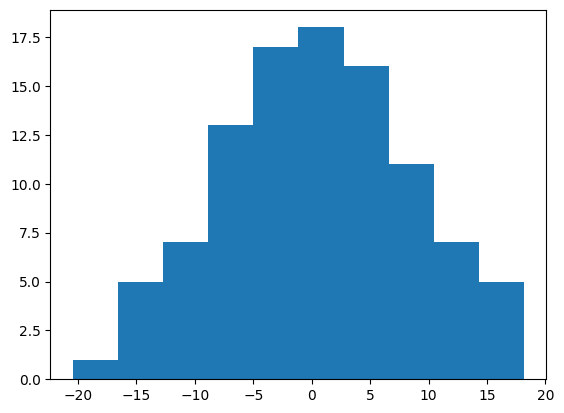

In [3]:
plt.hist(ruído)

In [4]:
y = m*x + b + ruído

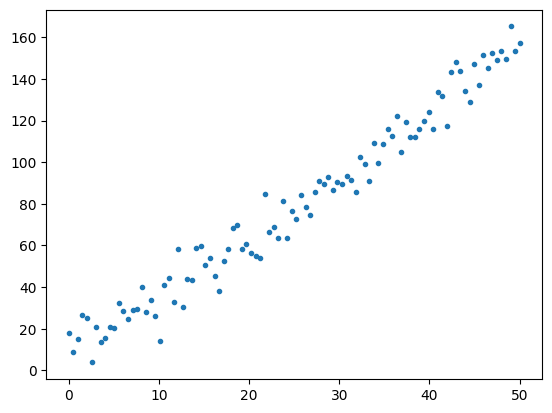

In [5]:
plt.plot(x,y,'.')

## Criação de uma rede neural para uma reta de melhor ajuste usando o pacote Keras



In [6]:
# https://keras.io/

# https://keras.io/guides/sequential_model/
# Otimizadores: https://keras.io/api/optimizers/

from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, Flatten, Dense


In [7]:
#Vamos criar um modelo com 3 camadas

model = Sequential()

# 4 neurônios, esperando apenas 1 recurso com input_dim = 1
model.add(Dense(4, input_dim=1, activation='relu'))

# 4 neurônios (modifique para ver o resultado)
model.add(Dense(4, activation='relu'))

# Uma saída final de y, então apenas 1 neurônio
model.add(Dense(1, activation='linear'))

# Compile as camadas
model.compile(loss='mse', optimizer='adam')

In [8]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 4)                 8         
                                                                 
 dense_1 (Dense)             (None, 4)                 20        
                                                                 
 dense_2 (Dense)             (None, 1)                 5         
                                                                 
Total params: 33
Trainable params: 33
Non-trainable params: 0
_________________________________________________________________


In [9]:
model.fit(x, y, epochs=500, verbose=0)

## Prever novos x pontos

Nosso x anterior era de 100 pontos de espaço entre 0 e 50. Vamos prever 1000 valores entre 0 e 50, desenhando uma linha para nossas previsões (nossa linha de melhor ajuste).




In [10]:
x_for_predictions = np.linspace(0,50,1000)

In [11]:
y_predicted = model.predict(x_for_predictions)

32/32 [==============================] - 0s 2ms/step


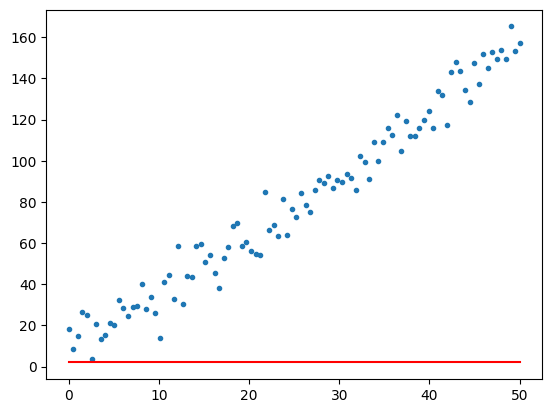

In [12]:
# X e Y originais
plt.plot(x,y,'.')

# Reta prevista
plt.plot(x_for_predictions,y_predicted,'r')

# Avaliação do erro

In [13]:
from sklearn.metrics import mean_squared_error,mean_absolute_error

In [14]:
prediction_for_true_y = model.predict(x)

4/4 [==============================] - 0s 3ms/step


In [15]:
mean_squared_error(y,prediction_for_true_y)

7924.96366930553

In [16]:
mean_absolute_error(y,prediction_for_true_y)

77.50960373647376

Como interpretar esse resultado? Depende da comparação com outros modelos!

## Modelagem de séries temporais usando o Keras



In [17]:
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt

<Axes: >

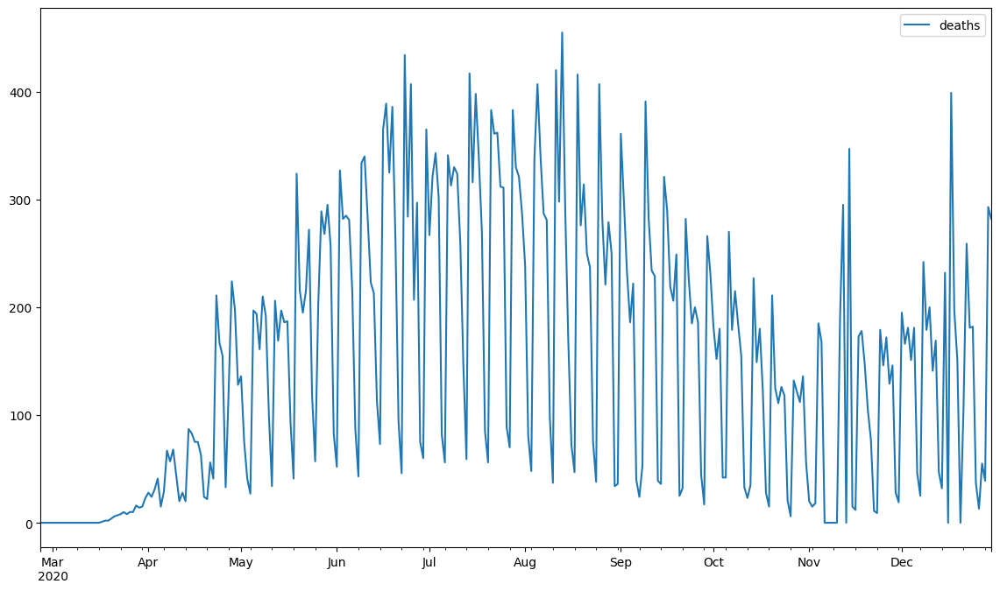

In [18]:
# Leitura dos dados de COVID-19 no estado de SP - vamos trabalhar com as mortes

df = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/covidSP.csv', index_col='date', parse_dates=True)
df = df.drop('confirmed', axis=1)

idx = pd.date_range(start=df.index.min(), end=df.index.max(), freq='D')
df = df.reindex(idx)
df.fillna(0,inplace=True)

df.plot(figsize=(14,8))

In [19]:
from statsmodels.tsa.seasonal import seasonal_decompose

<Axes: >

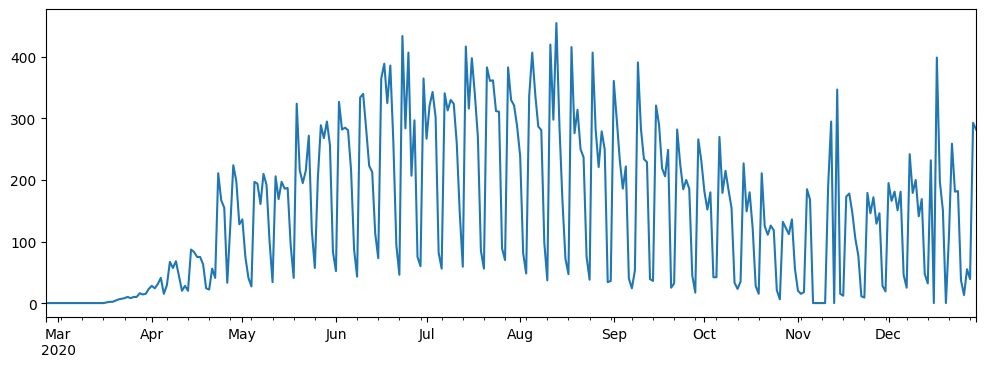

In [20]:
results = seasonal_decompose(df)
results.observed.plot(figsize=(12,4))

<Axes: >

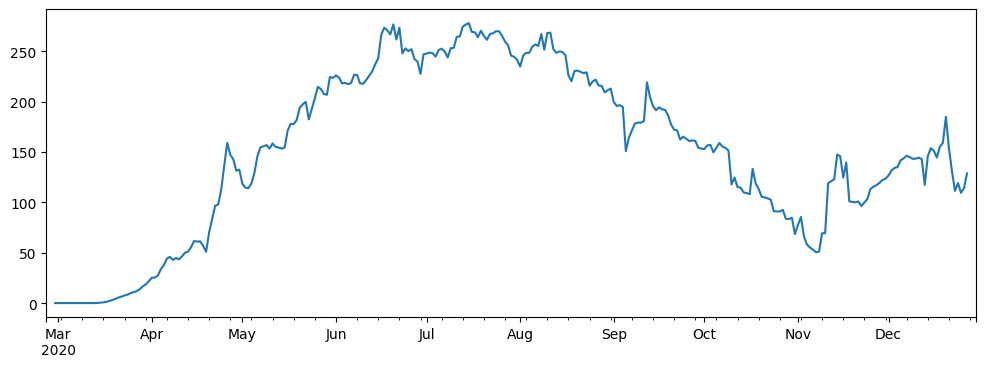

In [21]:
results.trend.plot(figsize=(12,4))

<Axes: >

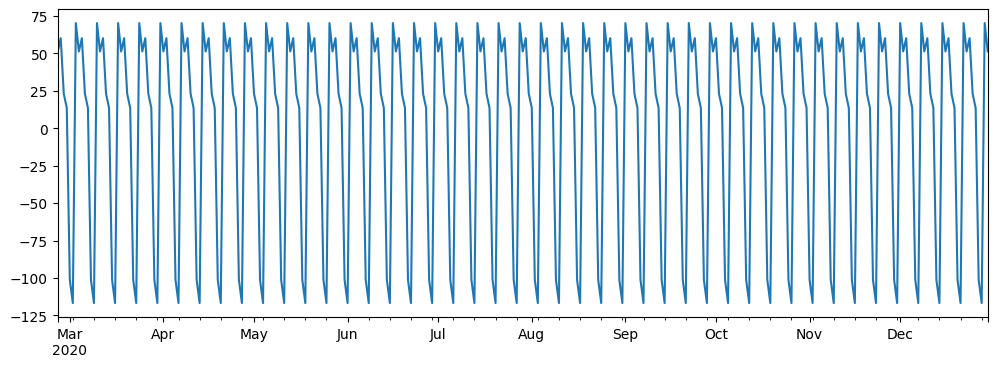

In [22]:
results.seasonal.plot(figsize=(12,4))

<Axes: >

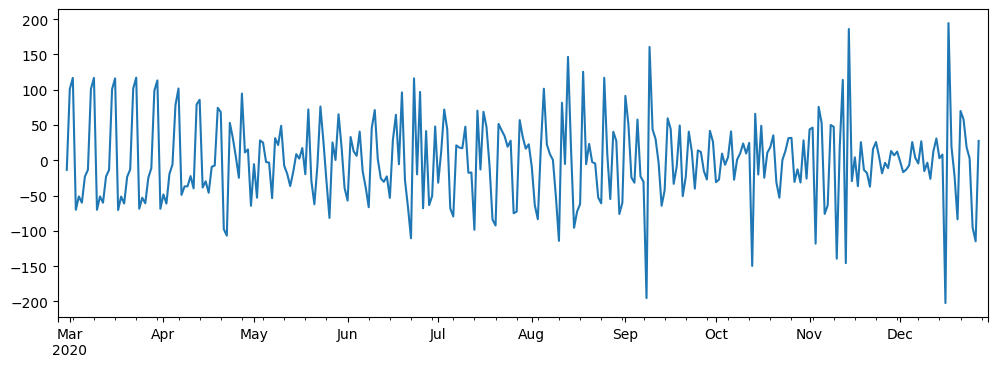

In [23]:
results.resid.plot(figsize=(12,4))

<Axes: >

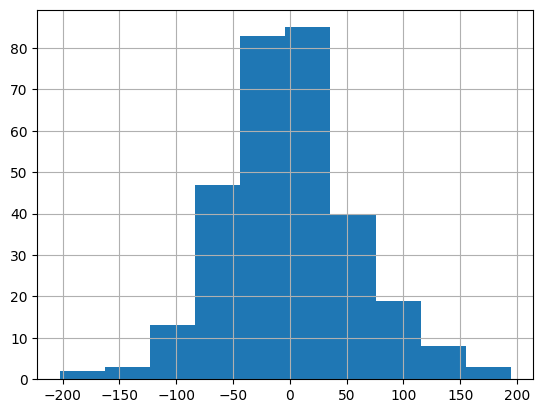

In [24]:
results.resid.hist()

In [25]:
results.resid[3:-3]

2020-02-29    -13.492784
2020-03-01    101.195528
2020-03-02    116.766428
2020-03-03    -70.157160
2020-03-04    -51.230250
                 ...    
2020-12-23     18.484036
2020-12-24      2.786361
2020-12-25    -95.439552
2020-12-26   -114.778498
2020-12-27     27.481242
Freq: D, Name: resid, Length: 303, dtype: float64

(array([-50, -49, -48, -47, -46, -45, -44, -43, -42, -41, -40, -39, -38,
        -37, -36, -35, -34, -33, -32, -31, -30, -29, -28, -27, -26, -25,
        -24, -23, -22, -21, -20, -19, -18, -17, -16, -15, -14, -13, -12,
        -11, -10,  -9,  -8,  -7,  -6,  -5,  -4,  -3,  -2,  -1,   0,   1,
          2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
         15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,
         28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,
         41,  42,  43,  44,  45,  46,  47,  48,  49,  50]),
 array([ 0.05147292,  0.10558197,  0.02456402,  0.02094992, -0.00508303,
        -0.12350632, -0.11313574,  0.09326685,  0.11719412,  0.01527039,
         0.00715515,  0.01812476, -0.20214146, -0.09846196,  0.06153716,
         0.31800958, -0.01863949,  0.00263982, -0.17358516, -0.0793992 ,
        -0.14344937,  0.1177344 ,  0.24922492,  0.08316567, -0.10884436,
        -0.08630931, -0.11395748, -0.1299904 ,  0.04088265,  0.3

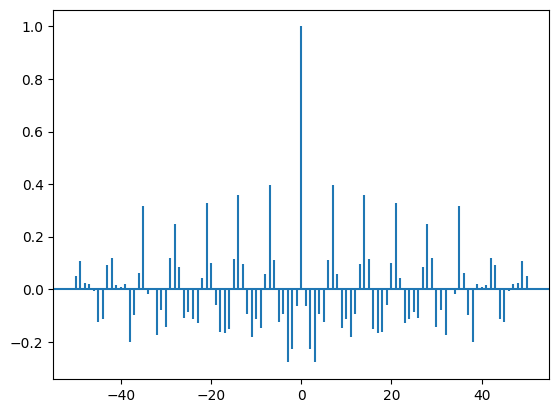

In [26]:
plt.acorr(results.resid.values[3:-3], maxlags = 50)

## Divida a base em treino e teste

In [27]:
len(df)-21


288

In [28]:
train = df.iloc[:-21]
test = df.iloc[-21:]

In [29]:
train.shape

(288, 1)

## Importante: Os dados precisam estar padronizados

In [30]:
from sklearn.preprocessing import MinMaxScaler

In [31]:
scaler = MinMaxScaler()

In [32]:
scaler.fit(train)

MinMaxScaler()

In [33]:
scaled_train = scaler.transform(train)
scaled_test = scaler.transform(test)

In [34]:
print(scaled_train.min(),scaled_train.max())

0.0 1.0


In [35]:
print(scaled_test.min(),scaled_test.max())

0.0 0.8769230769230769


(array([91., 34., 20., 25., 36., 19., 27., 20., 11.,  5.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

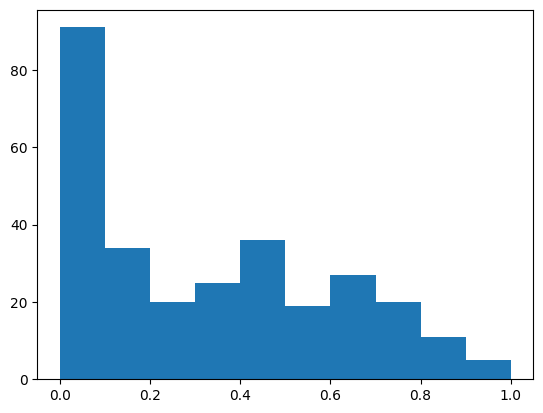

In [36]:
plt.hist(scaled_train)

### Gerador de séries temporais


In [37]:
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator

Sobre o gerador de séries temporais:
https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/sequence/TimeseriesGenerator

Utility class for generating batches of temporal data.

This class takes in a sequence of data-points gathered at equal intervals, along with time series parameters such as stride, length of history, etc., to produce batches for training/validation. Arguments

- data: Indexable generator (such as list or Numpy array) containing consecutive data points (timesteps). The data should be at 2D, and axis 0 is expected to be the time dimension.
    
- targets: Targets corresponding to timesteps in data. It should have same length as data.
    
- length: Length of the output sequences (in number of timesteps).
        
- sampling_rate: Period between successive individual timesteps within sequences. For rate r, timesteps data[i], data[i-r], ... data[i - length] are used for create a sample sequence.
    
- stride: Period between successive output sequences. For stride s, consecutive output samples would be centered around data[i], data[i+s], data[i+2*s], etc.
    
- start_index: Data points earlier than start_index will not be used in the output sequences. This is useful to reserve part of the data for test or validation.
    
- end_index: Data points later than end_index will not be used in the output sequences. This is useful to reserve part of the data for test or validation.
    
- shuffle: Whether to shuffle output samples, or instead draw them in chronological order.
    
- reverse: Boolean: if true, timesteps in each output sample will be in reverse chronological order.
    
- batch_size: Number of timeseries samples in each batch (except maybe the last one).
    


In [38]:
# defina o gerador
n_input = 2
n_features = 1
generator = TimeseriesGenerator(scaled_train, scaled_train, length=n_input, batch_size=1)

In [39]:
len(scaled_train)

288

In [40]:
len(generator) # n_input = 2

286

In [41]:
# Vamos redefinir lotes de tamanho 7 para o procedimento iterativo
# Veja mais informações sobre o tamanho do lote http://deeplearningbook.com.br/o-efeito-do-batch-size-no-treinamento-de-redes-neurais-artificiais/

n_input = 7
generator = TimeseriesGenerator(scaled_train, scaled_train, length=n_input, batch_size=128)

In [42]:
# Qual é a aparência do primeiro lote?
X,y = generator[0]


In [43]:
print(f'Dado o array: \n{X.flatten()}');
print(f'Previsão: \n {y}');

Dado o array: 
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.     

### Crie o modelo

In [44]:
### Pacote ideal do tensorflow = 2.5
### Pacote ideal do keras = 2.6
### Caso necessário, instale o pacote nessas versões

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import GRU

In [45]:
Sequential

keras.engine.sequential.Sequential

In [46]:
# Defina o modelo
model = Sequential()
model.add(LSTM(20, activation='relu', input_shape=(n_input, n_features)))
model.add(Dense(1, activation='sigmoid'))
model.compile(optimizer='adam', loss='mse')

In [47]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 20)                1760      
                                                                 
 dense_3 (Dense)             (None, 1)                 21        
                                                                 
Total params: 1,781
Trainable params: 1,781
Non-trainable params: 0
_________________________________________________________________


In [48]:
# Ajuste do modelo

model.fit(generator,epochs=250)

Epoch 1/250
3/3 [==============================] - 4s 24ms/step - loss: 0.0985
Epoch 2/250
3/3 [==============================] - 0s 14ms/step - loss: 0.0978
Epoch 3/250
3/3 [==============================] - 0s 13ms/step - loss: 0.0970
Epoch 4/250
3/3 [==============================] - 0s 13ms/step - loss: 0.0964
Epoch 5/250
3/3 [==============================] - 0s 13ms/step - loss: 0.0955
Epoch 6/250
3/3 [==============================] - 0s 18ms/step - loss: 0.0948
Epoch 7/250
3/3 [==============================] - 0s 23ms/step - loss: 0.0938
Epoch 8/250
3/3 [==============================] - 0s 20ms/step - loss: 0.0929
Epoch 9/250
3/3 [==============================] - 0s 17ms/step - loss: 0.0923
Epoch 10/250
3/3 [==============================] - 0s 20ms/step - loss: 0.0912
Epoch 11/250
3/3 [==============================] - 0s 17ms/step - loss: 0.0906
Epoch 12/250
3/3 [==============================] - 0s 12ms/step - loss: 0.0893
Epoch 13/250
3/3 [==============================]

In [49]:
model.history.history.keys()

dict_keys(['loss'])

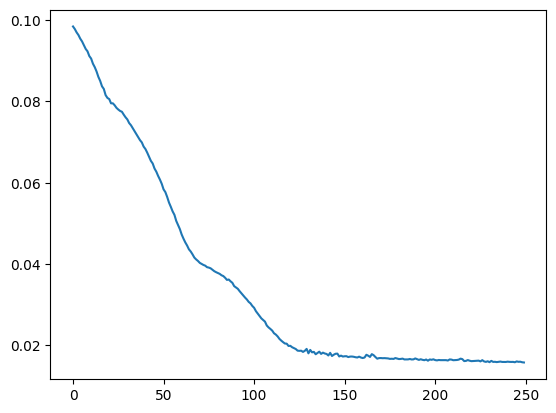

In [50]:
loss_per_epoch = model.history.history['loss']
plt.plot(range(len(loss_per_epoch)),loss_per_epoch)

## Avalie em dados de teste

In [51]:
# Vejamos passo a passo como é feita a previsão, a princípio para a próxima observação usando o tamanho do lote igual a 7

first_eval_batch = scaled_train[-7:]

In [52]:
first_eval_batch

array([[0.3978022 ],
       [0.33186813],
       [0.3978022 ],
       [0.1010989 ],
       [0.05494505],
       [0.53186813],
       [0.39340659]])

In [53]:
first_eval_batch = first_eval_batch.reshape((1, n_input, n_features))

In [54]:
model.predict(first_eval_batch)

1/1 [==============================] - 0s 176ms/step


array([[0.42912143]], dtype=float32)

In [55]:
scaled_test[0]

array([0.43956044])

In [56]:
test_predictions = []

first_eval_batch = scaled_train[-n_input:]
current_batch = first_eval_batch.reshape((1, n_input, n_features))

In [57]:
current_batch.shape

(1, 7, 1)

In [58]:
current_batch

array([[[0.3978022 ],
        [0.33186813],
        [0.3978022 ],
        [0.1010989 ],
        [0.05494505],
        [0.53186813],
        [0.39340659]]])

In [59]:
np.append(current_batch[:,1:,:],[[[99]]],axis=1)

array([[[3.31868132e-01],
        [3.97802198e-01],
        [1.01098901e-01],
        [5.49450549e-02],
        [5.31868132e-01],
        [3.93406593e-01],
        [9.90000000e+01]]])

In [60]:
# Agora vamos considerar as previsões para as próximas 21 observações e comparar com a base de teste

test_predictions = []

first_eval_batch = scaled_train[-n_input:]
current_batch = first_eval_batch.reshape((1, n_input, n_features))

for i in range(len(test)):

    # obter a previsão de tempo 1 antecipadamente ([0] é para pegar apenas o número em vez de [array])
    current_pred = model.predict(current_batch)[0]

    # predição
    test_predictions.append(current_pred)

    # atualize a rodada para agora incluir a previsão e descartar o primeiro valor
    current_batch = np.append(current_batch[:,1:,:],[[current_pred]],axis=1)

1/1 [==============================] - 0s 22ms/step


In [61]:
test_predictions

[array([0.42912143], dtype=float32),
 array([0.37252784], dtype=float32),
 array([0.36429405], dtype=float32),
 array([0.11437389], dtype=float32),
 array([0.13081677], dtype=float32),
 array([0.47071636], dtype=float32),
 array([0.43459508], dtype=float32),
 array([0.4457956], dtype=float32),
 array([0.40730044], dtype=float32),
 array([0.34538734], dtype=float32),
 array([0.1379494], dtype=float32),
 array([0.18741624], dtype=float32),
 array([0.4547036], dtype=float32),
 array([0.45519534], dtype=float32),
 array([0.45710245], dtype=float32),
 array([0.42955858], dtype=float32),
 array([0.33898684], dtype=float32),
 array([0.17251529], dtype=float32),
 array([0.24092735], dtype=float32),
 array([0.45573866], dtype=float32),
 array([0.4682335], dtype=float32)]

In [62]:
scaled_test

array([[0.43956044],
       [0.30989011],
       [0.37142857],
       [0.1032967 ],
       [0.07032967],
       [0.50989011],
       [0.        ],
       [0.87692308],
       [0.43296703],
       [0.33186813],
       [0.        ],
       [0.23516484],
       [0.56923077],
       [0.3978022 ],
       [0.4       ],
       [0.08131868],
       [0.02857143],
       [0.12087912],
       [0.08571429],
       [0.64395604],
       [0.61978022]])

## Retorno da padronização e comparação

In [63]:
true_predictions = scaler.inverse_transform(test_predictions)

In [64]:
true_predictions

array([[195.25025278],
       [169.50016618],
       [165.75379372],
       [ 52.04012111],
       [ 59.52163152],
       [214.17594254],
       [197.74076059],
       [202.83699602],
       [185.32170132],
       [157.15123951],
       [ 62.76698023],
       [ 85.27438946],
       [206.89013764],
       [207.11387858],
       [207.98161373],
       [195.44915169],
       [154.23901394],
       [ 78.49445604],
       [109.62194584],
       [207.36109197],
       [213.04624066]])

In [65]:
# Possivelmente encontraremos warnings aqui
test['Predictions'] = true_predictions

<ipython-input-65-b5be589fc0d6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['Predictions'] = true_predictions


<Axes: >

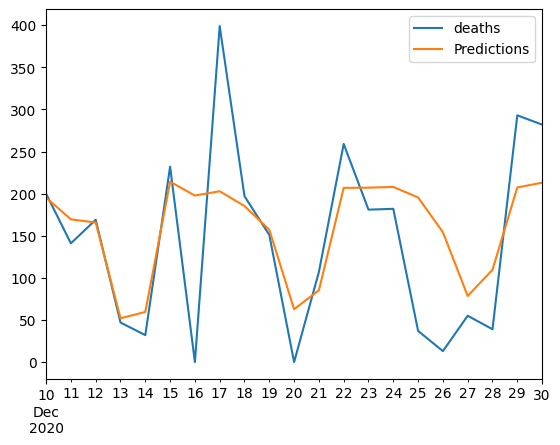

In [66]:
test.plot()

<Axes: >

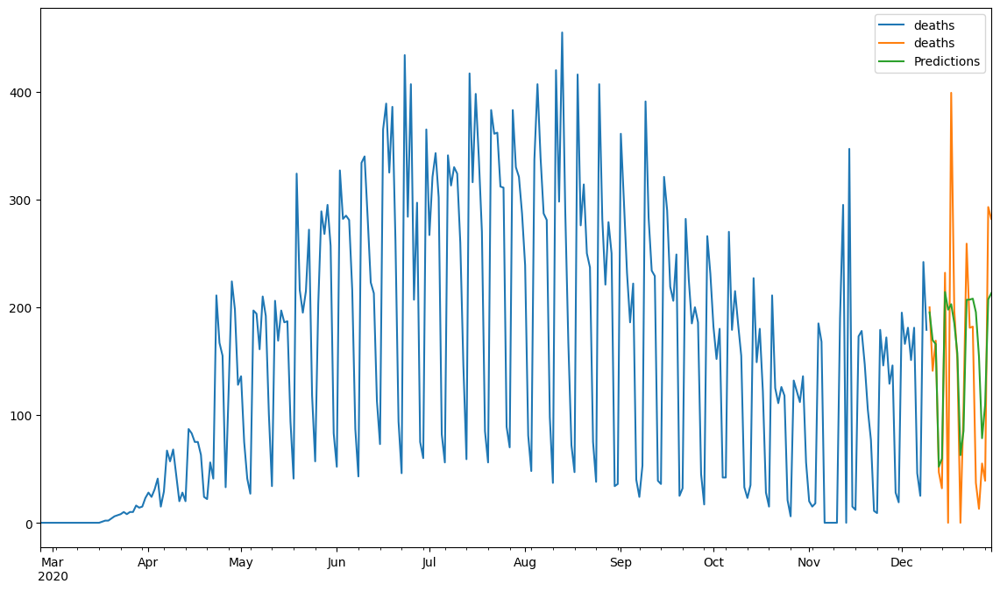

In [67]:
ax = train.plot(figsize=(14,8))
test.plot(ax=ax)

# Você pode salvar suas previsões

In [68]:
model.save('my_rnn_model.h5')

## E carregá-las depois

In [69]:
from tensorflow.keras.models import load_model
new_model = load_model('my_rnn_model.h5')

In [70]:
new_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 20)                1760      
                                                                 
 dense_3 (Dense)             (None, 1)                 21        
                                                                 
Total params: 1,781
Trainable params: 1,781
Non-trainable params: 0
_________________________________________________________________


Outras formas de modelagem de séries temporais usando redes neurais artificiais:

- https://ai.facebook.com/blog/ar-net-a-simple-autoregressive-neural-network-for-time-series/

- https://otexts.com/fpp2/nnetar.html



<a id="section16"></a>
Aula 7: Exercícios

# Prática 7

## Aprendizado Dinâmico

**1.Faça a leitura das bibliotecas.**

Nesta prática vamos considerar redes dinâmicas para modelar a temperatura global dos dados em globaltemp.

In [34]:
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt

**2. Leia os dados do arquivo globaltemp.csv.**

<Axes: xlabel='year'>

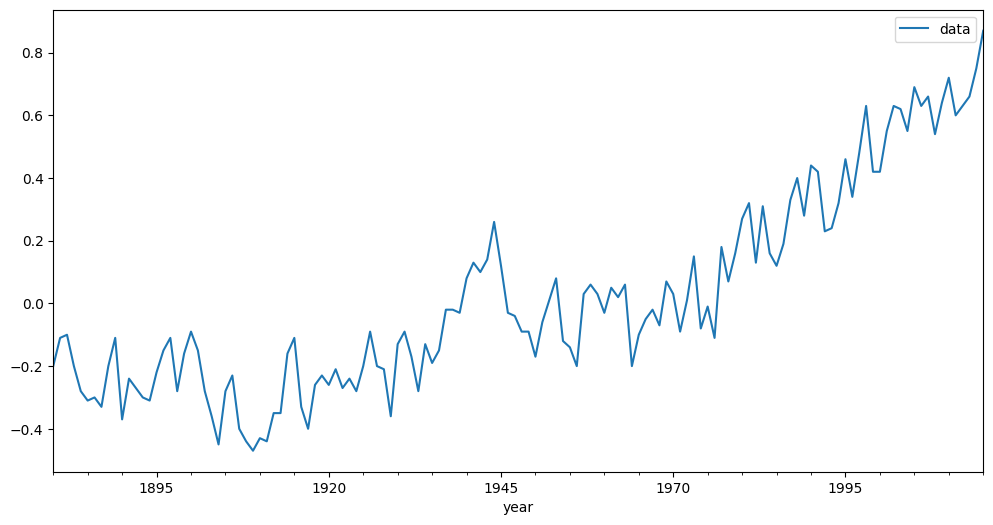

In [35]:
# Temperatura global

# Diferenças na média de temperatura global.
# Fonte: https://github.com/mjuez/pytsdatasets/

df = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/globaltemp.csv', index_col=0,parse_dates=True)
df.index = df.index
df.plot(figsize=(12,6))


In [36]:
df.head()

,data
year,
1880-01-01,-0.20
1881-01-01,-0.11
1882-01-01,-0.10
1883-01-01,-0.20
1884-01-01,-0.28


##

**3.  Divida a base em treino e teste, deixando 14 dias para a previsão.**

In [37]:
len(df)

136

In [38]:
len(df)-14


122

In [39]:
train = df.iloc[:122]
test = df.iloc[122:]

In [40]:
train

,data
year,
1880-01-01,-0.20
1881-01-01,-0.11
1882-01-01,-0.10
1883-01-01,-0.20
1884-01-01,-0.28
...,...
1997-01-01,0.48
1998-01-01,0.63
1999-01-01,0.42


**4. Padronize os dados para a modelagem.**

In [41]:
from sklearn.preprocessing import MinMaxScaler

In [42]:
scaler = MinMaxScaler()

In [43]:
scaler.fit(train)

MinMaxScaler()

In [44]:
scaled_train = scaler.transform(train)
scaled_test = scaler.transform(test)

**5. Considere o gerador de séries temporais, com variados valores para os parâmetros length e batch_size.**


In [45]:
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator

In [46]:
# defina o gerador
n_input = 2
n_features = 1
generator = TimeseriesGenerator(scaled_train, scaled_train, length=n_input, batch_size=1)

In [47]:
len(scaled_train)

122

In [48]:
len(generator) # n_input = 2

120

In [49]:
# Qual é a aparência do primeiro lote?
X,y = generator[0]

In [50]:
print(f'Dado o array: \n{X.flatten()}');
print(f'Previsão: \n {y}');

Dado o array: 
[0.24545455 0.32727273]
Previsão: 
 [[0.33636364]]


**6. Carregue as bibliotecas do keras para as redes dinâmicas.**

In [51]:
### Pacote ideal do tensorflow = 2.5
### Pacote ideal do keras = 2.6
### Caso necessário, instale o pacote nessas versões

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM

**7. Defina os lotes pra o processo iterativo.**

In [52]:
# Vamos redefinir lotes de tamanho 21 para o procedimento iterativo
# Veja mais informações sobre o tamanho do lote http://deeplearningbook.com.br/o-efeito-do-batch-size-no-treinamento-de-redes-neurais-artificiais/

n_input = 7
n_features = 1
generator = TimeseriesGenerator(scaled_train, scaled_train, length=n_input, batch_size=1)

**8. Defina o modelo. Ele pode ter uma camada LSTM e uma camada Dense. Teste alternativas.**

In [53]:
# Defina o modelo
model = Sequential()
model.add(LSTM(100, activation='relu', input_shape=(n_input, n_features)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

In [54]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 100)               40800     
                                                                 
 dense_1 (Dense)             (None, 1)                 101       
                                                                 
Total params: 40,901
Trainable params: 40,901
Non-trainable params: 0
_________________________________________________________________


**9. Faça o ajuste do modelo e observe a função de perda.**

In [55]:
# Ajuste do modelo

model.fit_generator(generator,epochs=100)

Epoch 1/100


<ipython-input-55-5e7daf52724a>:3: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model.fit_generator(generator,epochs=100)


115/115 [==============================] - 1s 3ms/step - loss: 0.0348
Epoch 2/100
115/115 [==============================] - 0s 3ms/step - loss: 0.0122
Epoch 3/100
115/115 [==============================] - 0s 3ms/step - loss: 0.0116
Epoch 4/100
115/115 [==============================] - 0s 3ms/step - loss: 0.0124
Epoch 5/100
115/115 [==============================] - 0s 4ms/step - loss: 0.0119
Epoch 6/100
115/115 [==============================] - 0s 3ms/step - loss: 0.0107
Epoch 7/100
115/115 [==============================] - 0s 4ms/step - loss: 0.0126
Epoch 8/100
115/115 [==============================] - 0s 3ms/step - loss: 0.0121
Epoch 9/100
115/115 [==============================] - 0s 3ms/step - loss: 0.0109
Epoch 10/100
115/115 [==============================] - 0s 3ms/step - loss: 0.0111
Epoch 11/100
115/115 [==============================] - 0s 3ms/step - loss: 0.0107
Epoch 12/100
115/115 [==============================] - 0s 3ms/step - loss: 0.0116
Epoch 13/100
115/115 [===

In [56]:
model.history.history.keys()

dict_keys(['loss'])

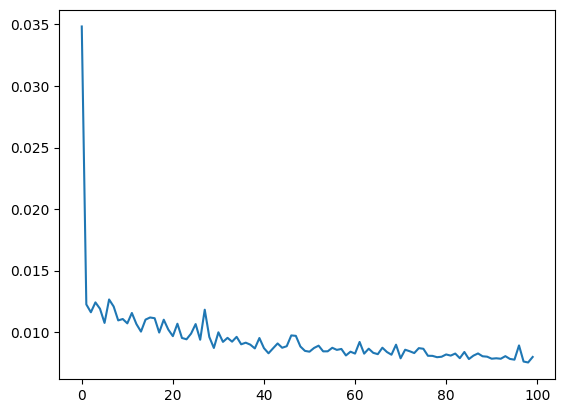

In [57]:
loss_per_epoch = model.history.history['loss']
plt.plot(range(len(loss_per_epoch)),loss_per_epoch)

**10. Faça a previsão.**

In [58]:
# Vejamos passo a passo como é feita a previsão, a princípio para a próxima observação usando o tamanho do lote igual a 7

first_eval_batch = scaled_train[-7:]

In [59]:
first_eval_batch

array([[0.84545455],
       [0.73636364],
       [0.86363636],
       [1.        ],
       [0.80909091],
       [0.80909091],
       [0.92727273]])

In [60]:
# Agora vamos considerar as previsões para as próximas 21 observações e comparar com a base de teste

test_predictions = []

first_eval_batch = scaled_train[-n_input:]
current_batch = first_eval_batch.reshape((1, n_input, n_features))

for i in range(len(test)):

    # obter a previsão de tempo 1 antecipadamente ([0] é para pegar apenas o número em vez de [array])
    current_pred = model.predict(current_batch)[0]

    # predição
    test_predictions.append(current_pred)

    # atualize a rodada para agora incluir a previsão e descartar o primeiro valor
    current_batch = np.append(current_batch[:,1:,:],[[current_pred]],axis=1)

1/1 [==============================] - 0s 16ms/step


In [61]:
test_predictions

[array([0.9873149], dtype=float32),
 array([0.9138474], dtype=float32),
 array([1.0244204], dtype=float32),
 array([1.1966966], dtype=float32),
 array([1.059008], dtype=float32),
 array([1.0468144], dtype=float32),
 array([1.171014], dtype=float32),
 array([1.2695563], dtype=float32),
 array([1.2309562], dtype=float32),
 array([1.3722911], dtype=float32),
 array([1.6165919], dtype=float32),
 array([1.5316643], dtype=float32),
 array([1.523441], dtype=float32),
 array([1.7016466], dtype=float32)]

In [62]:
scaled_test

array([[1.        ],
       [0.99090909],
       [0.92727273],
       [1.05454545],
       [1.        ],
       [1.02727273],
       [0.91818182],
       [1.00909091],
       [1.08181818],
       [0.97272727],
       [1.        ],
       [1.02727273],
       [1.10909091],
       [1.21818182]])

**11. Retorne da padronização.**

In [63]:
true_predictions = scaler.inverse_transform(test_predictions)

In [64]:
true_predictions

array([[0.61604637],
       [0.53523213],
       [0.65686242],
       [0.8463663 ],
       [0.6949088 ],
       [0.68149589],
       [0.81811535],
       [0.92651191],
       [0.88405182],
       [1.0395202 ],
       [1.30825112],
       [1.21483068],
       [1.20578505],
       [1.40181122]])

In [65]:
# Possivelmente encontraremos warnings aqui
test['Predictions'] = true_predictions

<ipython-input-65-b5be589fc0d6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['Predictions'] = true_predictions


**12. Visualize os resultados, comparando as previsões com a base de teste.**

<Axes: xlabel='year'>

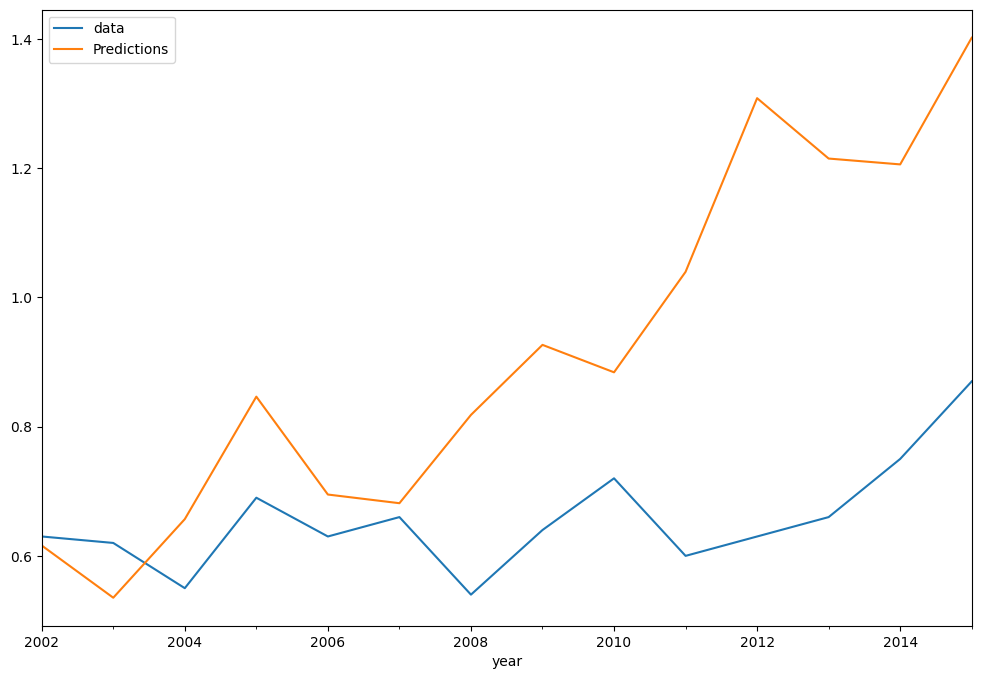

In [66]:

test.plot(figsize=(12,8))

<a id="section17"></a>
Aula 8: Análise de sobrevivência

# Análise de Sobrevivência

- Caracterização dos dados;
- Estimação não paramétrica;
- Funções de sobrevivências usuais;
- Modelos de regressão em análise de sobrevivência


Baseado em

- https://www.ime.usp.br/~lane/home/MCM5916/surv.pdf

- COLOSIMO, E. A. ; GIOLO, S. R. Análise de Sobrevivência Aplicada. Blucher, 2006.

- LOUZADA, F. ; MAZUCHELI, J. ; ACHCAR, J.A. . Análise de Sobrevivência e Confiabilidade. Lima, Peru: Instituto de Matematicas y Ciencias Afines, IMCA, 2002.

- [LEE, E. T., & WANG, J. Statistical methods for survival data analysis (Vol. 476). John Wiley & Sons. 2003](https://onlinelibrary.wiley.com/doi/pdf/10.1002/0471458546)

- [MOORE, D. F. Applied survival analysis using R. New York, NY: Springer. 2016.](https://link.springer.com/content/pdf/10.1007%2F978-3-319-31245-3.pdf)


Implementações:

- https://lifelines.readthedocs.io/en/latest/Survival%20Analysis%20intro.html





## Objetivos

- Estudar o tempo desde um instante inicial até a ocorrência de um evento (falha)


**Exemplo:**

- Estudar o tempo de sobrevida de um paciente a partir de um instante inicial após o primeiro AVC.


O que queremos saber?


**Probabilidade de Sobrevida**

$P(T > 100)$ = prob. de viver mais que 100 dias


**Taxa de falha**

Sem censura, a **taxa de falha** em um intervalo representa quantos falharam com relação a quantos estavam suscetíveis com relação à duração do intervalo.



## Censura

Poderia propor modelos como os de regressão e análise de variância para a variável resposta Tempo de vida

Mas se observei que um paciente viveu mais que 800 dias e não sei quando morreu, tenho que inclui-lo na análise!

O estudo terminou e não se observou a falha. A censura pode acontecer por diversos motivos:

- Perda de seguimento (follow up)

- Estudo acabou e o evento não foi observado

    - Paciente saiu do estudo (drop out)

- A pessoa sai do estudo por ocorrência de outro evento.

    - Ex: efeito colateral, transplante, óbito quando não for o evento de interesse
        
### Tipos de censura

- **Censura à direita**, a mais comum:

    - Tempo de sobrevida maior que o tempo observado $T \geq O$.
        
- **Censura à esquerda:**:

    - Follow up até pessoas serem contaminadas por coronavírus $T \leq O$

    - Fez teste em $t$ e deu positivo então sei que $T<t$.

- **Censura intervalar:** Só sei que $t_1 \leq T \leq t_2$: Fiz testes nos instantes t1 e t2


### Formas de descrever a censura

- **Aleatória**: Tempo de falha $(T)$ e de censura $(C)$ aleatórios e observamos $t=min(T,C)$.

- **Censura tipo I**: Estudo acaba após certo tempo e temos $r$ falhas e no final do estudo temos $n-r$ censuras.

- **Censura tipo II**: $r$ é fixado e só os menores $r$ tempos são observados e todos os outros tempos são censurados. O maior tempo observado é t(r).

- **Independente**: ocorrência dessa censura é independente do mecanismo que provoca a morte. E se a pessoa com melhor prognóstico sempre larga o estudo?

### Implementação em Python: Pacote lifelines

Exemplo adaptado de https://lifelines.readthedocs.io/en/latest/Survival%20Analysis%20intro.html

Considere uma amostra composta por dois tipos de cliente de um produto, A e B. O tipo A cancela o produto muito rapidamente, digamos em 2 meses em média, e o tipo B permanece por um tempo muito maior, digamos 12 meses em média. Não sabemos essa distinção de antemão. Em $t = 10$, desejamos investigar a expectativa de permanência média para todos os clientes com base nessa amostra.



In [1]:
!pip install lifelines

In [2]:
import lifelines
import matplotlib.pyplot as plt

from lifelines.plotting import plot_lifetimes
import numpy as np
from numpy.random import uniform, exponential

import random
random.seed(1)


In [3]:
# número de observações que serão geradas
N = 25

# tempo final do estudo
CURRENT_TIME = 10

# gera amostra
actual_lifetimes = np.array([
    exponential(12) if (uniform() < 0.5) else exponential(2) for i in range(N)
])
observed_lifetimes = np.minimum(actual_lifetimes, CURRENT_TIME)
death_observed = actual_lifetimes < CURRENT_TIME

actual_lifetimes

array([ 1.40746458,  0.16875699,  6.47372592,  1.47603304,  1.24007237,
        1.45140002,  3.34433116, 40.81535687,  8.07817531,  1.53246028,
       23.30024592,  2.55498531, 17.57870526,  0.69090473,  4.22131887,
       14.65959116, 22.51597224,  4.33442321,  6.05024321,  0.11214634,
       15.10679908,  0.29904073,  1.53583442,  0.22637216, 13.77650018])

In [4]:
observed_lifetimes

array([ 1.40746458,  0.16875699,  6.47372592,  1.47603304,  1.24007237,
        1.45140002,  3.34433116, 10.        ,  8.07817531,  1.53246028,
       10.        ,  2.55498531, 10.        ,  0.69090473,  4.22131887,
       10.        , 10.        ,  4.33442321,  6.05024321,  0.11214634,
       10.        ,  0.29904073,  1.53583442,  0.22637216, 10.        ])

In [5]:
observed_lifetimes[0:25]

array([ 1.40746458,  0.16875699,  6.47372592,  1.47603304,  1.24007237,
        1.45140002,  3.34433116, 10.        ,  8.07817531,  1.53246028,
       10.        ,  2.55498531, 10.        ,  0.69090473,  4.22131887,
       10.        , 10.        ,  4.33442321,  6.05024321,  0.11214634,
       10.        ,  0.29904073,  1.53583442,  0.22637216, 10.        ])

Tempo de permanência 10:
 [ 1.40746458  0.16875699  6.47372592  1.47603304  1.24007237  1.45140002
  3.34433116 10.          8.07817531  1.53246028 10.          2.55498531
 10.          0.69090473  4.22131887 10.         10.          4.33442321
  6.05024321  0.11214634 10.          0.29904073  1.53583442  0.22637216
 10.        ]


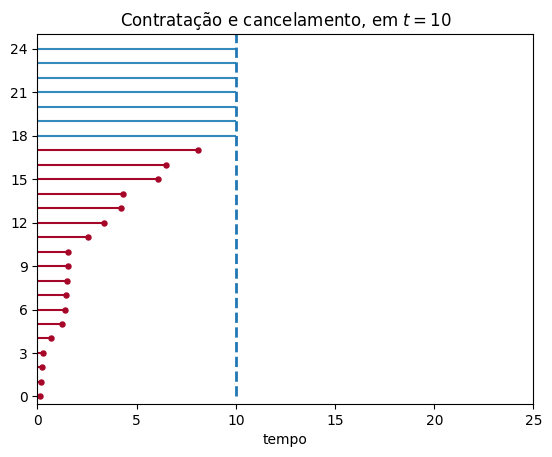

In [6]:
ax = plot_lifetimes(observed_lifetimes[0:25], event_observed=death_observed)

ax.set_xlim(0, 25)
ax.vlines(10, 0, 30, lw=2, linestyles='--')
ax.set_xlabel("tempo")
ax.set_title("Contratação e cancelamento, em $t=10$")
print("Tempo de permanência %d:\n" % (CURRENT_TIME), observed_lifetimes)

Na figura acima, as linhas vermelhas denotam o tempo de permanência dos indivíduos onde o evento de cancelamento do produto foi observada, e as linhas azuis indicam o tempo de permanência dos indivíduos censurados à direita (cancelamentos não foram observadas). Se queremos a estimar a média de vida de nossa população e ingenuamente decidirmos não incluir os indivíduos censurados à direita, é claro que estaríamos subestimando severamente a verdadeira média de vida.

Além disso, se, em vez disso, simplesmente pegássemos a média de todas as expectativas de permanência (vida), incluindo as atuais de instâncias censuradas à direita, ainda estaríamos subestimando a verdadeira média de permanência. Abaixo, plotamos as vidas úteis reais de todas as instâncias (lembre-se de que não vemos essa informação em $t = 10$).

(0.0, 32.0)

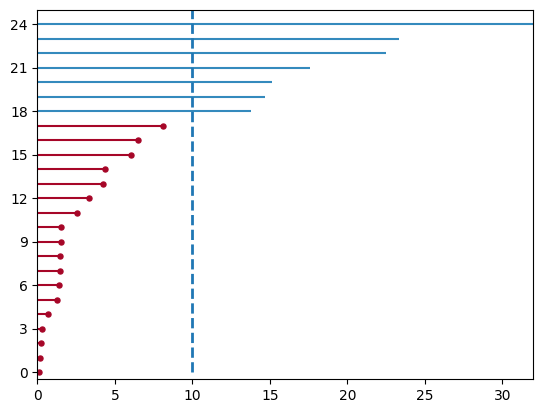

In [7]:
ax = lifelines.plotting.plot_lifetimes(durations=actual_lifetimes, event_observed=death_observed)
ax.vlines(10, 0, 30, lw=2, linestyles='--')
ax.set_xlim(0, 32)

In [8]:
len(actual_lifetimes)

25

## Função de sobrevivência

https://lifelines.readthedocs.io/en/latest/Survival%20Analysis%20intro.html#survival-function

https://en.wikipedia.org/wiki/Survival_function

    

### Função de sobrevivência

Seja $T$ um tempo de vida aleatório (possivelmente infinito, mas sempre não negativo) retirado da população em estudo. Por exemplo, quanto tempo um casal está casado. Ou o tempo que um usuário leva para entrar em uma página da Web (um tempo infinito, se isso nunca acontecer). A função de sobrevivência de uma população é definida como

$$S(t) = P(T>t)$$

A função de sobrevivência define a probabilidade de o evento de morte ainda não ter ocorrido no tempo t, ou equivalentemente, a probabilidade de sobreviver no tempo passado t.

#### Propriedades

1. $0\leq S(t) \leq 1$

2. $F_T(t)  = 1-S(t)$, em que $F_T(t) $ é a função distribuição acumulada de T, o que implica que

3. $S(t)$ é uma função não-crescente de $t$.


**Exemplo**




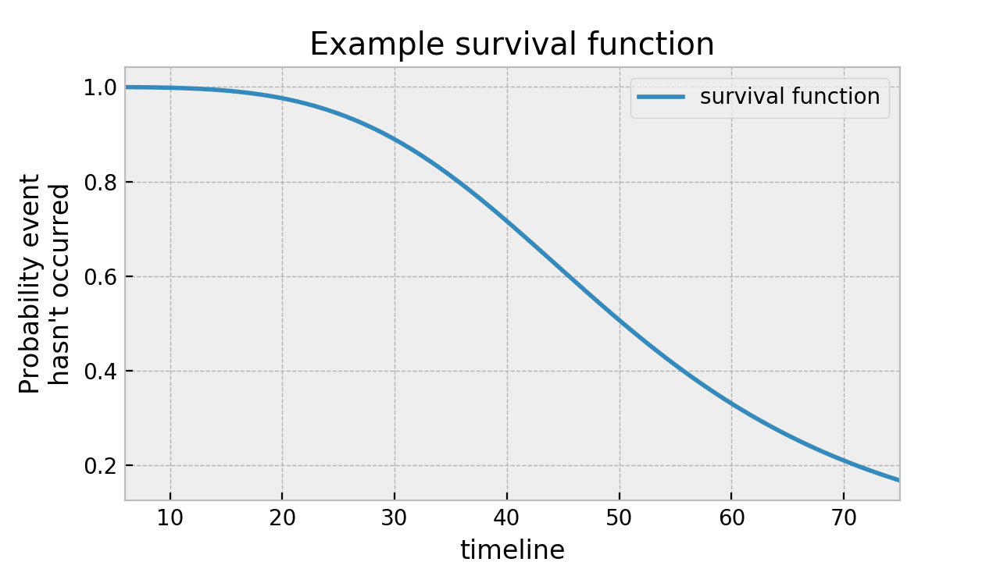

### Função de risco

Também estamos interessados na probabilidade do evento de morte ocorrer no tempo $t$, visto que o evento de óbito ainda não ocorreu.

Matematicamente, essa probabilidade é dada por

$$\lim_{\delta t \to 0} P(t\leq T \leq t+\delta t|T>t)$$

Essa quantidade vai para $0$ quando $\delta t$ diminui, então dividimos isso pelo intervalo $\delta t$ . Isso define a função de risco no tempo $t$, $h(t)$

$$h(t) = \lim_{\delta t \to 0} \displaystyle \frac{P(t\leq T \leq t+\delta t|T>t)}{\delta t}$$

Pode-se mostrar que isso é igual a:
$$h(t) =   \displaystyle \frac{-S'(t)}{S(t)}$$

e resolvendo essa equação diferencial, temos

$$S(t) = \exp \left(- \int_{0}^{1}h(z) dz \right)$$


A integral é chamada **função de risco cumulativo**, denotada $H(t)$, que pode ser reescrita como

$$S (t) = \exp(- H (t))$$


Com isso, as duas figuras abaixo representam o risco e o risco cumulativo, respectivamente, da função de sobrevivência na figura acima.



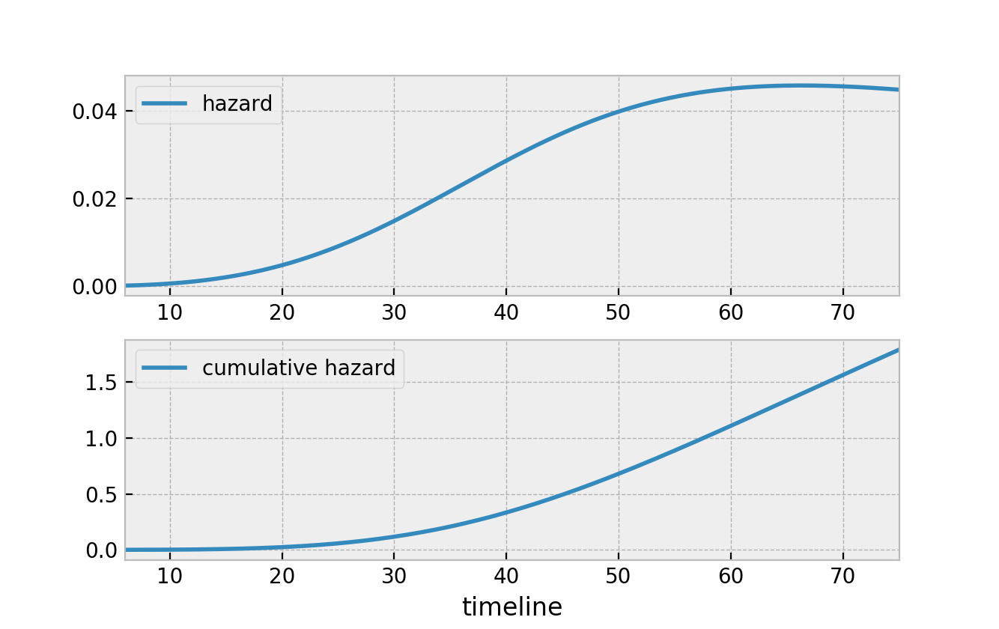

## Estimador de Kaplan-Meier

https://en.wikipedia.org/wiki/Kaplan%E2%80%93Meier_estimator



**Propriedades do estimador de Kaplan-Meier**

- Não viciado para amostras grandes

- Permite comparar curvas, mas não permite a inclusão de covariáveis

- É consistente

- Converge assintoticamente para um processo gaussiano

- É o estimador de máxima verossimilhança de S(t)



## Aplicação

Vamos considerar os dados Waltons disponíveis no pacote lifelines. Precisamos das durações pelas quais os indivíduos são observados e se eles 'morreram' ou não.

In [9]:
from lifelines.datasets import load_waltons
df = load_waltons() # returns a Pandas DataFrame

print(df.head(10))


T = df['T']
E = df['E']

      T  E    group
0   6.0  1  miR-137
1  13.0  1  miR-137
2  13.0  1  miR-137
3  13.0  1  miR-137
4  19.0  1  miR-137
5  19.0  1  miR-137
6  19.0  1  miR-137
7  26.0  1  miR-137
8  26.0  1  miR-137
9  26.0  1  miR-137


In [10]:
df.tail(20)


,T,E,group
143,45.0,1,control
144,45.0,0,control
145,45.0,1,control
146,53.0,1,control
147,53.0,1,control
148,53.0,1,control
149,53.0,1,control
150,53.0,1,control
151,60.0,1,control
152,60.0,0,control


<Axes: xlabel='timeline'>

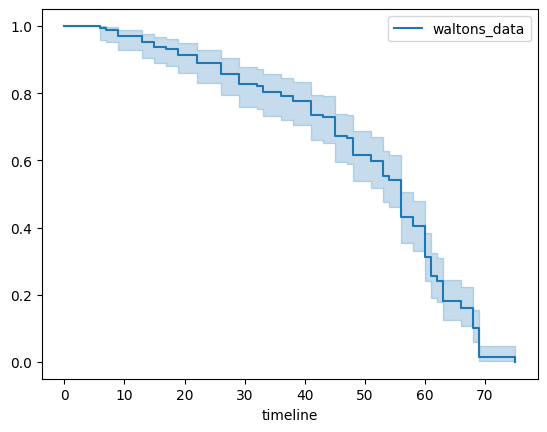

In [11]:
# Fonte https://lifelines.readthedocs.io/en/latest/fitters/univariate/KaplanMeierFitter.html
# Fonte dos dados: https://lifelines.readthedocs.io/en/latest/lifelines.datasets.html#lifelines.datasets.load_waltons

from lifelines import KaplanMeierFitter
from lifelines.datasets import load_waltons
waltons = load_waltons()

kmf = KaplanMeierFitter(label="waltons_data")
kmf.fit(waltons['T'], waltons['E'])
kmf.plot()



## Múltiplos grupos


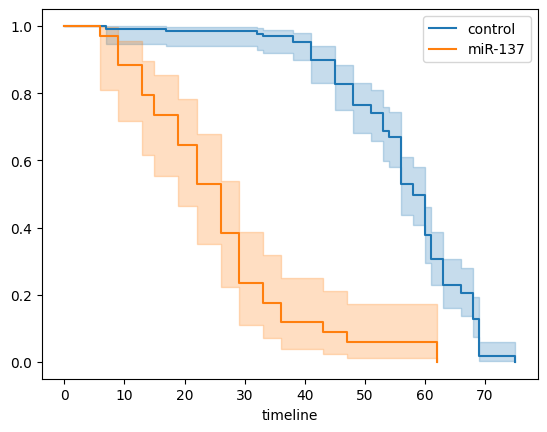

In [12]:
groups = df['group']
ix = (groups == 'miR-137')

kmf.fit(T[~ix], E[~ix], label='control')
ax = kmf.plot()

kmf.fit(T[ix], E[ix], label='miR-137')
ax = kmf.plot(ax=ax)

## Modelos paramétricos

O pacote lifelines possui modelos paramétricos integrados.

Por exemplo: Weibull, Log-Normal, Log-Logistic e outros.

<Axes: >

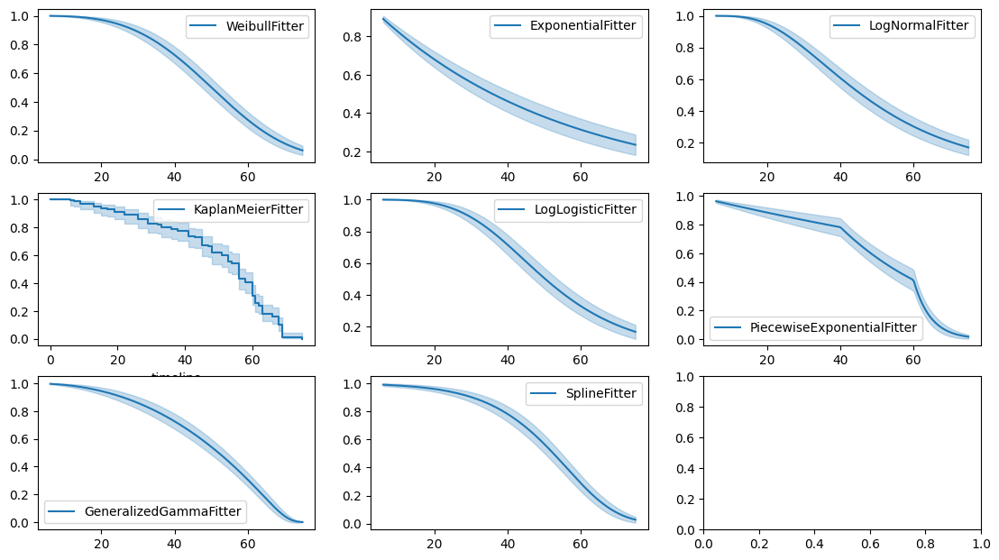

In [13]:
# Fonte: https://lifelines.readthedocs.io/en/latest/Survival%20analysis%20with%20lifelines.html#other-parametric-models-exponential-log-logistic-log-normal-and-splines
# Algumas referências adicionais:
#

import matplotlib.pyplot as plt
import numpy as np
from lifelines import *

fig, axes = plt.subplots(3, 3, figsize=(13.5, 7.5))

kmf = KaplanMeierFitter().fit(T, E, label='KaplanMeierFitter')
wbf = WeibullFitter().fit(T, E, label='WeibullFitter')
exf = ExponentialFitter().fit(T, E, label='ExponentialFitter')
lnf = LogNormalFitter().fit(T, E, label='LogNormalFitter')
llf = LogLogisticFitter().fit(T, E, label='LogLogisticFitter')
pwf = PiecewiseExponentialFitter([40, 60]).fit(T, E, label='PiecewiseExponentialFitter')
ggf = GeneralizedGammaFitter().fit(T, E, label='GeneralizedGammaFitter')
sf = SplineFitter(np.percentile(T.loc[E.astype(bool)], [0, 50, 100])).fit(T, E, label='SplineFitter')

wbf.plot_survival_function(ax=axes[0][0])
exf.plot_survival_function(ax=axes[0][1])
lnf.plot_survival_function(ax=axes[0][2])
kmf.plot_survival_function(ax=axes[1][0])
llf.plot_survival_function(ax=axes[1][1])
pwf.plot_survival_function(ax=axes[1][2])
ggf.plot_survival_function(ax=axes[2][0])
sf.plot_survival_function(ax=axes[2][1])

## Modelo de Cox

Leitura adicional: https://en.wikipedia.org/wiki/Proportional_hazards_model#The_Cox_model

- Modelo de riscos proporcionais

- Podem ser incluídas covariáveis

O risco no tempo t com variável explicativa X é

$$h(t|X) = h_0(t) \exp(\beta X)$$

Exemplo para X=1 se fuma e 0 se não fuma


$$h(t|X) = \left\{\begin{array}{c} h_0(t), \mbox{ para } X=0\\
 h_0(t)\exp(\beta ), \mbox{ para } X=1\\
\end{array}\right. $$


Os riscos são proporcionais e a razão entre os riscos é

$$\displaystyle  \frac{h(t|1)}{h(t|0)} = \exp(\beta)$$

Interpretação?

Para $p$ variáveis explicativas


$$h(t) = h_0(t) \exp(\sum_{i=1}^{p}\beta_i X_i)$$

In [14]:
from lifelines.datasets import load_regression_dataset
regression_dataset = load_regression_dataset() # a Pandas DataFrame
import pandas as pd
import numpy as np

from lifelines import CoxPHFitter

regression_dataset

,var1,var2,var3,T,E
0,0.595170,1.143472,1.571079,14.785652,1
1,0.209325,0.184677,0.356980,7.335846,1
2,0.693919,0.071893,0.557960,5.269797,1
3,0.443804,1.364646,0.374221,11.684092,1
4,1.613324,0.125566,1.921325,7.639492,1
...,...,...,...,...,...
195,0.137399,0.107748,0.354812,11.445457,1
196,0.637341,2.847188,1.459137,7.624627,1
197,1.109732,0.405561,0.018856,10.634620,1
198,0.031865,1.753759,0.252040,8.519718,1


<lifelines.CoxPHFitter: fitted with 200 total observations, 11 right-censored observations>
             duration col = 'T'
                event col = 'E'
      baseline estimation = breslow
   number of observations = 200
number of events observed = 189
   partial log-likelihood = -807.62
         time fit was run = 2023-08-26 18:14:16 UTC

---
            coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                         
var1        0.22       1.25       0.07             0.08             0.37                 1.08                 1.44
var2        0.05       1.05       0.08            -0.11             0.21                 0.89                 1.24
var3        0.22       1.24       0.08             0.07             0.37                 1.07                 1.44

            cmp to    z      p   -log2(p)
covariate                                
var1          0.00 2.99 <0.005       8.49
var2          0.00 0.61   0.54       0.89
var3          0.00 2.88 <0.005       7.97
---
Concordance = 0.58
Partial AIC = 1621.24
log-likelihood ratio test = 15.54 on 3 df
-log2(p) of ll-ratio test = 9.47

<Axes: xlabel='log(HR) (95% CI)'>

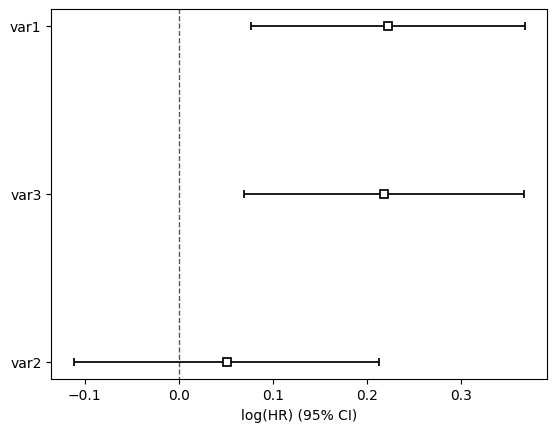

In [15]:
# Using Cox Proportional Hazards model
cph = CoxPHFitter()
cph.fit(regression_dataset, 'T', event_col='E')
cph.print_summary()


cph.plot()

O mesmo conjunto de dados, mas com um modelo de tempo de falha acelerado de Weibull.

Este modelo tinha dois parâmetros, e podemos escolher modelar ambos usando nossas covariáveis ou apenas uma.

Abaixo, modelamos apenas o parâmetro de escala, lambda.

<lifelines.WeibullAFTFitter: fitted with 200 total observations, 11 right-censored observations>
             duration col = 'T'
                event col = 'E'
   number of observations = 200
number of events observed = 189
           log-likelihood = -504.48
         time fit was run = 2023-08-26 18:14:17 UTC

---
                    coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
param   covariate                                                                                                         
lambda_ var1       -0.08       0.92       0.02            -0.13            -0.04                 0.88                 0.97
        var2       -0.02       0.98       0.03            -0.07             0.04                 0.93                 1.04
        var3       -0.08       0.92       0.02            -0.13            -0.03                 0.88                 0.97
        Intercept   2.53      12.57       0.05             2.43             2.63                11.41                13.85
rho_    Intercept   1.09       2.98       0.05             0.99             1.20                 2.68                 3.32

                    cmp to     z      p   -log2(p)
param   covariate                                 
lambda_ var1          0.00 -3.45 <0.005      10.78
        var2          0.00 -0.56   0.57       0.80
        var3          0.00 -3.33 <0.005      10.15
        Intercept     0.00 51.12 <0.005        inf
rho_    Intercept     0.00 20.12 <0.005     296.66
---
Concordance = 0.58
AIC = 1018.97
log-likelihood ratio test = 19.73 on 3 df
-log2(p) of ll-ratio test = 12.34

<Axes: xlabel='log(accelerated failure rate) (95% CI)'>

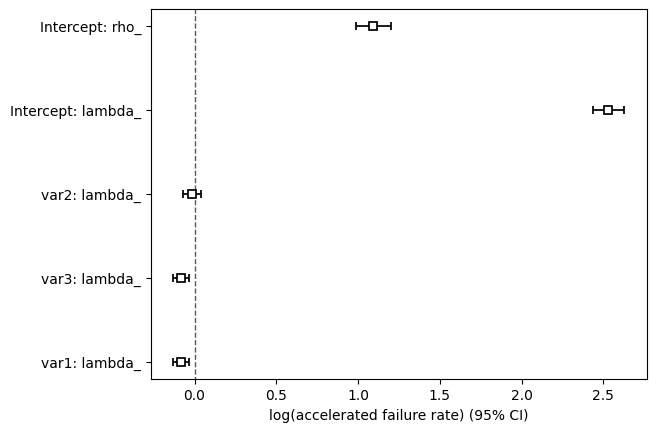

In [16]:
from lifelines import WeibullAFTFitter

wft = WeibullAFTFitter()
wft.fit(regression_dataset, 'T', event_col='E')
wft.print_summary()

wft.plot()

Um modelo de regressão alternativo é o modelo aditivo de Aalen, que tem riscos que variam com o tempo:

In [17]:
# Using Aalen's Additive model
from lifelines import AalenAdditiveFitter
aaf = AalenAdditiveFitter(fit_intercept=False)
aaf.fit(regression_dataset, 'T', event_col='E')

<lifelines.AalenAdditiveFitter: fitted with 200 total observations, 11 right-censored observations>

Junto com CoxPHFitter e WeibullAFTFitter, após o ajuste, você terá acesso a propriedades como resumo e métodos como plot, predict_cumulative_hazards e predict_survival_function.

Os dois últimos métodos requerem um argumento adicional de covariáveis:

<Axes: >

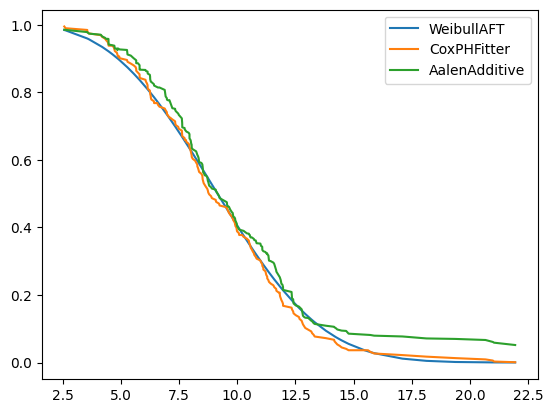

In [18]:
X = regression_dataset.loc[0]

ax = wft.predict_survival_function(X).rename(columns={0:'WeibullAFT'}).plot()
cph.predict_survival_function(X).rename(columns={0:'CoxPHFitter'}).plot(ax=ax)
aaf.predict_survival_function(X).rename(columns={0:'AalenAdditive'}).plot(ax=ax)



### Modelos de longa duração ou de fração de cura

Leitura recomendada:

- Granzotto, D. C. T. (2008). Seleção de modelos de tempos com longa-duração para dados de finanças. Dissertação de mestrado. UFSCar. Disponível em https://repositorio.ufscar.br/bitstream/handle/ufscar/4532/2168.pdf?sequence=1 Acessado em 28/08/2020.

- https://lifelines.readthedocs.io/en/latest/jupyter_notebooks/Modelling%20time-lagged%20conversion%20rates.html



Suponha que em nossa população tenhamos uma subpopulação que nunca experimentará o evento de interesse. Ou, para alguns assuntos, o evento ocorrerá tão longe no futuro que é essencialmente no tempo infinito. A função de sobrevivência não deve se aproximar assinticamente de zero, mas de algum valor positivo.

Os modelos que descrevem isso às vezes são chamados de modelos de fração cura (ou seja, o sujeito está "curado" da morte e, portanto, não é mais suscetível) ou modelos de conversão defasados no tempo.

Há uma falha séria em usar modelos paramétricos para esses tipos de problemas que os modelos não paramétricos não têm. Os modelos paramétricos mais comuns, como Weibull, Log-Normal, etc., todos têm funções de risco cumulativas estritamente crescentes, o que significa que a função de sobrevivência correspondente sempre convergirá para 0.

Vejamos um exemplo desse problema.

A seguir alguns dados que possuem indivíduos que não vivenciarão o evento, não importa o quanto esperemos. argumento adicional de covariáveis:

In [19]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from matplotlib import pyplot as plt
import autograd.numpy as np
from autograd.scipy.special import expit, logit
import pandas as pd
plt.style.use('bmh')


Text(0.5, 1.0, 'Survival function estimated by KaplanMeier')

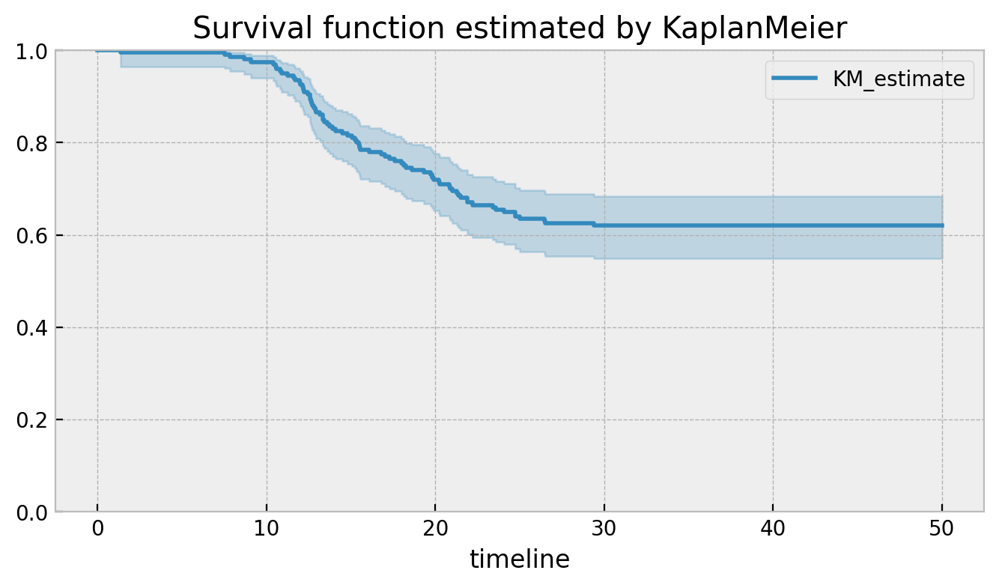

In [20]:

N = 200
U = np.random.rand(N)
T = -(logit(-np.log(U) / 0.5) - np.random.exponential(2, N) - 6.00) / 0.50

E = ~np.isnan(T)
T[np.isnan(T)] = 50

from lifelines import KaplanMeierFitter
kmf = KaplanMeierFitter().fit(T, E)
kmf.plot(figsize=(8,4))
plt.ylim(0, 1);
plt.title("Survival function estimated by KaplanMeier")



Deve ficar claro que existe uma assíntota em torno de 0,6. O modelo não paramétrico sempre mostrará isso. Se isso for verdade, a função de risco cumulativo também deve ter uma assíntota horizontal. Vamos usar o modelo Nelson-Aalen para ver isso.

Text(0.5, 1.0, 'Cumulative hazard estimated by NelsonAalen')

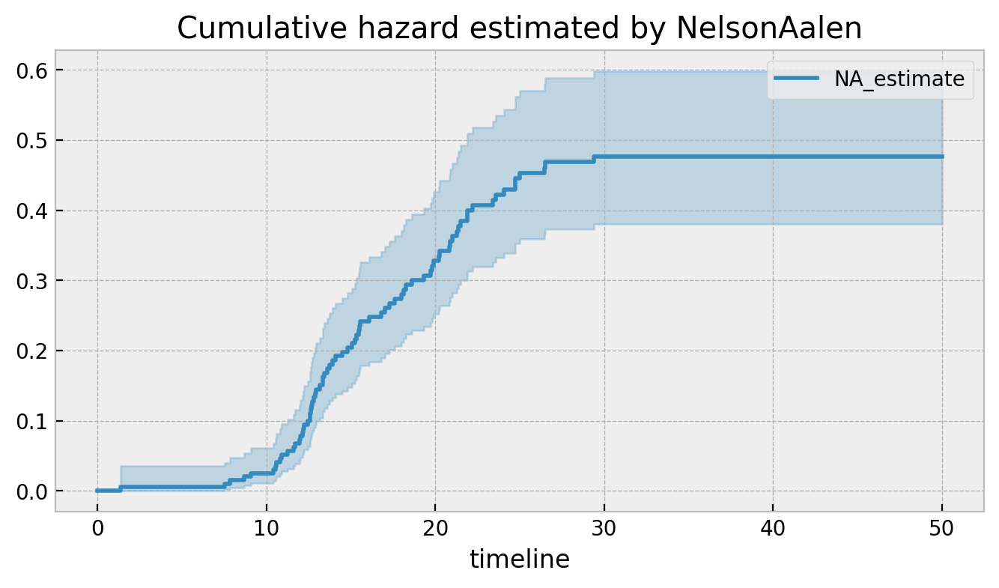

In [21]:
from lifelines import NelsonAalenFitter

naf = NelsonAalenFitter().fit(T, E)
naf.plot(figsize=(8,4))
plt.title("Cumulative hazard estimated by NelsonAalen")

No entanto, quando tentamos um modelo paramétrico, veremos que ele não extrapola muito bem. Vamos usar o modelo flexível de dois parâmetros LogLogisticFitter.

<Axes: xlabel='timeline'>

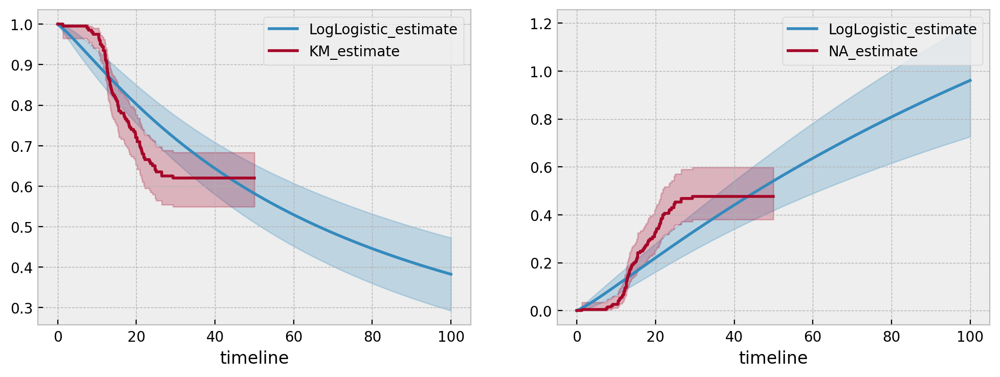

In [22]:
from lifelines import LogLogisticFitter

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 4))

t = np.linspace(0, 40)
llf = LogLogisticFitter().fit(T, E, timeline=t)

t = np.linspace(0, 100)
llf = LogLogisticFitter().fit(T, E, timeline=t)

llf.plot_survival_function(ax=ax[0])
kmf.plot(ax=ax[0])

llf.plot_cumulative_hazard(ax=ax[1])
naf.plot(ax=ax[1])



**Ver outros modelos em**

https://lifelines.readthedocs.io/en/latest/jupyter_notebooks/Modelling%20time-lagged%20conversion%20rates.html

<a id="section18"></a>
Aula 8: Exercícios

# Prática 8

Nesta prática vamos considerar um modelo de sobrevivência com covariáveis, especificamente um modelo de Cox.
Fonte: https://www.kaggle.com/bryanb/survival-analysis-with-cox-model-implementation

Deseja-se modelar o tempo até a morte de pacientes de câncer de mama em até 5 anos após uma cirurgia para a retirada de nódulos. Os dados são descritos no arquivo haberman.csv.

Descrição de dados

- Age: Idade do paciente no momento da operação;
- Operation_year: ano de operação do paciente (ano - 19XX);
- Nb_pos_detected: Número de nódulos axilares positivos detectados;
- Surv: Status de sobrevivência (atributo de classe) 1 = o paciente sobreviveu 5 anos ou mais 2 = o paciente morreu dentro de 5 anos;

Desenvolva um estudo com modelo de sobrevivência incluindo como covariáveis o ano da operação e o número de nódulos axilar positivos detectados. Assuma que um teste estatístico foi realizado e apontou para a proporcionalidade dos riscos.


**1.Carregue a biblioteca lifelines. Instale-a antes, se necessário**

In [ ]:
!pip install lifelines

In [ ]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from lifelines import CoxPHFitter
from lifelines import KaplanMeierFitter

%matplotlib inline


**2. Leia os dados do arquivo haberman.csv.**

In [ ]:
data=pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/haberman.csv', names = ['Age','Operation_year','Nb_pos_detected','Surv'])
data.head()


,Age,Operation_year,Nb_pos_detected,Surv
0,30,64,1,1
1,30,62,3,1
2,30,65,0,1
3,31,59,2,1
4,31,65,4,1


**3. Estime a curva de sobrevivência com o estimador de Kaplan-Meier**

<Axes: xlabel='timeline'>

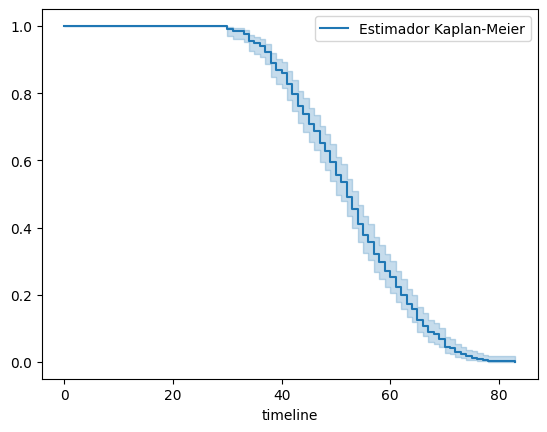

In [ ]:
T = data.Age
E = data.Surv

km = KaplanMeierFitter()

km.fit(T, E,label='Estimador Kaplan-Meier')

km.plot(ci_show=True)

**4. Utilize o estimador de Kaplan-Meier com dois grupos, um deles com pelo menos um nódulo axilar.**

<Axes: xlabel='timeline'>

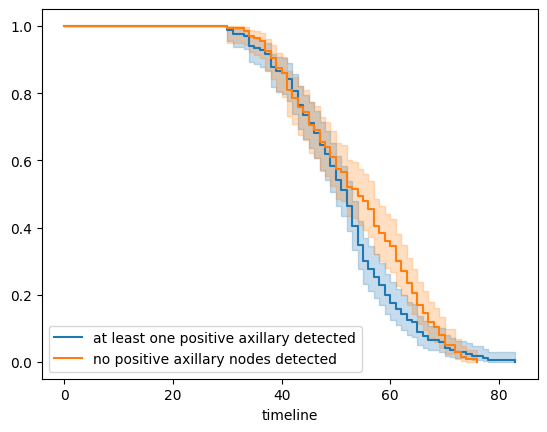

In [ ]:

km_2 = KaplanMeierFitter()

## Uma possibilidade: crie 2 coortes: com pelo menos um axilar positivo detectado e um sem nenhum detectado

groups = data['Nb_pos_detected']
i1 = (groups >= 1)
i2 = (groups < 1)


## ajuste o modelo para a 1ª coorte
km_2.fit(T[i1], E[i1], label='at least one positive axillary detected')
a1 = km_2.plot()

## ajuste o modelo para a 2ª coorte
km_2.fit(T[i2], E[i2], label='no positive axillary nodes detected')
km_2.plot(ax=a1)

**5. Ajuste um modelo de Cox com covariáveis Operatio_year e Nb_pos_detected. Interprete os resultados**

In [ ]:
# Crie o modelo
cph = CoxPHFitter()

# Ajuste o modelo
cph.fit(data, 'Age', event_col='Surv')

# Verifique os resultados
cph.print_summary()

<lifelines.CoxPHFitter: fitted with 306 total observations, 0 right-censored observations>
             duration col = 'Age'
                event col = 'Surv'
      baseline estimation = breslow
   number of observations = 306
number of events observed = 306
   partial log-likelihood = -1446.95
         time fit was run = 2023-08-28 18:30:23 UTC

---
                  coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                               
Operation_year   -0.02       0.98       0.02            -0.06             0.01                 0.94                 1.01
Nb_pos_detected   0.01       1.01       0.01            -0.00             0.03                 1.00                 1.03

                  cmp to     z    p   -log2(p)
covariate                                     
Operation_year      0.00 -1.39 0.16       2.61
Nb_pos_detected     0.00  1.70 0.09       3.47
---
Concordance = 0.53
Partial AIC = 2897.90
log-likelihood ratio test = 4.50 on 2 df
-log2(p) of ll-ratio test = 3.25

<Axes: xlabel='log(HR) (95% CI)'>

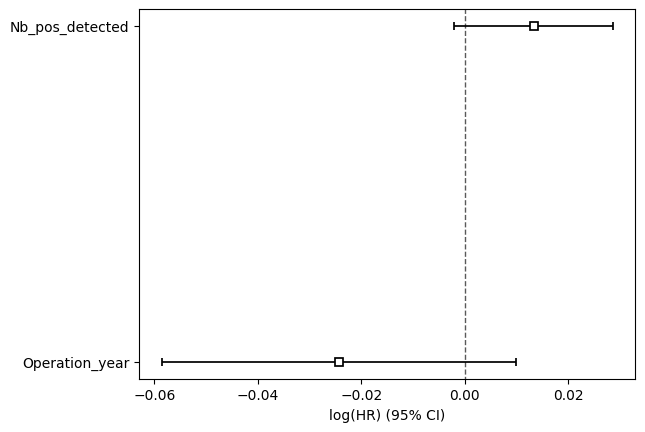

In [ ]:
cph.plot()

**6. Selecione três pacientes de forma aleatória para fazer a previsão da curva de sobrevivência para cada um deles**

In [ ]:
patients = [4,125,211]

rows_selected = data.iloc[patients, 1:3]
rows_selected

,Operation_year,Nb_pos_detected
4,65,4
125,64,0
211,67,0


**7. Faça a previsão da curva de sobrevivência para cada um dos pacientes selecionados acima**

<Axes: >

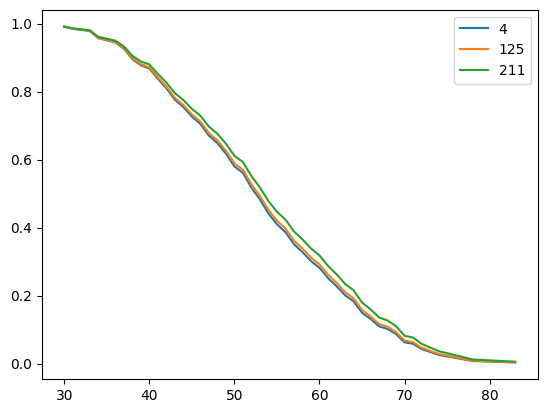

In [ ]:

cph.predict_survival_function(rows_selected).plot()

<a id="section19"></a>
Prática adicional (2 de setembro)

# Prática   02/09/2023

Nesta prática vamos desenvolver análises preditivas para os dados VALE3 e Ibovespa de julho de 2020 a julho de 2021.

**Carregue os pacotes que serão utilizados e faça a leitura dos dados, completando os dados faltantes como visto em aula.**

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

plt.rc("figure",figsize=(12,6))
plt.rc("font",size=15)
plt.rc("lines",linewidth=2)
sns.set_style("darkgrid")

# Ignorar warnings não prejudiciais
import warnings
warnings.filterwarnings("ignore")

**Carregue as bibliotecas e faça a leitura dos dados VALE3 e Ibovespa. Utilizaremos a variável Close de ambos, sendo que do Ibovespa será dividido por mil.**

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/VALE3.csv', index_col=0, parse_dates=True)

idx = pd.date_range(start=df.index.min(), end=df.index.max(), freq='B')
df = df.reindex(idx)

df.fillna(method='ffill', inplace=True)

df.head()

,Open,High,Low,Close,Adj Close,Volume
2020-07-21,60.439999,60.480000,59.270000,59.700001,53.772350,29043600.0
2020-07-22,59.930000,60.250000,58.799999,59.240002,53.358028,19644700.0
2020-07-23,59.900002,60.160000,58.639999,58.849998,53.006744,17291900.0
2020-07-24,58.570000,58.849998,57.820000,58.599998,52.781574,22544100.0
2020-07-27,59.099998,61.630001,58.980000,61.369999,55.276535,35124800.0


In [3]:
df2 = pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/Ibovespa.csv', index_col=0, parse_dates=True)

idx = pd.date_range(start=df2.index.min(), end=df2.index.max(), freq='B')
df2 = df2.reindex(idx)

df2.fillna(method='ffill', inplace=True)

df2.head()

,Open,High,Low,Close,Adj Close,Volume
2020-07-22,104312.0,104980.0,103277.0,104290.0,104290.0,10833700.0
2020-07-23,104291.0,104949.0,102119.0,102293.0,102293.0,10366600.0
2020-07-24,102292.0,102694.0,100859.0,102382.0,102382.0,9795200.0
2020-07-27,102381.0,104585.0,102381.0,104477.0,104477.0,9622400.0
2020-07-28,104477.0,104663.0,103592.0,104109.0,104109.0,9087100.0


**Faça visualizações das séries VALE3 e Ibovespa.**

In [4]:
plt.rcParams['figure.figsize'] = [14,8]

<AxesSubplot:>

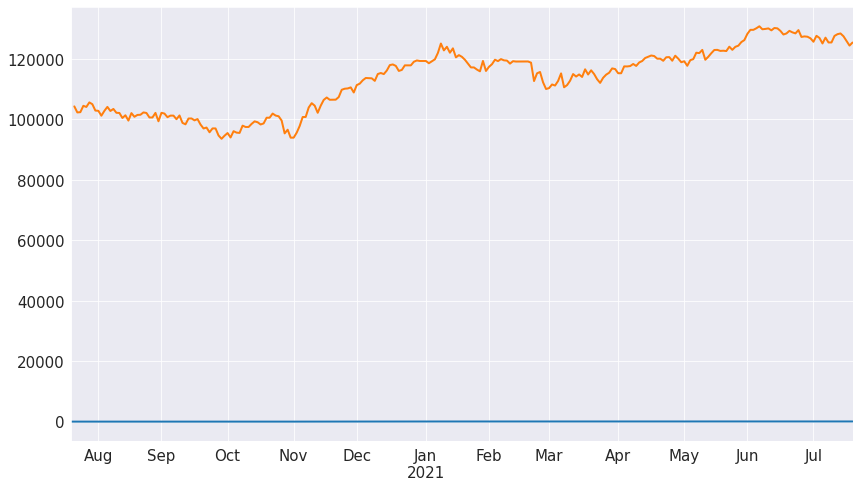

In [5]:
df['Close'].plot()
df2['Close'].plot()

In [6]:
df['IBOV'] = df2['Close']/1000

In [7]:
df

,Open,High,Low,Close,Adj Close,Volume,IBOV
2020-07-21,60.439999,60.480000,59.270000,59.700001,53.772350,29043600.0,NaN
2020-07-22,59.930000,60.250000,58.799999,59.240002,53.358028,19644700.0,104.290
2020-07-23,59.900002,60.160000,58.639999,58.849998,53.006744,17291900.0,102.293
2020-07-24,58.570000,58.849998,57.820000,58.599998,52.781574,22544100.0,102.382
2020-07-27,59.099998,61.630001,58.980000,61.369999,55.276535,35124800.0,104.477
...,...,...,...,...,...,...,...
2021-07-14,116.260002,116.430000,114.440002,115.120003,115.120003,19483600.0,128.407
2021-07-15,114.989998,116.160004,114.500000,115.480003,115.480003,18236100.0,127.468
2021-07-16,115.339996,115.870003,113.000000,113.400002,113.400002,19576800.0,125.960
2021-07-19,112.000000,112.160004,110.209999,112.160004,112.160004,18644300.0,124.395


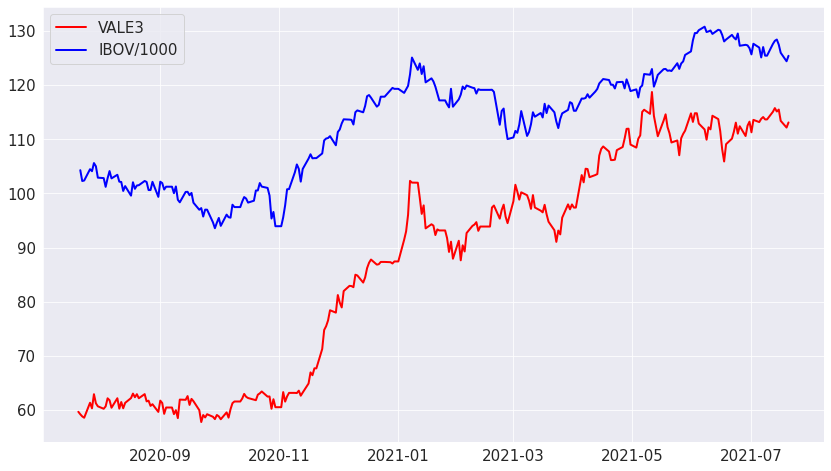

In [8]:
plt.plot(df['Close'],  color = 'red', label = 'VALE3')
plt.plot(df['IBOV'], color='blue', label='IBOV/1000')


plt.legend()
plt.show()



**Defina bases de treino e teste, deixando 30 observações para a base de teste.**

In [9]:
treino = df.iloc[:-30]
teste = df.iloc[-30:]

**Faça uma decomposição da série Close da VALE3 em tendência, sazonalidade e resíduos. Qual o período de sazonalidade mais adequado?**

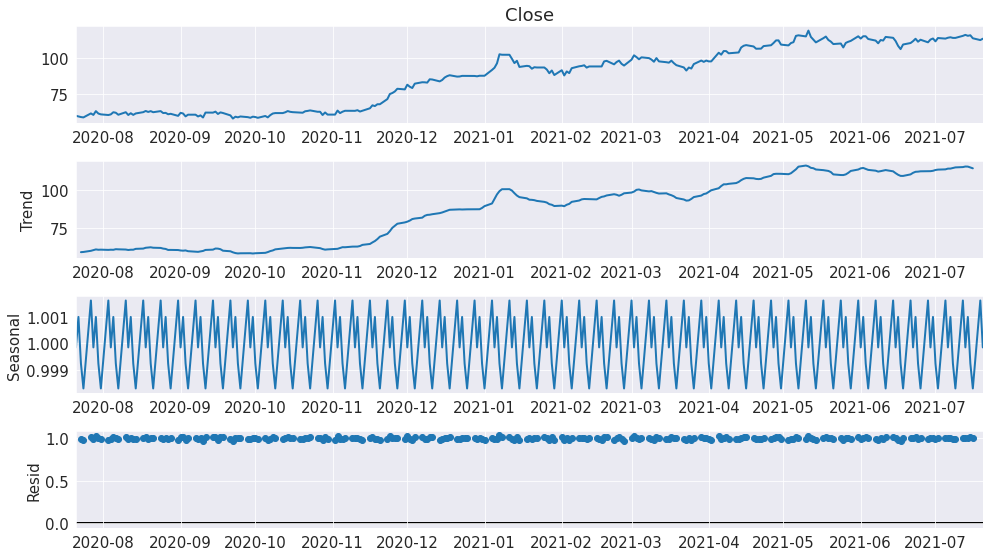

In [10]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot

result = seasonal_decompose(df['Close'], model='multiplicative', period=5)
result.plot()

pyplot.show()

**Obtenha as previsões pelo Método Theta para a série de dados de treino da VALE3.**

In [11]:
from statsmodels.tsa.forecasting.theta import ThetaModel
tm = ThetaModel(treino['Close'])
res = tm.fit()
print(res.summary())

                              ThetaModel Results                              
Dep. Variable:                  Close   No. Observations:                  231
Method:                       OLS/SES   Deseasonalized:                   True
Date:                Fri, 01 Sep 2023   Deseas. Method:         Multiplicative
Time:                        22:37:25   Period:                              5
Sample:                    07-21-2020                                         
                         - 06-08-2021                                         
   Parameter Estimates   
           Parameters    
-------------------------
b0    0.27978560620158865
alpha  0.9204099302864889
-------------------------


In [12]:
res = ThetaModel(treino['Close'],deseasonalize=True,period=5).fit()
fcast = res.forecast(30)

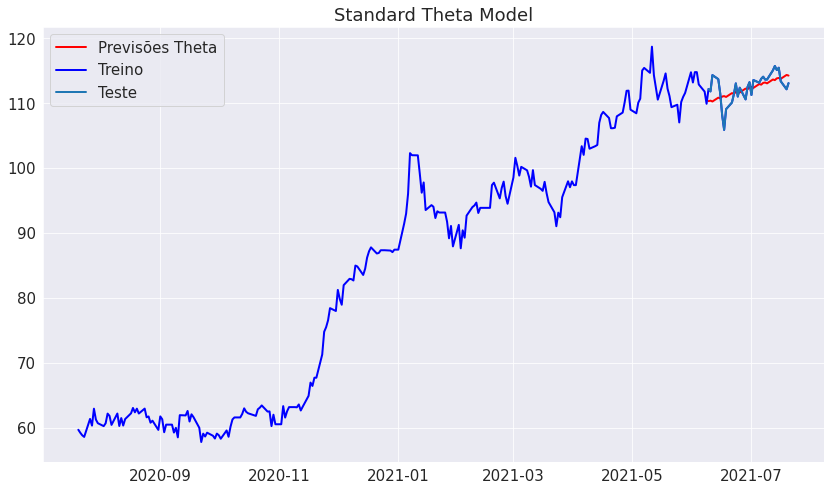

In [13]:
plt.plot(fcast,  color = 'red', label = 'Previsões Theta')
plt.plot(df['Close'],color = 'blue', label = 'Treino')
plt.plot(teste['Close'], label='Teste')
            
plt.title('Standard Theta Model')
plt.legend()
plt.show()

**Aplique o Método de Holt para os dados de teste e preveja as próximas 30 observações.**

In [14]:
# Método de Holt 

from statsmodels.tsa.api import ExponentialSmoothing

modelo_H =  ExponentialSmoothing(treino['Close'], trend='add');
 
ajustado = modelo_H.fit();

df['Holt'] = ajustado.fittedvalues.shift(-1);

predito_H = ajustado.forecast(30).rename('Previsão Holt')




**Represente graficamente os resultados, com as bases de treino e teste.**

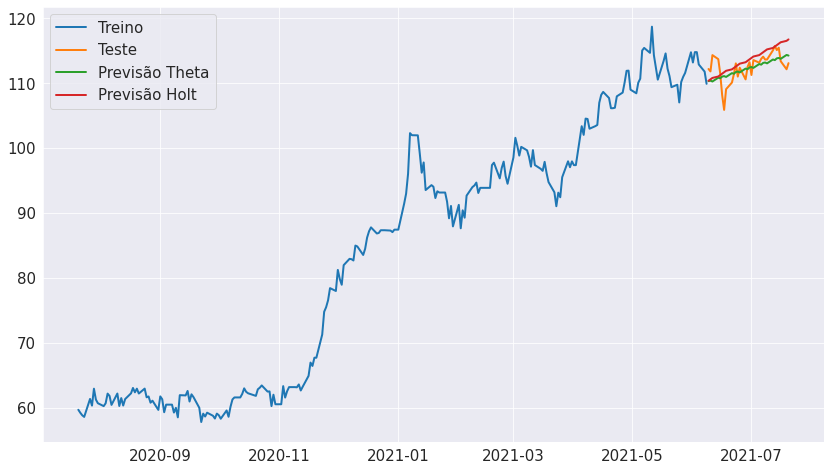

In [15]:
plt.plot(treino['Close'], label='Treino')
plt.plot(teste['Close'], label='Teste')
plt.plot(fcast, label='Previsão Theta')
plt.plot(predito_H, label='Previsão Holt')

plt.legend()
plt.show()


In [16]:
teste['Holt'] = predito_H
teste['Theta'] = fcast
teste

,Open,High,Low,Close,Adj Close,Volume,IBOV,Holt,Theta
2021-06-09,110.000000,113.339996,109.199997,112.199997,110.027176,22517600.0,129.907,110.386924,110.339086
2021-06-10,112.220001,113.370003,111.040001,111.830002,109.664345,30750900.0,130.076,110.606705,110.404485
2021-06-11,113.349998,114.760002,113.019997,114.339996,112.125732,18359200.0,129.441,110.826487,110.280086
2021-06-14,114.910004,115.279999,113.120003,113.720001,111.517746,19212700.0,130.208,111.046268,110.862999
2021-06-15,113.769997,113.860001,111.250000,111.500000,109.340736,20587900.0,130.091,111.266050,110.773136
2021-06-16,111.500000,111.629997,108.029999,108.150002,106.055611,38217700.0,129.259,111.485831,111.039102
2021-06-17,107.680000,109.160004,104.900002,105.900002,103.849182,33680600.0,128.057,111.705613,111.104028
2021-06-18,107.010002,109.089996,106.519997,109.089996,106.977402,59819400.0,128.405,111.925394,110.977956
2021-06-21,107.750000,110.690002,107.139999,110.110001,107.977654,22673600.0,129.265,112.145176,111.563671
2021-06-22,110.690002,112.080002,110.180000,111.400002,109.242676,18576100.0,128.767,112.364957,111.472357


**Utilize o EQM para comparar as previsões. Qual o melhor método?**

In [17]:
from sklearn.metrics import mean_squared_error

error = mean_squared_error(teste['Close'], fcast)
print(f'EQM Theta: {error:11.10}')


error = mean_squared_error(teste['Close'], predito_H)
print(f'EQM Holt: {error:11.10}')

EQM Theta: 3.357431752
EQM Holt: 5.008868392


**Considere uma análise de regressão com as variáveis Close, sendo que a resposta seria da VALE3 e preditora do Ibovespa**

In [18]:
# Observação: Nos dados Ibovespa falta a observação de 21/07/2020, portanto consideraremos a partir de 22/07/2020

df = df.iloc[df.index > '2020-07-22']

<AxesSubplot:xlabel='IBOV', ylabel='Close'>

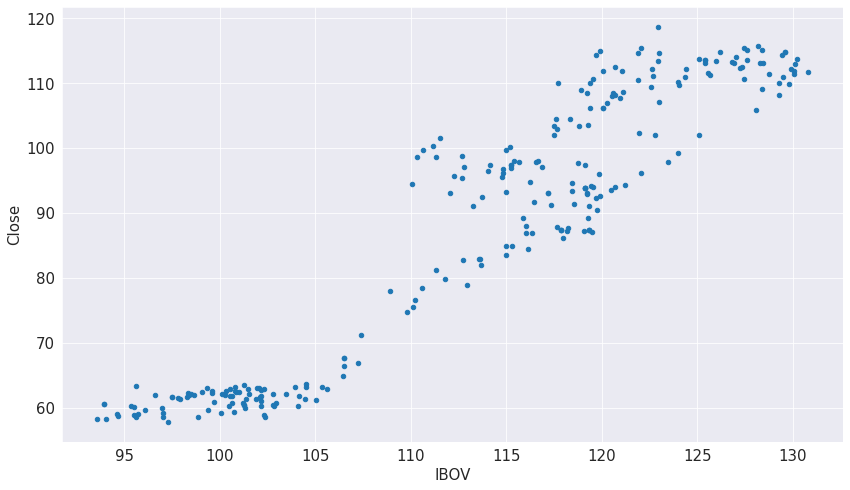

In [19]:
df.plot.scatter('IBOV','Close')

In [20]:
from statsmodels.formula.api import ols

# Ajusta o modelo de regressão linear simples para Close com IBOV/1000 como preditora
modelo = ols('Close ~ IBOV',data=df)
res = modelo.fit()

# valores ajustados de E(Y)
ypred=res.fittedvalues

# resíduo=observado-ajustado
residuo = res.resid


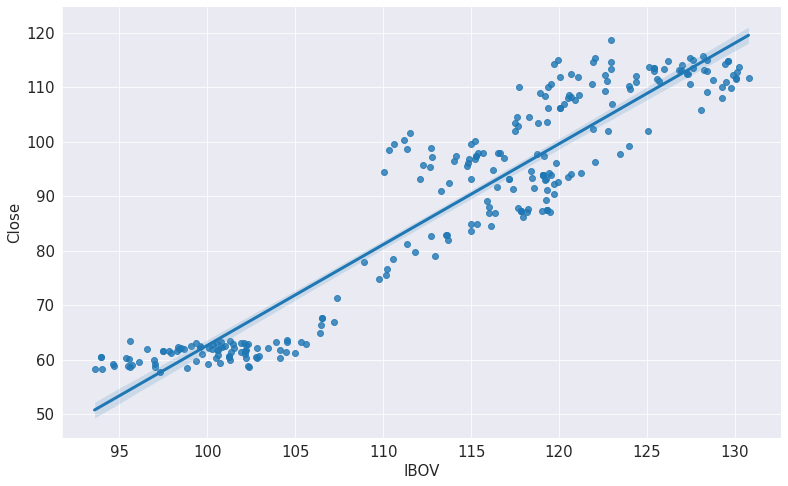

In [21]:
import seaborn as sns


sns.lmplot(y = 'Close', x='IBOV', data=df, height=7, aspect=1.6)

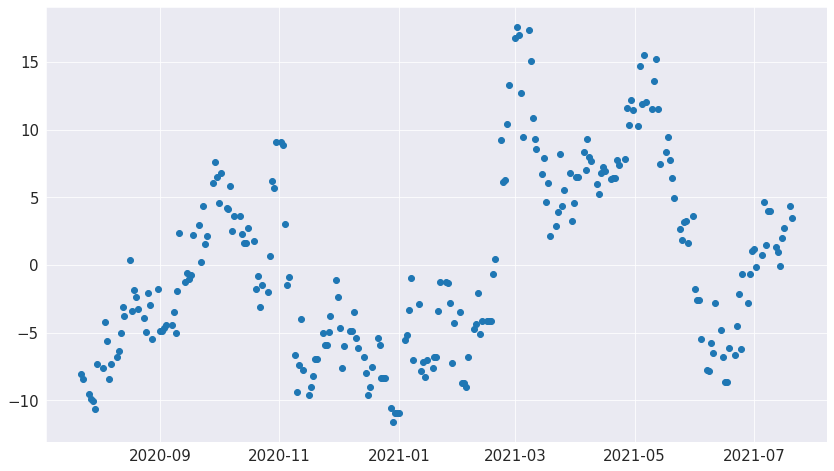

In [22]:
plt.scatter(residuo.index,residuo)

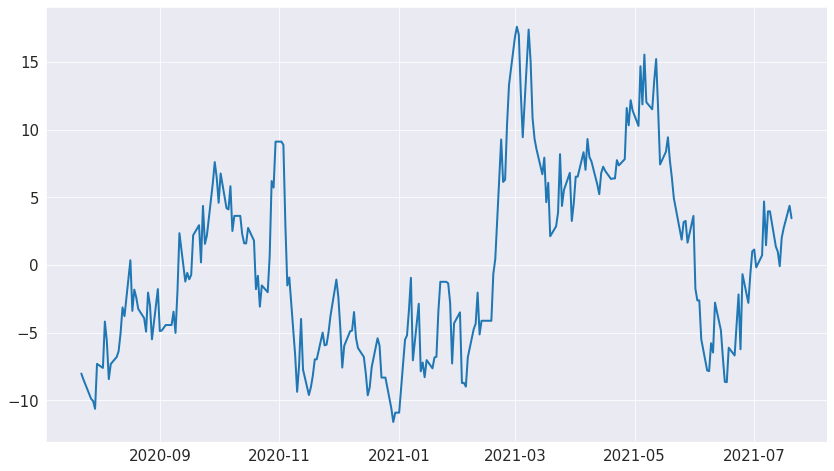

In [23]:
plt.plot(residuo)

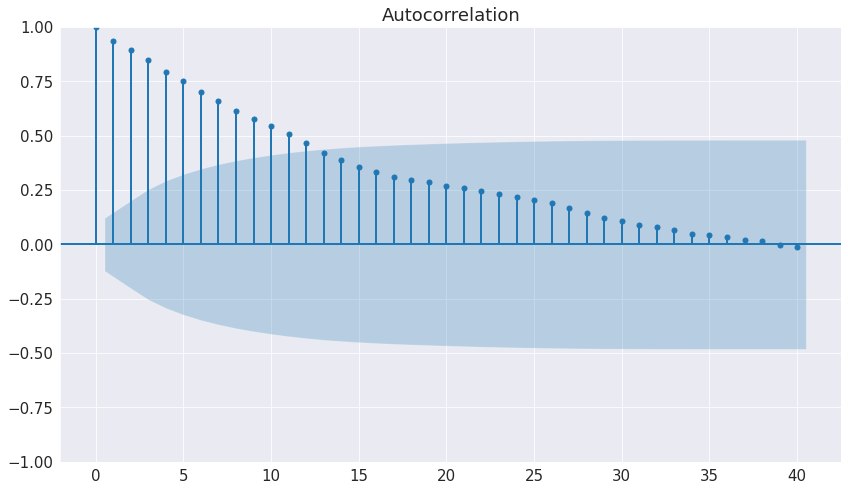

In [24]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
plot_acf(residuo, lags=40);

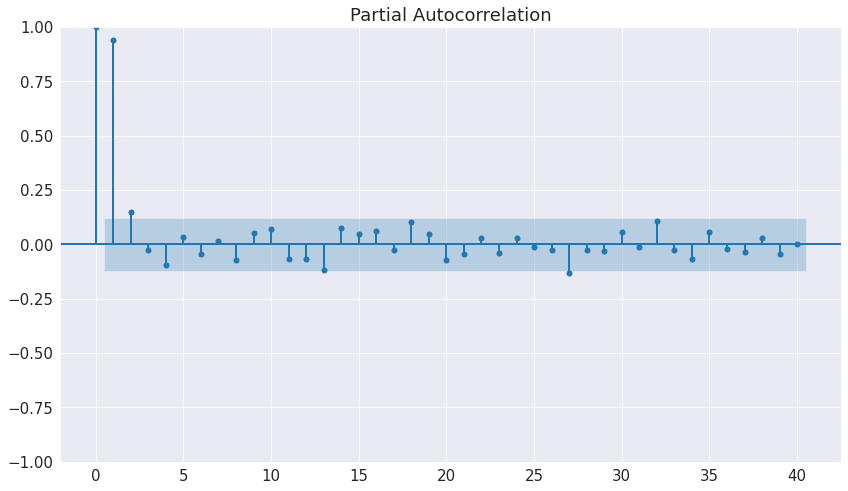

In [25]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
plot_pacf(residuo, lags=40);

In [26]:
from pmdarima import auto_arima

In [27]:
stepwise_fit = auto_arima(residuo, start_p=0, start_q=0,
                          max_p=4, max_q=4, 
                          seasonal=False,
                          d=None, trace=True,
                          error_action='ignore',   
                          suppress_warnings=True,  
                          stepwise=True)

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1181.645, Time=0.03 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1175.336, Time=0.05 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1175.677, Time=0.05 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=1179.736, Time=0.03 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1177.334, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=1177.335, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=1179.298, Time=0.27 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=1173.471, Time=0.03 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=1175.469, Time=0.04 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=1175.470, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=1173.818, Time=0.03 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=1177.427, Time=0.11 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 0.868 seconds


**Tentativa: Um modelo SARIMAX para a série Close do VALE3 utilizando a série Close do Ibovespa como variável exógena considerando order=(1,1,0).**

In [28]:
endog = df['Close']
exog = df['IBOV']

In [29]:
import statsmodels.api as sm

modelo = sm.tsa.statespace.SARIMAX(endog, exog, order=(1,1,0))
resultado = modelo.fit(disp=False)
print(resultado.summary())

                               SARIMAX Results                                
Dep. Variable:                  Close   No. Observations:                  259
Model:               SARIMAX(1, 1, 0)   Log Likelihood                -474.701
Date:                Fri, 01 Sep 2023   AIC                            955.403
Time:                        22:37:29   BIC                            966.062
Sample:                    07-23-2020   HQIC                           959.689
                         - 07-20-2021                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
IBOV           0.5793      0.071      8.130      0.000       0.440       0.719
ar.L1         -0.1245      0.058     -2.136      0.033      -0.239      -0.010
sigma2         2.3208      0.183     12.661      0.0

**Exercício: obtenha as previsões passo à frente e dinâmica para os últimos 30 dias com esse modelo e compare com a previsão pelo método Theta. Verifique se ainda existem padrões nos resíduos.**

In [30]:
# Previsão passo a frente
previsao = resultado.get_prediction()
previsao_ip = previsao.conf_int()

# Previsão dinâmica
data_previsao_dinamica = '2021-06-09'

previsao_di = resultado.get_prediction(dynamic=data_previsao_dinamica)
previsao_di_ip = previsao_di.conf_int()


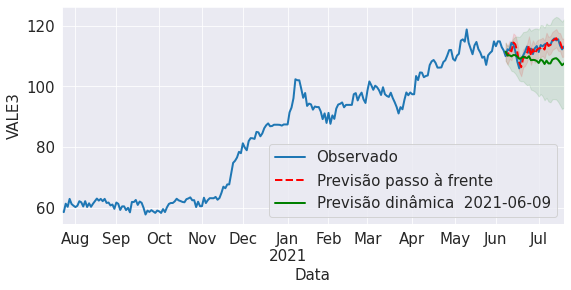

In [31]:
# Visualização dos resultados

# Sobre previsão passo à frente e previsão dinâmica:
# Jackson, E. A. (2018). Comparison between static and dynamic forecast in autoregressive integrated moving average for seasonally adjusted headline consumer price index. Available at SSRN 3162606. Disponível em https://mpra.ub.uni-muenchen.de/86180/1/MPRA_paper_86180.pdf. Acessado em 01/08/2020.

fig, ax = plt.subplots(figsize=(9,4))
npre = 4
ax.set(title='', xlabel='Data', ylabel='VALE3')

# Plota os dados
df.loc['2020-07-23':, 'Close'].plot(ax=ax,  label='Observado')

# Previsões
previsao.predicted_mean.loc['2021-06-08':].plot(ax=ax, style='r--', label='Previsão passo à frente')
ip = previsao_ip.loc['2021-06-08':]
ax.fill_between(ip.index, ip.iloc[:,0], ip.iloc[:,1], color='r', alpha=0.1)

previsao_di.predicted_mean.loc['2021-06-08':].plot(ax=ax, style='g', label='Previsão dinâmica  %s' % data_previsao_dinamica )
ip = previsao_di_ip.loc['2021-06-08':]
ax.fill_between(ip.index, ip.iloc[:,0], ip.iloc[:,1], color='g', alpha=0.1)

legend = ax.legend(loc='lower right')

In [32]:
teste['Passo a frente'] = previsao.predicted_mean.loc['2021-06-08':]
teste['Previsão dinâmica'] = previsao_di.predicted_mean.loc['2021-06-08':]

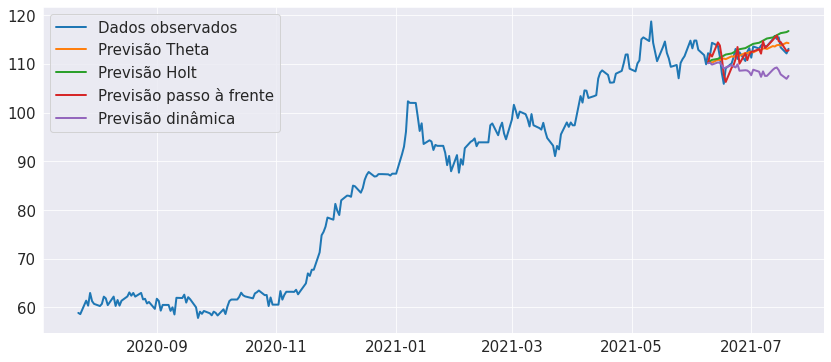

In [33]:
plt.figure(figsize = (14,6))


plt.plot(df['Close'], label='Dados observados')
plt.plot(teste['Theta'], label='Previsão Theta')
plt.plot(teste['Holt'], label='Previsão Holt')
plt.plot(teste['Passo a frente'], label='Previsão passo à frente')
plt.plot(teste['Previsão dinâmica'], label='Previsão dinâmica')


plt.legend()
plt.show()

## Redes dinâmicas - Aula 7

In [34]:
train = pd.DataFrame(df['Close'].iloc[:-30])
test = pd.DataFrame(df['Close'].iloc[-30:])

In [35]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaler.fit(treino)

MinMaxScaler()

In [36]:
scaler.fit(train)
scaled_train = scaler.transform(train)
scaled_test = scaler.transform(test)

In [37]:
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
# defina o gerador
n_input = 1
n_features = 1
generator = TimeseriesGenerator(scaled_train, scaled_train, length=n_input, batch_size=1)

2023-09-01 22:37:33.174084: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:938] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-09-01 22:37:33.180405: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudnn.so.8'; dlerror: libcudnn.so.8: cannot open shared object file: No such file or directory
2023-09-01 22:37:33.180423: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1829] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...
2023-09-01 22:37:33.180992: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN

Epoch 1/200
228/228 [==============================] - 1s 1ms/step - loss: 0.1725
Epoch 2/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0493
Epoch 3/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0286
Epoch 4/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0165
Epoch 5/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0083
Epoch 6/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0039
Epoch 7/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0023
Epoch 8/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0018
Epoch 9/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0017
Epoch 10/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0017
Epoch 11/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0016
Epoch 12/200
228/228 [==============================] - 0s 1ms/step - loss: 0.0016
Epoch 13/200


228/228 [==============================] - 0s 1ms/step - loss: 8.6742e-04
Epoch 191/200
228/228 [==============================] - 0s 1ms/step - loss: 8.3468e-04
Epoch 192/200
228/228 [==============================] - 0s 1ms/step - loss: 8.4063e-04
Epoch 193/200
228/228 [==============================] - 0s 1ms/step - loss: 8.5461e-04
Epoch 194/200
228/228 [==============================] - 0s 1ms/step - loss: 8.2238e-04
Epoch 195/200
228/228 [==============================] - 0s 1ms/step - loss: 8.5072e-04
Epoch 196/200
228/228 [==============================] - 0s 1ms/step - loss: 8.4280e-04
Epoch 197/200
228/228 [==============================] - 0s 1ms/step - loss: 8.6179e-04
Epoch 198/200
228/228 [==============================] - 0s 1ms/step - loss: 8.1859e-04
Epoch 199/200
228/228 [==============================] - 0s 1ms/step - loss: 8.7883e-04
Epoch 200/200
228/228 [==============================] - 0s 1ms/step - loss: 8.3495e-04


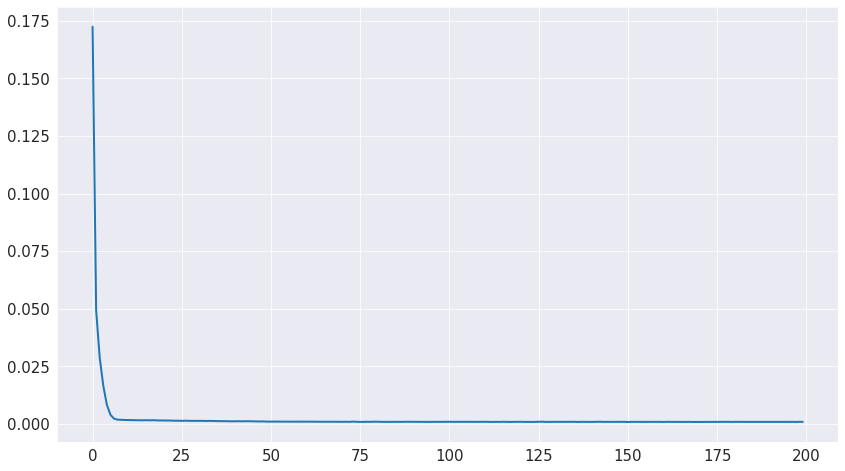

In [38]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM

n_features = 1

# Defina o modelo
model = Sequential()
model.add(LSTM(20, activation='relu', input_shape=(n_input, n_features)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Ajuste do modelo
model.fit(generator,epochs=200)

loss_per_epoch = model.history.history['loss']
plt.plot(range(len(loss_per_epoch)),loss_per_epoch)

# Agora vamos considerar as previsões para as próximas observações e comparar com a base de teste

test_predictions = []

first_eval_batch = scaled_train[-n_input:]
current_batch = first_eval_batch.reshape((1, n_input, n_features))

for i in range(len(test)):
    
    # obter a previsão de tempo 1 antecipadamente ([0] é para pegar apenas o número em vez de [array])
    current_pred = model.predict(current_batch)[0]
    
    # predição
    test_predictions.append(current_pred) 
    
    # atualize a rodada para agora incluir a previsão e descartar o primeiro valor
    current_batch = np.append(current_batch[:,1:,:],[[current_pred]],axis=1)
    


In [39]:
true_predictions = scaler.inverse_transform(test_predictions)
teste['LSTM'] = true_predictions

In [40]:
from sklearn.metrics import mean_squared_error,mean_absolute_error

In [41]:
mean_absolute_error(teste['Close'],teste['Holt'])

1.762497990488715

In [42]:
mean_absolute_error(teste['Close'],teste['Theta'])

1.460259653899739

In [43]:
mean_absolute_error(teste['Close'],teste['Passo a frente'])

1.293956289430586

In [44]:
mean_absolute_error(teste['Close'],teste['Previsão dinâmica'])

3.957282336722732

In [45]:
mean_absolute_error(teste['Close'],teste['LSTM'])

1.458166851403585

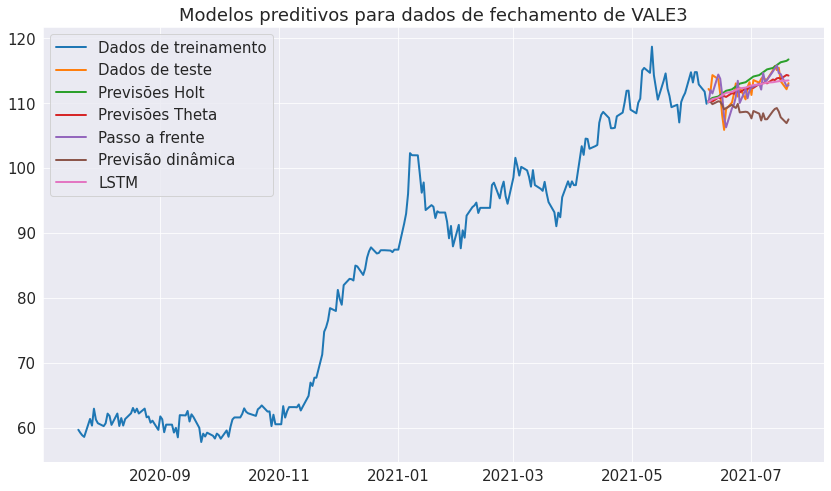

In [51]:
plt.plot(treino['Close'], label = 'Dados de treinamento')
plt.plot(teste['Close'], label = 'Dados de teste')
plt.plot(teste['Holt'], label = 'Previsões Holt')
plt.plot(teste['Theta'], label = 'Previsões Theta')#, linestyle='dashed')
plt.plot(teste['Passo a frente'], label = 'Passo a frente')#, linestyle='dotted')
plt.plot(teste['Previsão dinâmica'], label = 'Previsão dinâmica')#, linestyle='dashdot')
plt.plot(teste['LSTM'], label = 'LSTM')
            
plt.title('Modelos preditivos para dados de fechamento de VALE3')
plt.legend()
plt.show()

**Repita os procedimentos para obter previsões para dados futuros, ou seja, utilizando todos os dados disponíveis e fazendo previsões para os próximos 20 dias.**

<a id="section20"></a>
Notebook dados Covid

# Previsão do número de mortes por Covid-19 no Brasil

Neste problema, vamos usar o modelo de espaço de estados considerando o número de casos diários e o número total de pessoas vacinadas como variáveis preditoras.

Este notebook foi baseado no notebook do site:  https://github.com/tensorflow/probability/blob/master/tensorflow_probability/examples/jupyter_notebooks/Structural_Time_Series_Modeling_Case_Studies_Atmospheric_CO2_and_Electricity_Demand.ipynb para os dados de consumo de energia elétrica na Austrália.

Os dados utilizados neste notebook foram baixados no site:

https://ourworldindata.org/coronavirus/country/brazil


In [1]:
#@title Import and set ups{ display-mode: "form" }

%matplotlib inline
import matplotlib as mpl
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure
figure(figsize=(14, 8), dpi=200)
import matplotlib.dates as mdates
import seaborn as sns
import pandas as pd

import collections

import numpy as np
import tensorflow.compat.v2 as tf
import tensorflow_probability as tfp

from tensorflow_probability import distributions as tfd
from tensorflow_probability import sts

tf.enable_v2_behavior()

<Figure size 2800x1600 with 0 Axes>

In [2]:
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

sns.set_context("notebook", font_scale=1.)
sns.set_style("whitegrid")
%config InlineBackend.figure_format = 'retina'

In [3]:
def plot_forecast(x, y,
                  forecast_mean, forecast_scale, forecast_samples,
                  title, x_locator=None, x_formatter=None):
  """Plot a forecast distribution against the 'true' time series."""
  colors = sns.color_palette()
  c1, c2 = colors[0], colors[1]
  fig = plt.figure(figsize=(14, 8))
  ax = fig.add_subplot(1, 1, 1)

  num_steps = len(y)
  num_steps_forecast = forecast_mean.shape[-1]
  num_steps_train = num_steps - num_steps_forecast

  ax.plot(x, y, lw=2, color=c1, label='ground truth')

  forecast_steps = np.arange(
      x[num_steps_train],
      x[num_steps_train]+num_steps_forecast,
      dtype=x.dtype)

  ax.plot(forecast_steps, forecast_samples.T, lw=1, color=c2, alpha=0.1)

  ax.plot(forecast_steps, forecast_mean, lw=2, ls='--', color=c2,
           label='forecast')
  ax.fill_between(forecast_steps,
                   forecast_mean-2*forecast_scale,
                   forecast_mean+2*forecast_scale, color=c2, alpha=0.2)

  ymin, ymax = min(np.min(forecast_samples), np.min(y)), max(np.max(forecast_samples), np.max(y))
  yrange = ymax-ymin
  ax.set_ylim([ymin - yrange*0.1, ymax + yrange*0.1])
  ax.set_title("{}".format(title))
  ax.legend()

  if x_locator is not None:
    ax.xaxis.set_major_locator(x_locator)
    ax.xaxis.set_major_formatter(x_formatter)
    fig.autofmt_xdate()

  return fig, ax

In [4]:
def plot_components(dates,
                    component_means_dict,
                    component_stddevs_dict,
                    x_locator=None,
                    x_formatter=None):
  """Plot the contributions of posterior components in a single figure."""
  colors = sns.color_palette()
  c1, c2 = colors[0], colors[1]

  axes_dict = collections.OrderedDict()
  num_components = len(component_means_dict)
  fig = plt.figure(figsize=(14, 2.5 * num_components))
  for i, component_name in enumerate(component_means_dict.keys()):
    component_mean = component_means_dict[component_name]
    component_stddev = component_stddevs_dict[component_name]

    ax = fig.add_subplot(num_components,1,1+i)
    ax.plot(dates, component_mean, lw=2)
    ax.fill_between(dates,
                     component_mean-2*component_stddev,
                     component_mean+2*component_stddev,
                     color=c2, alpha=0.5)
    ax.set_title(component_name)
    if x_locator is not None:
      ax.xaxis.set_major_locator(x_locator)
      ax.xaxis.set_major_formatter(x_formatter)
    axes_dict[component_name] = ax
  fig.autofmt_xdate()
  fig.tight_layout()
  return fig, axes_dict

In [5]:
def plot_one_step_predictive(dates, observed_time_series,
                             one_step_mean, one_step_scale,
                             x_locator=None, x_formatter=None):
  """Plot a time series against a model's one-step predictions."""

  colors = sns.color_palette()
  c1, c2 = colors[0], colors[1]

  fig=plt.figure(figsize=(14, 8))
  ax = fig.add_subplot(1,1,1)
  num_timesteps = one_step_mean.shape[-1]
  ax.plot(dates, observed_time_series, label="observed time series", color=c1)
  ax.plot(dates, one_step_mean, label="one-step prediction", color=c2)
  ax.fill_between(dates,
                  one_step_mean - one_step_scale,
                  one_step_mean + one_step_scale,
                  alpha=0.1, color=c2)
  ax.legend()

  if x_locator is not None:
    ax.xaxis.set_major_locator(x_locator)
    ax.xaxis.set_major_formatter(x_formatter)
    fig.autofmt_xdate()
  fig.tight_layout()
  return fig, ax

## Leitura dos dados

In [6]:
covid = pd.read_csv(f'data/owid-covid-data.csv', index_col='date', parse_dates=True)
covid = covid[covid["location"] == "Brazil"] # É possível testar outros países

# Escolha das variáveis a serem usadas como exógenas no modelo
covid = covid[['new_cases','new_deaths','new_vaccinations','total_vaccinations','population']]
# As variáveis de vacinação têm uma escala muito maior do que a de casos e de mortes. Por isso, essa variável é normalizada
# pelo tamanho da população
covid[['new_vaccinations','total_vaccinations']] = covid[['new_vaccinations','total_vaccinations']]/covid['population'].iloc[0]

idx = pd.date_range(start=covid.index.min(), end=covid.index.max(), freq='D')
covid = covid.reindex(idx)

# preenchimento dos dados faltantes com os dados do passo anterior (útil para séries temporais)
covid.fillna(method='ffill',inplace=True)
covid['new_deaths'].fillna(method='ffill',inplace=True)

# Formatação da data (útil para os gráficos abaixo)
date_fmt = mdates.DateFormatter('%b %Y')
date_loc = mdates.WeekdayLocator(byweekday=mdates.WE)

## Análise gráfica das séries

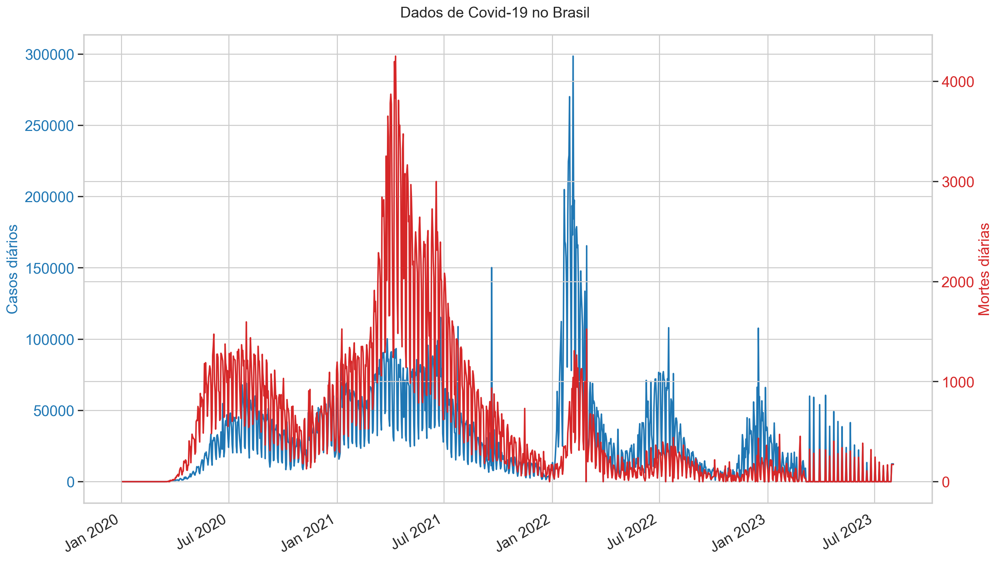

In [7]:
fig, ax1 = plt.subplots(figsize=(14,8))

color = 'tab:blue'
ax1.set_ylabel('Casos diários', color=color,fontsize=15)
ax1.plot(covid['new_cases'].index,covid['new_cases'], color=color)
ax1.tick_params(axis='y', labelcolor=color)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:red'
ax2.set_ylabel('Mortes diárias', color=color,fontsize=15)  # we already handled the x-label with ax1
ax2.plot(covid['new_deaths'], color=color)
ax2.tick_params(axis='y', labelcolor=color)
ax1.xaxis.set_major_formatter(date_fmt)
ax2.xaxis.set_major_formatter(date_fmt)
fig.suptitle("Dados de Covid-19 no Brasil",fontsize=15)
fig.autofmt_xdate()

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

Como a sazonalidade semanal é artificial, ou seja, ela não representa a realidade, o número de casos e de mortes diárias não deve depender diretamente dos dias da semana. Por este motivo, decidimos trabalhar com a mediana móvel. A mediana móvel usada neste notebook não é a de séries temporais, mas sim a de processamento de sinais, em que os valores futuros são também levados em conta. Isso foi feito porque tentar minimizar o problema da subnotificação e o de dados discrepantes. Para esta análise, estamos interessados apenas em prever a tendência do número de mortes.

**Remoção da sazonalidade semanal**

In [8]:
# Esta media é calculada de forma diferente do filtro media das séries temporais. O tamanho da janela foi escolhido 
# de forma a minimizar a discrepância da série em uma faixa de dias (discutir na apresentação)
covid['new_deaths_f'] = covid['new_deaths'].rolling(window=28).mean() 
covid['new_cases_f'] = covid['new_cases'].rolling(window=28).mean() 
covid['new_vaccinations_f'] = covid['new_vaccinations'].rolling(window=28).mean()
covid['total_vaccinations_f'] = covid['total_vaccinations'].rolling(window=28).mean()
covid2 = covid

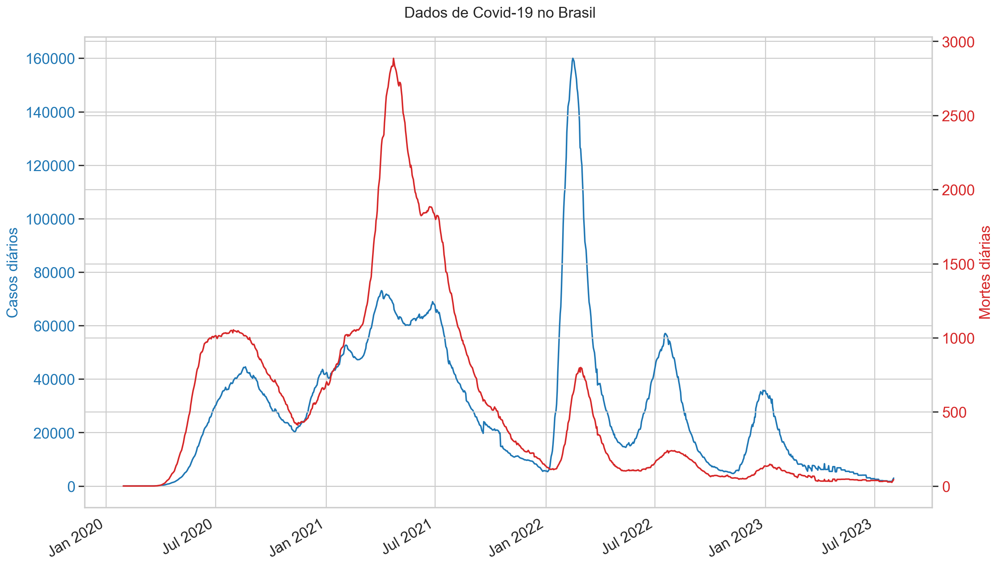

In [9]:
fig, ax1 = plt.subplots(figsize=(14,8))

color = 'tab:blue'
ax1.set_ylabel('Casos diários', color=color,fontsize=15)
ax1.plot(covid['new_cases_f'].index,covid['new_cases_f'], color=color)
ax1.tick_params(axis='y', labelcolor=color)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:red'
ax2.set_ylabel('Mortes diárias', color=color,fontsize=15)  # we already handled the x-label with ax1
ax2.plot(covid['new_deaths_f'], color=color)
ax2.tick_params(axis='y', labelcolor=color)
ax1.xaxis.set_major_formatter(date_fmt)
ax2.xaxis.set_major_formatter(date_fmt)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
fig.suptitle("Dados de Covid-19 no Brasil",fontsize=15)
fig.autofmt_xdate()

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

**Pareamento das séries**

In [10]:
# Definição do intervalo de análise das séries

# Brazil
start_date = '2021-11-01'
covid = covid.iloc[covid.index>start_date,:]
covid = covid.iloc[covid.index<'2022-12-15',:]

# Italy
#start_date = '2020-03-01'
#covid = covid2.iloc[covid2.index>start_date,:]
#covid = covid.iloc[covid.index<'2021-07-17',:]

# deslocamento da série de número de casos para pareá-la com a do número de mortes diárias e o de vacinação
death_days = 12 # número dias médios em que o paciente falece após ser diagnosticado com Covid-19

covid = covid[['new_cases_f','new_deaths_f','new_vaccinations_f','total_vaccinations_f']]
covid['new_vaccinations_f'].fillna(0,inplace=True)
covid['total_vaccinations_f'].fillna(0,inplace=True)

new_deaths_f = covid['new_deaths_f'].iloc[death_days:].values
covid = covid.iloc[:-death_days,]
covid['new_deaths_f'] = new_deaths_f

# definição do conjunto de treinamento
num_forecast_steps = 28 # número de passos à frente para previsão do número de óbitos
covid_training = covid.iloc[:-num_forecast_steps,]

# Brazil
covid_dates = np.arange(start_date, covid.shape[0], dtype='datetime64[D]')

# Italy
#covid_dates = np.arange(start_date, covid.shape[0], dtype='datetime64[D]')

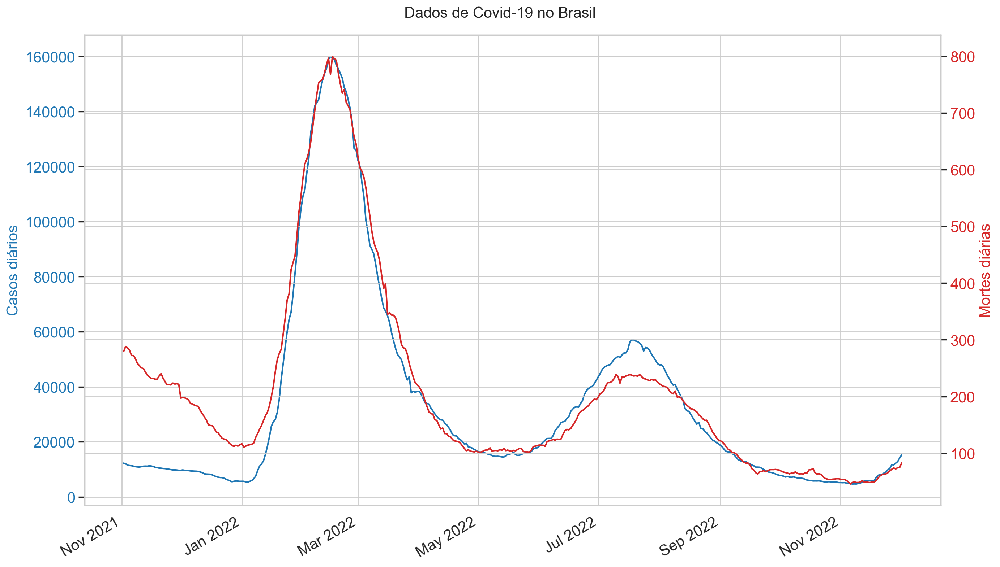

In [11]:
fig, ax1 = plt.subplots(figsize=(14,8))

color = 'tab:blue'
ax1.set_ylabel('Casos diários', color=color,fontsize=15)
ax1.plot(covid['new_cases_f'].index,covid['new_cases_f'], color=color)
ax1.tick_params(axis='y', labelcolor=color)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:red'
ax2.set_ylabel('Mortes diárias', color=color,fontsize=15)  # we already handled the x-label with ax1
ax2.plot(covid['new_deaths_f'], color=color)
ax2.tick_params(axis='y', labelcolor=color)
ax1.xaxis.set_major_formatter(date_fmt)
ax2.xaxis.set_major_formatter(date_fmt)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
fig.suptitle("Dados de Covid-19 no Brasil",
             fontsize=15)
fig.autofmt_xdate()

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

### Modelo e ajuste

Nosso modelo combina tendência local, regressão linear com o número de casos diários como variável preditora e um processo autoregressivo para os resíduos vinculados à variância.

In [12]:
def build_model(new_deaths,new_cases,vaccinations):
  # componente sazonal de 7 dias
  day_of_week_effect = sts.Seasonal(
      num_seasons=7, num_steps_per_season=1,
      observed_time_series=new_deaths,
      name='day_of_week_effect')
    
  # sazonalidade das séries, aproximadamente 6 meses
  season_effect = sts.Seasonal(
      num_seasons=2, num_steps_per_season=91,
      observed_time_series=new_deaths,
      name='season_effect')

  # variável exógena número de casos diários
  new_cases_effect = sts.LinearRegression(
      design_matrix=tf.reshape(new_cases - np.mean(new_cases),
                               (-1, 1)), name='new_cases_effect')

  # variável exógena vacinação
  vaccination_effect = sts.LinearRegression(
      design_matrix=tf.reshape(vaccinations - np.mean(vaccinations),
                               (-1, 1)), name='vaccination_effect')

  # modelo autoregressivo de ordem 2
  autoregressive = sts.Autoregressive(
      order=2,
      observed_time_series=new_deaths,
      name='autoregressive')

  # componente de tendência linear local (define se a série observada continua crescendo ou descrescendo baseada no último
  # valor observado)
  local_linear_trend = tfp.sts.LocalLinearTrend(
    observed_time_series=new_deaths, 
    name='local_linear_trend')

  # componente de nível local (define se a série observada continua mantendo o nível anterior)
  local_level = tfp.sts.LocalLevel(
    observed_time_series=new_deaths, 
    name='local_level')

  # composição do modelo final (podem testar várias combinações)
  model = sts.Sum([new_cases_effect,
                  vaccination_effect,
                  local_level,
                  #local_linear_trend,
                  #day_of_week_effect,
                  season_effect,
                  autoregressive],
                  observed_time_series=new_deaths)
  return model

Como no exemplo da aula (série de C02), vamos ajustar um modelo com inferência variacional e gerar amostras da distribuição a posteriori.

In [13]:
covid_model = build_model(covid_training['new_deaths_f'],covid['new_cases_f'],covid['total_vaccinations_f'])

# Build the variational surrogate posteriors `qs`.
variational_posteriors = tfp.sts.build_factored_surrogate_posterior(model=covid_model)

Instructions for updating:
Please use `StructuralTimeSeries.joint_distribution(observed_time_series).log_prob`


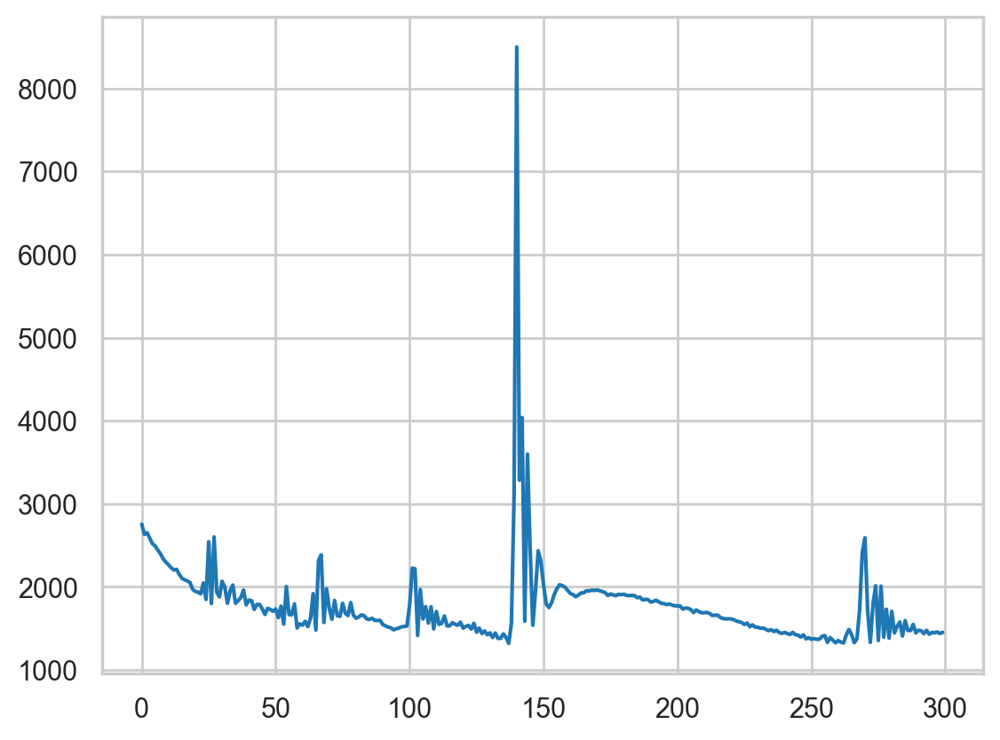

In [14]:
#@title Minimize the variational loss.

# Allow external control of optimization to reduce test runtimes.
num_variational_steps = 300 # @param { isTemplate: true}
num_variational_steps = int(num_variational_steps)

optimizer = tf.optimizers.Adam(learning_rate=.1)
# Using fit_surrogate_posterior to build and optimize the variational loss function.
@tf.function(jit_compile=True)
def train():
  elbo_loss_curve = tfp.vi.fit_surrogate_posterior(
    target_log_prob_fn=covid_model.joint_log_prob(
        observed_time_series=covid_training['new_deaths_f']),
    surrogate_posterior=variational_posteriors,
    optimizer=optimizer,
    num_steps=num_variational_steps)
  return elbo_loss_curve

elbo_loss_curve = train()

plt.plot(elbo_loss_curve)
plt.show()

# Draw samples from the variational posterior.
q_samples_covid_ = variational_posteriors.sample(100)

In [15]:
print("Inferred parameters:")
for param in covid_model.parameters:
  print("{}: {} +- {}".format(param.name,
                              np.mean(q_samples_covid_[param.name], axis=0),
                              np.std(q_samples_covid_[param.name], axis=0)))

Inferred parameters:
observation_noise_scale: 0.6795865638918706 +- 0.5798744679612778
new_cases_effect/_weights: [0.00413275] +- [0.00023681]
vaccination_effect/_weights: [-2.26989707] +- [7.98110299]
local_level/_level_scale: 15.736546655867631 +- 0.5448676037366206
season_effect/_drift_scale: 8.878900973590708 +- 34.09309867834012
autoregressive/_coefficients: [0.16789721 0.0248581 ] +- [0.35699638 0.17272824]
autoregressive/_level_scale: 0.5945323087319645 +- 1.5522777077960672


Agora nós fazemos a previsão simplesmente chamando `tfp.sts.forecast` com o nosso modelo, a série temporal e os parâmetros ajustados.

In [16]:
covid_forecast_dist = tfp.sts.forecast(
    model=covid_model,
    observed_time_series=covid_training['new_deaths_f'],
    parameter_samples=q_samples_covid_,
    num_steps_forecast=num_forecast_steps)

In [17]:
num_samples=10

(
    covid_forecast_mean,
    covid_forecast_scale,
    covid_forecast_samples
) = (
    covid_forecast_dist.mean().numpy()[..., 0],
    covid_forecast_dist.stddev().numpy()[..., 0],
    covid_forecast_dist.sample(num_samples).numpy()[..., 0]
    )

**Erro relativo para cada valor predito**

In [18]:
results = pd.DataFrame({'observed': covid['new_deaths_f'].iloc[-num_forecast_steps:], 'forecast': covid_forecast_mean})
predictions = round(np.abs(results['observed']-results['forecast']),2)
predictions.tail(30)

2022-11-05     2.50
2022-11-06     5.13
2022-11-07     2.21
2022-11-08     1.29
2022-11-09     2.12
2022-11-10     2.90
2022-11-11     2.85
2022-11-12     1.57
2022-11-13     6.20
2022-11-14     5.92
2022-11-15     6.61
2022-11-16     7.38
2022-11-17     5.17
2022-11-18     6.41
2022-11-19     8.14
2022-11-20     7.15
2022-11-21     4.31
2022-11-22     2.42
2022-11-23     3.62
2022-11-24     4.89
2022-11-25     6.07
2022-11-26     5.05
2022-11-27     7.49
2022-11-28     5.06
2022-11-29     9.45
2022-11-30     9.37
2022-12-01    14.46
2022-12-02    11.02
Freq: D, dtype: float64

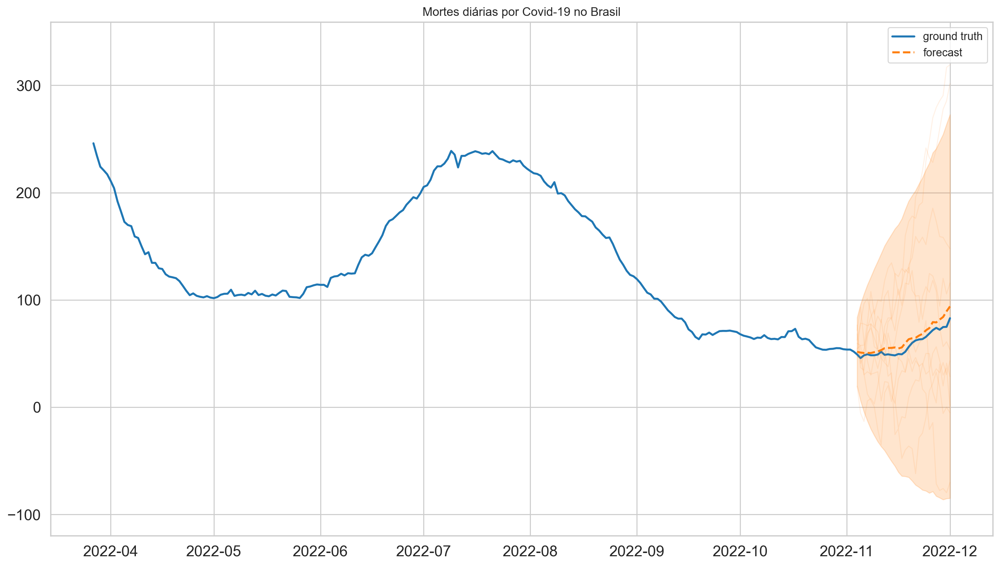

In [19]:
fig, ax = plot_forecast(covid_dates[-250:], covid['new_deaths_f'].iloc[-250:,],
                        covid_forecast_mean,
                        covid_forecast_scale,
                        covid_forecast_samples,
                        title="Mortes diárias por Covid-19 no Brasil")#,
                        #x_locator=date_loc, x_formatter=date_fmt)
#ax.set_ylim([0, 10])
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
fig.tight_layout()

### Decomposição da série

Vamos vizualizar a decomposição das séries observadas e preditas nas suas componentes individuais:

In [20]:
# Get the distributions over component outputs from the posterior marginals on
# training data, and from the forecast model.
component_dists = sts.decompose_by_component(
    covid_model,
    observed_time_series=covid_training['new_deaths_f'],
    parameter_samples=q_samples_covid_)

forecast_component_dists = sts.decompose_forecast_by_component(
    covid_model,
    forecast_dist=covid_forecast_dist,
    parameter_samples=q_samples_covid_)

In [21]:
covid_component_means_, covid_component_stddevs_ = (
    {k.name: c.mean() for k, c in component_dists.items()},
    {k.name: c.stddev() for k, c in component_dists.items()})

(
    covid_forecast_component_means_,
    covid_forecast_component_stddevs_
) = (
    {k.name: c.mean() for k, c in forecast_component_dists.items()},
    {k.name: c.stddev() for k, c in forecast_component_dists.items()}
    )

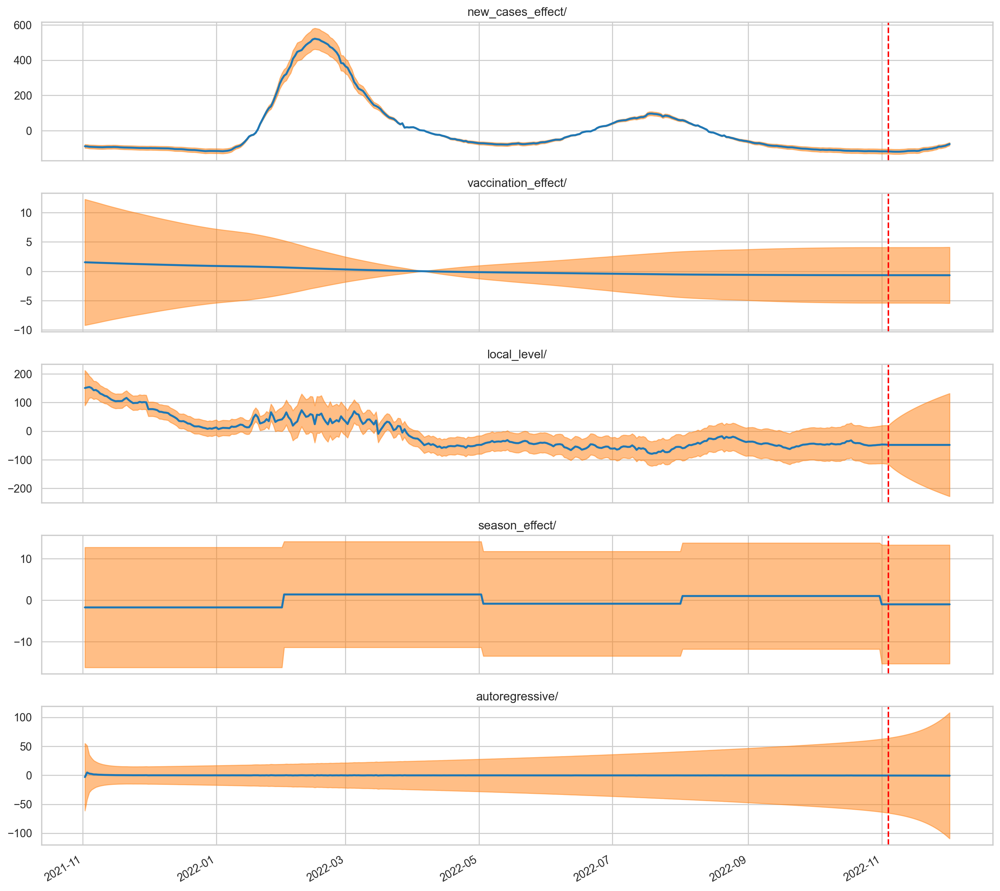

In [22]:
# Concatenate the training data with forecasts for plotting.
component_with_forecast_means_ = collections.OrderedDict()
component_with_forecast_stddevs_ = collections.OrderedDict()
for k in covid_component_means_.keys():
  component_with_forecast_means_[k] = np.concatenate([
      covid_component_means_[k],
      covid_forecast_component_means_[k]], axis=-1)
  component_with_forecast_stddevs_[k] = np.concatenate([
      covid_component_stddevs_[k],
      covid_forecast_component_stddevs_[k]], axis=-1)

fig, axes = plot_components(
  covid.index,
  component_with_forecast_means_,
  component_with_forecast_stddevs_)#,
  #x_locator=date_loc, x_formatter=date_fmt)
for ax in axes.values():
  ax.axvline(covid_dates[-num_forecast_steps], linestyle="--", color='red')

### Anomalias na série

Se quisermos detectar anomalias nas séries observadas, também podemos analisar as distribuições preditivas de um passo: a previsão para cada passo de tempo, dado apenas os passos tempo até o passo anterior. `tfp.sts.one_step_predictive` calcula todas as distribuições preditivas de um passo de uma única vez:

In [23]:
covid_one_step_dist = sts.one_step_predictive(
    covid_model,
    observed_time_series=covid['new_deaths_f'],
    parameter_samples=q_samples_covid_)

covid_one_step_mean, covid_one_step_scale = (
    covid_one_step_dist.mean().numpy(), covid_one_step_dist.stddev().numpy())

Instructions for updating:
`Predictive distributions returned by`tfp.sts.one_step_predictive` will soon compute per-timestep probabilities (treating timesteps as part of the batch shape) instead of a single probability for an entire series (the current approach, in which timesteps are treated as event shape). Please update your code to pass `timesteps_are_event_shape=False` (this will soon be the default) and to explicitly sum over the per-timestep log probabilities if this is required.


Uma forma simples de detectar anomalias na série é marcar todos passos em que as observações são maiores do três desvios padrões -- estes são os passos mais 'discrepantes' de acordo com o modelo.

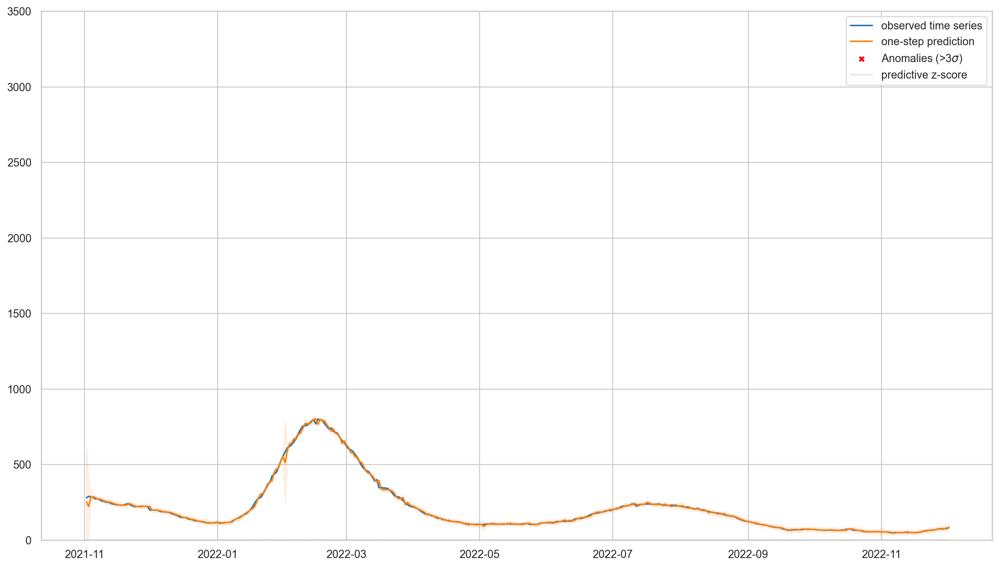

In [24]:
fig, ax = plot_one_step_predictive(
    covid.index, covid['new_deaths_f'],
    covid_one_step_mean, covid_one_step_scale)#,
    #x_locator=date_loc, x_formatter=date_fmt)
ax.set_ylim(0, 3500)

# Use the one-step-ahead forecasts to detect anomalous timesteps.
zscores = np.abs((covid['new_deaths_f'] - covid_one_step_mean) /
                 covid_one_step_scale)
anomalies = zscores > 3.0
ax.scatter(covid.index[anomalies],
           covid['new_deaths_f'].loc[anomalies],
           c="red", marker="x", s=20, linewidth=2, label=r"Anomalies (>3$\sigma$)")
ax.plot(covid_dates, zscores, color="black", alpha=0.1, label='predictive z-score')
ax.legend()
plt.show()

## Conclusão

O uso do número de casos diários e da porcentagem de pessoas vacinadas no modelo de espaço de estados permitiu uma previsão razoável do número de óbitos diários dos próximos 30 dias. Embora o resultado seja bom, o modelo ainda apresenta alguns problemas de instabilidade na simulação (rodem outras vezes para verem a variação nos resultados) e não modela adequadamente o comportamento da série. Alguns ajustes no modelo podem ser necessários, como o uso de estados escondidos (como o <a href="https://jds-online.org/journal/JDS/article/28/info">artigo</a> que mostrei na monitoria).

Como disse na monitoria, o modelo de espaço de estados é bem generalizável, mas vai exigir um estudo mais aprofundado de vocês. Recomendo refazerem os exemplos das aulas e <a href="https://github.com/tensorflow/probability/blob/master/tensorflow_probability/examples/jupyter_notebooks/Structural_Time_Series_Modeling_Case_Studies_Atmospheric_CO2_and_Electricity_Demand.ipynb">o da demana de energia elétrica da Austrália</a>.

Reparem que os modelos de espaço de estados nada mais são do modelos de evolução de sistemas, em que vocês podem usar variáveis exógenas, tendências locais, níveis locais, sazonalidades e modelos autoregressivos e de médias móveis, junto com o componente aleatório dos resíduos. Para saberem se o modelo está correto, vocês precisam analisar se os resíduos são estacionários, ou seja, não possuam autocorrelação, são homocedásticos (sua variância não varia com o tempo) e possuam distribuição normal. A normalidade dos resíduos não precisa ser satisfeita, mas, quando não for, precisa usar distribuições apropriadas no modelo. Por isso, eu sugiro trabalhar com resíduos que seguem a distribuição normal.

# Prática 8

Nesta prática vamos considerar um modelo de sobrevivência com covariáveis, especificamente um modelo de Cox.
Fonte: https://www.kaggle.com/bryanb/survival-analysis-with-cox-model-implementation

Deseja-se modelar o tempo até a morte de pacientes de câncer de mama em até 5 anos após uma cirurgia para a retirada de nódulos. Os dados são descritos no arquivo haberman.csv.

Descrição de dados

- Age: Idade do paciente no momento da operação;
- Operation_year: ano de operação do paciente (ano - 19XX);
- Nb_pos_detected: Número de nódulos axilares positivos detectados;
- Surv: Status de sobrevivência (atributo de classe) 1 = o paciente sobreviveu 5 anos ou mais 2 = o paciente morreu dentro de 5 anos;

Desenvolva um estudo com modelo de sobrevivência incluindo como covariáveis o ano da operação e o número de nódulos axilar positivos detectados. Assuma que um teste estatístico foi realizado e apontou para a proporcionalidade dos riscos.


**1.Carregue a biblioteca lifelines. Instale-a antes, se necessário**

In [ ]:
!pip install lifelines

In [ ]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from lifelines import CoxPHFitter
from lifelines import KaplanMeierFitter

%matplotlib inline


**2. Leia os dados do arquivo haberman.csv.**

In [ ]:
data=pd.read_csv('https://raw.githubusercontent.com/cibelerusso/Aprendizado-Dinamico/main/Data/haberman.csv', names = ['Age','Operation_year','Nb_pos_detected','Surv'])
data.head()


,Age,Operation_year,Nb_pos_detected,Surv
0,30,64,1,1
1,30,62,3,1
2,30,65,0,1
3,31,59,2,1
4,31,65,4,1


**3. Estime a curva de sobrevivência com o estimador de Kaplan-Meier**

<Axes: xlabel='timeline'>

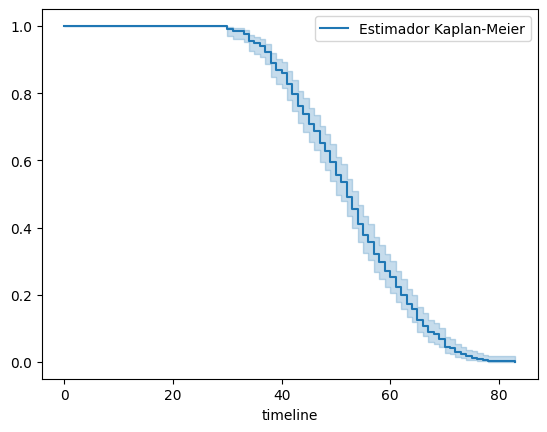

In [ ]:
T = data.Age
E = data.Surv

km = KaplanMeierFitter()

km.fit(T, E,label='Estimador Kaplan-Meier')

km.plot(ci_show=True)

**4. Utilize o estimador de Kaplan-Meier com dois grupos, um deles com pelo menos um nódulo axilar.**

<Axes: xlabel='timeline'>

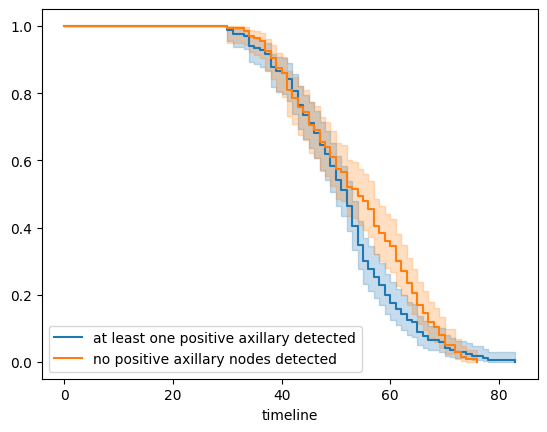

In [ ]:

km_2 = KaplanMeierFitter()

## Uma possibilidade: crie 2 coortes: com pelo menos um axilar positivo detectado e um sem nenhum detectado

groups = data['Nb_pos_detected']
i1 = (groups >= 1)
i2 = (groups < 1)


## ajuste o modelo para a 1ª coorte
km_2.fit(T[i1], E[i1], label='at least one positive axillary detected')
a1 = km_2.plot()

## ajuste o modelo para a 2ª coorte
km_2.fit(T[i2], E[i2], label='no positive axillary nodes detected')
km_2.plot(ax=a1)

**5. Ajuste um modelo de Cox com covariáveis Operatio_year e Nb_pos_detected. Interprete os resultados**

In [ ]:
# Crie o modelo
cph = CoxPHFitter()

# Ajuste o modelo
cph.fit(data, 'Age', event_col='Surv')

# Verifique os resultados
cph.print_summary()

<lifelines.CoxPHFitter: fitted with 306 total observations, 0 right-censored observations>
             duration col = 'Age'
                event col = 'Surv'
      baseline estimation = breslow
   number of observations = 306
number of events observed = 306
   partial log-likelihood = -1446.95
         time fit was run = 2023-08-28 18:30:23 UTC

---
                  coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                               
Operation_year   -0.02       0.98       0.02            -0.06             0.01                 0.94                 1.01
Nb_pos_detected   0.01       1.01       0.01            -0.00             0.03                 1.00                 1.03

                  cmp to     z    p   -log2(p)
covariate                                     
Operation_year      0.00 -1.39 0.16       2.61
Nb_pos_detected     0.00  1.70 0.09       3.47
---
Concordance = 0.53
Partial AIC = 2897.90
log-likelihood ratio test = 4.50 on 2 df
-log2(p) of ll-ratio test = 3.25

<Axes: xlabel='log(HR) (95% CI)'>

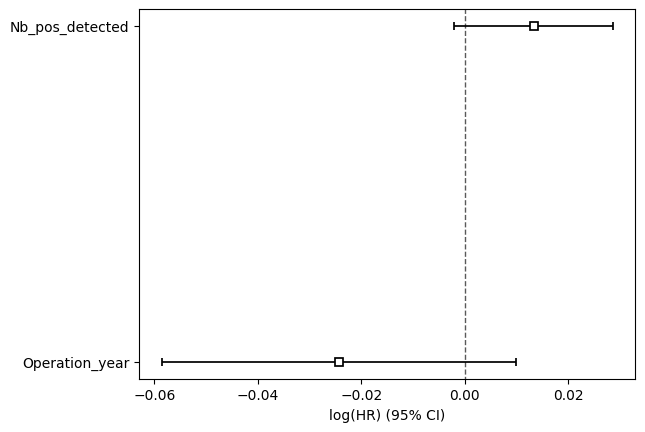

In [ ]:
cph.plot()

**6. Selecione três pacientes de forma aleatória para fazer a previsão da curva de sobrevivência para cada um deles**

In [ ]:
patients = [4,125,211]

rows_selected = data.iloc[patients, 1:3]
rows_selected

,Operation_year,Nb_pos_detected
4,65,4
125,64,0
211,67,0


**7. Faça a previsão da curva de sobrevivência para cada um dos pacientes selecionados acima**

<Axes: >

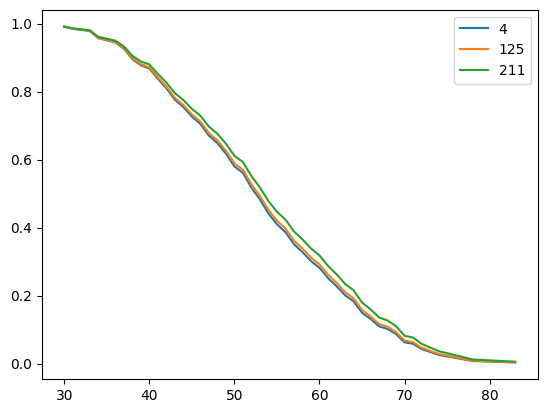

In [ ]:

cph.predict_survival_function(rows_selected).plot()